In [1]:
from pathlib import Path
from compare import ReferenceComparer, get_last_two_commits

# Find commits to compare

By default, the notebook compares last two commits(`ref1hash` is the older one and `ref2hash` is the newer one). You can customise this by changing the `ref1_hash` and `ref2_hash` variables or by providing `REF1_HASH` and `REF2_HASH` commit values. You can also provide custom spectrum paths for the two hashes with respect to the root directory for that commit. 

In [2]:
import os

ref1_hash = os.getenv('REF1_HASH')
ref2_hash = os.getenv('REF2_HASH')

if not (ref1_hash and ref2_hash):
    ref1_hash, ref2_hash = get_last_two_commits()

if not (ref1_hash and ref2_hash):
    raise ValueError("Could not get commit hashes.")
    

if os.getenv('CUSTOM_REF1_SPECTRUM_PATH'):
    custom_ref1_spectrum_path = os.getenv('CUSTOM_REF1_SPECTRUM_PATH')
else:
    custom_ref1_spectrum_path = 'tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver/TestSpectrumSolver.h5'

if os.getenv('CUSTOM_REF2_SPECTRUM_PATH'):
    custom_ref2_spectrum_path = os.getenv('CUSTOM_REF2_SPECTRUM_PATH')
else:
    custom_ref2_spectrum_path = 'tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver/TestSpectrumSolver.h5'


In [3]:
ref1_hash, ref2_hash

('fa7729bc9c30e14b69acd641af8b692b56fcd416',
 'ee0053a454318e43acad2e1db89689fc30293727')

# Example Values

Below are example values you can test the notebook with.

In [4]:
# ref1_hash="170f1a2c0d8c6db518a4b9a0f4cb9b657aaa61b6"
# ref2_hash="d9fd3bb659d185bd9ece10b8e2175cf497ea84c5"
# custom_ref1_spectrum_path = 'tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver/TestSpectrumSolver.h5'
# custom_ref2_spectrum_path = 'test_spectrum_solver/test_spectrum_solver/TestSpectrumSolver.h5'

# Initialise the `ReferenceComparer` class


In [5]:
comparer = ReferenceComparer(ref1_hash=ref1_hash, ref2_hash=ref2_hash, print_path=True)

comparer.setup()
comparer.diff_analyzer.display_diff_tree(comparer.dcmp)

Created temporary directory at /tmp/ref_compare_bz0ohgru


├ .github/
│ ├ actions/
│ │ ├ setup_env/
│ ├ workflows/
├ arepo_data/


├ atom_data/


│ ├ nlte_atom_data/
│ ├ stardis_atom_data/
├ tardis/
│ ├ opacities/
│ │ ├ tests/
│ │ │ ├ test_tau_sobolev/
│ │ │ │ ✱ test_calculate_beta_sobolevs.npy
│ │ │ │ ✱ test_calculate_sobolev_line_opacity.h5
│ ├ plasma/
│ │ ├ equilibrium/
│ │ │ ├ tests/
│ │ │ │ ├ test_level_populations/
│ │ │ │ │ ├ test_level_population_solver/
│ │ │ │ │ │ ✱ test_solve__collisional_rate_solver0-radiative_transitions0__.h5
│ │ │ │ ├ test_rate_matrix/
│ │ │ │ │ ✱ test_rate_matrix_solver__collisional_rate_solver0-radiative_transitions0__.h5
│ │ ├ tests/
│ │ │ ├ test_complete_plasmas/
│ │ │ │ ├ test_plasma/
│ │ │ │ │ ✱ plasma_unittest_disable_electron_scattering_False.h5
│ │ │ │ │ ✱ plasma_unittest_disable_electron_scattering_True.h5
│ │ │ │ │ ✱ plasma_unittest_excitation_dilute-lte.h5
│ │ │ │ │ ✱ plasma_unittest_excitation_lte.h5
│ │ │ │ │ ✱ plasma_unittest_helium_treatment_recomb-nlte.h5
│ │ │ │ │ ✱ plasma_unittest_helium_treatment_recomb-nlte_delta_treatment_0.5.h5
│ │ │ │ │ ✱ plasma_unittest_initial_t_inner_100

In [6]:
comparer.compare()

Significant difference detected in TestTransportSimple.h5, key=/simulation/plasma/t_electrons
Maximum relative difference: 8.60e-04 (Versions differ by 8.60e-02%)


Displaying heatmap for key /simulation/plasma/t_electrons in file TestTransportSimple.h5 
Visualising Absolute Differences


,0
mean,5.9
max,8.3


Visualising Relative Differences


,0
mean,0.00061
max,0.00086


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple


Significant difference detected in TestTransportSimple.h5, key=/simulation/plasma/lines_upper_level_index
Maximum relative difference: 9.61e-01 (Versions differ by 9.61e+01%)


Error comparing item: /simulation/plasma/beta_sobolev
cannot handle a non-unique multi-index!


Displaying heatmap for key /simulation/plasma/lines_upper_level_index in file TestTransportSimple.h5 
Visualising Absolute Differences


,0
mean,2e+03
max,4e+03


Visualising Relative Differences


,0
mean,0.48
max,0.96


Significant difference detected in TestTransportSimple.h5, key=/simulation/spectrum_solver/spectrum_virtual_packets/luminosity_density_lambda
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple
Error comparing item: /simulation/plasma/wavelength_cm
cannot handle a non-unique multi-index!
Displaying heatmap for key /simulation/spectrum_solver/spectrum_virtual_packets/luminosity_density_lambda in file TestTransportSimple.h5 
Visualising Absolute Differences


,0
mean,2.6e+46
max,5e+46


Visualising Relative Differences


,0
mean,0.62
max,1


Significant difference detected in TestTransportSimple.h5, key=/simulation/spectrum_solver/spectrum_real_packets_reabsorbed/luminosity_density_lambda
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple
Displaying heatmap for key /simulation/spectrum_solver/spectrum_real_packets_reabsorbed/luminosity_density_lambda in file TestTransportSimple.h5 
Visualising Absolute Differences


,0
mean,4.1e+46
max,7.7e+46


Visualising Relative Differences


,0
mean,0.64
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple


Significant difference detected in TestTransportSimple.h5, key=/simulation/plasma/electron_densities
Maximum relative difference: 1.55e-04 (Versions differ by 1.55e-02%)


Displaying heatmap for key /simulation/plasma/electron_densities in file TestTransportSimple.h5 
Visualising Absolute Differences


,0
mean,4.3e+04
max,6.3e+04


Visualising Relative Differences


,0
mean,0.00011
max,0.00015


Significant difference detected in TestTransportSimple.h5, key=/simulation/iterations_t_rad
Maximum relative difference: 8.60e-04 (Versions differ by 8.60e-02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple
Displaying heatmap for key /simulation/iterations_t_rad in file TestTransportSimple.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0.75,1.5,0.88,1.3,1.4,1.2,1.1,0.76,0.82,1,1.7,2.1,2.3,1.5,1.1,1.3,1.8,2.1,1.7,1.4
max,1.3,2.8,1.9,2.6,3.1,2.8,2.8,2.4,2,3.9,5.8,7.7,9.2,4.1,4,2.7,7.7,8.7,5.3,3.7


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,7.1e-05,0.00014,8.2e-05,0.00012,0.00013,0.00011,0.0001,7e-05,7.7e-05,9.3e-05,0.00015,0.0002,0.00022,0.00014,0.00011,0.00013,0.00018,0.0002,0.00016,0.00014
max,0.00012,0.00027,0.00017,0.00024,0.00029,0.00026,0.00025,0.00023,0.00018,0.00036,0.00053,0.00071,0.00086,0.00039,0.00038,0.00026,0.00073,0.00083,0.00052,0.00036


Significant difference detected in TestTransportSimple.h5, key=/simulation/simulation_state/scalars
Maximum relative difference: 2.65e-04 (Versions differ by 2.65e-02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple
Displaying heatmap for key /simulation/simulation_state/scalars in file TestTransportSimple.h5 
Visualising Absolute Differences


,0
mean,2.1
max,2.8


Visualising Relative Differences


,0
mean,0.0002
max,0.00027


Significant difference detected in TestTransportSimple.h5, key=/simulation/plasma/t_rad
Maximum relative difference: 8.60e-04 (Versions differ by 8.60e-02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple
Displaying heatmap for key /simulation/plasma/t_rad in file TestTransportSimple.h5 
Visualising Absolute Differences


,0
mean,6.6
max,9.2


Visualising Relative Differences


,0
mean,0.00061
max,0.00086


Significant difference detected in TestTransportSimple.h5, key=/simulation/transport/transport_state/last_interaction_type
Maximum relative difference: 2.00e+00 (Versions differ by 2.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple
Displaying heatmap for key /simulation/transport/transport_state/last_interaction_type in file TestTransportSimple.h5 
Visualising Absolute Differences


,0
mean,1.6
max,3


Visualising Relative Differences


,0
mean,1
max,2


Significant difference detected in TestTransportSimple.h5, key=/simulation/transport/transport_state/last_interaction_in_nu
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple
Displaying heatmap for key /simulation/transport/transport_state/last_interaction_in_nu in file TestTransportSimple.h5 
Visualising Absolute Differences


,0
mean,2.8e+15
max,5.4e+15


Visualising Relative Differences


,0
mean,0.63
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple


Significant difference detected in TestTransportSimple.h5, key=/simulation/plasma/partition_function
Maximum relative difference: 2.86e-03 (Versions differ by 2.86e-01%)


Displaying heatmap for key /simulation/plasma/partition_function in file TestTransportSimple.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,3.9e-05,0.00014,0.00013,0.00018,0.0001,0.0002,0.0002,6.5e-05,9e-05,0.00027,0.0004,0.00052,0.00062,0.00028,0.00027,0.00018,0.0005,0.00056,0.00034,0.00019
max,0.001,0.0036,0.0035,0.0046,0.0027,0.0053,0.0051,0.0017,0.0023,0.0071,0.01,0.013,0.016,0.007,0.0067,0.0045,0.012,0.014,0.0083,0.0045


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,7.3e-06,2.5e-05,2.5e-05,3.2e-05,1.9e-05,3.7e-05,3.6e-05,1.2e-05,1.7e-05,5.1e-05,7.5e-05,9.9e-05,0.00012,5.3e-05,5.2e-05,3.5e-05,9.8e-05,0.00011,6.8e-05,3.8e-05
max,0.00018,0.00062,0.00061,0.0008,0.00047,0.00092,0.0009,0.00029,0.00041,0.0013,0.0018,0.0024,0.0029,0.0013,0.0012,0.00085,0.0024,0.0027,0.0017,0.00093


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple


Error comparing item: /simulation/plasma/j_blues
cannot handle a non-unique multi-index!


Significant difference detected in TestTransportSimple.h5, key=/simulation/spectrum_solver/montecarlo_virtual_luminosity
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation/spectrum_solver/montecarlo_virtual_luminosity in file TestTransportSimple.h5 
Visualising Absolute Differences


,0
mean,2.8e+38
max,5.3e+38


Visualising Relative Differences


,0
mean,0.62
max,1


Significant difference detected in TestTransportSimple.h5, key=/simulation/iterations_electron_densities
Maximum relative difference: 1.55e-04 (Versions differ by 1.55e-02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple
Displaying heatmap for key /simulation/iterations_electron_densities in file TestTransportSimple.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,3.7e+04,5.4e+04,2.3e+04,2.7e+04,2.2e+04,1.5e+04,1.1e+04,6.1e+03,5.4e+03,5.6e+03,7.5e+03,7.9e+03,7.3e+03,3.8e+03,2.4e+03,2.2e+03,2.7e+03,2.5e+03,1.7e+03,1.1e+03
max,6e+04,9.3e+04,4.8e+04,5.1e+04,4.8e+04,3.6e+04,2.9e+04,1.9e+04,1.3e+04,2.3e+04,2.7e+04,3e+04,2.9e+04,1.1e+04,8.8e+03,4.9e+03,1.1e+04,1e+04,5.4e+03,3e+03


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.3e-05,2.4e-05,1.4e-05,2e-05,2.1e-05,1.8e-05,1.7e-05,1.2e-05,1.3e-05,1.6e-05,2.7e-05,3.4e-05,3.9e-05,2.4e-05,1.8e-05,2.1e-05,2.9e-05,3.2e-05,2.5e-05,2e-05
max,2.1e-05,4.2e-05,2.8e-05,3.8e-05,4.6e-05,4.4e-05,4.4e-05,3.7e-05,3e-05,6.7e-05,9.8e-05,0.00013,0.00015,7e-05,6.7e-05,4.5e-05,0.00012,0.00014,8.1e-05,5.3e-05


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple


Error comparing item: /simulation/plasma/nu
cannot handle a non-unique multi-index!


Significant difference detected in TestTransportSimple.h5, key=/simulation/plasma/g_electron
Maximum relative difference: 1.29e-03 (Versions differ by 1.29e-01%)


Displaying heatmap for key /simulation/plasma/g_electron in file TestTransportSimple.h5 
Visualising Absolute Differences


,0
mean,2.5e+18
max,3.4e+18


Visualising Relative Differences


,0
mean,0.00092
max,0.0013


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple


Significant difference detected in TestTransportSimple.h5, key=/simulation/transport/transport_state/output_energy
Maximum relative difference: 2.00e+00 (Versions differ by 2.00e+02%)


Displaying heatmap for key /simulation/transport/transport_state/output_energy in file TestTransportSimple.h5 
Visualising Absolute Differences


,0
mean,2.2e-06
max,4.1e-06


Visualising Relative Differences


,0
mean,1.1
max,2


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple


Significant difference detected in TestTransportSimple.h5, key=/simulation/plasma/transition_probabilities
Maximum relative difference: 7.24e-02 (Versions differ by 7.24e+00%)


Displaying heatmap for key /simulation/plasma/transition_probabilities in file TestTransportSimple.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,9.6e-07,4e-06,3e-06,4.1e-06,2e-06,4.1e-06,3.9e-06,1.3e-06,1.8e-06,5.3e-06,8.4e-06,1.1e-05,1.4e-05,6.1e-06,6e-06,4.1e-06,1.2e-05,1.4e-05,8.3e-06,4.5e-06
max,0.00051,0.0017,0.0016,0.0021,0.0012,0.0024,0.0024,0.00079,0.0011,0.0035,0.0052,0.0069,0.0083,0.0036,0.0037,0.0026,0.0072,0.0084,0.0052,0.003


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,8.3e-05,0.00035,0.00025,0.00037,0.00016,0.00037,0.00033,0.00011,0.00017,0.00043,0.00073,0.00091,0.0011,0.00048,0.00046,0.00032,0.00095,0.0011,0.00069,0.00038
max,0.0042,0.014,0.013,0.017,0.01,0.02,0.019,0.0065,0.0094,0.029,0.044,0.058,0.071,0.033,0.033,0.023,0.063,0.072,0.046,0.026


Significant difference detected in TestTransportSimple.h5, key=/simulation/plasma/lines_lower_level_index
Maximum relative difference: 9.63e-01 (Versions differ by 9.63e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple
Error comparing item: /simulation/transport/transport_state/emitted_packet_mask
numpy boolean subtract, the `-` operator, is not supported, use the bitwise_xor, the `^` operator, or the logical_xor function instead.
Displaying heatmap for key /simulation/plasma/lines_lower_level_index in file TestTransportSimple.h5 
Visualising Absolute Differences


,0
mean,2e+03
max,4e+03


Visualising Relative Differences


,0
mean,0.48
max,0.96


Significant difference detected in TestTransportSimple.h5, key=/simulation/iterations_w
Maximum relative difference: 2.18e-03 (Versions differ by 2.18e-01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple
Displaying heatmap for key /simulation/iterations_w in file TestTransportSimple.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0.00015,0.00023,0.0001,0.00014,9e-05,8.2e-05,6.1e-05,4.1e-05,2.2e-05,3.1e-05,6.6e-05,6.5e-05,6.8e-05,4.3e-05,2.4e-05,2.8e-05,3.8e-05,4.4e-05,4e-05,3.2e-05
max,0.00033,0.0004,0.00018,0.00028,0.00025,0.00018,0.00014,0.00011,3.9e-05,8.8e-05,0.00021,0.00021,0.00023,0.00012,6e-05,6.1e-05,0.00014,0.00017,9.5e-05,0.00011


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0.00031,0.00061,0.00033,0.00053,0.0004,0.00042,0.00035,0.00026,0.00015,0.00023,0.00053,0.00057,0.00063,0.00042,0.00025,0.0003,0.00043,0.00053,0.0005,0.00041
max,0.00066,0.0011,0.00059,0.0011,0.0011,0.00094,0.00078,0.00071,0.00027,0.00067,0.0017,0.0018,0.0022,0.0012,0.00064,0.00066,0.0016,0.0021,0.0012,0.0014


Significant difference detected in TestTransportSimple.h5, key=/simulation/plasma/stimulated_emission_factor
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple
Displaying heatmap for key /simulation/plasma/stimulated_emission_factor in file TestTransportSimple.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0.0002,0.00022,0.00022,0.00023,0.00021,0.00024,0.00024,0.0002,0.00021,0.00026,0.00029,0.00032,0.00035,0.00026,0.00026,0.00024,0.00032,0.00034,0.00028,0.00024
max,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0.00024,0.0003,0.0003,0.00032,0.00028,0.00033,0.00033,0.00026,0.00027,0.00038,0.00046,0.00054,0.0006,0.00039,0.00039,0.00033,0.00054,0.00058,0.00044,0.00035
max,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1


Significant difference detected in TestTransportSimple.h5, key=/simulation/transport/transport_state/scalars
Maximum relative difference: 1.06e-03 (Versions differ by 1.06e-01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple
Displaying heatmap for key /simulation/transport/transport_state/scalars in file TestTransportSimple.h5 
Visualising Absolute Differences


,0
mean,7.5e-47
max,7.5e-47


Visualising Relative Differences


,0
mean,0.0011
max,0.0011


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple


Significant difference detected in TestTransportSimple.h5, key=/simulation/transport/transport_state/output_nu
Maximum relative difference: 9.77e-01 (Versions differ by 9.77e+01%)


Displaying heatmap for key /simulation/transport/transport_state/output_nu in file TestTransportSimple.h5 
Visualising Absolute Differences


,0
mean,1.9e+15
max,3.7e+15


Visualising Relative Differences


,0
mean,0.51
max,0.98


Significant difference detected in TestTransportSimple.h5, key=/simulation/spectrum_solver/spectrum_virtual_packets/luminosity
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple
Displaying heatmap for key /simulation/spectrum_solver/spectrum_virtual_packets/luminosity in file TestTransportSimple.h5 
Visualising Absolute Differences


,0
mean,2.8e+38
max,5.3e+38


Visualising Relative Differences


,0
mean,0.62
max,1


Significant difference detected in TestTransportSimple.h5, key=/simulation/iterations_t_inner
Maximum relative difference: 2.65e-04 (Versions differ by 2.65e-02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple
Displaying heatmap for key /simulation/iterations_t_inner in file TestTransportSimple.h5 
Visualising Absolute Differences


,0
mean,1.8
max,2.8


Visualising Relative Differences


,0
mean,0.00016
max,0.00027


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple


Significant difference detected in TestTransportSimple.h5, key=/simulation/transport/transport_state/last_interaction_in_r
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation/transport/transport_state/last_interaction_in_r in file TestTransportSimple.h5 
Visualising Absolute Differences


,0
mean,1.2e+15
max,2.2e+15


Visualising Relative Differences


,0
mean,0.61
max,1


Significant difference detected in TestTransportSimple.h5, key=/simulation/spectrum_solver/spectrum_real_packets/luminosity_density_lambda
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple
Displaying heatmap for key /simulation/spectrum_solver/spectrum_real_packets/luminosity_density_lambda in file TestTransportSimple.h5 
Visualising Absolute Differences


,0
mean,7.6e+46
max,1.4e+47


Visualising Relative Differences


,0
mean,0.62
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple


Significant difference detected in TestTransportSimple.h5, key=/simulation/spectrum_solver/spectrum_integrated/luminosity_density_lambda
Maximum relative difference: 8.58e-01 (Versions differ by 8.58e+01%)


Error comparing item: /simulation/plasma/f_lu
cannot handle a non-unique multi-index!
Displaying heatmap for key /simulation/spectrum_solver/spectrum_integrated/luminosity_density_lambda in file TestTransportSimple.h5 
Visualising Absolute Differences


,0
mean,7.3e+44
max,1.3e+45


Visualising Relative Differences


,0
mean,0.49
max,0.86


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple


Significant difference detected in TestTransportSimple.h5, key=/simulation/transport/transport_state/j_estimator
Maximum relative difference: 1.54e-03 (Versions differ by 1.54e-01%)


Displaying heatmap for key /simulation/transport/transport_state/j_estimator in file TestTransportSimple.h5 
Visualising Absolute Differences


,0
mean,8.3e+10
max,1.2e+11


Visualising Relative Differences


,0
mean,0.0011
max,0.0015


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple


Significant difference detected in TestTransportSimple.h5, key=/simulation/simulation_state/dilution_factor
Maximum relative difference: 2.18e-03 (Versions differ by 2.18e-01%)


Displaying heatmap for key /simulation/simulation_state/dilution_factor in file TestTransportSimple.h5 
Visualising Absolute Differences


,0
mean,0.00027
max,0.0004


Visualising Relative Differences


,0
mean,0.0016
max,0.0022


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple


Error comparing item: /simulation/plasma/lines
cannot handle a non-unique multi-index!


Significant difference detected in TestTransportSimple.h5, key=/simulation/transport/transport_state/last_line_interaction_shell_id
Maximum relative difference: 2.00e+00 (Versions differ by 2.00e+02%)


Displaying heatmap for key /simulation/transport/transport_state/last_line_interaction_shell_id in file TestTransportSimple.h5 
Visualising Absolute Differences


,0
mean,10
max,20


Visualising Relative Differences


,0
mean,1.1
max,2


Significant difference detected in TestTransportSimple.h5, key=/simulation/spectrum_solver/spectrum_integrated/luminosity
Maximum relative difference: 8.58e-01 (Versions differ by 8.58e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple
Displaying heatmap for key /simulation/spectrum_solver/spectrum_integrated/luminosity in file TestTransportSimple.h5 
Visualising Absolute Differences


,0
mean,1.9e+37
max,3.6e+37


Visualising Relative Differences


,0
mean,0.49
max,0.86


Significant difference detected in TestTransportSimple.h5, key=/simulation/plasma/macro_atom_data
Maximum relative difference: 1.67e-01 (Versions differ by 1.67e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple
Displaying heatmap for key /simulation/plasma/macro_atom_data in file TestTransportSimple.h5 
Visualising Absolute Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,0.11,0,0
max,0,0,0,0,0,0,0,9,0,0


Visualising Relative Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,4.2e-05,0,0
max,0,0,0,0,0,0,0,0.17,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple


Significant difference detected in TestTransportSimple.h5, key=/simulation/transport/transport_state/j_blue_estimator
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation/transport/transport_state/j_blue_estimator in file TestTransportSimple.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.6e-20,2.6e-20,2.6e-20,2.6e-20,2.4e-20,2.4e-20,2.4e-20,2.3e-20,2.3e-20,2.2e-20,2.3e-20,2.2e-20,2.2e-20,2.2e-20,2.1e-20,2.1e-20,2.1e-20,2.1e-20,2.1e-20,2.1e-20
max,3e-19,3.2e-19,2.4e-19,2.5e-19,2.4e-19,2e-19,2.2e-19,2e-19,1.9e-19,1.9e-19,2e-19,1.8e-19,1.8e-19,3e-19,5.3e-19,5.3e-19,1.9e-19,1.7e-19,1.8e-19,1.7e-19


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0.059,0.065,0.069,0.072,0.072,0.077,0.08,0.079,0.081,0.084,0.084,0.085,0.086,0.089,0.087,0.088,0.089,0.09,0.092,0.093
max,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1


Significant difference detected in TestTransportSimple.h5, key=/simulation/spectrum_solver/spectrum_real_packets/luminosity
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple
Displaying heatmap for key /simulation/spectrum_solver/spectrum_real_packets/luminosity in file TestTransportSimple.h5 
Visualising Absolute Differences


,0
mean,7.3e+38
max,1.4e+39


Visualising Relative Differences


,0
mean,0.62
max,1


Significant difference detected in TestTransportSimple.h5, key=/simulation/plasma/phi
Maximum relative difference: 5.00e-01 (Versions differ by 5.00e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple
Displaying heatmap for key /simulation/plasma/phi in file TestTransportSimple.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.5e+13,9e+13,8.9e+13,1.2e+14,6.8e+13,1.3e+14,1.3e+14,4.3e+13,5.9e+13,1.8e+14,2.5e+14,3.3e+14,3.9e+14,1.7e+14,1.6e+14,1.1e+14,3e+14,3.3e+14,1.9e+14,1.1e+14
max,1.5e+15,5.4e+15,5.4e+15,7.1e+15,4.1e+15,8.1e+15,7.9e+15,2.6e+15,3.6e+15,1.1e+16,1.5e+16,2e+16,2.4e+16,1e+16,1e+16,6.7e+15,1.8e+16,2e+16,1.2e+16,6.5e+15


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0.012,0.038,0.037,0.047,0.031,0.061,0.053,0.018,0.026,0.076,0.11,0.14,0.16,0.08,0.079,0.056,0.14,0.16,0.11,0.062
max,0.037,0.12,0.12,0.15,0.25,0.5,0.17,0.058,0.082,0.23,0.33,0.4,0.46,0.24,0.24,0.17,0.42,0.46,0.33,0.2


Significant difference detected in TestTransportSimple.h5, key=/simulation/transport/transport_state/last_line_interaction_out_id
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple
Displaying heatmap for key /simulation/transport/transport_state/last_line_interaction_out_id in file TestTransportSimple.h5 
Visualising Absolute Differences


,0
mean,1.3e+04
max,2.6e+04


Visualising Relative Differences


,0
mean,0.54
max,1


Significant difference detected in TestTransportSimple.h5, key=/simulation/plasma/w
Maximum relative difference: 2.18e-03 (Versions differ by 2.18e-01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple
Displaying heatmap for key /simulation/plasma/w in file TestTransportSimple.h5 
Visualising Absolute Differences


,0
mean,0.00027
max,0.0004


Visualising Relative Differences


,0
mean,0.0016
max,0.0022


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple


Significant difference detected in TestTransportSimple.h5, key=/simulation/transport/transport_state/packet_luminosity
Maximum relative difference: 2.00e+00 (Versions differ by 2.00e+02%)


Displaying heatmap for key /simulation/transport/transport_state/packet_luminosity in file TestTransportSimple.h5 
Visualising Absolute Differences


,0
mean,3.1e+37
max,5.8e+37


Visualising Relative Differences


,0
mean,1.1
max,2


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple


Significant difference detected in TestTransportSimple.h5, key=/simulation/plasma/ion_number_density
Maximum relative difference: 9.62e-02 (Versions differ by 9.62e+00%)


Displaying heatmap for key /simulation/plasma/ion_number_density in file TestTransportSimple.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,5.4e+02,1.4e+03,1.1e+03,1.1e+03,5e+02,7.9e+02,6.3e+02,1.7e+02,2e+02,4.9e+02,5.9e+02,6.4e+02,6.3e+02,2.4e+02,1.9e+02,1.1e+02,2.5e+02,2.3e+02,1.2e+02,55
max,1.6e+04,4.6e+04,3.4e+04,3.2e+04,1.3e+04,1.9e+04,1.4e+04,3.9e+03,4.7e+03,1.2e+04,1.4e+04,1.5e+04,1.5e+04,5.9e+03,4.6e+03,2.5e+03,5.6e+03,5e+03,2.7e+03,1.4e+03


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0.0019,0.0064,0.0061,0.0079,0.0046,0.009,0.0089,0.0029,0.0042,0.013,0.019,0.025,0.031,0.014,0.014,0.0096,0.027,0.031,0.019,0.011
max,0.0067,0.022,0.021,0.026,0.015,0.029,0.029,0.0095,0.013,0.041,0.06,0.08,0.096,0.044,0.044,0.031,0.084,0.096,0.061,0.036


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple


Significant difference detected in TestTransportSimple.h5, key=/simulation/plasma/level_number_density
Maximum relative difference: 1.88e-01 (Versions differ by 1.88e+01%)


Displaying heatmap for key /simulation/plasma/level_number_density in file TestTransportSimple.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,16,42,31,32,15,24,19,5,5.8,14,17,19,18,6.9,5.5,3.1,7.2,6.7,3.4,1.6
max,1e+04,2.9e+04,2.1e+04,2e+04,9.8e+03,1.8e+04,1.6e+04,4.6e+03,5.4e+03,1.4e+04,1.6e+04,1.8e+04,1.8e+04,6.7e+03,5.3e+03,2.9e+03,6.4e+03,5.7e+03,2.8e+03,1.2e+03


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0.0019,0.0064,0.0062,0.008,0.0046,0.0091,0.009,0.003,0.0042,0.013,0.019,0.025,0.031,0.014,0.014,0.0097,0.027,0.031,0.019,0.011
max,0.012,0.041,0.039,0.051,0.03,0.058,0.057,0.019,0.027,0.083,0.12,0.16,0.19,0.09,0.089,0.062,0.17,0.19,0.12,0.071


Significant difference detected in TestTransportSimple.h5, key=/simulation/spectrum_solver/spectrum_real_packets_reabsorbed/luminosity
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple
Displaying heatmap for key /simulation/spectrum_solver/spectrum_real_packets_reabsorbed/luminosity in file TestTransportSimple.h5 
Visualising Absolute Differences


,0
mean,3.9e+38
max,7.4e+38


Visualising Relative Differences


,0
mean,0.64
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple


Significant difference detected in TestTransportSimple.h5, key=/simulation/transport/transport_state/last_line_interaction_in_id
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation/transport/transport_state/last_line_interaction_in_id in file TestTransportSimple.h5 
Visualising Absolute Differences


,0
mean,1.4e+04
max,2.7e+04


Visualising Relative Differences


,0
mean,0.54
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple


Error comparing item: /simulation/plasma/tau_sobolevs
cannot handle a non-unique multi-index!


Significant difference detected in TestTransportSimple.h5, key=/simulation/plasma/level_boltzmann_factor
Maximum relative difference: 1.59e-01 (Versions differ by 1.59e+01%)


Displaying heatmap for key /simulation/plasma/level_boltzmann_factor in file TestTransportSimple.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,8.3e-07,2.9e-06,2.8e-06,3.7e-06,2.2e-06,4.3e-06,4.2e-06,1.4e-06,1.9e-06,5.8e-06,8.5e-06,1.1e-05,1.3e-05,5.9e-06,5.7e-06,3.8e-06,1.1e-05,1.2e-05,7.2e-06,4e-06
max,9.4e-05,0.00032,0.00031,0.0004,0.00023,0.00046,0.00045,0.00015,0.00021,0.00066,0.00097,0.0013,0.0016,0.0007,0.00069,0.00048,0.0013,0.0015,0.00094,0.00053


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0.0017,0.0056,0.0054,0.007,0.0041,0.008,0.0079,0.0026,0.0037,0.011,0.017,0.023,0.027,0.012,0.012,0.0086,0.024,0.027,0.017,0.0099
max,0.01,0.034,0.033,0.043,0.025,0.049,0.048,0.016,0.023,0.069,0.1,0.13,0.16,0.075,0.075,0.052,0.14,0.16,0.1,0.06


Significant difference detected in TestTransportSimple.h5, key=/simulation/transport/transport_state/nu_bar_estimator
Maximum relative difference: 2.49e-03 (Versions differ by 2.49e-01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple
Displaying heatmap for key /simulation/transport/transport_state/nu_bar_estimator in file TestTransportSimple.h5 
Visualising Absolute Differences


,0
mean,1.3e+26
max,2.1e+26


Visualising Relative Differences


,0
mean,0.0017
max,0.0025


Significant difference detected in TestTransportSimple.h5, key=/simulation/plasma/general_level_boltzmann_factor
Maximum relative difference: 1.59e-01 (Versions differ by 1.59e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple
Displaying heatmap for key /simulation/plasma/general_level_boltzmann_factor in file TestTransportSimple.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,8.3e-07,2.9e-06,2.8e-06,3.7e-06,2.2e-06,4.3e-06,4.2e-06,1.4e-06,1.9e-06,5.8e-06,8.5e-06,1.1e-05,1.3e-05,5.9e-06,5.7e-06,3.8e-06,1.1e-05,1.2e-05,7.2e-06,4e-06
max,9.4e-05,0.00032,0.00031,0.0004,0.00023,0.00046,0.00045,0.00015,0.00021,0.00066,0.00097,0.0013,0.0016,0.0007,0.00069,0.00048,0.0013,0.0015,0.00094,0.00053


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0.0017,0.0056,0.0054,0.007,0.0041,0.008,0.0079,0.0026,0.0037,0.011,0.017,0.023,0.027,0.012,0.012,0.0086,0.024,0.027,0.017,0.0099
max,0.01,0.034,0.033,0.043,0.025,0.049,0.048,0.016,0.023,0.069,0.1,0.13,0.16,0.075,0.075,0.052,0.14,0.16,0.1,0.06


Significant difference detected in TestTransportSimple.h5, key=/simulation/simulation_state/t_radiative
Maximum relative difference: 8.60e-04 (Versions differ by 8.60e-02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple
Displaying heatmap for key /simulation/simulation_state/t_radiative in file TestTransportSimple.h5 
Visualising Absolute Differences


,0
mean,6.6
max,9.2


Visualising Relative Differences


,0
mean,0.00061
max,0.00086


Significant difference detected in TestTransportSimple.h5, key=/simulation/plasma/beta_rad
Maximum relative difference: 8.60e-04 (Versions differ by 8.60e-02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple
Displaying heatmap for key /simulation/plasma/beta_rad in file TestTransportSimple.h5 
Visualising Absolute Differences


,0
mean,4.2e+08
max,5.8e+08


Visualising Relative Differences


,0
mean,0.00061
max,0.00086


Significant difference detected in test_simulation__-1-macroatom__.h5, key=/simulation_container/transport/transport_state/last_interaction_in_nu
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full/test_transport_simple
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full/test_transport_simple

Summary for TestTransportSimple.h5:
Total number of keys- in ref1: 82, in ref2: 93
Number of keys with different names in ref1 and ref2: 13
Keys added in ref2(k2-k1): ['/simulation/plasma/dilute_planckian_radiation_field', '/simulation/simulation_state/abundance', '/simulation/transport/transport_state/virt_packet_energies', '/simulation/transport/transport_state/virt_packet_initial_mus', '/simulation/transport/transport_state/virt_packet_initial_rs', '/simulation/transport/transport_state/virt_packet_last_interaction_in_nu', '/simulation/transport/transport_state/virt_packet_last_interaction_in_r', '/simulation/transport/transport_state/virt_packet_last_interaction_type', '/simulation/transport/transport_state/virt_packet_last_line_interaction_in_id', '/simulation/transport/transport_state/virt_packet_last_

,0
mean,2.3e+15
max,4.6e+15


Visualising Relative Differences


,0
mean,0.52
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral


Significant difference detected in test_simulation__-1-macroatom__.h5, key=/simulation_container/transport/transport_state/output_energy
Maximum relative difference: 2.00e+00 (Versions differ by 2.00e+02%)


Displaying heatmap for key /simulation_container/transport/transport_state/output_energy in file test_simulation__-1-macroatom__.h5 
Visualising Absolute Differences


,0
mean,1e-05
max,2e-05


Visualising Relative Differences


,0
mean,1
max,2


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral


Significant difference detected in test_simulation__-1-macroatom__.h5, key=/simulation_container/transport/transport_state/last_line_interaction_in_id
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation_container/transport/transport_state/last_line_interaction_in_id in file test_simulation__-1-macroatom__.h5 
Visualising Absolute Differences


,0
mean,1.1e+04
max,2.2e+04


Visualising Relative Differences


,0
mean,0.51
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral


Significant difference detected in test_simulation__-1-macroatom__.h5, key=/simulation_container/spectrum_solver/spectrum_real_packets/luminosity
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation_container/spectrum_solver/spectrum_real_packets/luminosity in file test_simulation__-1-macroatom__.h5 
Visualising Absolute Differences


,0
mean,4.5e+38
max,8.5e+38


Visualising Relative Differences


,0
mean,0.55
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral


Significant difference detected in test_simulation__-1-macroatom__.h5, key=/simulation_container/transport/transport_state/last_line_interaction_out_id
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation_container/transport/transport_state/last_line_interaction_out_id in file test_simulation__-1-macroatom__.h5 
Visualising Absolute Differences


,0
mean,9.9e+03
max,2e+04


Visualising Relative Differences


,0
mean,0.51
max,1


Significant difference detected in test_simulation__-1-macroatom__.h5, key=/simulation_container/transport/transport_state/output_nu
Maximum relative difference: 9.60e-01 (Versions differ by 9.60e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Displaying heatmap for key /simulation_container/transport/transport_state/output_nu in file test_simulation__-1-macroatom__.h5 
Visualising Absolute Differences


,0
mean,1.7e+15
max,3.5e+15


Visualising Relative Differences


,0
mean,0.48
max,0.96


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral


Significant difference detected in test_simulation__-1-macroatom__.h5, key=/simulation_container/spectrum_solver/spectrum_real_packets/luminosity_density_lambda
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Error comparing item: /simulation_container/transport/transport_state/scalars
loop of ufunc does not support argument 0 of type numpy.float64 which has no callable fabs method
Displaying heatmap for key /simulation_container/spectrum_solver/spectrum_real_packets/luminosity_density_lambda in file test_simulation__-1-macroatom__.h5 
Visualising Absolute Differences


,0
mean,9.2e+46
max,1.8e+47


Visualising Relative Differences


,0
mean,0.55
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral


Significant difference detected in test_simulation__-1-macroatom__.h5, key=/simulation_container/spectrum_solver/spectrum_integrated/luminosity_density_lambda
Maximum relative difference: 9.90e-01 (Versions differ by 9.90e+01%)


Displaying heatmap for key /simulation_container/spectrum_solver/spectrum_integrated/luminosity_density_lambda in file test_simulation__-1-macroatom__.h5 
Visualising Absolute Differences


,0
mean,1.2e+45
max,2.1e+45


Visualising Relative Differences


,0
mean,0.56
max,0.99


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral


Significant difference detected in test_simulation__-1-macroatom__.h5, key=/simulation_container/transport/transport_state/last_interaction_type
Maximum relative difference: 2.00e+00 (Versions differ by 2.00e+02%)


Displaying heatmap for key /simulation_container/transport/transport_state/last_interaction_type in file test_simulation__-1-macroatom__.h5 
Visualising Absolute Differences


,0
mean,1.5
max,3


Visualising Relative Differences


,0
mean,1
max,2


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral


Significant difference detected in test_simulation__-1-macroatom__.h5, key=/simulation_container/transport/transport_state/j_estimator
Maximum relative difference: 1.53e-03 (Versions differ by 1.53e-01%)


Displaying heatmap for key /simulation_container/transport/transport_state/j_estimator in file test_simulation__-1-macroatom__.h5 
Visualising Absolute Differences


,0
mean,9.1e+10
max,1.3e+11


Visualising Relative Differences


,0
mean,0.0011
max,0.0015


Significant difference detected in test_simulation__-1-macroatom__.h5, key=/simulation_container/spectrum_solver/spectrum_integrated/luminosity
Maximum relative difference: 9.90e-01 (Versions differ by 9.90e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Error comparing item: /simulation_container/transport/transport_state/emitted_packet_mask
numpy boolean subtract, the `-` operator, is not supported, use the bitwise_xor, the `^` operator, or the logical_xor function instead.
Displaying heatmap for key /simulation_container/spectrum_solver/spectrum_integrated/luminosity in file test_simulation__-1-macroatom__.h5 
Visualising Absolute Differences


,0
mean,1.5e+37
max,2.9e+37


Visualising Relative Differences


,0
mean,0.56
max,0.99


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral


Significant difference detected in test_simulation__-1-macroatom__.h5, key=/simulation_container/transport/transport_state/packet_luminosity
Maximum relative difference: 2.00e+00 (Versions differ by 2.00e+02%)


Displaying heatmap for key /simulation_container/transport/transport_state/packet_luminosity in file test_simulation__-1-macroatom__.h5 
Visualising Absolute Differences


,0
mean,1.5e+38
max,2.9e+38


Visualising Relative Differences


,0
mean,1
max,2


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral


Significant difference detected in test_simulation__-1-macroatom__.h5, key=/simulation_container/transport/transport_state/last_interaction_in_r
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation_container/transport/transport_state/last_interaction_in_r in file test_simulation__-1-macroatom__.h5 
Visualising Absolute Differences


,0
mean,1.1e+15
max,2.2e+15


Visualising Relative Differences


,0
mean,0.52
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral


Significant difference detected in test_simulation__-1-macroatom__.h5, key=/simulation_container/transport/transport_state/nu_bar_estimator
Maximum relative difference: 4.01e-03 (Versions differ by 4.01e-01%)


Displaying heatmap for key /simulation_container/transport/transport_state/nu_bar_estimator in file test_simulation__-1-macroatom__.h5 
Visualising Absolute Differences


,0
mean,1.4e+26
max,2.1e+26


Visualising Relative Differences


,0
mean,0.0026
max,0.004


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral


Significant difference detected in test_simulation__-1-macroatom__.h5, key=/simulation_container/transport/transport_state/last_line_interaction_shell_id
Maximum relative difference: 2.00e+00 (Versions differ by 2.00e+02%)


Displaying heatmap for key /simulation_container/transport/transport_state/last_line_interaction_shell_id in file test_simulation__-1-macroatom__.h5 
Visualising Absolute Differences


,0
mean,10
max,20


Visualising Relative Differences


,0
mean,1
max,2


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral


Significant difference detected in test_simulation__-1-macroatom__.h5, key=/simulation_container/transport/transport_state/j_blue_estimator
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation_container/transport/transport_state/j_blue_estimator in file test_simulation__-1-macroatom__.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.1e-20,1.3e-20,1.3e-20,1.2e-20,1.2e-20,1.2e-20,1.2e-20,1.1e-20,1.1e-20,1e-20,1e-20,1.1e-20,1.1e-20,1e-20,1e-20,1e-20,9.7e-21,9.6e-21,9.5e-21,9.2e-21
max,2.4e-19,3.2e-19,4.7e-19,4.7e-19,2.4e-19,2.1e-19,2.8e-19,2.8e-19,2.1e-19,2.5e-19,2.5e-19,2.5e-19,2.5e-19,2.8e-19,2.8e-19,2.5e-19,2.5e-19,2.2e-19,2.5e-19,3.2e-19


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0.014,0.019,0.02,0.024,0.023,0.023,0.026,0.024,0.026,0.026,0.029,0.03,0.029,0.029,0.029,0.03,0.03,0.03,0.031,0.03
max,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral

Summary for test_simulation__-1-macroatom__.h5:
Total number of keys- in ref1: 24, in ref2: 24
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 18
Number of totally same keys: 6



Significant difference detected in test_simulation__30-downbranch__.h5, key=/simulation_container/transport/transport_state/last_interaction_in_nu
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation_container/transport/transport_state/last_interaction_in_nu in file test_simulation__30-downbranch__.h5 
Visualising Absolute Differences


,0
mean,2.4e+15
max,4.7e+15


Visualising Relative Differences


,0
mean,0.57
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral


Significant difference detected in test_simulation__30-downbranch__.h5, key=/simulation_container/transport/transport_state/output_energy
Maximum relative difference: 2.00e+00 (Versions differ by 2.00e+02%)


Displaying heatmap for key /simulation_container/transport/transport_state/output_energy in file test_simulation__30-downbranch__.h5 
Visualising Absolute Differences


,0
mean,1e-05
max,2e-05


Visualising Relative Differences


,0
mean,1
max,2


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral


Significant difference detected in test_simulation__30-downbranch__.h5, key=/simulation_container/transport/transport_state/last_line_interaction_in_id
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation_container/transport/transport_state/last_line_interaction_in_id in file test_simulation__30-downbranch__.h5 
Visualising Absolute Differences


,0
mean,1.2e+04
max,2.4e+04


Visualising Relative Differences


,0
mean,0.52
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral


Significant difference detected in test_simulation__30-downbranch__.h5, key=/simulation_container/spectrum_solver/spectrum_real_packets/luminosity
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation_container/spectrum_solver/spectrum_real_packets/luminosity in file test_simulation__30-downbranch__.h5 
Visualising Absolute Differences


,0
mean,1.1e+39
max,2.1e+39


Visualising Relative Differences


,0
mean,0.6
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral


Significant difference detected in test_simulation__30-downbranch__.h5, key=/simulation_container/transport/transport_state/last_line_interaction_out_id
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation_container/transport/transport_state/last_line_interaction_out_id in file test_simulation__30-downbranch__.h5 
Visualising Absolute Differences


,0
mean,1.4e+04
max,2.7e+04


Visualising Relative Differences


,0
mean,0.52
max,1


Significant difference detected in test_simulation__30-downbranch__.h5, key=/simulation_container/transport/transport_state/output_nu
Maximum relative difference: 9.67e-01 (Versions differ by 9.67e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Displaying heatmap for key /simulation_container/transport/transport_state/output_nu in file test_simulation__30-downbranch__.h5 
Visualising Absolute Differences


,0
mean,1.7e+15
max,3.3e+15


Visualising Relative Differences


,0
mean,0.49
max,0.97


Significant difference detected in test_simulation__30-downbranch__.h5, key=/simulation_container/spectrum_solver/spectrum_real_packets/luminosity_density_lambda
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Error comparing item: /simulation_container/transport/transport_state/scalars
loop of ufunc does not support argument 0 of type numpy.float64 which has no callable fabs method
Displaying heatmap for key /simulation_container/spectrum_solver/spectrum_real_packets/luminosity_density_lambda in file test_simulation__30-downbranch__.h5 
Visualising Absolute Differences


,0
mean,1.2e+47
max,2.2e+47


Visualising Relative Differences


,0
mean,0.6
max,1


Significant difference detected in test_simulation__30-downbranch__.h5, key=/simulation_container/spectrum_solver/spectrum_integrated/luminosity_density_lambda
Maximum relative difference: 8.56e-01 (Versions differ by 8.56e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Displaying heatmap for key /simulation_container/spectrum_solver/spectrum_integrated/luminosity_density_lambda in file test_simulation__30-downbranch__.h5 
Visualising Absolute Differences


,0
mean,1.9e+45
max,3.4e+45


Visualising Relative Differences


,0
mean,0.51
max,0.86


Significant difference detected in test_simulation__30-downbranch__.h5, key=/simulation_container/transport/transport_state/last_interaction_type
Maximum relative difference: 2.00e+00 (Versions differ by 2.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Displaying heatmap for key /simulation_container/transport/transport_state/last_interaction_type in file test_simulation__30-downbranch__.h5 
Visualising Absolute Differences


,0
mean,1.5
max,3


Visualising Relative Differences


,0
mean,1
max,2


Significant difference detected in test_simulation__30-downbranch__.h5, key=/simulation_container/transport/transport_state/j_estimator
Maximum relative difference: 3.88e-03 (Versions differ by 3.88e-01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Displaying heatmap for key /simulation_container/transport/transport_state/j_estimator in file test_simulation__30-downbranch__.h5 
Visualising Absolute Differences


,0
mean,1.9e+11
max,2.8e+11


Visualising Relative Differences


,0
mean,0.0027
max,0.0039


Significant difference detected in test_simulation__30-downbranch__.h5, key=/simulation_container/spectrum_solver/spectrum_integrated/luminosity
Maximum relative difference: 8.56e-01 (Versions differ by 8.56e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Error comparing item: /simulation_container/transport/transport_state/emitted_packet_mask
numpy boolean subtract, the `-` operator, is not supported, use the bitwise_xor, the `^` operator, or the logical_xor function instead.
Displaying heatmap for key /simulation_container/spectrum_solver/spectrum_integrated/luminosity in file test_simulation__30-downbranch__.h5 
Visualising Absolute Differences


,0
mean,2.6e+37
max,5e+37


Visualising Relative Differences


,0
mean,0.51
max,0.86


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral


Significant difference detected in test_simulation__30-downbranch__.h5, key=/simulation_container/transport/transport_state/packet_luminosity
Maximum relative difference: 2.00e+00 (Versions differ by 2.00e+02%)


Displaying heatmap for key /simulation_container/transport/transport_state/packet_luminosity in file test_simulation__30-downbranch__.h5 
Visualising Absolute Differences


,0
mean,1.5e+38
max,2.9e+38


Visualising Relative Differences


,0
mean,1
max,2


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral


Significant difference detected in test_simulation__30-downbranch__.h5, key=/simulation_container/transport/transport_state/last_interaction_in_r
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation_container/transport/transport_state/last_interaction_in_r in file test_simulation__30-downbranch__.h5 
Visualising Absolute Differences


,0
mean,1.2e+15
max,2.2e+15


Visualising Relative Differences


,0
mean,0.57
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral


Significant difference detected in test_simulation__30-downbranch__.h5, key=/simulation_container/transport/transport_state/nu_bar_estimator
Maximum relative difference: 7.58e-03 (Versions differ by 7.58e-01%)


Displaying heatmap for key /simulation_container/transport/transport_state/nu_bar_estimator in file test_simulation__30-downbranch__.h5 
Visualising Absolute Differences


,0
mean,2.5e+26
max,3.6e+26


Visualising Relative Differences


,0
mean,0.0053
max,0.0076


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral


Significant difference detected in test_simulation__30-downbranch__.h5, key=/simulation_container/transport/transport_state/last_line_interaction_shell_id
Maximum relative difference: 2.00e+00 (Versions differ by 2.00e+02%)


Displaying heatmap for key /simulation_container/transport/transport_state/last_line_interaction_shell_id in file test_simulation__30-downbranch__.h5 
Visualising Absolute Differences


,0
mean,10
max,20


Visualising Relative Differences


,0
mean,1
max,2


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral


Significant difference detected in test_simulation__30-downbranch__.h5, key=/simulation_container/transport/transport_state/j_blue_estimator
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation_container/transport/transport_state/j_blue_estimator in file test_simulation__30-downbranch__.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,3.8e-20,3.8e-20,3.6e-20,3.6e-20,3.5e-20,3.5e-20,3.3e-20,3.2e-20,3.2e-20,3.1e-20,3.1e-20,3.2e-20,3e-20,3e-20,2.9e-20,3e-20,3e-20,2.9e-20,2.8e-20,2.8e-20
max,4e-19,7e-19,7e-19,4.7e-19,4.7e-19,4.5e-19,5e-19,5e-19,4.7e-19,7e-19,7e-19,5.9e-19,5.9e-19,4.6e-19,4.7e-19,4.7e-19,4.7e-19,3.1e-19,3.4e-19,5.8e-19


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0.052,0.062,0.067,0.073,0.077,0.077,0.077,0.077,0.076,0.084,0.087,0.09,0.092,0.089,0.088,0.094,0.097,0.094,0.089,0.093
max,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral

Summary for test_simulation__30-downbranch__.h5:
Total number of keys- in ref1: 24, in ref2: 24
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 18
Number of totally same keys: 6



Significant difference detected in test_simulation__30-macroatom__.h5, key=/simulation_container/transport/transport_state/last_interaction_in_nu
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation_container/transport/transport_state/last_interaction_in_nu in file test_simulation__30-macroatom__.h5 
Visualising Absolute Differences


,0
mean,2.3e+15
max,4.6e+15


Visualising Relative Differences


,0
mean,0.52
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral


Significant difference detected in test_simulation__30-macroatom__.h5, key=/simulation_container/transport/transport_state/output_energy
Maximum relative difference: 2.00e+00 (Versions differ by 2.00e+02%)


Displaying heatmap for key /simulation_container/transport/transport_state/output_energy in file test_simulation__30-macroatom__.h5 
Visualising Absolute Differences


,0
mean,1e-05
max,2e-05


Visualising Relative Differences


,0
mean,1
max,2


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral


Significant difference detected in test_simulation__30-macroatom__.h5, key=/simulation_container/transport/transport_state/last_line_interaction_in_id
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation_container/transport/transport_state/last_line_interaction_in_id in file test_simulation__30-macroatom__.h5 
Visualising Absolute Differences


,0
mean,1.1e+04
max,2.2e+04


Visualising Relative Differences


,0
mean,0.51
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral


Significant difference detected in test_simulation__30-macroatom__.h5, key=/simulation_container/spectrum_solver/spectrum_real_packets/luminosity
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation_container/spectrum_solver/spectrum_real_packets/luminosity in file test_simulation__30-macroatom__.h5 
Visualising Absolute Differences


,0
mean,4.5e+38
max,8.5e+38


Visualising Relative Differences


,0
mean,0.55
max,1


Significant difference detected in test_simulation__30-macroatom__.h5, key=/simulation_container/transport/transport_state/last_line_interaction_out_id
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Displaying heatmap for key /simulation_container/transport/transport_state/last_line_interaction_out_id in file test_simulation__30-macroatom__.h5 
Visualising Absolute Differences


,0
mean,9.9e+03
max,2e+04


Visualising Relative Differences


,0
mean,0.51
max,1


Significant difference detected in test_simulation__30-macroatom__.h5, key=/simulation_container/transport/transport_state/output_nu
Maximum relative difference: 9.60e-01 (Versions differ by 9.60e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Displaying heatmap for key /simulation_container/transport/transport_state/output_nu in file test_simulation__30-macroatom__.h5 
Visualising Absolute Differences


,0
mean,1.7e+15
max,3.5e+15


Visualising Relative Differences


,0
mean,0.48
max,0.96


Significant difference detected in test_simulation__30-macroatom__.h5, key=/simulation_container/spectrum_solver/spectrum_real_packets/luminosity_density_lambda
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Error comparing item: /simulation_container/transport/transport_state/scalars
loop of ufunc does not support argument 0 of type numpy.float64 which has no callable fabs method
Displaying heatmap for key /simulation_container/spectrum_solver/spectrum_real_packets/luminosity_density_lambda in file test_simulation__30-macroatom__.h5 
Visualising Absolute Differences


,0
mean,9.2e+46
max,1.8e+47


Visualising Relative Differences


,0
mean,0.55
max,1


Significant difference detected in test_simulation__30-macroatom__.h5, key=/simulation_container/spectrum_solver/spectrum_integrated/luminosity_density_lambda
Maximum relative difference: 9.90e-01 (Versions differ by 9.90e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Displaying heatmap for key /simulation_container/spectrum_solver/spectrum_integrated/luminosity_density_lambda in file test_simulation__30-macroatom__.h5 
Visualising Absolute Differences


,0
mean,1.2e+45
max,2.2e+45


Visualising Relative Differences


,0
mean,0.56
max,0.99


Significant difference detected in test_simulation__30-macroatom__.h5, key=/simulation_container/transport/transport_state/last_interaction_type
Maximum relative difference: 2.00e+00 (Versions differ by 2.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Displaying heatmap for key /simulation_container/transport/transport_state/last_interaction_type in file test_simulation__30-macroatom__.h5 
Visualising Absolute Differences


,0
mean,1.5
max,3


Visualising Relative Differences


,0
mean,1
max,2


Significant difference detected in test_simulation__30-macroatom__.h5, key=/simulation_container/transport/transport_state/j_estimator
Maximum relative difference: 1.53e-03 (Versions differ by 1.53e-01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Displaying heatmap for key /simulation_container/transport/transport_state/j_estimator in file test_simulation__30-macroatom__.h5 
Visualising Absolute Differences


,0
mean,9.1e+10
max,1.3e+11


Visualising Relative Differences


,0
mean,0.0011
max,0.0015


Significant difference detected in test_simulation__30-macroatom__.h5, key=/simulation_container/spectrum_solver/spectrum_integrated/luminosity
Maximum relative difference: 9.90e-01 (Versions differ by 9.90e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Error comparing item: /simulation_container/transport/transport_state/emitted_packet_mask
numpy boolean subtract, the `-` operator, is not supported, use the bitwise_xor, the `^` operator, or the logical_xor function instead.
Displaying heatmap for key /simulation_container/spectrum_solver/spectrum_integrated/luminosity in file test_simulation__30-macroatom__.h5 
Visualising Absolute Differences


,0
mean,1.6e+37
max,3e+37


Visualising Relative Differences


,0
mean,0.56
max,0.99


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral


Significant difference detected in test_simulation__30-macroatom__.h5, key=/simulation_container/transport/transport_state/packet_luminosity
Maximum relative difference: 2.00e+00 (Versions differ by 2.00e+02%)


Displaying heatmap for key /simulation_container/transport/transport_state/packet_luminosity in file test_simulation__30-macroatom__.h5 
Visualising Absolute Differences


,0
mean,1.5e+38
max,2.9e+38


Visualising Relative Differences


,0
mean,1
max,2


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral


Significant difference detected in test_simulation__30-macroatom__.h5, key=/simulation_container/transport/transport_state/last_interaction_in_r
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation_container/transport/transport_state/last_interaction_in_r in file test_simulation__30-macroatom__.h5 
Visualising Absolute Differences


,0
mean,1.1e+15
max,2.2e+15


Visualising Relative Differences


,0
mean,0.52
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral


Significant difference detected in test_simulation__30-macroatom__.h5, key=/simulation_container/transport/transport_state/nu_bar_estimator
Maximum relative difference: 4.01e-03 (Versions differ by 4.01e-01%)


Displaying heatmap for key /simulation_container/transport/transport_state/nu_bar_estimator in file test_simulation__30-macroatom__.h5 
Visualising Absolute Differences


,0
mean,1.4e+26
max,2.1e+26


Visualising Relative Differences


,0
mean,0.0026
max,0.004


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral


Significant difference detected in test_simulation__30-macroatom__.h5, key=/simulation_container/transport/transport_state/last_line_interaction_shell_id
Maximum relative difference: 2.00e+00 (Versions differ by 2.00e+02%)


Displaying heatmap for key /simulation_container/transport/transport_state/last_line_interaction_shell_id in file test_simulation__30-macroatom__.h5 
Visualising Absolute Differences


,0
mean,10
max,20


Visualising Relative Differences


,0
mean,1
max,2


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral


Significant difference detected in test_simulation__30-macroatom__.h5, key=/simulation_container/transport/transport_state/j_blue_estimator
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation_container/transport/transport_state/j_blue_estimator in file test_simulation__30-macroatom__.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.1e-20,1.3e-20,1.3e-20,1.2e-20,1.2e-20,1.2e-20,1.2e-20,1.1e-20,1.1e-20,1e-20,1e-20,1.1e-20,1.1e-20,1e-20,1e-20,1e-20,9.7e-21,9.6e-21,9.5e-21,9.2e-21
max,2.4e-19,3.2e-19,4.7e-19,4.7e-19,2.4e-19,2.1e-19,2.8e-19,2.8e-19,2.1e-19,2.5e-19,2.5e-19,2.5e-19,2.5e-19,2.8e-19,2.8e-19,2.5e-19,2.5e-19,2.2e-19,2.5e-19,3.2e-19


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0.014,0.019,0.02,0.024,0.023,0.023,0.026,0.024,0.026,0.026,0.029,0.03,0.029,0.029,0.029,0.03,0.03,0.03,0.031,0.03
max,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral

Summary for test_simulation__30-macroatom__.h5:
Total number of keys- in ref1: 24, in ref2: 24
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 18
Number of totally same keys: 6



Significant difference detected in test_simulation__-1-downbranch__.h5, key=/simulation_container/transport/transport_state/last_interaction_in_nu
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation_container/transport/transport_state/last_interaction_in_nu in file test_simulation__-1-downbranch__.h5 
Visualising Absolute Differences


,0
mean,2.4e+15
max,4.7e+15


Visualising Relative Differences


,0
mean,0.57
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral


Significant difference detected in test_simulation__-1-downbranch__.h5, key=/simulation_container/transport/transport_state/output_energy
Maximum relative difference: 2.00e+00 (Versions differ by 2.00e+02%)


Displaying heatmap for key /simulation_container/transport/transport_state/output_energy in file test_simulation__-1-downbranch__.h5 
Visualising Absolute Differences


,0
mean,1e-05
max,2e-05


Visualising Relative Differences


,0
mean,1
max,2


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral


Significant difference detected in test_simulation__-1-downbranch__.h5, key=/simulation_container/transport/transport_state/last_line_interaction_in_id
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation_container/transport/transport_state/last_line_interaction_in_id in file test_simulation__-1-downbranch__.h5 
Visualising Absolute Differences


,0
mean,1.2e+04
max,2.4e+04


Visualising Relative Differences


,0
mean,0.52
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral


Significant difference detected in test_simulation__-1-downbranch__.h5, key=/simulation_container/spectrum_solver/spectrum_real_packets/luminosity
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation_container/spectrum_solver/spectrum_real_packets/luminosity in file test_simulation__-1-downbranch__.h5 
Visualising Absolute Differences


,0
mean,1.1e+39
max,2.1e+39


Visualising Relative Differences


,0
mean,0.6
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral


Significant difference detected in test_simulation__-1-downbranch__.h5, key=/simulation_container/transport/transport_state/last_line_interaction_out_id
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation_container/transport/transport_state/last_line_interaction_out_id in file test_simulation__-1-downbranch__.h5 
Visualising Absolute Differences


,0
mean,1.4e+04
max,2.7e+04


Visualising Relative Differences


,0
mean,0.52
max,1


Significant difference detected in test_simulation__-1-downbranch__.h5, key=/simulation_container/transport/transport_state/output_nu
Maximum relative difference: 9.67e-01 (Versions differ by 9.67e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Displaying heatmap for key /simulation_container/transport/transport_state/output_nu in file test_simulation__-1-downbranch__.h5 
Visualising Absolute Differences


,0
mean,1.7e+15
max,3.3e+15


Visualising Relative Differences


,0
mean,0.49
max,0.97


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Error comparing item: /simulation_container/transport/transport_state/scalars
loop of ufunc does not support argument 0 of type numpy.float64 which has no callable fabs method


Significant difference detected in test_simulation__-1-downbranch__.h5, key=/simulation_container/spectrum_solver/spectrum_real_packets/luminosity_density_lambda
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation_container/spectrum_solver/spectrum_real_packets/luminosity_density_lambda in file test_simulation__-1-downbranch__.h5 
Visualising Absolute Differences


,0
mean,1.2e+47
max,2.2e+47


Visualising Relative Differences


,0
mean,0.6
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral


Significant difference detected in test_simulation__-1-downbranch__.h5, key=/simulation_container/spectrum_solver/spectrum_integrated/luminosity_density_lambda
Maximum relative difference: 9.46e-01 (Versions differ by 9.46e+01%)


Displaying heatmap for key /simulation_container/spectrum_solver/spectrum_integrated/luminosity_density_lambda in file test_simulation__-1-downbranch__.h5 
Visualising Absolute Differences


,0
mean,1.9e+45
max,3.4e+45


Visualising Relative Differences


,0
mean,0.57
max,0.95


Significant difference detected in test_simulation__-1-downbranch__.h5, key=/simulation_container/transport/transport_state/last_interaction_type
Maximum relative difference: 2.00e+00 (Versions differ by 2.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Displaying heatmap for key /simulation_container/transport/transport_state/last_interaction_type in file test_simulation__-1-downbranch__.h5 
Visualising Absolute Differences


,0
mean,1.5
max,3


Visualising Relative Differences


,0
mean,1
max,2


Significant difference detected in test_simulation__-1-downbranch__.h5, key=/simulation_container/transport/transport_state/j_estimator
Maximum relative difference: 3.88e-03 (Versions differ by 3.88e-01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Displaying heatmap for key /simulation_container/transport/transport_state/j_estimator in file test_simulation__-1-downbranch__.h5 
Visualising Absolute Differences


,0
mean,1.9e+11
max,2.8e+11


Visualising Relative Differences


,0
mean,0.0027
max,0.0039


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Error comparing item: /simulation_container/transport/transport_state/emitted_packet_mask
numpy boolean subtract, the `-` operator, is not supported, use the bitwise_xor, the `^` operator, or the logical_xor function instead.


Significant difference detected in test_simulation__-1-downbranch__.h5, key=/simulation_container/spectrum_solver/spectrum_integrated/luminosity
Maximum relative difference: 9.46e-01 (Versions differ by 9.46e+01%)


Displaying heatmap for key /simulation_container/spectrum_solver/spectrum_integrated/luminosity in file test_simulation__-1-downbranch__.h5 
Visualising Absolute Differences


,0
mean,2.6e+37
max,5e+37


Visualising Relative Differences


,0
mean,0.57
max,0.95


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral


Significant difference detected in test_simulation__-1-downbranch__.h5, key=/simulation_container/transport/transport_state/packet_luminosity
Maximum relative difference: 2.00e+00 (Versions differ by 2.00e+02%)


Displaying heatmap for key /simulation_container/transport/transport_state/packet_luminosity in file test_simulation__-1-downbranch__.h5 
Visualising Absolute Differences


,0
mean,1.5e+38
max,2.9e+38


Visualising Relative Differences


,0
mean,1
max,2


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral


Significant difference detected in test_simulation__-1-downbranch__.h5, key=/simulation_container/transport/transport_state/last_interaction_in_r
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation_container/transport/transport_state/last_interaction_in_r in file test_simulation__-1-downbranch__.h5 
Visualising Absolute Differences


,0
mean,1.2e+15
max,2.2e+15


Visualising Relative Differences


,0
mean,0.57
max,1


Significant difference detected in test_simulation__-1-downbranch__.h5, key=/simulation_container/transport/transport_state/nu_bar_estimator
Maximum relative difference: 7.58e-03 (Versions differ by 7.58e-01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Displaying heatmap for key /simulation_container/transport/transport_state/nu_bar_estimator in file test_simulation__-1-downbranch__.h5 
Visualising Absolute Differences


,0
mean,2.5e+26
max,3.6e+26


Visualising Relative Differences


,0
mean,0.0053
max,0.0076


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral


Significant difference detected in test_simulation__-1-downbranch__.h5, key=/simulation_container/transport/transport_state/last_line_interaction_shell_id
Maximum relative difference: 2.00e+00 (Versions differ by 2.00e+02%)


Displaying heatmap for key /simulation_container/transport/transport_state/last_line_interaction_shell_id in file test_simulation__-1-downbranch__.h5 
Visualising Absolute Differences


,0
mean,10
max,20


Visualising Relative Differences


,0
mean,1
max,2


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral


Significant difference detected in test_simulation__-1-downbranch__.h5, key=/simulation_container/transport/transport_state/j_blue_estimator
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation_container/transport/transport_state/j_blue_estimator in file test_simulation__-1-downbranch__.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,3.8e-20,3.8e-20,3.6e-20,3.6e-20,3.5e-20,3.5e-20,3.3e-20,3.2e-20,3.2e-20,3.1e-20,3.1e-20,3.2e-20,3e-20,3e-20,2.9e-20,3e-20,3e-20,2.9e-20,2.8e-20,2.8e-20
max,4e-19,7e-19,7e-19,4.7e-19,4.7e-19,4.5e-19,5e-19,5e-19,4.7e-19,7e-19,7e-19,5.9e-19,5.9e-19,4.6e-19,4.7e-19,4.7e-19,4.7e-19,3.1e-19,3.4e-19,5.8e-19


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0.052,0.062,0.067,0.073,0.077,0.077,0.077,0.077,0.076,0.084,0.087,0.09,0.092,0.089,0.088,0.094,0.097,0.094,0.089,0.093
max,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/tests/test_tardis_full_formal_integral/test_transport_simple_formal_integral

Summary for test_simulation__-1-downbranch__.h5:
Total number of keys- in ref1: 24, in ref2: 24
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 18
Number of totally same keys: 6



Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply5__.h5, key=/plot_data_hdf/_7y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_7y in file test_generate_plot_mpl__plotter_generate_plot_ply5__.h5 
Visualising Absolute Differences


,0
mean,9e-14
max,1.8e-13


Visualising Relative Differences


,0
mean,0.82
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply5__.h5, key=/plot_data_hdf/_5y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_5y in file test_generate_plot_mpl__plotter_generate_plot_ply5__.h5 
Visualising Absolute Differences


,0
mean,4.1e-13
max,8e-13


Visualising Relative Differences


,0
mean,0.81
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply5__.h5, key=/plot_data_hdf/_4y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_4y in file test_generate_plot_mpl__plotter_generate_plot_ply5__.h5 
Visualising Absolute Differences


,0
mean,5.4e-14
max,1.1e-13


Visualising Relative Differences


,0
mean,0.78
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply5__.h5, key=/plot_data_hdf/_3y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_3y in file test_generate_plot_mpl__plotter_generate_plot_ply5__.h5 
Visualising Absolute Differences


,0
mean,1.4e-13
max,2.7e-13


Visualising Relative Differences


,0
mean,0.82
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply5__.h5, key=/plot_data_hdf/_1y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_1y in file test_generate_plot_mpl__plotter_generate_plot_ply5__.h5 
Visualising Absolute Differences


,0
mean,7.8e-14
max,1.5e-13


Visualising Relative Differences


,0
mean,0.64
max,1


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply5__.h5, key=/plot_data_hdf/_9y
Maximum relative difference: 1.12e-02 (Versions differ by 1.12e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/_9y in file test_generate_plot_mpl__plotter_generate_plot_ply5__.h5 
Visualising Absolute Differences


,0
mean,4.2e-16
max,6.7e-16


Visualising Relative Differences


,0
mean,0.0086
max,0.011


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply5__.h5, key=/plot_data_hdf/_2y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/_2y in file test_generate_plot_mpl__plotter_generate_plot_ply5__.h5 
Visualising Absolute Differences


,0
mean,1.6e-13
max,3.2e-13


Visualising Relative Differences


,0
mean,0.79
max,1


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply5__.h5, key=/plot_data_hdf/_0y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/_0y in file test_generate_plot_mpl__plotter_generate_plot_ply5__.h5 
Visualising Absolute Differences


,0
mean,1.5e-13
max,3e-13


Visualising Relative Differences


,0
mean,0.62
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply5__.h5, key=/plot_data_hdf/_6y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_6y in file test_generate_plot_mpl__plotter_generate_plot_ply5__.h5 
Visualising Absolute Differences


,0
mean,3.2e-13
max,6.3e-13


Visualising Relative Differences


,0
mean,0.86
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply8__.h5, key=/plot_data_hdf/_7y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)



Summary for test_generate_plot_mpl__plotter_generate_plot_ply5__.h5:
Total number of keys- in ref1: 25, in ref2: 25
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 9
Number of totally same keys: 16



Displaying heatmap for key /plot_data_hdf/_7y in file test_generate_plot_mpl__plotter_generate_plot_ply8__.h5 
Visualising Absolute Differences


,0
mean,9.9e+38
max,2e+39


Visualising Relative Differences


,0
mean,0.78
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply8__.h5, key=/plot_data_hdf/_5y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_5y in file test_generate_plot_mpl__plotter_generate_plot_ply8__.h5 
Visualising Absolute Differences


,0
mean,3.5e+39
max,6.7e+39


Visualising Relative Differences


,0
mean,0.82
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply8__.h5, key=/plot_data_hdf/_4y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_4y in file test_generate_plot_mpl__plotter_generate_plot_ply8__.h5 
Visualising Absolute Differences


,0
mean,9.8e+38
max,2e+39


Visualising Relative Differences


,0
mean,0.8
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply8__.h5, key=/plot_data_hdf/_3y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_3y in file test_generate_plot_mpl__plotter_generate_plot_ply8__.h5 
Visualising Absolute Differences


,0
mean,1.7e+39
max,3.4e+39


Visualising Relative Differences


,0
mean,0.83
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply8__.h5, key=/plot_data_hdf/_1y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_1y in file test_generate_plot_mpl__plotter_generate_plot_ply8__.h5 
Visualising Absolute Differences


,0
mean,1.1e+39
max,2.1e+39


Visualising Relative Differences


,0
mean,0.67
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply8__.h5, key=/plot_data_hdf/_9y
Maximum relative difference: 1.12e-02 (Versions differ by 1.12e+00%)


Displaying heatmap for key /plot_data_hdf/_9y in file test_generate_plot_mpl__plotter_generate_plot_ply8__.h5 
Visualising Absolute Differences


,0
mean,5e+36
max,8e+36


Visualising Relative Differences


,0
mean,0.0086
max,0.011


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply8__.h5, key=/plot_data_hdf/_2y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Displaying heatmap for key /plot_data_hdf/_2y in file test_generate_plot_mpl__plotter_generate_plot_ply8__.h5 
Visualising Absolute Differences


,0
mean,1.8e+39
max,3.5e+39


Visualising Relative Differences


,0
mean,0.79
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply8__.h5, key=/plot_data_hdf/_0y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_0y in file test_generate_plot_mpl__plotter_generate_plot_ply8__.h5 
Visualising Absolute Differences


,0
mean,1.3e+39
max,2.5e+39


Visualising Relative Differences


,0
mean,0.64
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply8__.h5, key=/plot_data_hdf/_6y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_6y in file test_generate_plot_mpl__plotter_generate_plot_ply8__.h5 
Visualising Absolute Differences


,0
mean,2.2e+39
max,4.4e+39


Visualising Relative Differences


,0
mean,0.85
max,1


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply8__.h5, key=/plot_data_hdf/_8y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/_8y in file test_generate_plot_mpl__plotter_generate_plot_ply8__.h5 
Visualising Absolute Differences


,0
mean,2.7e+39
max,5.2e+39


Visualising Relative Differences


,0
mean,0.67
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter

Summary for test_generate_plot_mpl__plotter_generate_plot_ply8__.h5:
Total number of keys- in ref1: 25, in ref2: 25
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 10
Number of totally same keys: 15



Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data13__.h5, key=/plot_data_hdf/emission_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/emission_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data13__.h5 
Visualising Absolute Differences


,other,noint,escatter,1401,2001
mean,8.8e+37,6.9e+37,4e+37,5.2e+37,5.3e+36
max,3.8e+39,3.6e+39,1.8e+39,3.2e+39,1.3e+39


Visualising Relative Differences


,other,noint,escatter,1401,2001
mean,0.57,0.25,0.29,0.64,0.56
max,1,1,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data13__.h5, key=/plot_data_hdf/modeled_spectrum_luminosity
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/modeled_spectrum_luminosity in file test_calculate_plotting_data__plotter_calculate_plotting_data13__.h5 
Visualising Absolute Differences


,0
mean,2e+47
max,3.8e+47


Visualising Relative Differences


,0
mean,0.66
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data13__.h5, key=/plot_data_hdf/absorption_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/absorption_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data13__.h5 
Visualising Absolute Differences


,other,1401,2001
mean,1.8e+38,8.6e+37,1.1e+37
max,9.6e+39,7.6e+39,2.1e+39


Visualising Relative Differences


,other,1401,2001
mean,0.63,0.71,0.64
max,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data13__.h5, key=/plot_data_hdf/total_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/total_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data13__.h5 
Visualising Absolute Differences


,other,1401,2001
mean,2.3e+38,1.2e+38,1.3e+37
max,9.6e+39,7.6e+39,2.1e+39


Visualising Relative Differences


,other,1401,2001
mean,0.56,0.64,0.58
max,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter

Summary for test_calculate_plotting_data__plotter_calculate_plotting_data13__.h5:
Total number of keys- in ref1: 10, in ref2: 10
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 4
Number of totally same keys: 6



Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply0__.h5, key=/plot_data_hdf/_7y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_7y in file test_generate_plot_mpl__plotter_generate_plot_ply0__.h5 
Visualising Absolute Differences


,0
mean,8.3e-14
max,1.6e-13


Visualising Relative Differences


,0
mean,0.78
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply0__.h5, key=/plot_data_hdf/_5y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_5y in file test_generate_plot_mpl__plotter_generate_plot_ply0__.h5 
Visualising Absolute Differences


,0
mean,2.9e-13
max,5.6e-13


Visualising Relative Differences


,0
mean,0.82
max,1


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply0__.h5, key=/plot_data_hdf/_4y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/_4y in file test_generate_plot_mpl__plotter_generate_plot_ply0__.h5 
Visualising Absolute Differences


,0
mean,8.2e-14
max,1.6e-13


Visualising Relative Differences


,0
mean,0.8
max,1


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply0__.h5, key=/plot_data_hdf/_10y
Maximum relative difference: 1.12e-02 (Versions differ by 1.12e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/_10y in file test_generate_plot_mpl__plotter_generate_plot_ply0__.h5 
Visualising Absolute Differences


,0
mean,4.2e-16
max,6.7e-16


Visualising Relative Differences


,0
mean,0.0086
max,0.011


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply0__.h5, key=/plot_data_hdf/_3y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_3y in file test_generate_plot_mpl__plotter_generate_plot_ply0__.h5 
Visualising Absolute Differences


,0
mean,1.5e-13
max,2.9e-13


Visualising Relative Differences


,0
mean,0.83
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply0__.h5, key=/plot_data_hdf/_1y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_1y in file test_generate_plot_mpl__plotter_generate_plot_ply0__.h5 
Visualising Absolute Differences


,0
mean,9.1e-14
max,1.8e-13


Visualising Relative Differences


,0
mean,0.67
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply0__.h5, key=/plot_data_hdf/_2y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_2y in file test_generate_plot_mpl__plotter_generate_plot_ply0__.h5 
Visualising Absolute Differences


,0
mean,1.5e-13
max,2.9e-13


Visualising Relative Differences


,0
mean,0.79
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply0__.h5, key=/plot_data_hdf/_0y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_0y in file test_generate_plot_mpl__plotter_generate_plot_ply0__.h5 
Visualising Absolute Differences


,0
mean,1.1e-13
max,2.1e-13


Visualising Relative Differences


,0
mean,0.64
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply0__.h5, key=/plot_data_hdf/_6y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_6y in file test_generate_plot_mpl__plotter_generate_plot_ply0__.h5 
Visualising Absolute Differences


,0
mean,1.9e-13
max,3.6e-13


Visualising Relative Differences


,0
mean,0.85
max,1


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply0__.h5, key=/plot_data_hdf/_8y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/_8y in file test_generate_plot_mpl__plotter_generate_plot_ply0__.h5 
Visualising Absolute Differences


,0
mean,2.3e-13
max,4.3e-13


Visualising Relative Differences


,0
mean,0.67
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter

Summary for test_generate_plot_mpl__plotter_generate_plot_ply0__.h5:
Total number of keys- in ref1: 27, in ref2: 27
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 10
Number of totally same keys: 17



Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data10__.h5, key=/plot_data_hdf/emission_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/emission_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data10__.h5 
Visualising Absolute Differences


,other,noint,escatter,1401,2001
mean,1e+38,8.8e+37,5e+37,6.2e+37,8.6e+36
max,3.5e+39,2.5e+39,2.1e+39,3.4e+39,2e+39


Visualising Relative Differences


,other,noint,escatter,1401,2001
mean,0.58,0.27,0.35,0.66,0.6
max,1,1,1,1,1


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data10__.h5, key=/plot_data_hdf/emission_species
Maximum relative difference: 1.24e-01 (Versions differ by 1.24e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/emission_species in file test_calculate_plotting_data__plotter_calculate_plotting_data10__.h5 
Visualising Absolute Differences


,0
mean,1.3e+02
max,2e+02


Visualising Relative Differences


,0
mean,0.08
max,0.12


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data10__.h5, key=/plot_data_hdf/modeled_spectrum_luminosity
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/modeled_spectrum_luminosity in file test_calculate_plotting_data__plotter_calculate_plotting_data10__.h5 
Visualising Absolute Differences


,0
mean,2.7e+47
max,5.2e+47


Visualising Relative Differences


,0
mean,0.67
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data10__.h5, key=/plot_data_hdf/absorption_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/absorption_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data10__.h5 
Visualising Absolute Differences


,other,1401,2001
mean,2.1e+38,9.9e+37,1.1e+37
max,6.7e+39,4.4e+39,2e+39


Visualising Relative Differences


,other,1401,2001
mean,0.63,0.7,0.55
max,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data10__.h5, key=/plot_data_hdf/absorption_species
Maximum relative difference: 1.24e-01 (Versions differ by 1.24e+01%)


Displaying heatmap for key /plot_data_hdf/absorption_species in file test_calculate_plotting_data__plotter_calculate_plotting_data10__.h5 
Visualising Absolute Differences


,0
mean,1.3e+02
max,2e+02


Visualising Relative Differences


,0
mean,0.08
max,0.12


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data10__.h5, key=/plot_data_hdf/total_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/total_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data10__.h5 
Visualising Absolute Differences


,other,1401,2001
mean,2.7e+38,1.4e+38,1.7e+37
max,6.7e+39,5.1e+39,2e+39


Visualising Relative Differences


,other,1401,2001
mean,0.58,0.62,0.54
max,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter

Summary for test_calculate_plotting_data__plotter_calculate_plotting_data10__.h5:
Total number of keys- in ref1: 10, in ref2: 10
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 6
Number of totally same keys: 4



Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply14__.h5, key=/plot_data_hdf/_7y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_7y in file test_generate_plot_mpl__plotter_generate_plot_ply14__.h5 
Visualising Absolute Differences


,0
mean,1.1e+39
max,2.1e+39


Visualising Relative Differences


,0
mean,0.82
max,1


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply14__.h5, key=/plot_data_hdf/_5y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/_5y in file test_generate_plot_mpl__plotter_generate_plot_ply14__.h5 
Visualising Absolute Differences


,0
mean,4.9e+39
max,9.6e+39


Visualising Relative Differences


,0
mean,0.81
max,1


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply14__.h5, key=/plot_data_hdf/_4y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/_4y in file test_generate_plot_mpl__plotter_generate_plot_ply14__.h5 
Visualising Absolute Differences


,0
mean,6.4e+38
max,1.3e+39


Visualising Relative Differences


,0
mean,0.78
max,1


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply14__.h5, key=/plot_data_hdf/_3y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/_3y in file test_generate_plot_mpl__plotter_generate_plot_ply14__.h5 
Visualising Absolute Differences


,0
mean,1.6e+39
max,3.2e+39


Visualising Relative Differences


,0
mean,0.82
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply14__.h5, key=/plot_data_hdf/_1y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_1y in file test_generate_plot_mpl__plotter_generate_plot_ply14__.h5 
Visualising Absolute Differences


,0
mean,9.3e+38
max,1.8e+39


Visualising Relative Differences


,0
mean,0.64
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply14__.h5, key=/plot_data_hdf/_9y
Maximum relative difference: 1.12e-02 (Versions differ by 1.12e+00%)


Displaying heatmap for key /plot_data_hdf/_9y in file test_generate_plot_mpl__plotter_generate_plot_ply14__.h5 
Visualising Absolute Differences


,0
mean,5e+36
max,8e+36


Visualising Relative Differences


,0
mean,0.0086
max,0.011


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply14__.h5, key=/plot_data_hdf/_2y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_2y in file test_generate_plot_mpl__plotter_generate_plot_ply14__.h5 
Visualising Absolute Differences


,0
mean,1.9e+39
max,3.8e+39


Visualising Relative Differences


,0
mean,0.79
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply14__.h5, key=/plot_data_hdf/_0y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_0y in file test_generate_plot_mpl__plotter_generate_plot_ply14__.h5 
Visualising Absolute Differences


,0
mean,1.8e+39
max,3.6e+39


Visualising Relative Differences


,0
mean,0.62
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply14__.h5, key=/plot_data_hdf/_6y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_6y in file test_generate_plot_mpl__plotter_generate_plot_ply14__.h5 
Visualising Absolute Differences


,0
mean,3.8e+39
max,7.6e+39


Visualising Relative Differences


,0
mean,0.86
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply14__.h5, key=/plot_data_hdf/_8y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_8y in file test_generate_plot_mpl__plotter_generate_plot_ply14__.h5 
Visualising Absolute Differences


,0
mean,2e+39
max,3.8e+39


Visualising Relative Differences


,0
mean,0.66
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter

Summary for test_generate_plot_mpl__plotter_generate_plot_ply14__.h5:
Total number of keys- in ref1: 25, in ref2: 25
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 10
Number of totally same keys: 15



Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data3__.h5, key=/plot_data_hdf/emission_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/emission_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data3__.h5 
Visualising Absolute Differences


,other,noint,escatter,1401,2001
mean,8.7e-15,7.3e-15,4.2e-15,5.2e-15,7.2e-16
max,2.9e-13,2.1e-13,1.8e-13,2.9e-13,1.6e-13


Visualising Relative Differences


,other,noint,escatter,1401,2001
mean,0.58,0.27,0.35,0.66,0.6
max,1,1,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data3__.h5, key=/plot_data_hdf/emission_species
Maximum relative difference: 1.24e-01 (Versions differ by 1.24e+01%)


Displaying heatmap for key /plot_data_hdf/emission_species in file test_calculate_plotting_data__plotter_calculate_plotting_data3__.h5 
Visualising Absolute Differences


,0
mean,1.3e+02
max,2e+02


Visualising Relative Differences


,0
mean,0.08
max,0.12


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data3__.h5, key=/plot_data_hdf/modeled_spectrum_luminosity
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/modeled_spectrum_luminosity in file test_calculate_plotting_data__plotter_calculate_plotting_data3__.h5 
Visualising Absolute Differences


,0
mean,2.3e-05
max,4.3e-05


Visualising Relative Differences


,0
mean,0.67
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data3__.h5, key=/plot_data_hdf/absorption_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/absorption_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data3__.h5 
Visualising Absolute Differences


,other,1401,2001
mean,1.8e-14,8.3e-15,8.8e-16
max,5.6e-13,3.6e-13,1.6e-13


Visualising Relative Differences


,other,1401,2001
mean,0.63,0.7,0.55
max,1,1,1


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data3__.h5, key=/plot_data_hdf/absorption_species
Maximum relative difference: 1.24e-01 (Versions differ by 1.24e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/absorption_species in file test_calculate_plotting_data__plotter_calculate_plotting_data3__.h5 
Visualising Absolute Differences


,0
mean,1.3e+02
max,2e+02


Visualising Relative Differences


,0
mean,0.08
max,0.12


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data3__.h5, key=/plot_data_hdf/total_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/total_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data3__.h5 
Visualising Absolute Differences


,other,1401,2001
mean,2.3e-14,1.1e-14,1.4e-15
max,5.6e-13,4.3e-13,1.6e-13


Visualising Relative Differences


,other,1401,2001
mean,0.58,0.62,0.54
max,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter

Summary for test_calculate_plotting_data__plotter_calculate_plotting_data3__.h5:
Total number of keys- in ref1: 10, in ref2: 10
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 6
Number of totally same keys: 4



Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply3__.h5, key=/plot_data_hdf/_7y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_7y in file test_generate_plot_mpl__plotter_generate_plot_ply3__.h5 
Visualising Absolute Differences


,0
mean,8.3e-14
max,1.6e-13


Visualising Relative Differences


,0
mean,0.78
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply3__.h5, key=/plot_data_hdf/_5y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_5y in file test_generate_plot_mpl__plotter_generate_plot_ply3__.h5 
Visualising Absolute Differences


,0
mean,2.9e-13
max,5.6e-13


Visualising Relative Differences


,0
mean,0.82
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply3__.h5, key=/plot_data_hdf/_4y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_4y in file test_generate_plot_mpl__plotter_generate_plot_ply3__.h5 
Visualising Absolute Differences


,0
mean,8.2e-14
max,1.6e-13


Visualising Relative Differences


,0
mean,0.8
max,1


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply3__.h5, key=/plot_data_hdf/_3y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/_3y in file test_generate_plot_mpl__plotter_generate_plot_ply3__.h5 
Visualising Absolute Differences


,0
mean,1.5e-13
max,2.9e-13


Visualising Relative Differences


,0
mean,0.83
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply3__.h5, key=/plot_data_hdf/_1y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_1y in file test_generate_plot_mpl__plotter_generate_plot_ply3__.h5 
Visualising Absolute Differences


,0
mean,9.1e-14
max,1.8e-13


Visualising Relative Differences


,0
mean,0.67
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply3__.h5, key=/plot_data_hdf/_9y
Maximum relative difference: 1.12e-02 (Versions differ by 1.12e+00%)


Displaying heatmap for key /plot_data_hdf/_9y in file test_generate_plot_mpl__plotter_generate_plot_ply3__.h5 
Visualising Absolute Differences


,0
mean,4.2e-16
max,6.7e-16


Visualising Relative Differences


,0
mean,0.0086
max,0.011


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply3__.h5, key=/plot_data_hdf/_2y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_2y in file test_generate_plot_mpl__plotter_generate_plot_ply3__.h5 
Visualising Absolute Differences


,0
mean,1.5e-13
max,2.9e-13


Visualising Relative Differences


,0
mean,0.79
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply3__.h5, key=/plot_data_hdf/_0y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_0y in file test_generate_plot_mpl__plotter_generate_plot_ply3__.h5 
Visualising Absolute Differences


,0
mean,1.1e-13
max,2.1e-13


Visualising Relative Differences


,0
mean,0.64
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply3__.h5, key=/plot_data_hdf/_6y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_6y in file test_generate_plot_mpl__plotter_generate_plot_ply3__.h5 
Visualising Absolute Differences


,0
mean,1.9e-13
max,3.6e-13


Visualising Relative Differences


,0
mean,0.85
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter



Summary for test_generate_plot_mpl__plotter_generate_plot_ply3__.h5:
Total number of keys- in ref1: 25, in ref2: 25
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 9
Number of totally same keys: 16



Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data12__.h5, key=/plot_data_hdf/emission_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/emission_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data12__.h5 
Visualising Absolute Differences


,other,noint,escatter,1401,2001
mean,8.8e+37,6.9e+37,4e+37,5.2e+37,5.3e+36
max,3.8e+39,3.6e+39,1.8e+39,3.2e+39,1.3e+39


Visualising Relative Differences


,other,noint,escatter,1401,2001
mean,0.57,0.25,0.29,0.64,0.56
max,1,1,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data12__.h5, key=/plot_data_hdf/modeled_spectrum_luminosity
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/modeled_spectrum_luminosity in file test_calculate_plotting_data__plotter_calculate_plotting_data12__.h5 
Visualising Absolute Differences


,0
mean,2e+47
max,3.8e+47


Visualising Relative Differences


,0
mean,0.66
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data12__.h5, key=/plot_data_hdf/absorption_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/absorption_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data12__.h5 
Visualising Absolute Differences


,other,1401,2001
mean,1.8e+38,8.6e+37,1.1e+37
max,9.6e+39,7.6e+39,2.1e+39


Visualising Relative Differences


,other,1401,2001
mean,0.63,0.71,0.64
max,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data12__.h5, key=/plot_data_hdf/total_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/total_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data12__.h5 
Visualising Absolute Differences


,other,1401,2001
mean,2.3e+38,1.2e+38,1.3e+37
max,9.6e+39,7.6e+39,2.1e+39


Visualising Relative Differences


,other,1401,2001
mean,0.56,0.64,0.58
max,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter

Summary for test_calculate_plotting_data__plotter_calculate_plotting_data12__.h5:
Total number of keys- in ref1: 10, in ref2: 10
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 4
Number of totally same keys: 6



Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply2__.h5, key=/plot_data_hdf/_7y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_7y in file test_generate_plot_mpl__plotter_generate_plot_ply2__.h5 
Visualising Absolute Differences


,0
mean,8.3e-14
max,1.6e-13


Visualising Relative Differences


,0
mean,0.78
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply2__.h5, key=/plot_data_hdf/_5y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_5y in file test_generate_plot_mpl__plotter_generate_plot_ply2__.h5 
Visualising Absolute Differences


,0
mean,2.9e-13
max,5.6e-13


Visualising Relative Differences


,0
mean,0.82
max,1


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply2__.h5, key=/plot_data_hdf/_4y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/_4y in file test_generate_plot_mpl__plotter_generate_plot_ply2__.h5 
Visualising Absolute Differences


,0
mean,8.2e-14
max,1.6e-13


Visualising Relative Differences


,0
mean,0.8
max,1


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply2__.h5, key=/plot_data_hdf/_10y
Maximum relative difference: 1.12e-02 (Versions differ by 1.12e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Displaying heatmap for key /plot_data_hdf/_10y in file test_generate_plot_mpl__plotter_generate_plot_ply2__.h5 
Visualising Absolute Differences


,0
mean,4.2e-16
max,6.7e-16


Visualising Relative Differences


,0
mean,0.0086
max,0.011


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply2__.h5, key=/plot_data_hdf/_3y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_3y in file test_generate_plot_mpl__plotter_generate_plot_ply2__.h5 
Visualising Absolute Differences


,0
mean,1.5e-13
max,2.9e-13


Visualising Relative Differences


,0
mean,0.83
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply2__.h5, key=/plot_data_hdf/_1y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_1y in file test_generate_plot_mpl__plotter_generate_plot_ply2__.h5 
Visualising Absolute Differences


,0
mean,9.1e-14
max,1.8e-13


Visualising Relative Differences


,0
mean,0.67
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply2__.h5, key=/plot_data_hdf/_2y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_2y in file test_generate_plot_mpl__plotter_generate_plot_ply2__.h5 
Visualising Absolute Differences


,0
mean,1.5e-13
max,2.9e-13


Visualising Relative Differences


,0
mean,0.79
max,1


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply2__.h5, key=/plot_data_hdf/_0y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/_0y in file test_generate_plot_mpl__plotter_generate_plot_ply2__.h5 
Visualising Absolute Differences


,0
mean,1.1e-13
max,2.1e-13


Visualising Relative Differences


,0
mean,0.64
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply2__.h5, key=/plot_data_hdf/_6y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_6y in file test_generate_plot_mpl__plotter_generate_plot_ply2__.h5 
Visualising Absolute Differences


,0
mean,1.9e-13
max,3.6e-13


Visualising Relative Differences


,0
mean,0.85
max,1


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply2__.h5, key=/plot_data_hdf/_8y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/_8y in file test_generate_plot_mpl__plotter_generate_plot_ply2__.h5 
Visualising Absolute Differences


,0
mean,2.3e-13
max,4.3e-13


Visualising Relative Differences


,0
mean,0.67
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter



Summary for test_generate_plot_mpl__plotter_generate_plot_ply2__.h5:
Total number of keys- in ref1: 27, in ref2: 27
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 10
Number of totally same keys: 17



Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply11__.h5, key=/plot_data_hdf/_7y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_7y in file test_generate_plot_mpl__plotter_generate_plot_ply11__.h5 
Visualising Absolute Differences


,0
mean,9.9e+38
max,2e+39


Visualising Relative Differences


,0
mean,0.78
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply11__.h5, key=/plot_data_hdf/_5y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_5y in file test_generate_plot_mpl__plotter_generate_plot_ply11__.h5 
Visualising Absolute Differences


,0
mean,3.5e+39
max,6.7e+39


Visualising Relative Differences


,0
mean,0.82
max,1


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply11__.h5, key=/plot_data_hdf/_4y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/_4y in file test_generate_plot_mpl__plotter_generate_plot_ply11__.h5 
Visualising Absolute Differences


,0
mean,9.8e+38
max,2e+39


Visualising Relative Differences


,0
mean,0.8
max,1


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply11__.h5, key=/plot_data_hdf/_3y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/_3y in file test_generate_plot_mpl__plotter_generate_plot_ply11__.h5 
Visualising Absolute Differences


,0
mean,1.7e+39
max,3.4e+39


Visualising Relative Differences


,0
mean,0.83
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply11__.h5, key=/plot_data_hdf/_1y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_1y in file test_generate_plot_mpl__plotter_generate_plot_ply11__.h5 
Visualising Absolute Differences


,0
mean,1.1e+39
max,2.1e+39


Visualising Relative Differences


,0
mean,0.67
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply11__.h5, key=/plot_data_hdf/_2y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_2y in file test_generate_plot_mpl__plotter_generate_plot_ply11__.h5 
Visualising Absolute Differences


,0
mean,1.8e+39
max,3.5e+39


Visualising Relative Differences


,0
mean,0.79
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply11__.h5, key=/plot_data_hdf/_0y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_0y in file test_generate_plot_mpl__plotter_generate_plot_ply11__.h5 
Visualising Absolute Differences


,0
mean,1.3e+39
max,2.5e+39


Visualising Relative Differences


,0
mean,0.64
max,1


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply11__.h5, key=/plot_data_hdf/_6y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/_6y in file test_generate_plot_mpl__plotter_generate_plot_ply11__.h5 
Visualising Absolute Differences


,0
mean,2.2e+39
max,4.4e+39


Visualising Relative Differences


,0
mean,0.85
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply11__.h5, key=/plot_data_hdf/_8y
Maximum relative difference: 1.12e-02 (Versions differ by 1.12e+00%)


Displaying heatmap for key /plot_data_hdf/_8y in file test_generate_plot_mpl__plotter_generate_plot_ply11__.h5 
Visualising Absolute Differences


,0
mean,5e+36
max,8e+36


Visualising Relative Differences


,0
mean,0.0086
max,0.011


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter



Summary for test_generate_plot_mpl__plotter_generate_plot_ply11__.h5:
Total number of keys- in ref1: 23, in ref2: 23
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 9
Number of totally same keys: 14



Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data9__.h5, key=/plot_data_hdf/emission_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/emission_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data9__.h5 
Visualising Absolute Differences


,other,noint,escatter,1401,2001
mean,1e+38,8.8e+37,5e+37,6.2e+37,8.6e+36
max,3.5e+39,2.5e+39,2.1e+39,3.4e+39,2e+39


Visualising Relative Differences


,other,noint,escatter,1401,2001
mean,0.58,0.27,0.35,0.66,0.6
max,1,1,1,1,1


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data9__.h5, key=/plot_data_hdf/emission_species
Maximum relative difference: 1.24e-01 (Versions differ by 1.24e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Displaying heatmap for key /plot_data_hdf/emission_species in file test_calculate_plotting_data__plotter_calculate_plotting_data9__.h5 
Visualising Absolute Differences


,0
mean,1.3e+02
max,2e+02


Visualising Relative Differences


,0
mean,0.08
max,0.12


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data9__.h5, key=/plot_data_hdf/modeled_spectrum_luminosity
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/modeled_spectrum_luminosity in file test_calculate_plotting_data__plotter_calculate_plotting_data9__.h5 
Visualising Absolute Differences


,0
mean,2.7e+47
max,5.2e+47


Visualising Relative Differences


,0
mean,0.67
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data9__.h5, key=/plot_data_hdf/absorption_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/absorption_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data9__.h5 
Visualising Absolute Differences


,other,1401,2001
mean,2.1e+38,9.9e+37,1.1e+37
max,6.7e+39,4.4e+39,2e+39


Visualising Relative Differences


,other,1401,2001
mean,0.63,0.7,0.55
max,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data9__.h5, key=/plot_data_hdf/absorption_species
Maximum relative difference: 1.24e-01 (Versions differ by 1.24e+01%)


Displaying heatmap for key /plot_data_hdf/absorption_species in file test_calculate_plotting_data__plotter_calculate_plotting_data9__.h5 
Visualising Absolute Differences


,0
mean,1.3e+02
max,2e+02


Visualising Relative Differences


,0
mean,0.08
max,0.12


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data9__.h5, key=/plot_data_hdf/total_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/total_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data9__.h5 
Visualising Absolute Differences


,other,1401,2001
mean,2.7e+38,1.4e+38,1.7e+37
max,6.7e+39,5.1e+39,2e+39


Visualising Relative Differences


,other,1401,2001
mean,0.58,0.62,0.54
max,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter

Summary for test_calculate_plotting_data__plotter_calculate_plotting_data9__.h5:
Total number of keys- in ref1: 10, in ref2: 10
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 6
Number of totally same keys: 4



Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply1__.h5, key=/plot_data_hdf/_7y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_7y in file test_generate_plot_mpl__plotter_generate_plot_ply1__.h5 
Visualising Absolute Differences


,0
mean,8.3e-14
max,1.6e-13


Visualising Relative Differences


,0
mean,0.78
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply1__.h5, key=/plot_data_hdf/_5y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_5y in file test_generate_plot_mpl__plotter_generate_plot_ply1__.h5 
Visualising Absolute Differences


,0
mean,2.9e-13
max,5.6e-13


Visualising Relative Differences


,0
mean,0.82
max,1


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply1__.h5, key=/plot_data_hdf/_4y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/_4y in file test_generate_plot_mpl__plotter_generate_plot_ply1__.h5 
Visualising Absolute Differences


,0
mean,8.2e-14
max,1.6e-13


Visualising Relative Differences


,0
mean,0.8
max,1


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply1__.h5, key=/plot_data_hdf/_3y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/_3y in file test_generate_plot_mpl__plotter_generate_plot_ply1__.h5 
Visualising Absolute Differences


,0
mean,1.5e-13
max,2.9e-13


Visualising Relative Differences


,0
mean,0.83
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply1__.h5, key=/plot_data_hdf/_1y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_1y in file test_generate_plot_mpl__plotter_generate_plot_ply1__.h5 
Visualising Absolute Differences


,0
mean,9.1e-14
max,1.8e-13


Visualising Relative Differences


,0
mean,0.67
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply1__.h5, key=/plot_data_hdf/_9y
Maximum relative difference: 1.12e-02 (Versions differ by 1.12e+00%)


Displaying heatmap for key /plot_data_hdf/_9y in file test_generate_plot_mpl__plotter_generate_plot_ply1__.h5 
Visualising Absolute Differences


,0
mean,4.2e-16
max,6.7e-16


Visualising Relative Differences


,0
mean,0.0086
max,0.011


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply1__.h5, key=/plot_data_hdf/_2y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/_2y in file test_generate_plot_mpl__plotter_generate_plot_ply1__.h5 
Visualising Absolute Differences


,0
mean,1.5e-13
max,2.9e-13


Visualising Relative Differences


,0
mean,0.79
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply1__.h5, key=/plot_data_hdf/_0y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_0y in file test_generate_plot_mpl__plotter_generate_plot_ply1__.h5 
Visualising Absolute Differences


,0
mean,1.1e-13
max,2.1e-13


Visualising Relative Differences


,0
mean,0.64
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply1__.h5, key=/plot_data_hdf/_6y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_6y in file test_generate_plot_mpl__plotter_generate_plot_ply1__.h5 
Visualising Absolute Differences


,0
mean,1.9e-13
max,3.6e-13


Visualising Relative Differences


,0
mean,0.85
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data7__.h5, key=/plot_data_hdf/emission_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)



Summary for test_generate_plot_mpl__plotter_generate_plot_ply1__.h5:
Total number of keys- in ref1: 25, in ref2: 25
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 9
Number of totally same keys: 16

Displaying heatmap for key /plot_data_hdf/emission_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data7__.h5 
Visualising Absolute Differences


,other,noint,escatter,1401,2001
mean,7.4e-15,5.8e-15,3.3e-15,4.4e-15,4.4e-16
max,3.2e-13,3e-13,1.5e-13,2.7e-13,1.1e-13


Visualising Relative Differences


,other,noint,escatter,1401,2001
mean,0.57,0.25,0.29,0.64,0.56
max,1,1,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data7__.h5, key=/plot_data_hdf/modeled_spectrum_luminosity
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/modeled_spectrum_luminosity in file test_calculate_plotting_data__plotter_calculate_plotting_data7__.h5 
Visualising Absolute Differences


,0
mean,1.7e-05
max,3.2e-05


Visualising Relative Differences


,0
mean,0.66
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data7__.h5, key=/plot_data_hdf/absorption_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/absorption_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data7__.h5 
Visualising Absolute Differences


,other,1401,2001
mean,1.5e-14,7.2e-15,8.9e-16
max,8e-13,6.3e-13,1.8e-13


Visualising Relative Differences


,other,1401,2001
mean,0.63,0.71,0.64
max,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data7__.h5, key=/plot_data_hdf/total_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/total_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data7__.h5 
Visualising Absolute Differences


,other,1401,2001
mean,1.9e-14,1e-14,1.1e-15
max,8e-13,6.3e-13,1.8e-13


Visualising Relative Differences


,other,1401,2001
mean,0.56,0.64,0.58
max,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter

Summary for test_calculate_plotting_data__plotter_calculate_plotting_data7__.h5:
Total number of keys- in ref1: 10, in ref2: 10
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 4
Number of totally same keys: 6



Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data4__.h5, key=/plot_data_hdf/emission_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/emission_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data4__.h5 
Visualising Absolute Differences


,other,noint,escatter,1401,2001
mean,7.4e-15,5.8e-15,3.3e-15,4.4e-15,4.4e-16
max,3.2e-13,3e-13,1.5e-13,2.7e-13,1.1e-13


Visualising Relative Differences


,other,noint,escatter,1401,2001
mean,0.57,0.25,0.29,0.64,0.56
max,1,1,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data4__.h5, key=/plot_data_hdf/modeled_spectrum_luminosity
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/modeled_spectrum_luminosity in file test_calculate_plotting_data__plotter_calculate_plotting_data4__.h5 
Visualising Absolute Differences


,0
mean,1.7e-05
max,3.2e-05


Visualising Relative Differences


,0
mean,0.66
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data4__.h5, key=/plot_data_hdf/absorption_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/absorption_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data4__.h5 
Visualising Absolute Differences


,other,1401,2001
mean,1.5e-14,7.2e-15,8.9e-16
max,8e-13,6.3e-13,1.8e-13


Visualising Relative Differences


,other,1401,2001
mean,0.63,0.71,0.64
max,1,1,1


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data4__.h5, key=/plot_data_hdf/total_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/total_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data4__.h5 
Visualising Absolute Differences


,other,1401,2001
mean,1.9e-14,1e-14,1.1e-15
max,8e-13,6.3e-13,1.8e-13


Visualising Relative Differences


,other,1401,2001
mean,0.56,0.64,0.58
max,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter

Summary for test_calculate_plotting_data__plotter_calculate_plotting_data4__.h5:
Total number of keys- in ref1: 10, in ref2: 10
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 4
Number of totally same keys: 6



Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data6__.h5, key=/plot_data_hdf/emission_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/emission_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data6__.h5 
Visualising Absolute Differences


,other,noint,escatter,1401,2001
mean,7.4e-15,5.8e-15,3.3e-15,4.4e-15,4.4e-16
max,3.2e-13,3e-13,1.5e-13,2.7e-13,1.1e-13


Visualising Relative Differences


,other,noint,escatter,1401,2001
mean,0.57,0.25,0.29,0.64,0.56
max,1,1,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data6__.h5, key=/plot_data_hdf/modeled_spectrum_luminosity
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/modeled_spectrum_luminosity in file test_calculate_plotting_data__plotter_calculate_plotting_data6__.h5 
Visualising Absolute Differences


,0
mean,1.7e-05
max,3.2e-05


Visualising Relative Differences


,0
mean,0.66
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data6__.h5, key=/plot_data_hdf/absorption_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/absorption_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data6__.h5 
Visualising Absolute Differences


,other,1401,2001
mean,1.5e-14,7.2e-15,8.9e-16
max,8e-13,6.3e-13,1.8e-13


Visualising Relative Differences


,other,1401,2001
mean,0.63,0.71,0.64
max,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data6__.h5, key=/plot_data_hdf/total_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/total_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data6__.h5 
Visualising Absolute Differences


,other,1401,2001
mean,1.9e-14,1e-14,1.1e-15
max,8e-13,6.3e-13,1.8e-13


Visualising Relative Differences


,other,1401,2001
mean,0.56,0.64,0.58
max,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter

Summary for test_calculate_plotting_data__plotter_calculate_plotting_data6__.h5:
Total number of keys- in ref1: 10, in ref2: 10
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 4
Number of totally same keys: 6



Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply9__.h5, key=/plot_data_hdf/_7y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_7y in file test_generate_plot_mpl__plotter_generate_plot_ply9__.h5 
Visualising Absolute Differences


,0
mean,9.9e+38
max,2e+39


Visualising Relative Differences


,0
mean,0.78
max,1


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply9__.h5, key=/plot_data_hdf/_5y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/_5y in file test_generate_plot_mpl__plotter_generate_plot_ply9__.h5 
Visualising Absolute Differences


,0
mean,3.5e+39
max,6.7e+39


Visualising Relative Differences


,0
mean,0.82
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply9__.h5, key=/plot_data_hdf/_4y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_4y in file test_generate_plot_mpl__plotter_generate_plot_ply9__.h5 
Visualising Absolute Differences


,0
mean,9.8e+38
max,2e+39


Visualising Relative Differences


,0
mean,0.8
max,1


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply9__.h5, key=/plot_data_hdf/_3y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/_3y in file test_generate_plot_mpl__plotter_generate_plot_ply9__.h5 
Visualising Absolute Differences


,0
mean,1.7e+39
max,3.4e+39


Visualising Relative Differences


,0
mean,0.83
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply9__.h5, key=/plot_data_hdf/_1y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_1y in file test_generate_plot_mpl__plotter_generate_plot_ply9__.h5 
Visualising Absolute Differences


,0
mean,1.1e+39
max,2.1e+39


Visualising Relative Differences


,0
mean,0.67
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply9__.h5, key=/plot_data_hdf/_2y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_2y in file test_generate_plot_mpl__plotter_generate_plot_ply9__.h5 
Visualising Absolute Differences


,0
mean,1.8e+39
max,3.5e+39


Visualising Relative Differences


,0
mean,0.79
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply9__.h5, key=/plot_data_hdf/_0y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_0y in file test_generate_plot_mpl__plotter_generate_plot_ply9__.h5 
Visualising Absolute Differences


,0
mean,1.3e+39
max,2.5e+39


Visualising Relative Differences


,0
mean,0.64
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply9__.h5, key=/plot_data_hdf/_6y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_6y in file test_generate_plot_mpl__plotter_generate_plot_ply9__.h5 
Visualising Absolute Differences


,0
mean,2.2e+39
max,4.4e+39


Visualising Relative Differences


,0
mean,0.85
max,1


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply9__.h5, key=/plot_data_hdf/_8y
Maximum relative difference: 1.12e-02 (Versions differ by 1.12e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/_8y in file test_generate_plot_mpl__plotter_generate_plot_ply9__.h5 
Visualising Absolute Differences


,0
mean,5e+36
max,8e+36


Visualising Relative Differences


,0
mean,0.0086
max,0.011


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data1__.h5, key=/plot_data_hdf/emission_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)



Summary for test_generate_plot_mpl__plotter_generate_plot_ply9__.h5:
Total number of keys- in ref1: 23, in ref2: 23
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 9
Number of totally same keys: 14

Displaying heatmap for key /plot_data_hdf/emission_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data1__.h5 
Visualising Absolute Differences


,other,noint,escatter,1401,2001
mean,8.7e-15,7.3e-15,4.2e-15,5.2e-15,7.2e-16
max,2.9e-13,2.1e-13,1.8e-13,2.9e-13,1.6e-13


Visualising Relative Differences


,other,noint,escatter,1401,2001
mean,0.58,0.27,0.35,0.66,0.6
max,1,1,1,1,1


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data1__.h5, key=/plot_data_hdf/emission_species
Maximum relative difference: 1.24e-01 (Versions differ by 1.24e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/emission_species in file test_calculate_plotting_data__plotter_calculate_plotting_data1__.h5 
Visualising Absolute Differences


,0
mean,1.3e+02
max,2e+02


Visualising Relative Differences


,0
mean,0.08
max,0.12


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data1__.h5, key=/plot_data_hdf/modeled_spectrum_luminosity
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/modeled_spectrum_luminosity in file test_calculate_plotting_data__plotter_calculate_plotting_data1__.h5 
Visualising Absolute Differences


,0
mean,2.3e-05
max,4.3e-05


Visualising Relative Differences


,0
mean,0.67
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data1__.h5, key=/plot_data_hdf/absorption_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/absorption_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data1__.h5 
Visualising Absolute Differences


,other,1401,2001
mean,1.8e-14,8.3e-15,8.8e-16
max,5.6e-13,3.6e-13,1.6e-13


Visualising Relative Differences


,other,1401,2001
mean,0.63,0.7,0.55
max,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data1__.h5, key=/plot_data_hdf/absorption_species
Maximum relative difference: 1.24e-01 (Versions differ by 1.24e+01%)


Displaying heatmap for key /plot_data_hdf/absorption_species in file test_calculate_plotting_data__plotter_calculate_plotting_data1__.h5 
Visualising Absolute Differences


,0
mean,1.3e+02
max,2e+02


Visualising Relative Differences


,0
mean,0.08
max,0.12


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data1__.h5, key=/plot_data_hdf/total_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/total_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data1__.h5 
Visualising Absolute Differences


,other,1401,2001
mean,2.3e-14,1.1e-14,1.4e-15
max,5.6e-13,4.3e-13,1.6e-13


Visualising Relative Differences


,other,1401,2001
mean,0.58,0.62,0.54
max,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter

Summary for test_calculate_plotting_data__plotter_calculate_plotting_data1__.h5:
Total number of keys- in ref1: 10, in ref2: 10
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 6
Number of totally same keys: 4



Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data2__.h5, key=/plot_data_hdf/emission_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/emission_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data2__.h5 
Visualising Absolute Differences


,other,noint,escatter,1401,2001
mean,8.7e-15,7.3e-15,4.2e-15,5.2e-15,7.2e-16
max,2.9e-13,2.1e-13,1.8e-13,2.9e-13,1.6e-13


Visualising Relative Differences


,other,noint,escatter,1401,2001
mean,0.58,0.27,0.35,0.66,0.6
max,1,1,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data2__.h5, key=/plot_data_hdf/emission_species
Maximum relative difference: 1.24e-01 (Versions differ by 1.24e+01%)


Displaying heatmap for key /plot_data_hdf/emission_species in file test_calculate_plotting_data__plotter_calculate_plotting_data2__.h5 
Visualising Absolute Differences


,0
mean,1.3e+02
max,2e+02


Visualising Relative Differences


,0
mean,0.08
max,0.12


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data2__.h5, key=/plot_data_hdf/modeled_spectrum_luminosity
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/modeled_spectrum_luminosity in file test_calculate_plotting_data__plotter_calculate_plotting_data2__.h5 
Visualising Absolute Differences


,0
mean,2.3e-05
max,4.3e-05


Visualising Relative Differences


,0
mean,0.67
max,1


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data2__.h5, key=/plot_data_hdf/absorption_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/absorption_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data2__.h5 
Visualising Absolute Differences


,other,1401,2001
mean,1.8e-14,8.3e-15,8.8e-16
max,5.6e-13,3.6e-13,1.6e-13


Visualising Relative Differences


,other,1401,2001
mean,0.63,0.7,0.55
max,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data2__.h5, key=/plot_data_hdf/absorption_species
Maximum relative difference: 1.24e-01 (Versions differ by 1.24e+01%)


Displaying heatmap for key /plot_data_hdf/absorption_species in file test_calculate_plotting_data__plotter_calculate_plotting_data2__.h5 
Visualising Absolute Differences


,0
mean,1.3e+02
max,2e+02


Visualising Relative Differences


,0
mean,0.08
max,0.12


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data2__.h5, key=/plot_data_hdf/total_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/total_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data2__.h5 
Visualising Absolute Differences


,other,1401,2001
mean,2.3e-14,1.1e-14,1.4e-15
max,5.6e-13,4.3e-13,1.6e-13


Visualising Relative Differences


,other,1401,2001
mean,0.58,0.62,0.54
max,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter

Summary for test_calculate_plotting_data__plotter_calculate_plotting_data2__.h5:
Total number of keys- in ref1: 10, in ref2: 10
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 6
Number of totally same keys: 4



Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data11__.h5, key=/plot_data_hdf/emission_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/emission_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data11__.h5 
Visualising Absolute Differences


,other,noint,escatter,1401,2001
mean,1e+38,8.8e+37,5e+37,6.2e+37,8.6e+36
max,3.5e+39,2.5e+39,2.1e+39,3.4e+39,2e+39


Visualising Relative Differences


,other,noint,escatter,1401,2001
mean,0.58,0.27,0.35,0.66,0.6
max,1,1,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data11__.h5, key=/plot_data_hdf/emission_species
Maximum relative difference: 1.24e-01 (Versions differ by 1.24e+01%)


Displaying heatmap for key /plot_data_hdf/emission_species in file test_calculate_plotting_data__plotter_calculate_plotting_data11__.h5 
Visualising Absolute Differences


,0
mean,1.3e+02
max,2e+02


Visualising Relative Differences


,0
mean,0.08
max,0.12


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data11__.h5, key=/plot_data_hdf/modeled_spectrum_luminosity
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/modeled_spectrum_luminosity in file test_calculate_plotting_data__plotter_calculate_plotting_data11__.h5 
Visualising Absolute Differences


,0
mean,2.7e+47
max,5.2e+47


Visualising Relative Differences


,0
mean,0.67
max,1


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data11__.h5, key=/plot_data_hdf/absorption_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/absorption_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data11__.h5 
Visualising Absolute Differences


,other,1401,2001
mean,2.1e+38,9.9e+37,1.1e+37
max,6.7e+39,4.4e+39,2e+39


Visualising Relative Differences


,other,1401,2001
mean,0.63,0.7,0.55
max,1,1,1


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data11__.h5, key=/plot_data_hdf/absorption_species
Maximum relative difference: 1.24e-01 (Versions differ by 1.24e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Displaying heatmap for key /plot_data_hdf/absorption_species in file test_calculate_plotting_data__plotter_calculate_plotting_data11__.h5 
Visualising Absolute Differences


,0
mean,1.3e+02
max,2e+02


Visualising Relative Differences


,0
mean,0.08
max,0.12


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data11__.h5, key=/plot_data_hdf/total_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/total_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data11__.h5 
Visualising Absolute Differences


,other,1401,2001
mean,2.7e+38,1.4e+38,1.7e+37
max,6.7e+39,5.1e+39,2e+39


Visualising Relative Differences


,other,1401,2001
mean,0.58,0.62,0.54
max,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter

Summary for test_calculate_plotting_data__plotter_calculate_plotting_data11__.h5:
Total number of keys- in ref1: 10, in ref2: 10
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 6
Number of totally same keys: 4



Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data8__.h5, key=/plot_data_hdf/emission_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/emission_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data8__.h5 
Visualising Absolute Differences


,other,noint,escatter,1401,2001
mean,1e+38,8.8e+37,5e+37,6.2e+37,8.6e+36
max,3.5e+39,2.5e+39,2.1e+39,3.4e+39,2e+39


Visualising Relative Differences


,other,noint,escatter,1401,2001
mean,0.58,0.27,0.35,0.66,0.6
max,1,1,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data8__.h5, key=/plot_data_hdf/emission_species
Maximum relative difference: 1.24e-01 (Versions differ by 1.24e+01%)


Displaying heatmap for key /plot_data_hdf/emission_species in file test_calculate_plotting_data__plotter_calculate_plotting_data8__.h5 
Visualising Absolute Differences


,0
mean,1.3e+02
max,2e+02


Visualising Relative Differences


,0
mean,0.08
max,0.12


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data8__.h5, key=/plot_data_hdf/modeled_spectrum_luminosity
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/modeled_spectrum_luminosity in file test_calculate_plotting_data__plotter_calculate_plotting_data8__.h5 
Visualising Absolute Differences


,0
mean,2.7e+47
max,5.2e+47


Visualising Relative Differences


,0
mean,0.67
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data8__.h5, key=/plot_data_hdf/absorption_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/absorption_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data8__.h5 
Visualising Absolute Differences


,other,1401,2001
mean,2.1e+38,9.9e+37,1.1e+37
max,6.7e+39,4.4e+39,2e+39


Visualising Relative Differences


,other,1401,2001
mean,0.63,0.7,0.55
max,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data8__.h5, key=/plot_data_hdf/absorption_species
Maximum relative difference: 1.24e-01 (Versions differ by 1.24e+01%)


Displaying heatmap for key /plot_data_hdf/absorption_species in file test_calculate_plotting_data__plotter_calculate_plotting_data8__.h5 
Visualising Absolute Differences


,0
mean,1.3e+02
max,2e+02


Visualising Relative Differences


,0
mean,0.08
max,0.12


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data8__.h5, key=/plot_data_hdf/total_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/total_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data8__.h5 
Visualising Absolute Differences


,other,1401,2001
mean,2.7e+38,1.4e+38,1.7e+37
max,6.7e+39,5.1e+39,2e+39


Visualising Relative Differences


,other,1401,2001
mean,0.58,0.62,0.54
max,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter

Summary for test_calculate_plotting_data__plotter_calculate_plotting_data8__.h5:
Total number of keys- in ref1: 10, in ref2: 10
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 6
Number of totally same keys: 4



Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply7__.h5, key=/plot_data_hdf/_7y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_7y in file test_generate_plot_mpl__plotter_generate_plot_ply7__.h5 
Visualising Absolute Differences


,0
mean,9e-14
max,1.8e-13


Visualising Relative Differences


,0
mean,0.82
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply7__.h5, key=/plot_data_hdf/_5y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_5y in file test_generate_plot_mpl__plotter_generate_plot_ply7__.h5 
Visualising Absolute Differences


,0
mean,4.1e-13
max,8e-13


Visualising Relative Differences


,0
mean,0.81
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply7__.h5, key=/plot_data_hdf/_4y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_4y in file test_generate_plot_mpl__plotter_generate_plot_ply7__.h5 
Visualising Absolute Differences


,0
mean,5.4e-14
max,1.1e-13


Visualising Relative Differences


,0
mean,0.78
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply7__.h5, key=/plot_data_hdf/_3y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_3y in file test_generate_plot_mpl__plotter_generate_plot_ply7__.h5 
Visualising Absolute Differences


,0
mean,1.4e-13
max,2.7e-13


Visualising Relative Differences


,0
mean,0.82
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply7__.h5, key=/plot_data_hdf/_1y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_1y in file test_generate_plot_mpl__plotter_generate_plot_ply7__.h5 
Visualising Absolute Differences


,0
mean,7.8e-14
max,1.5e-13


Visualising Relative Differences


,0
mean,0.64
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply7__.h5, key=/plot_data_hdf/_9y
Maximum relative difference: 1.12e-02 (Versions differ by 1.12e+00%)


Displaying heatmap for key /plot_data_hdf/_9y in file test_generate_plot_mpl__plotter_generate_plot_ply7__.h5 
Visualising Absolute Differences


,0
mean,4.2e-16
max,6.7e-16


Visualising Relative Differences


,0
mean,0.0086
max,0.011


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply7__.h5, key=/plot_data_hdf/_2y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/_2y in file test_generate_plot_mpl__plotter_generate_plot_ply7__.h5 
Visualising Absolute Differences


,0
mean,1.6e-13
max,3.2e-13


Visualising Relative Differences


,0
mean,0.79
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply7__.h5, key=/plot_data_hdf/_0y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_0y in file test_generate_plot_mpl__plotter_generate_plot_ply7__.h5 
Visualising Absolute Differences


,0
mean,1.5e-13
max,3e-13


Visualising Relative Differences


,0
mean,0.62
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply7__.h5, key=/plot_data_hdf/_6y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_6y in file test_generate_plot_mpl__plotter_generate_plot_ply7__.h5 
Visualising Absolute Differences


,0
mean,3.2e-13
max,6.3e-13


Visualising Relative Differences


,0
mean,0.86
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply15__.h5, key=/plot_data_hdf/_7y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)



Summary for test_generate_plot_mpl__plotter_generate_plot_ply7__.h5:
Total number of keys- in ref1: 25, in ref2: 25
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 9
Number of totally same keys: 16



Displaying heatmap for key /plot_data_hdf/_7y in file test_generate_plot_mpl__plotter_generate_plot_ply15__.h5 
Visualising Absolute Differences


,0
mean,1.1e+39
max,2.1e+39


Visualising Relative Differences


,0
mean,0.82
max,1


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply15__.h5, key=/plot_data_hdf/_5y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/_5y in file test_generate_plot_mpl__plotter_generate_plot_ply15__.h5 
Visualising Absolute Differences


,0
mean,4.9e+39
max,9.6e+39


Visualising Relative Differences


,0
mean,0.81
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply15__.h5, key=/plot_data_hdf/_4y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_4y in file test_generate_plot_mpl__plotter_generate_plot_ply15__.h5 
Visualising Absolute Differences


,0
mean,6.4e+38
max,1.3e+39


Visualising Relative Differences


,0
mean,0.78
max,1


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply15__.h5, key=/plot_data_hdf/_3y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/_3y in file test_generate_plot_mpl__plotter_generate_plot_ply15__.h5 
Visualising Absolute Differences


,0
mean,1.6e+39
max,3.2e+39


Visualising Relative Differences


,0
mean,0.82
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply15__.h5, key=/plot_data_hdf/_1y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_1y in file test_generate_plot_mpl__plotter_generate_plot_ply15__.h5 
Visualising Absolute Differences


,0
mean,9.3e+38
max,1.8e+39


Visualising Relative Differences


,0
mean,0.64
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply15__.h5, key=/plot_data_hdf/_2y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_2y in file test_generate_plot_mpl__plotter_generate_plot_ply15__.h5 
Visualising Absolute Differences


,0
mean,1.9e+39
max,3.8e+39


Visualising Relative Differences


,0
mean,0.79
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply15__.h5, key=/plot_data_hdf/_0y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_0y in file test_generate_plot_mpl__plotter_generate_plot_ply15__.h5 
Visualising Absolute Differences


,0
mean,1.8e+39
max,3.6e+39


Visualising Relative Differences


,0
mean,0.62
max,1


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply15__.h5, key=/plot_data_hdf/_6y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/_6y in file test_generate_plot_mpl__plotter_generate_plot_ply15__.h5 
Visualising Absolute Differences


,0
mean,3.8e+39
max,7.6e+39


Visualising Relative Differences


,0
mean,0.86
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply15__.h5, key=/plot_data_hdf/_8y
Maximum relative difference: 1.12e-02 (Versions differ by 1.12e+00%)


Displaying heatmap for key /plot_data_hdf/_8y in file test_generate_plot_mpl__plotter_generate_plot_ply15__.h5 
Visualising Absolute Differences


,0
mean,5e+36
max,8e+36


Visualising Relative Differences


,0
mean,0.0086
max,0.011


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter



Summary for test_generate_plot_mpl__plotter_generate_plot_ply15__.h5:
Total number of keys- in ref1: 23, in ref2: 23
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 9
Number of totally same keys: 14



Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply10__.h5, key=/plot_data_hdf/_7y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_7y in file test_generate_plot_mpl__plotter_generate_plot_ply10__.h5 
Visualising Absolute Differences


,0
mean,9.9e+38
max,2e+39


Visualising Relative Differences


,0
mean,0.78
max,1


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply10__.h5, key=/plot_data_hdf/_5y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/_5y in file test_generate_plot_mpl__plotter_generate_plot_ply10__.h5 
Visualising Absolute Differences


,0
mean,3.5e+39
max,6.7e+39


Visualising Relative Differences


,0
mean,0.82
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply10__.h5, key=/plot_data_hdf/_4y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_4y in file test_generate_plot_mpl__plotter_generate_plot_ply10__.h5 
Visualising Absolute Differences


,0
mean,9.8e+38
max,2e+39


Visualising Relative Differences


,0
mean,0.8
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply10__.h5, key=/plot_data_hdf/_3y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_3y in file test_generate_plot_mpl__plotter_generate_plot_ply10__.h5 
Visualising Absolute Differences


,0
mean,1.7e+39
max,3.4e+39


Visualising Relative Differences


,0
mean,0.83
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply10__.h5, key=/plot_data_hdf/_1y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_1y in file test_generate_plot_mpl__plotter_generate_plot_ply10__.h5 
Visualising Absolute Differences


,0
mean,1.1e+39
max,2.1e+39


Visualising Relative Differences


,0
mean,0.67
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply10__.h5, key=/plot_data_hdf/_9y
Maximum relative difference: 1.12e-02 (Versions differ by 1.12e+00%)


Displaying heatmap for key /plot_data_hdf/_9y in file test_generate_plot_mpl__plotter_generate_plot_ply10__.h5 
Visualising Absolute Differences


,0
mean,5e+36
max,8e+36


Visualising Relative Differences


,0
mean,0.0086
max,0.011


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply10__.h5, key=/plot_data_hdf/_2y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/_2y in file test_generate_plot_mpl__plotter_generate_plot_ply10__.h5 
Visualising Absolute Differences


,0
mean,1.8e+39
max,3.5e+39


Visualising Relative Differences


,0
mean,0.79
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply10__.h5, key=/plot_data_hdf/_0y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_0y in file test_generate_plot_mpl__plotter_generate_plot_ply10__.h5 
Visualising Absolute Differences


,0
mean,1.3e+39
max,2.5e+39


Visualising Relative Differences


,0
mean,0.64
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply10__.h5, key=/plot_data_hdf/_6y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_6y in file test_generate_plot_mpl__plotter_generate_plot_ply10__.h5 
Visualising Absolute Differences


,0
mean,2.2e+39
max,4.4e+39


Visualising Relative Differences


,0
mean,0.85
max,1


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply10__.h5, key=/plot_data_hdf/_8y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/_8y in file test_generate_plot_mpl__plotter_generate_plot_ply10__.h5 
Visualising Absolute Differences


,0
mean,2.7e+39
max,5.2e+39


Visualising Relative Differences


,0
mean,0.67
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter

Summary for test_generate_plot_mpl__plotter_generate_plot_ply10__.h5:
Total number of keys- in ref1: 25, in ref2: 25
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 10
Number of totally same keys: 15



Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data5__.h5, key=/plot_data_hdf/emission_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/emission_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data5__.h5 
Visualising Absolute Differences


,other,noint,escatter,1401,2001
mean,7.4e-15,5.8e-15,3.3e-15,4.4e-15,4.4e-16
max,3.2e-13,3e-13,1.5e-13,2.7e-13,1.1e-13


Visualising Relative Differences


,other,noint,escatter,1401,2001
mean,0.57,0.25,0.29,0.64,0.56
max,1,1,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data5__.h5, key=/plot_data_hdf/modeled_spectrum_luminosity
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/modeled_spectrum_luminosity in file test_calculate_plotting_data__plotter_calculate_plotting_data5__.h5 
Visualising Absolute Differences


,0
mean,1.7e-05
max,3.2e-05


Visualising Relative Differences


,0
mean,0.66
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data5__.h5, key=/plot_data_hdf/absorption_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/absorption_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data5__.h5 
Visualising Absolute Differences


,other,1401,2001
mean,1.5e-14,7.2e-15,8.9e-16
max,8e-13,6.3e-13,1.8e-13


Visualising Relative Differences


,other,1401,2001
mean,0.63,0.71,0.64
max,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data5__.h5, key=/plot_data_hdf/total_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/total_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data5__.h5 
Visualising Absolute Differences


,other,1401,2001
mean,1.9e-14,1e-14,1.1e-15
max,8e-13,6.3e-13,1.8e-13


Visualising Relative Differences


,other,1401,2001
mean,0.56,0.64,0.58
max,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter

Summary for test_calculate_plotting_data__plotter_calculate_plotting_data5__.h5:
Total number of keys- in ref1: 10, in ref2: 10
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 4
Number of totally same keys: 6



Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply13__.h5, key=/plot_data_hdf/_7y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_7y in file test_generate_plot_mpl__plotter_generate_plot_ply13__.h5 
Visualising Absolute Differences


,0
mean,1.1e+39
max,2.1e+39


Visualising Relative Differences


,0
mean,0.82
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply13__.h5, key=/plot_data_hdf/_5y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_5y in file test_generate_plot_mpl__plotter_generate_plot_ply13__.h5 
Visualising Absolute Differences


,0
mean,4.9e+39
max,9.6e+39


Visualising Relative Differences


,0
mean,0.81
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply13__.h5, key=/plot_data_hdf/_4y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_4y in file test_generate_plot_mpl__plotter_generate_plot_ply13__.h5 
Visualising Absolute Differences


,0
mean,6.4e+38
max,1.3e+39


Visualising Relative Differences


,0
mean,0.78
max,1


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply13__.h5, key=/plot_data_hdf/_3y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/_3y in file test_generate_plot_mpl__plotter_generate_plot_ply13__.h5 
Visualising Absolute Differences


,0
mean,1.6e+39
max,3.2e+39


Visualising Relative Differences


,0
mean,0.82
max,1


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply13__.h5, key=/plot_data_hdf/_1y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/_1y in file test_generate_plot_mpl__plotter_generate_plot_ply13__.h5 
Visualising Absolute Differences


,0
mean,9.3e+38
max,1.8e+39


Visualising Relative Differences


,0
mean,0.64
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply13__.h5, key=/plot_data_hdf/_2y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_2y in file test_generate_plot_mpl__plotter_generate_plot_ply13__.h5 
Visualising Absolute Differences


,0
mean,1.9e+39
max,3.8e+39


Visualising Relative Differences


,0
mean,0.79
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply13__.h5, key=/plot_data_hdf/_0y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_0y in file test_generate_plot_mpl__plotter_generate_plot_ply13__.h5 
Visualising Absolute Differences


,0
mean,1.8e+39
max,3.6e+39


Visualising Relative Differences


,0
mean,0.62
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply13__.h5, key=/plot_data_hdf/_6y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_6y in file test_generate_plot_mpl__plotter_generate_plot_ply13__.h5 
Visualising Absolute Differences


,0
mean,3.8e+39
max,7.6e+39


Visualising Relative Differences


,0
mean,0.86
max,1


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply13__.h5, key=/plot_data_hdf/_8y
Maximum relative difference: 1.12e-02 (Versions differ by 1.12e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/_8y in file test_generate_plot_mpl__plotter_generate_plot_ply13__.h5 
Visualising Absolute Differences


,0
mean,5e+36
max,8e+36


Visualising Relative Differences


,0
mean,0.0086
max,0.011


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data0__.h5, key=/plot_data_hdf/emission_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)



Summary for test_generate_plot_mpl__plotter_generate_plot_ply13__.h5:
Total number of keys- in ref1: 23, in ref2: 23
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 9
Number of totally same keys: 14

Displaying heatmap for key /plot_data_hdf/emission_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data0__.h5 
Visualising Absolute Differences


,other,noint,escatter,1401,2001
mean,8.7e-15,7.3e-15,4.2e-15,5.2e-15,7.2e-16
max,2.9e-13,2.1e-13,1.8e-13,2.9e-13,1.6e-13


Visualising Relative Differences


,other,noint,escatter,1401,2001
mean,0.58,0.27,0.35,0.66,0.6
max,1,1,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data0__.h5, key=/plot_data_hdf/emission_species
Maximum relative difference: 1.24e-01 (Versions differ by 1.24e+01%)


Displaying heatmap for key /plot_data_hdf/emission_species in file test_calculate_plotting_data__plotter_calculate_plotting_data0__.h5 
Visualising Absolute Differences


,0
mean,1.3e+02
max,2e+02


Visualising Relative Differences


,0
mean,0.08
max,0.12


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data0__.h5, key=/plot_data_hdf/modeled_spectrum_luminosity
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/modeled_spectrum_luminosity in file test_calculate_plotting_data__plotter_calculate_plotting_data0__.h5 
Visualising Absolute Differences


,0
mean,2.3e-05
max,4.3e-05


Visualising Relative Differences


,0
mean,0.67
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data0__.h5, key=/plot_data_hdf/absorption_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/absorption_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data0__.h5 
Visualising Absolute Differences


,other,1401,2001
mean,1.8e-14,8.3e-15,8.8e-16
max,5.6e-13,3.6e-13,1.6e-13


Visualising Relative Differences


,other,1401,2001
mean,0.63,0.7,0.55
max,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data0__.h5, key=/plot_data_hdf/absorption_species
Maximum relative difference: 1.24e-01 (Versions differ by 1.24e+01%)


Displaying heatmap for key /plot_data_hdf/absorption_species in file test_calculate_plotting_data__plotter_calculate_plotting_data0__.h5 
Visualising Absolute Differences


,0
mean,1.3e+02
max,2e+02


Visualising Relative Differences


,0
mean,0.08
max,0.12


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data0__.h5, key=/plot_data_hdf/total_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/total_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data0__.h5 
Visualising Absolute Differences


,other,1401,2001
mean,2.3e-14,1.1e-14,1.4e-15
max,5.6e-13,4.3e-13,1.6e-13


Visualising Relative Differences


,other,1401,2001
mean,0.58,0.62,0.54
max,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter

Summary for test_calculate_plotting_data__plotter_calculate_plotting_data0__.h5:
Total number of keys- in ref1: 10, in ref2: 10
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 6
Number of totally same keys: 4



Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply12__.h5, key=/plot_data_hdf/_7y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_7y in file test_generate_plot_mpl__plotter_generate_plot_ply12__.h5 
Visualising Absolute Differences


,0
mean,1.1e+39
max,2.1e+39


Visualising Relative Differences


,0
mean,0.82
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply12__.h5, key=/plot_data_hdf/_5y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_5y in file test_generate_plot_mpl__plotter_generate_plot_ply12__.h5 
Visualising Absolute Differences


,0
mean,4.9e+39
max,9.6e+39


Visualising Relative Differences


,0
mean,0.81
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply12__.h5, key=/plot_data_hdf/_4y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_4y in file test_generate_plot_mpl__plotter_generate_plot_ply12__.h5 
Visualising Absolute Differences


,0
mean,6.4e+38
max,1.3e+39


Visualising Relative Differences


,0
mean,0.78
max,1


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply12__.h5, key=/plot_data_hdf/_3y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/_3y in file test_generate_plot_mpl__plotter_generate_plot_ply12__.h5 
Visualising Absolute Differences


,0
mean,1.6e+39
max,3.2e+39


Visualising Relative Differences


,0
mean,0.82
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply12__.h5, key=/plot_data_hdf/_1y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_1y in file test_generate_plot_mpl__plotter_generate_plot_ply12__.h5 
Visualising Absolute Differences


,0
mean,9.3e+38
max,1.8e+39


Visualising Relative Differences


,0
mean,0.64
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply12__.h5, key=/plot_data_hdf/_9y
Maximum relative difference: 1.12e-02 (Versions differ by 1.12e+00%)


Displaying heatmap for key /plot_data_hdf/_9y in file test_generate_plot_mpl__plotter_generate_plot_ply12__.h5 
Visualising Absolute Differences


,0
mean,5e+36
max,8e+36


Visualising Relative Differences


,0
mean,0.0086
max,0.011


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply12__.h5, key=/plot_data_hdf/_2y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/_2y in file test_generate_plot_mpl__plotter_generate_plot_ply12__.h5 
Visualising Absolute Differences


,0
mean,1.9e+39
max,3.8e+39


Visualising Relative Differences


,0
mean,0.79
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply12__.h5, key=/plot_data_hdf/_0y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_0y in file test_generate_plot_mpl__plotter_generate_plot_ply12__.h5 
Visualising Absolute Differences


,0
mean,1.8e+39
max,3.6e+39


Visualising Relative Differences


,0
mean,0.62
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply12__.h5, key=/plot_data_hdf/_6y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_6y in file test_generate_plot_mpl__plotter_generate_plot_ply12__.h5 
Visualising Absolute Differences


,0
mean,3.8e+39
max,7.6e+39


Visualising Relative Differences


,0
mean,0.86
max,1


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply12__.h5, key=/plot_data_hdf/_8y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/_8y in file test_generate_plot_mpl__plotter_generate_plot_ply12__.h5 
Visualising Absolute Differences


,0
mean,2e+39
max,3.8e+39


Visualising Relative Differences


,0
mean,0.66
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter

Summary for test_generate_plot_mpl__plotter_generate_plot_ply12__.h5:
Total number of keys- in ref1: 25, in ref2: 25
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 10
Number of totally same keys: 15



Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data14__.h5, key=/plot_data_hdf/emission_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/emission_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data14__.h5 
Visualising Absolute Differences


,other,noint,escatter,1401,2001
mean,8.8e+37,6.9e+37,4e+37,5.2e+37,5.3e+36
max,3.8e+39,3.6e+39,1.8e+39,3.2e+39,1.3e+39


Visualising Relative Differences


,other,noint,escatter,1401,2001
mean,0.57,0.25,0.29,0.64,0.56
max,1,1,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data14__.h5, key=/plot_data_hdf/modeled_spectrum_luminosity
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/modeled_spectrum_luminosity in file test_calculate_plotting_data__plotter_calculate_plotting_data14__.h5 
Visualising Absolute Differences


,0
mean,2e+47
max,3.8e+47


Visualising Relative Differences


,0
mean,0.66
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data14__.h5, key=/plot_data_hdf/absorption_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/absorption_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data14__.h5 
Visualising Absolute Differences


,other,1401,2001
mean,1.8e+38,8.6e+37,1.1e+37
max,9.6e+39,7.6e+39,2.1e+39


Visualising Relative Differences


,other,1401,2001
mean,0.63,0.71,0.64
max,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data14__.h5, key=/plot_data_hdf/total_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/total_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data14__.h5 
Visualising Absolute Differences


,other,1401,2001
mean,2.3e+38,1.2e+38,1.3e+37
max,9.6e+39,7.6e+39,2.1e+39


Visualising Relative Differences


,other,1401,2001
mean,0.56,0.64,0.58
max,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter

Summary for test_calculate_plotting_data__plotter_calculate_plotting_data14__.h5:
Total number of keys- in ref1: 10, in ref2: 10
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 4
Number of totally same keys: 6



Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data15__.h5, key=/plot_data_hdf/emission_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/emission_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data15__.h5 
Visualising Absolute Differences


,other,noint,escatter,1401,2001
mean,8.8e+37,6.9e+37,4e+37,5.2e+37,5.3e+36
max,3.8e+39,3.6e+39,1.8e+39,3.2e+39,1.3e+39


Visualising Relative Differences


,other,noint,escatter,1401,2001
mean,0.57,0.25,0.29,0.64,0.56
max,1,1,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data15__.h5, key=/plot_data_hdf/modeled_spectrum_luminosity
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/modeled_spectrum_luminosity in file test_calculate_plotting_data__plotter_calculate_plotting_data15__.h5 
Visualising Absolute Differences


,0
mean,2e+47
max,3.8e+47


Visualising Relative Differences


,0
mean,0.66
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data15__.h5, key=/plot_data_hdf/absorption_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/absorption_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data15__.h5 
Visualising Absolute Differences


,other,1401,2001
mean,1.8e+38,8.6e+37,1.1e+37
max,9.6e+39,7.6e+39,2.1e+39


Visualising Relative Differences


,other,1401,2001
mean,0.63,0.71,0.64
max,1,1,1


Significant difference detected in test_calculate_plotting_data__plotter_calculate_plotting_data15__.h5, key=/plot_data_hdf/total_luminosities_df
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/total_luminosities_df in file test_calculate_plotting_data__plotter_calculate_plotting_data15__.h5 
Visualising Absolute Differences


,other,1401,2001
mean,2.3e+38,1.2e+38,1.3e+37
max,9.6e+39,7.6e+39,2.1e+39


Visualising Relative Differences


,other,1401,2001
mean,0.56,0.64,0.58
max,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter

Summary for test_calculate_plotting_data__plotter_calculate_plotting_data15__.h5:
Total number of keys- in ref1: 10, in ref2: 10
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 4
Number of totally same keys: 6



Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply4__.h5, key=/plot_data_hdf/_7y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_7y in file test_generate_plot_mpl__plotter_generate_plot_ply4__.h5 
Visualising Absolute Differences


,0
mean,9e-14
max,1.8e-13


Visualising Relative Differences


,0
mean,0.82
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply4__.h5, key=/plot_data_hdf/_5y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_5y in file test_generate_plot_mpl__plotter_generate_plot_ply4__.h5 
Visualising Absolute Differences


,0
mean,4.1e-13
max,8e-13


Visualising Relative Differences


,0
mean,0.81
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply4__.h5, key=/plot_data_hdf/_4y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_4y in file test_generate_plot_mpl__plotter_generate_plot_ply4__.h5 
Visualising Absolute Differences


,0
mean,5.4e-14
max,1.1e-13


Visualising Relative Differences


,0
mean,0.78
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply4__.h5, key=/plot_data_hdf/_10y
Maximum relative difference: 1.12e-02 (Versions differ by 1.12e+00%)


Displaying heatmap for key /plot_data_hdf/_10y in file test_generate_plot_mpl__plotter_generate_plot_ply4__.h5 
Visualising Absolute Differences


,0
mean,4.2e-16
max,6.7e-16


Visualising Relative Differences


,0
mean,0.0086
max,0.011


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply4__.h5, key=/plot_data_hdf/_3y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/_3y in file test_generate_plot_mpl__plotter_generate_plot_ply4__.h5 
Visualising Absolute Differences


,0
mean,1.4e-13
max,2.7e-13


Visualising Relative Differences


,0
mean,0.82
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply4__.h5, key=/plot_data_hdf/_1y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_1y in file test_generate_plot_mpl__plotter_generate_plot_ply4__.h5 
Visualising Absolute Differences


,0
mean,7.8e-14
max,1.5e-13


Visualising Relative Differences


,0
mean,0.64
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply4__.h5, key=/plot_data_hdf/_2y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_2y in file test_generate_plot_mpl__plotter_generate_plot_ply4__.h5 
Visualising Absolute Differences


,0
mean,1.6e-13
max,3.2e-13


Visualising Relative Differences


,0
mean,0.79
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply4__.h5, key=/plot_data_hdf/_0y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_0y in file test_generate_plot_mpl__plotter_generate_plot_ply4__.h5 
Visualising Absolute Differences


,0
mean,1.5e-13
max,3e-13


Visualising Relative Differences


,0
mean,0.62
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply4__.h5, key=/plot_data_hdf/_6y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_6y in file test_generate_plot_mpl__plotter_generate_plot_ply4__.h5 
Visualising Absolute Differences


,0
mean,3.2e-13
max,6.3e-13


Visualising Relative Differences


,0
mean,0.86
max,1


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply4__.h5, key=/plot_data_hdf/_8y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/_8y in file test_generate_plot_mpl__plotter_generate_plot_ply4__.h5 
Visualising Absolute Differences


,0
mean,1.7e-13
max,3.2e-13


Visualising Relative Differences


,0
mean,0.66
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter



Summary for test_generate_plot_mpl__plotter_generate_plot_ply4__.h5:
Total number of keys- in ref1: 27, in ref2: 27
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 10
Number of totally same keys: 17



Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply6__.h5, key=/plot_data_hdf/_7y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_7y in file test_generate_plot_mpl__plotter_generate_plot_ply6__.h5 
Visualising Absolute Differences


,0
mean,9e-14
max,1.8e-13


Visualising Relative Differences


,0
mean,0.82
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply6__.h5, key=/plot_data_hdf/_5y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_5y in file test_generate_plot_mpl__plotter_generate_plot_ply6__.h5 
Visualising Absolute Differences


,0
mean,4.1e-13
max,8e-13


Visualising Relative Differences


,0
mean,0.81
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply6__.h5, key=/plot_data_hdf/_4y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_4y in file test_generate_plot_mpl__plotter_generate_plot_ply6__.h5 
Visualising Absolute Differences


,0
mean,5.4e-14
max,1.1e-13


Visualising Relative Differences


,0
mean,0.78
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply6__.h5, key=/plot_data_hdf/_10y
Maximum relative difference: 1.12e-02 (Versions differ by 1.12e+00%)


Displaying heatmap for key /plot_data_hdf/_10y in file test_generate_plot_mpl__plotter_generate_plot_ply6__.h5 
Visualising Absolute Differences


,0
mean,4.2e-16
max,6.7e-16


Visualising Relative Differences


,0
mean,0.0086
max,0.011


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply6__.h5, key=/plot_data_hdf/_3y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_3y in file test_generate_plot_mpl__plotter_generate_plot_ply6__.h5 
Visualising Absolute Differences


,0
mean,1.4e-13
max,2.7e-13


Visualising Relative Differences


,0
mean,0.82
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply6__.h5, key=/plot_data_hdf/_1y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_1y in file test_generate_plot_mpl__plotter_generate_plot_ply6__.h5 
Visualising Absolute Differences


,0
mean,7.8e-14
max,1.5e-13


Visualising Relative Differences


,0
mean,0.64
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply6__.h5, key=/plot_data_hdf/_2y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_2y in file test_generate_plot_mpl__plotter_generate_plot_ply6__.h5 
Visualising Absolute Differences


,0
mean,1.6e-13
max,3.2e-13


Visualising Relative Differences


,0
mean,0.79
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply6__.h5, key=/plot_data_hdf/_0y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_0y in file test_generate_plot_mpl__plotter_generate_plot_ply6__.h5 
Visualising Absolute Differences


,0
mean,1.5e-13
max,3e-13


Visualising Relative Differences


,0
mean,0.62
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply6__.h5, key=/plot_data_hdf/_6y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_6y in file test_generate_plot_mpl__plotter_generate_plot_ply6__.h5 
Visualising Absolute Differences


,0
mean,3.2e-13
max,6.3e-13


Visualising Relative Differences


,0
mean,0.86
max,1


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_ply6__.h5, key=/plot_data_hdf/_8y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Displaying heatmap for key /plot_data_hdf/_8y in file test_generate_plot_mpl__plotter_generate_plot_ply6__.h5 
Visualising Absolute Differences


,0
mean,1.7e-13
max,3.2e-13


Visualising Relative Differences


,0
mean,0.66
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_sdec_plot/test_sdec_plotter

Summary for test_generate_plot_mpl__plotter_generate_plot_ply6__.h5:
Total number of keys- in ref1: 27, in ref2: 27
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 10
Number of totally same keys: 17



Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl7__.h5, key=/plot_data_hdf/data0
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/data0 in file test_generate_plot_mpl__plotter_generate_plot_mpl7__.h5 
Visualising Absolute Differences


,0,1
mean,0,0.2
max,0,1


Visualising Relative Differences


,0,1
mean,0,0.75
max,0,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl7__.h5, key=/plot_data_hdf/data1
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/data1 in file test_generate_plot_mpl__plotter_generate_plot_mpl7__.h5 
Visualising Absolute Differences


,0,1
mean,0,0.2
max,0,1


Visualising Relative Differences


,0,1
mean,0,0.75
max,0,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl7__.h5, key=/plot_data_hdf/data3
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/data3 in file test_generate_plot_mpl__plotter_generate_plot_mpl7__.h5 
Visualising Absolute Differences


,0,1
mean,0,2.7
max,0,9


Visualising Relative Differences


,0,1
mean,0,0.55
max,0,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl7__.h5, key=/plot_data_hdf/linepath1
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/linepath1 in file test_generate_plot_mpl__plotter_generate_plot_mpl7__.h5 
Visualising Absolute Differences


,0,1
mean,0,0.21
max,0,1


Visualising Relative Differences


,0,1
mean,0,0.75
max,0,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl7__.h5, key=/plot_data_hdf/data5
Maximum relative difference: 5.00e-01 (Versions differ by 5.00e+01%)


Displaying heatmap for key /plot_data_hdf/data5 in file test_generate_plot_mpl__plotter_generate_plot_mpl7__.h5 
Visualising Absolute Differences


,0,1
mean,0,0.6
max,0,3


Visualising Relative Differences


,0,1
mean,0,0.17
max,0,0.5


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl7__.h5, key=/plot_data_hdf/data4
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/data4 in file test_generate_plot_mpl__plotter_generate_plot_mpl7__.h5 
Visualising Absolute Differences


,0,1
mean,0,0.8
max,0,4


Visualising Relative Differences


,0,1
mean,0,0.35
max,0,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl7__.h5, key=/plot_data_hdf/linepath3
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/linepath3 in file test_generate_plot_mpl__plotter_generate_plot_mpl7__.h5 
Visualising Absolute Differences


,0,1
mean,0,2.8
max,0,9


Visualising Relative Differences


,0,1
mean,0,0.55
max,0,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl7__.h5, key=/plot_data_hdf/linepath4
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/linepath4 in file test_generate_plot_mpl__plotter_generate_plot_mpl7__.h5 
Visualising Absolute Differences


,0,1
mean,0,0.82
max,0,4


Visualising Relative Differences


,0,1
mean,0,0.35
max,0,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl7__.h5, key=/plot_data_hdf/linepath2
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/linepath2 in file test_generate_plot_mpl__plotter_generate_plot_mpl7__.h5 
Visualising Absolute Differences


,0,1
mean,0,1.9
max,0,7


Visualising Relative Differences


,0,1
mean,0,0.25
max,0,1


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl7__.h5, key=/plot_data_hdf/linepath5
Maximum relative difference: 5.00e-01 (Versions differ by 5.00e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Displaying heatmap for key /plot_data_hdf/linepath5 in file test_generate_plot_mpl__plotter_generate_plot_mpl7__.h5 
Visualising Absolute Differences


,0,1
mean,0,0.62
max,0,3


Visualising Relative Differences


,0,1
mean,0,0.17
max,0,0.5


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl7__.h5, key=/plot_data_hdf/data2
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/data2 in file test_generate_plot_mpl__plotter_generate_plot_mpl7__.h5 
Visualising Absolute Differences


,0,1
mean,0,1.9
max,0,7


Visualising Relative Differences


,0,1
mean,0,0.25
max,0,1


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl7__.h5, key=/plot_data_hdf/step_y
Maximum relative difference: 5.00e-01 (Versions differ by 5.00e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Displaying heatmap for key /plot_data_hdf/step_y in file test_generate_plot_mpl__plotter_generate_plot_mpl7__.h5 
Visualising Absolute Differences


,0
mean,1.8
max,3


Visualising Relative Differences


,0
mean,0.34
max,0.5


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl7__.h5, key=/plot_data_hdf/linepath0
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/linepath0 in file test_generate_plot_mpl__plotter_generate_plot_mpl7__.h5 
Visualising Absolute Differences


,0,1
mean,0,0.21
max,0,1


Visualising Relative Differences


,0,1
mean,0,0.75
max,0,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter

Summary for test_generate_plot_mpl__plotter_generate_plot_mpl7__.h5:
Total number of keys- in ref1: 17, in ref2: 17
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 13
Number of totally same keys: 4



Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl2__.h5, key=/plot_data_hdf/data0
Maximum relative difference: 3.33e-01 (Versions differ by 3.33e+01%)


Displaying heatmap for key /plot_data_hdf/data0 in file test_generate_plot_mpl__plotter_generate_plot_mpl2__.h5 
Visualising Absolute Differences


,0,1
mean,0,1.2
max,0,5


Visualising Relative Differences


,0,1
mean,0,0.16
max,0,0.33


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl2__.h5, key=/plot_data_hdf/data1
Maximum relative difference: 5.00e-01 (Versions differ by 5.00e+01%)


Displaying heatmap for key /plot_data_hdf/data1 in file test_generate_plot_mpl__plotter_generate_plot_mpl2__.h5 
Visualising Absolute Differences


,0,1
mean,0,0.6
max,0,3


Visualising Relative Differences


,0,1
mean,0,0.17
max,0,0.5


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl2__.h5, key=/plot_data_hdf/linepath1
Maximum relative difference: 5.00e-01 (Versions differ by 5.00e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Displaying heatmap for key /plot_data_hdf/linepath1 in file test_generate_plot_mpl__plotter_generate_plot_mpl2__.h5 
Visualising Absolute Differences


,0,1
mean,0,0.62
max,0,3


Visualising Relative Differences


,0,1
mean,0,0.17
max,0,0.5


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl2__.h5, key=/plot_data_hdf/linepath0
Maximum relative difference: 3.33e-01 (Versions differ by 3.33e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Displaying heatmap for key /plot_data_hdf/linepath0 in file test_generate_plot_mpl__plotter_generate_plot_mpl2__.h5 
Visualising Absolute Differences


,0,1
mean,0,1.2
max,0,5


Visualising Relative Differences


,0,1
mean,0,0.16
max,0,0.33


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl2__.h5, key=/plot_data_hdf/step_y
Maximum relative difference: 5.00e-01 (Versions differ by 5.00e+01%)


Displaying heatmap for key /plot_data_hdf/step_y in file test_generate_plot_mpl__plotter_generate_plot_mpl2__.h5 
Visualising Absolute Differences


,0
mean,1.8
max,3


Visualising Relative Differences


,0
mean,0.34
max,0.5


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl0__.h5, key=/plot_data_hdf/data0
Maximum relative difference: 5.71e-01 (Versions differ by 5.71e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter

Summary for test_generate_plot_mpl__plotter_generate_plot_mpl2__.h5:
Total number of keys- in ref1: 9, in ref2: 9
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 5
Number of totally same keys: 4

Displaying heatmap for key /plot_data_hdf/data0 in file test_generate_plot_mpl__plotter_generate_plot_mpl0__.h5 
Visualising Absolute Differences


,0,1
mean,0,5.3
max,0,22


Visualising Relative Differences


,0,1
mean,0,0.3
max,0,0.57


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl0__.h5, key=/plot_data_hdf/data1
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/data1 in file test_generate_plot_mpl__plotter_generate_plot_mpl0__.h5 
Visualising Absolute Differences


,0,1
mean,0,5.3
max,0,26


Visualising Relative Differences


,0,1
mean,0,0.33
max,0,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl0__.h5, key=/plot_data_hdf/linepath1
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/linepath1 in file test_generate_plot_mpl__plotter_generate_plot_mpl0__.h5 
Visualising Absolute Differences


,0,1
mean,0,5.4
max,0,26


Visualising Relative Differences


,0,1
mean,0,0.33
max,0,1


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl0__.h5, key=/plot_data_hdf/linepath0
Maximum relative difference: 5.71e-01 (Versions differ by 5.71e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Displaying heatmap for key /plot_data_hdf/linepath0 in file test_generate_plot_mpl__plotter_generate_plot_mpl0__.h5 
Visualising Absolute Differences


,0,1
mean,0,5.4
max,0,22


Visualising Relative Differences


,0,1
mean,0,0.3
max,0,0.57


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl0__.h5, key=/plot_data_hdf/step_y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/step_y in file test_generate_plot_mpl__plotter_generate_plot_mpl0__.h5 
Visualising Absolute Differences


,0
mean,16
max,26


Visualising Relative Differences


,0
mean,0.66
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter



Summary for test_generate_plot_mpl__plotter_generate_plot_mpl0__.h5:
Total number of keys- in ref1: 9, in ref2: 9
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 5
Number of totally same keys: 4



Significant difference detected in test_generate_plot_ply__plotter_generate_plot_ply6__.h5, key=/plot_data_hdf/_0y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_0y in file test_generate_plot_ply__plotter_generate_plot_ply6__.h5 
Visualising Absolute Differences


,0
mean,4.5
max,7


Visualising Relative Differences


,0
mean,0.63
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_ply__plotter_generate_plot_ply6__.h5, key=/plot_data_hdf/step_y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/step_y in file test_generate_plot_ply__plotter_generate_plot_ply6__.h5 
Visualising Absolute Differences


,0
mean,4.5
max,7


Visualising Relative Differences


,0
mean,0.63
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter

Summary for test_generate_plot_ply__plotter_generate_plot_ply6__.h5:
Total number of keys- in ref1: 7, in ref2: 7
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 2
Number of totally same keys: 5



Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl4__.h5, key=/plot_data_hdf/data0
Maximum relative difference: 4.17e-01 (Versions differ by 4.17e+01%)


Displaying heatmap for key /plot_data_hdf/data0 in file test_generate_plot_mpl__plotter_generate_plot_mpl4__.h5 
Visualising Absolute Differences


,0,1
mean,0,8.7
max,0,34


Visualising Relative Differences


,0,1
mean,0,0.18
max,0,0.42


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl4__.h5, key=/plot_data_hdf/linepath0
Maximum relative difference: 4.17e-01 (Versions differ by 4.17e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Displaying heatmap for key /plot_data_hdf/linepath0 in file test_generate_plot_mpl__plotter_generate_plot_mpl4__.h5 
Visualising Absolute Differences


,0,1
mean,0,8.9
max,0,34


Visualising Relative Differences


,0,1
mean,0,0.18
max,0,0.42


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl4__.h5, key=/plot_data_hdf/step_y
Maximum relative difference: 4.17e-01 (Versions differ by 4.17e+01%)


Displaying heatmap for key /plot_data_hdf/step_y in file test_generate_plot_mpl__plotter_generate_plot_mpl4__.h5 
Visualising Absolute Differences


,0
mean,21
max,34


Visualising Relative Differences


,0
mean,0.3
max,0.42


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter



Summary for test_generate_plot_mpl__plotter_generate_plot_mpl4__.h5:
Total number of keys- in ref1: 7, in ref2: 7
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 3
Number of totally same keys: 4



Significant difference detected in test_generate_plot_ply__plotter_generate_plot_ply2__.h5, key=/plot_data_hdf/_0y
Maximum relative difference: 3.33e-01 (Versions differ by 3.33e+01%)


Displaying heatmap for key /plot_data_hdf/_0y in file test_generate_plot_ply__plotter_generate_plot_ply2__.h5 
Visualising Absolute Differences


,0
mean,3.1
max,5


Visualising Relative Differences


,0
mean,0.25
max,0.33


Significant difference detected in test_generate_plot_ply__plotter_generate_plot_ply2__.h5, key=/plot_data_hdf/_1y
Maximum relative difference: 5.00e-01 (Versions differ by 5.00e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Displaying heatmap for key /plot_data_hdf/_1y in file test_generate_plot_ply__plotter_generate_plot_ply2__.h5 
Visualising Absolute Differences


,0
mean,1.8
max,3


Visualising Relative Differences


,0
mean,0.34
max,0.5


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_ply__plotter_generate_plot_ply2__.h5, key=/plot_data_hdf/step_y
Maximum relative difference: 5.00e-01 (Versions differ by 5.00e+01%)


Displaying heatmap for key /plot_data_hdf/step_y in file test_generate_plot_ply__plotter_generate_plot_ply2__.h5 
Visualising Absolute Differences


,0
mean,1.8
max,3


Visualising Relative Differences


,0
mean,0.34
max,0.5


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter



Summary for test_generate_plot_ply__plotter_generate_plot_ply2__.h5:
Total number of keys- in ref1: 9, in ref2: 9
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 3
Number of totally same keys: 6



Significant difference detected in test_generate_plot_ply__plotter_generate_plot_ply0__.h5, key=/plot_data_hdf/_0y
Maximum relative difference: 5.71e-01 (Versions differ by 5.71e+01%)


Displaying heatmap for key /plot_data_hdf/_0y in file test_generate_plot_ply__plotter_generate_plot_ply0__.h5 
Visualising Absolute Differences


,0
mean,14
max,22


Visualising Relative Differences


,0
mean,0.44
max,0.57


Significant difference detected in test_generate_plot_ply__plotter_generate_plot_ply0__.h5, key=/plot_data_hdf/_1y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Displaying heatmap for key /plot_data_hdf/_1y in file test_generate_plot_ply__plotter_generate_plot_ply0__.h5 
Visualising Absolute Differences


,0
mean,16
max,26


Visualising Relative Differences


,0
mean,0.66
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_ply__plotter_generate_plot_ply0__.h5, key=/plot_data_hdf/step_y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/step_y in file test_generate_plot_ply__plotter_generate_plot_ply0__.h5 
Visualising Absolute Differences


,0
mean,16
max,26


Visualising Relative Differences


,0
mean,0.66
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter

Summary for test_generate_plot_ply__plotter_generate_plot_ply0__.h5:
Total number of keys- in ref1: 9, in ref2: 9
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 3
Number of totally same keys: 6



Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl6__.h5, key=/plot_data_hdf/data0
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/data0 in file test_generate_plot_mpl__plotter_generate_plot_mpl6__.h5 
Visualising Absolute Differences


,0,1
mean,0,1.9
max,0,7


Visualising Relative Differences


,0,1
mean,0,0.25
max,0,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl6__.h5, key=/plot_data_hdf/linepath0
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/linepath0 in file test_generate_plot_mpl__plotter_generate_plot_mpl6__.h5 
Visualising Absolute Differences


,0,1
mean,0,1.9
max,0,7


Visualising Relative Differences


,0,1
mean,0,0.25
max,0,1


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl6__.h5, key=/plot_data_hdf/step_y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Displaying heatmap for key /plot_data_hdf/step_y in file test_generate_plot_mpl__plotter_generate_plot_mpl6__.h5 
Visualising Absolute Differences


,0
mean,4.5
max,7


Visualising Relative Differences


,0
mean,0.63
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter



Summary for test_generate_plot_mpl__plotter_generate_plot_mpl6__.h5:
Total number of keys- in ref1: 7, in ref2: 7
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 3
Number of totally same keys: 4



Significant difference detected in test_generate_plot_ply__plotter_generate_plot_ply1__.h5, key=/plot_data_hdf/_0y
Maximum relative difference: 5.71e-01 (Versions differ by 5.71e+01%)


Displaying heatmap for key /plot_data_hdf/_0y in file test_generate_plot_ply__plotter_generate_plot_ply1__.h5 
Visualising Absolute Differences


,0
mean,14
max,22


Visualising Relative Differences


,0
mean,0.44
max,0.57


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_ply__plotter_generate_plot_ply1__.h5, key=/plot_data_hdf/_1y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_1y in file test_generate_plot_ply__plotter_generate_plot_ply1__.h5 
Visualising Absolute Differences


,0
mean,16
max,26


Visualising Relative Differences


,0
mean,0.66
max,1


Significant difference detected in test_generate_plot_ply__plotter_generate_plot_ply1__.h5, key=/plot_data_hdf/step_y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Displaying heatmap for key /plot_data_hdf/step_y in file test_generate_plot_ply__plotter_generate_plot_ply1__.h5 
Visualising Absolute Differences


,0
mean,16
max,26


Visualising Relative Differences


,0
mean,0.66
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter



Summary for test_generate_plot_ply__plotter_generate_plot_ply1__.h5:
Total number of keys- in ref1: 9, in ref2: 9
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 3
Number of totally same keys: 6



Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl1__.h5, key=/plot_data_hdf/data0
Maximum relative difference: 5.71e-01 (Versions differ by 5.71e+01%)


Displaying heatmap for key /plot_data_hdf/data0 in file test_generate_plot_mpl__plotter_generate_plot_mpl1__.h5 
Visualising Absolute Differences


,0,1
mean,0,5.3
max,0,22


Visualising Relative Differences


,0,1
mean,0,0.3
max,0,0.57


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl1__.h5, key=/plot_data_hdf/data1
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Displaying heatmap for key /plot_data_hdf/data1 in file test_generate_plot_mpl__plotter_generate_plot_mpl1__.h5 
Visualising Absolute Differences


,0,1
mean,0,5.3
max,0,26


Visualising Relative Differences


,0,1
mean,0,0.33
max,0,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl1__.h5, key=/plot_data_hdf/linepath1
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/linepath1 in file test_generate_plot_mpl__plotter_generate_plot_mpl1__.h5 
Visualising Absolute Differences


,0,1
mean,0,5.4
max,0,26


Visualising Relative Differences


,0,1
mean,0,0.33
max,0,1


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl1__.h5, key=/plot_data_hdf/linepath0
Maximum relative difference: 5.71e-01 (Versions differ by 5.71e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Displaying heatmap for key /plot_data_hdf/linepath0 in file test_generate_plot_mpl__plotter_generate_plot_mpl1__.h5 
Visualising Absolute Differences


,0,1
mean,0,5.4
max,0,22


Visualising Relative Differences


,0,1
mean,0,0.3
max,0,0.57


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl1__.h5, key=/plot_data_hdf/step_y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/step_y in file test_generate_plot_mpl__plotter_generate_plot_mpl1__.h5 
Visualising Absolute Differences


,0
mean,16
max,26


Visualising Relative Differences


,0
mean,0.66
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter



Summary for test_generate_plot_mpl__plotter_generate_plot_mpl1__.h5:
Total number of keys- in ref1: 9, in ref2: 9
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 5
Number of totally same keys: 4



Significant difference detected in test_generate_plot_ply__plotter_generate_plot_ply7__.h5, key=/plot_data_hdf/_3y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_3y in file test_generate_plot_ply__plotter_generate_plot_ply7__.h5 
Visualising Absolute Differences


,0
mean,5.8
max,9


Visualising Relative Differences


,0
mean,0.78
max,1


Significant difference detected in test_generate_plot_ply__plotter_generate_plot_ply7__.h5, key=/plot_data_hdf/_0y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Displaying heatmap for key /plot_data_hdf/_0y in file test_generate_plot_ply__plotter_generate_plot_ply7__.h5 
Visualising Absolute Differences


,0
mean,0.6
max,1


Visualising Relative Differences


,0
mean,0.88
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_ply__plotter_generate_plot_ply7__.h5, key=/plot_data_hdf/_1y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_1y in file test_generate_plot_ply__plotter_generate_plot_ply7__.h5 
Visualising Absolute Differences


,0
mean,0.6
max,1


Visualising Relative Differences


,0
mean,0.88
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_ply__plotter_generate_plot_ply7__.h5, key=/plot_data_hdf/_5y
Maximum relative difference: 5.00e-01 (Versions differ by 5.00e+01%)


Displaying heatmap for key /plot_data_hdf/_5y in file test_generate_plot_ply__plotter_generate_plot_ply7__.h5 
Visualising Absolute Differences


,0
mean,1.8
max,3


Visualising Relative Differences


,0
mean,0.34
max,0.5


Significant difference detected in test_generate_plot_ply__plotter_generate_plot_ply7__.h5, key=/plot_data_hdf/_2y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Displaying heatmap for key /plot_data_hdf/_2y in file test_generate_plot_ply__plotter_generate_plot_ply7__.h5 
Visualising Absolute Differences


,0
mean,4.5
max,7


Visualising Relative Differences


,0
mean,0.63
max,1


Significant difference detected in test_generate_plot_ply__plotter_generate_plot_ply7__.h5, key=/plot_data_hdf/step_y
Maximum relative difference: 5.00e-01 (Versions differ by 5.00e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Displaying heatmap for key /plot_data_hdf/step_y in file test_generate_plot_ply__plotter_generate_plot_ply7__.h5 
Visualising Absolute Differences


,0
mean,1.8
max,3


Visualising Relative Differences


,0
mean,0.34
max,0.5


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_ply__plotter_generate_plot_ply7__.h5, key=/plot_data_hdf/_4y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_4y in file test_generate_plot_ply__plotter_generate_plot_ply7__.h5 
Visualising Absolute Differences


,0
mean,2.4
max,4


Visualising Relative Differences


,0
mean,0.67
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter

Summary for test_generate_plot_ply__plotter_generate_plot_ply7__.h5:
Total number of keys- in ref1: 17, in ref2: 17
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 7
Number of totally same keys: 10



Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl3__.h5, key=/plot_data_hdf/data0
Maximum relative difference: 3.33e-01 (Versions differ by 3.33e+01%)


Displaying heatmap for key /plot_data_hdf/data0 in file test_generate_plot_mpl__plotter_generate_plot_mpl3__.h5 
Visualising Absolute Differences


,0,1
mean,0,1.2
max,0,5


Visualising Relative Differences


,0,1
mean,0,0.16
max,0,0.33


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl3__.h5, key=/plot_data_hdf/data1
Maximum relative difference: 5.00e-01 (Versions differ by 5.00e+01%)


Displaying heatmap for key /plot_data_hdf/data1 in file test_generate_plot_mpl__plotter_generate_plot_mpl3__.h5 
Visualising Absolute Differences


,0,1
mean,0,0.6
max,0,3


Visualising Relative Differences


,0,1
mean,0,0.17
max,0,0.5


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl3__.h5, key=/plot_data_hdf/linepath1
Maximum relative difference: 5.00e-01 (Versions differ by 5.00e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Displaying heatmap for key /plot_data_hdf/linepath1 in file test_generate_plot_mpl__plotter_generate_plot_mpl3__.h5 
Visualising Absolute Differences


,0,1
mean,0,0.62
max,0,3


Visualising Relative Differences


,0,1
mean,0,0.17
max,0,0.5


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl3__.h5, key=/plot_data_hdf/linepath0
Maximum relative difference: 3.33e-01 (Versions differ by 3.33e+01%)


Displaying heatmap for key /plot_data_hdf/linepath0 in file test_generate_plot_mpl__plotter_generate_plot_mpl3__.h5 
Visualising Absolute Differences


,0,1
mean,0,1.2
max,0,5


Visualising Relative Differences


,0,1
mean,0,0.16
max,0,0.33


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl3__.h5, key=/plot_data_hdf/step_y
Maximum relative difference: 5.00e-01 (Versions differ by 5.00e+01%)


Displaying heatmap for key /plot_data_hdf/step_y in file test_generate_plot_mpl__plotter_generate_plot_mpl3__.h5 
Visualising Absolute Differences


,0
mean,1.8
max,3


Visualising Relative Differences


,0
mean,0.34
max,0.5


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter



Summary for test_generate_plot_mpl__plotter_generate_plot_mpl3__.h5:
Total number of keys- in ref1: 9, in ref2: 9
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 5
Number of totally same keys: 4



Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl5__.h5, key=/plot_data_hdf/data0
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/data0 in file test_generate_plot_mpl__plotter_generate_plot_mpl5__.h5 
Visualising Absolute Differences


,0,1
mean,0,0.5
max,0,2


Visualising Relative Differences


,0,1
mean,0,0.88
max,0,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl5__.h5, key=/plot_data_hdf/data1
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/data1 in file test_generate_plot_mpl__plotter_generate_plot_mpl5__.h5 
Visualising Absolute Differences


,0,1
mean,0,0.9
max,0,6


Visualising Relative Differences


,0,1
mean,0,0.68
max,0,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl5__.h5, key=/plot_data_hdf/data3
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/data3 in file test_generate_plot_mpl__plotter_generate_plot_mpl5__.h5 
Visualising Absolute Differences


,0,1
mean,0,3.9
max,0,21


Visualising Relative Differences


,0,1
mean,0,0.44
max,0,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl5__.h5, key=/plot_data_hdf/linepath1
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/linepath1 in file test_generate_plot_mpl__plotter_generate_plot_mpl5__.h5 
Visualising Absolute Differences


,0,1
mean,0,0.92
max,0,6


Visualising Relative Differences


,0,1
mean,0,0.68
max,0,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl5__.h5, key=/plot_data_hdf/data5
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/data5 in file test_generate_plot_mpl__plotter_generate_plot_mpl5__.h5 
Visualising Absolute Differences


,0,1
mean,0,5.3
max,0,26


Visualising Relative Differences


,0,1
mean,0,0.33
max,0,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl5__.h5, key=/plot_data_hdf/data4
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/data4 in file test_generate_plot_mpl__plotter_generate_plot_mpl5__.h5 
Visualising Absolute Differences


,0,1
mean,0,2.6
max,0,8


Visualising Relative Differences


,0,1
mean,0,0.46
max,0,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl5__.h5, key=/plot_data_hdf/linepath3
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/linepath3 in file test_generate_plot_mpl__plotter_generate_plot_mpl5__.h5 
Visualising Absolute Differences


,0,1
mean,0,4
max,0,21


Visualising Relative Differences


,0,1
mean,0,0.44
max,0,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl5__.h5, key=/plot_data_hdf/linepath4
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/linepath4 in file test_generate_plot_mpl__plotter_generate_plot_mpl5__.h5 
Visualising Absolute Differences


,0,1
mean,0,2.7
max,0,8


Visualising Relative Differences


,0,1
mean,0,0.46
max,0,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl5__.h5, key=/plot_data_hdf/linepath2
Maximum relative difference: 4.17e-01 (Versions differ by 4.17e+01%)


Displaying heatmap for key /plot_data_hdf/linepath2 in file test_generate_plot_mpl__plotter_generate_plot_mpl5__.h5 
Visualising Absolute Differences


,0,1
mean,0,8.9
max,0,34


Visualising Relative Differences


,0,1
mean,0,0.18
max,0,0.42


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl5__.h5, key=/plot_data_hdf/linepath5
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Displaying heatmap for key /plot_data_hdf/linepath5 in file test_generate_plot_mpl__plotter_generate_plot_mpl5__.h5 
Visualising Absolute Differences


,0,1
mean,0,5.4
max,0,26


Visualising Relative Differences


,0,1
mean,0,0.33
max,0,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl5__.h5, key=/plot_data_hdf/data2
Maximum relative difference: 4.17e-01 (Versions differ by 4.17e+01%)


Displaying heatmap for key /plot_data_hdf/data2 in file test_generate_plot_mpl__plotter_generate_plot_mpl5__.h5 
Visualising Absolute Differences


,0,1
mean,0,8.7
max,0,34


Visualising Relative Differences


,0,1
mean,0,0.18
max,0,0.42


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl5__.h5, key=/plot_data_hdf/step_y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/step_y in file test_generate_plot_mpl__plotter_generate_plot_mpl5__.h5 
Visualising Absolute Differences


,0
mean,16
max,26


Visualising Relative Differences


,0
mean,0.66
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_mpl__plotter_generate_plot_mpl5__.h5, key=/plot_data_hdf/linepath0
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/linepath0 in file test_generate_plot_mpl__plotter_generate_plot_mpl5__.h5 
Visualising Absolute Differences


,0,1
mean,0,0.51
max,0,2


Visualising Relative Differences


,0,1
mean,0,0.88
max,0,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter

Summary for test_generate_plot_mpl__plotter_generate_plot_mpl5__.h5:
Total number of keys- in ref1: 17, in ref2: 17
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 13
Number of totally same keys: 4



Significant difference detected in test_generate_plot_ply__plotter_generate_plot_ply4__.h5, key=/plot_data_hdf/_0y
Maximum relative difference: 4.17e-01 (Versions differ by 4.17e+01%)


Displaying heatmap for key /plot_data_hdf/_0y in file test_generate_plot_ply__plotter_generate_plot_ply4__.h5 
Visualising Absolute Differences


,0
mean,21
max,34


Visualising Relative Differences


,0
mean,0.3
max,0.42


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_ply__plotter_generate_plot_ply4__.h5, key=/plot_data_hdf/step_y
Maximum relative difference: 4.17e-01 (Versions differ by 4.17e+01%)


Displaying heatmap for key /plot_data_hdf/step_y in file test_generate_plot_ply__plotter_generate_plot_ply4__.h5 
Visualising Absolute Differences


,0
mean,21
max,34


Visualising Relative Differences


,0
mean,0.3
max,0.42


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter



Summary for test_generate_plot_ply__plotter_generate_plot_ply4__.h5:
Total number of keys- in ref1: 7, in ref2: 7
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 2
Number of totally same keys: 5



Significant difference detected in test_generate_plot_ply__plotter_generate_plot_ply5__.h5, key=/plot_data_hdf/_3y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_3y in file test_generate_plot_ply__plotter_generate_plot_ply5__.h5 
Visualising Absolute Differences


,0
mean,12
max,21


Visualising Relative Differences


,0
mean,0.72
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_ply__plotter_generate_plot_ply5__.h5, key=/plot_data_hdf/_0y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_0y in file test_generate_plot_ply__plotter_generate_plot_ply5__.h5 
Visualising Absolute Differences


,0
mean,1.2
max,2


Visualising Relative Differences


,0
mean,0.94
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_ply__plotter_generate_plot_ply5__.h5, key=/plot_data_hdf/_1y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_1y in file test_generate_plot_ply__plotter_generate_plot_ply5__.h5 
Visualising Absolute Differences


,0
mean,3.5
max,6


Visualising Relative Differences


,0
mean,0.84
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_ply__plotter_generate_plot_ply5__.h5, key=/plot_data_hdf/_5y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_5y in file test_generate_plot_ply__plotter_generate_plot_ply5__.h5 
Visualising Absolute Differences


,0
mean,16
max,26


Visualising Relative Differences


,0
mean,0.66
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_ply__plotter_generate_plot_ply5__.h5, key=/plot_data_hdf/_2y
Maximum relative difference: 4.17e-01 (Versions differ by 4.17e+01%)


Displaying heatmap for key /plot_data_hdf/_2y in file test_generate_plot_ply__plotter_generate_plot_ply5__.h5 
Visualising Absolute Differences


,0
mean,21
max,34


Visualising Relative Differences


,0
mean,0.3
max,0.42


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_ply__plotter_generate_plot_ply5__.h5, key=/plot_data_hdf/step_y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/step_y in file test_generate_plot_ply__plotter_generate_plot_ply5__.h5 
Visualising Absolute Differences


,0
mean,16
max,26


Visualising Relative Differences


,0
mean,0.66
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_ply__plotter_generate_plot_ply5__.h5, key=/plot_data_hdf/_4y
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plot_data_hdf/_4y in file test_generate_plot_ply__plotter_generate_plot_ply5__.h5 
Visualising Absolute Differences


,0
mean,5.3
max,8


Visualising Relative Differences


,0
mean,0.73
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter

Summary for test_generate_plot_ply__plotter_generate_plot_ply5__.h5:
Total number of keys- in ref1: 17, in ref2: 17
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 7
Number of totally same keys: 10



Significant difference detected in test_generate_plot_ply__plotter_generate_plot_ply3__.h5, key=/plot_data_hdf/_0y
Maximum relative difference: 3.33e-01 (Versions differ by 3.33e+01%)


Displaying heatmap for key /plot_data_hdf/_0y in file test_generate_plot_ply__plotter_generate_plot_ply3__.h5 
Visualising Absolute Differences


,0
mean,3.1
max,5


Visualising Relative Differences


,0
mean,0.25
max,0.33


Significant difference detected in test_generate_plot_ply__plotter_generate_plot_ply3__.h5, key=/plot_data_hdf/_1y
Maximum relative difference: 5.00e-01 (Versions differ by 5.00e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Displaying heatmap for key /plot_data_hdf/_1y in file test_generate_plot_ply__plotter_generate_plot_ply3__.h5 
Visualising Absolute Differences


,0
mean,1.8
max,3


Visualising Relative Differences


,0
mean,0.34
max,0.5


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter


Significant difference detected in test_generate_plot_ply__plotter_generate_plot_ply3__.h5, key=/plot_data_hdf/step_y
Maximum relative difference: 5.00e-01 (Versions differ by 5.00e+01%)


Displaying heatmap for key /plot_data_hdf/step_y in file test_generate_plot_ply__plotter_generate_plot_ply3__.h5 
Visualising Absolute Differences


,0
mean,1.8
max,3


Visualising Relative Differences


,0
mean,0.34
max,0.5


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter

Summary for test_generate_plot_ply__plotter_generate_plot_ply3__.h5:
Total number of keys- in ref1: 9, in ref2: 9
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 3
Number of totally same keys: 6



Error comparing item: /data
cannot handle a non-unique multi-index!

Summary for test_calculate_sobolev_line_opacity.h5:
Total number of keys- in ref1: 1, in ref2: 1
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 1
Number of totally same keys: 0

Displaying heatmap for key /simulation/plasma/ff_cooling_factor in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0
mean,3.2e+05
max,5.2e+05


Visualising Relative Differences


,0
mean,3.5e-16
max,3.8e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum
Displaying heatmap for key /simulation/plasma/lte_level_number_density in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,1e-10,4.6e-11,2.9e-12,1.4e-12,3.5e-13
max,2.4e-07,1.2e-07,7.5e-09,3.7e-09,9.3e-10


Visualising Relative Differences


,0,1,2,3,4
mean,3.3e-16,5.1e-16,6.7e-16,5.6e-16,4e-16
max,8.4e-16,1.1e-15,1.1e-15,1.2e-15,8.1e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum


Significant difference detected in test_montecarlo_continuum.h5, key=/simulation/plasma/p_fb_deactivation
Maximum relative difference: 3.35e-01 (Versions differ by 3.35e+01%)


Displaying heatmap for key /simulation/plasma/p_fb_deactivation in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,2.4e-10,1.7e-10,8.2e-11,3.4e-11,1.4e-11
max,1e-08,6.9e-09,3.4e-09,1.4e-09,5.7e-10


Visualising Relative Differences


,0,1,2,3,4
mean,0.0051,0.0051,0.0051,0.0051,0.0051
max,0.33,0.33,0.33,0.33,0.33


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum
Displaying heatmap for key /simulation/plasma/coll_deexc_coeff in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,1.4e-24,1.4e-24,6e-25,1.9e-24,1.6e-24
max,6.8e-21,6.8e-21,1.4e-20,1.4e-20,1.4e-20


Visualising Relative Differences


,0,1,2,3,4
mean,1.6e-18,1.1e-18,1.1e-18,1.6e-18,7.3e-19
max,5.5e-16,5.5e-16,6.1e-16,5.9e-16,5.4e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum


Significant difference detected in test_montecarlo_continuum.h5, key=/simulation/plasma/beta_sobolev
Maximum relative difference: 8.19e-13 (Versions differ by 8.19e-11%)


Displaying heatmap for key /simulation/plasma/beta_sobolev in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,2.4e-16,2.1e-16,1.4e-16,3.4e-17,3.1e-17
max,8.2e-13,6.5e-13,8.1e-13,2.8e-13,3.4e-13


Visualising Relative Differences


,0,1,2,3,4
mean,2.8e-16,2.4e-16,1.5e-16,3.7e-17,3.1e-17
max,8.2e-13,6.5e-13,8.1e-13,2.8e-13,3.4e-13


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum


Displaying heatmap for key /simulation/plasma/thermal_lte_level_boltzmann_factor in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,2.6e-21,2.6e-24,2.6e-21,7e-21,5.1e-24
max,6.9e-18,3.4e-21,6.9e-18,1.4e-17,1.4e-20


Visualising Relative Differences


,0,1,2,3,4
mean,2.8e-19,2.4e-19,2.6e-19,4.8e-19,1.6e-19
max,2.2e-16,1.8e-16,2.2e-16,3e-16,2.2e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum
Displaying heatmap for key /simulation/plasma/cool_rate_ff in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,1.1e-19,5.1e-21,2.1e-22,1.3e-23,2.5e-24
max,1.1e-19,5.1e-21,2.1e-22,1.3e-23,2.5e-24


Visualising Relative Differences


,0,1,2,3,4
mean,4.2e-16,4.9e-16,3.3e-16,2.3e-16,3.8e-16
max,4.2e-16,4.9e-16,3.3e-16,2.3e-16,3.8e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum


Displaying heatmap for key /simulation/plasma/cool_rate_fb in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,2.5e-22,9.9e-24,8.8e-25,2.8e-26,8.5e-27
max,1.1e-19,5.1e-21,4.2e-22,1.3e-23,3.3e-24


Visualising Relative Differences


,0,1,2,3,4
mean,3.4e-16,4.9e-16,6.3e-16,7.4e-16,2.8e-16
max,6.3e-16,7.8e-16,9.4e-16,1.1e-15,6.9e-16


Significant difference detected in test_montecarlo_continuum.h5, key=/simulation/plasma/R
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum
Displaying heatmap for key /simulation/plasma/R in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,4.8e-17,2e-17,8.2e-18,5.5e-18,1.2e-17
max,7.8e-16,1.1e-15,3.3e-16,3.3e-16,4.1e-15


Visualising Relative Differences


,0,1,2,3,4
mean,0.015,0.012,0.0019,0.00033,0.00098
max,1,1,1,0.33,1


Significant difference detected in test_montecarlo_continuum.h5, key=/simulation/plasma/lines_upper_level_index
Maximum relative difference: 9.95e-01 (Versions differ by 9.95e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum
Displaying heatmap for key /simulation/plasma/lines_upper_level_index in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0
mean,1.1e+03
max,2.2e+03


Visualising Relative Differences


,0
mean,0.5
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum


Displaying heatmap for key /simulation/plasma/wavelength_cm in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum


Significant difference detected in test_montecarlo_continuum.h5, key=/simulation/plasma/level_absorption_probs
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation/plasma/level_absorption_probs in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,transition_type,lines_idx,0,1,2,3,4
mean,0,0,3e-16,3.3e-17,6.9e-18,1.5e-18,1.4e-18
max,0,0,3.9e-12,3.8e-13,5.5e-14,2e-14,3.3e-14


Visualising Relative Differences


,transition_type,lines_idx,0,1,2,3,4
mean,0,0,0.015,0.012,0.002,0.00033,0.00098
max,0,0,1,1,1,0.33,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum


Significant difference detected in test_montecarlo_continuum.h5, key=/simulation/plasma/N
Maximum relative difference: 5.79e-12 (Versions differ by 5.79e-10%)


Displaying heatmap for key /simulation/plasma/N in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,9.6e-12,1.7e-13,6.9e-15,1.6e-17,1.1e-17
max,6.4e-08,1.4e-09,6.8e-11,3.4e-13,2.3e-13


Visualising Relative Differences


,0,1,2,3,4
mean,2.9e-13,3.9e-14,7.3e-15,2.1e-16,3.5e-16
max,5.8e-12,6.8e-13,1.3e-13,1.3e-14,1.8e-13


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum


/home/aryaatharva18/tardis-main/tardis-regression-data/compare.py:178: RuntimeWarning:

The values in the array are unorderable. Pass `sort=False` to suppress this warning.

/home/aryaatharva18/tardis-main/tardis-regression-data/compare.py:178: RuntimeWarning:

The values in the array are unorderable. Pass `sort=False` to suppress this warning.



/home/aryaatharva18/tardis-main/tardis-regression-data/compare.py:214: RuntimeWarning:

The values in the array are unorderable. Pass `sort=False` to suppress this warning.

/home/aryaatharva18/tardis-main/tardis-regression-data/compare.py:215: RuntimeWarning:

The values in the array are unorderable. Pass `sort=False` to suppress this warning.

/home/aryaatharva18/tardis-main/tardis-regression-data/compare.py:215: RuntimeWarning:

The values in the array are unorderable. Pass `sort=False` to suppress this warning.

Significant difference detected in test_montecarlo_continuum.h5, key=/simulation/plasma/level_idxs2transition_idx
Maximum relative difference: 2.17e-02 (Versions differ by 2.17e+00%)


Displaying heatmap for key /simulation/plasma/level_idxs2transition_idx in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,lines_idx,transition_type
mean,0.14,0
max,21,0


Visualising Relative Differences


,lines_idx,transition_type
mean,3.9e-06,0
max,0.022,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum
Displaying heatmap for key /simulation/plasma/cool_rate_fb_tot in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,1.1e-19,1e-20,8.5e-22,2.6e-23,6.6e-24
max,1.1e-19,1e-20,8.5e-22,2.6e-23,6.6e-24


Visualising Relative Differences


,0,1,2,3,4
mean,1.6e-16,3.6e-16,4.8e-16,1.7e-16,3.8e-16
max,1.6e-16,3.6e-16,4.8e-16,1.7e-16,3.8e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum
Displaying heatmap for key /simulation/plasma/electron_densities in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0
mean,4.8e-06
max,7.6e-06


Visualising Relative Differences


,0
mean,2.2e-16
max,2.3e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum
Error comparing item: /simulation/plasma/yg_interp
No module named 'numpy._core.numeric'


Significant difference detected in test_montecarlo_continuum.h5, key=/simulation/plasma/level2continuum_idx
Maximum relative difference: 1.64e-03 (Versions differ by 1.64e-01%)


Displaying heatmap for key /simulation/plasma/level2continuum_idx in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0
mean,0.52
max,1


Visualising Relative Differences


,0
mean,0.00084
max,0.0016


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum


Displaying heatmap for key /simulation/plasma/p_coll_recomb in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,6e-41,1.5e-41,2.7e-42,8.8e-43,1.6e-43
max,1.2e-38,2.9e-39,7.3e-40,1.8e-40,4.6e-41


Visualising Relative Differences


,0,1,2,3,4
mean,1.9e-16,2.3e-16,2.3e-16,2e-16,1.5e-16
max,4.4e-16,6e-16,6.1e-16,4.8e-16,4.7e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum
Displaying heatmap for key /simulation/transport/transport_state/last_interaction_in_nu in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0
mean,1.9
max,3.8


Visualising Relative Differences


,0
mean,9e-16
max,1.8e-15


Significant difference detected in test_montecarlo_continuum.h5, key=/simulation/plasma/j_blues
Maximum relative difference: 3.45e-14 (Versions differ by 3.45e-12%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum
Error comparing item: /simulation/plasma/scalars
unsupported operand type(s) for -: 'str' and 'str'
Displaying heatmap for key /simulation/plasma/j_blues in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,1.7e-23,9.4e-24,5.9e-24,4.8e-24,4.8e-24
max,2.7e-20,2e-20,1.4e-20,1e-20,1e-20


Visualising Relative Differences


,0,1,2,3,4
mean,1.2e-18,1.5e-18,2.4e-18,3.3e-18,1.9e-18
max,1.6e-14,1.1e-14,1.7e-14,1.7e-14,3.4e-14


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum


Displaying heatmap for key /simulation/iterations_electron_densities in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,7.6e-06,1.9e-06,4.8e-07,1.2e-07,3e-08
max,7.6e-06,1.9e-06,4.8e-07,1.2e-07,3e-08


Visualising Relative Differences


,0,1,2,3,4
mean,1.9e-16,2.3e-16,2.3e-16,2e-16,1.5e-16
max,1.9e-16,2.3e-16,2.3e-16,2e-16,1.5e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum


Displaying heatmap for key /simulation/plasma/nu in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum
Displaying heatmap for key /simulation/plasma/cool_rate_coll_ion in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,2.7e-19,2.5e-21,4e-23,6.2e-25,2.6e-26
max,5.4e-19,5.1e-21,7.9e-23,1.2e-24,5.2e-26


Visualising Relative Differences


,0,1,2,3,4
mean,6.5e-16,7.6e-16,8.3e-16,5.5e-16,5.6e-16
max,6.7e-16,7.8e-16,8.9e-16,6.4e-16,6.3e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum


Significant difference detected in test_montecarlo_continuum.h5, key=/simulation/plasma/level_idxs2line_idx
Maximum relative difference: 2.17e-02 (Versions differ by 2.17e+00%)


Displaying heatmap for key /simulation/plasma/level_idxs2line_idx in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0
mean,11
max,21


Visualising Relative Differences


,0
mean,0.011
max,0.022


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum


Displaying heatmap for key /simulation/plasma/cool_rate_adiabatic in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,7.9e-23,9.9e-24,2.5e-24,0,1e-25
max,7.9e-23,9.9e-24,2.5e-24,0,1e-25


Visualising Relative Differences


,0,1,2,3,4
mean,5.5e-16,3.4e-16,3.4e-16,0,1.4e-16
max,5.5e-16,3.4e-16,3.4e-16,0,1.4e-16


Significant difference detected in test_montecarlo_continuum.h5, key=/simulation/plasma/deactivation_channel_probs
Maximum relative difference: 1.64e-03 (Versions differ by 1.64e-01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum
Displaying heatmap for key /simulation/plasma/deactivation_channel_probs in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,lines_idx,transition_type,0,1,2,3,4
mean,0.08,0,4.4e-18,1.2e-18,2.3e-19,1.4e-19,1.9e-19
max,20,0,1.5e-14,6.8e-15,2.2e-16,5.2e-16,1.1e-15


Visualising Relative Differences


,lines_idx,transition_type,0,1,2,3,4
mean,3.5e-06,0,1.9e-16,7.9e-17,4.5e-17,3.9e-17,3.7e-17
max,0.0016,0,1.8e-13,2.2e-13,1.9e-13,1.2e-13,3.4e-13


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum


Displaying heatmap for key /simulation/plasma/fb_emission_cdf in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,1.1e-19,3e-19,3.6e-19,3.7e-19,1.8e-19
max,2.2e-16,3.3e-16,2.2e-16,3.3e-16,2.2e-16


Visualising Relative Differences


,0,1,2,3,4
mean,2e-19,5.1e-19,6.1e-19,5.6e-19,3.2e-19
max,4.4e-16,5.2e-16,4.4e-16,4.7e-16,4.4e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum


Displaying heatmap for key /simulation/plasma/p_coll in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,3.9e-21,1e-21,2.7e-22,6.6e-23,1.6e-23
max,2.8e-17,6.9e-18,2.6e-18,6.5e-19,1.1e-19


Visualising Relative Differences


,0,1,2,3,4
mean,1.9e-16,2.4e-16,2.4e-16,2e-16,1.5e-16
max,9.4e-16,1.2e-15,1.2e-15,1e-15,9.3e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum
Displaying heatmap for key /simulation/transport/transport_state/output_energy in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0
mean,2e-18
max,4e-18


Visualising Relative Differences


,0
mean,2.2e-15
max,4.4e-15


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum


Significant difference detected in test_montecarlo_continuum.h5, key=/simulation/plasma/transition_probabilities
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation/plasma/transition_probabilities in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,2.7e-16,3e-17,6.5e-18,1.5e-18,1.4e-18
max,3.9e-12,3.8e-13,5.5e-14,2e-14,3.3e-14


Visualising Relative Differences


,0,1,2,3,4
mean,0.013,0.011,0.0017,0.00029,0.00087
max,1,1,1,0.33,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum
Displaying heatmap for key /simulation/plasma/alpha_sp in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,1.5e-33,1.4e-34,9.6e-34,2.2e-33,2.9e-34
max,7.9e-31,4.9e-32,7.9e-31,1.6e-30,2e-31


Visualising Relative Differences


,0,1,2,3,4
mean,9e-19,5.7e-19,3.8e-19,1.1e-18,3.6e-19
max,4.2e-16,1.8e-16,2.2e-16,2.3e-16,2e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum
Displaying heatmap for key /simulation/plasma/coll_exc_coeff in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,7.8e-25,1.5e-25,5e-25,2.2e-23,4.5e-25
max,1.4e-20,1.7e-21,1.4e-20,8.7e-19,6.8e-21


Visualising Relative Differences


,0,1,2,3,4
mean,5.2e-19,5.2e-19,5.5e-19,5.1e-19,5.3e-19
max,4.7e-16,5.9e-16,6.5e-16,4.9e-16,4.9e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum


Error comparing item: /simulation/plasma/determine_bf_macro_activation_idx
issubclass() arg 1 must be a class


Significant difference detected in test_montecarlo_continuum.h5, key=/simulation/plasma/lines_lower_level_index
Maximum relative difference: 9.96e-01 (Versions differ by 9.96e+01%)


Displaying heatmap for key /simulation/plasma/lines_lower_level_index in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0
mean,1.1e+03
max,2.2e+03


Visualising Relative Differences


,0
mean,0.5
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum


Significant difference detected in test_montecarlo_continuum.h5, key=/simulation/plasma/non_markov_transition_probabilities
Maximum relative difference: 1.47e-09 (Versions differ by 1.47e-07%)


Displaying heatmap for key /simulation/plasma/non_markov_transition_probabilities in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,4.3e-18,2.2e-18,1.7e-18,1.3e-18,1.4e-18
max,6.5e-14,7.5e-15,1.7e-14,1.1e-14,2.3e-14


Visualising Relative Differences


,0,1,2,3,4
mean,5.1e-14,7e-14,5.7e-14,6.1e-14,7e-14
max,1.3e-09,1.5e-09,1.4e-09,1.5e-09,1.3e-09


Significant difference detected in test_montecarlo_continuum.h5, key=/simulation/plasma/level_idxs2continuum_idx
Maximum relative difference: 1.64e-03 (Versions differ by 1.64e-01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum
Displaying heatmap for key /simulation/plasma/level_idxs2continuum_idx in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,continuum_idx
mean,0.035
max,1


Visualising Relative Differences


,continuum_idx
mean,4.4e-05
max,0.0016


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum


Displaying heatmap for key /simulation/plasma/alpha_stim in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,6.7e-33,2.1e-33,7.5e-34,7.8e-34,1.3e-33
max,7.9e-31,5.9e-31,2e-31,2e-31,2e-31


Visualising Relative Differences


,0,1,2,3,4
mean,4.1e-17,4.1e-17,3.7e-17,3.5e-17,4.2e-17
max,5.6e-16,6e-16,3.9e-16,4.4e-16,4.5e-16


Significant difference detected in test_montecarlo_continuum.h5, key=/simulation/plasma/stimulated_emission_factor
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum
Displaying heatmap for key /simulation/plasma/stimulated_emission_factor in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,2.9e-05,2.9e-05,2.9e-05,2.9e-05,2.9e-05
max,1,1,1,1,1


Visualising Relative Differences


,0,1,2,3,4
mean,3.6e-05,3.6e-05,3.6e-05,3.6e-05,3.6e-05
max,1,1,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum
Displaying heatmap for key /simulation/plasma/number_density in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,2.6e-06,6.6e-07,1.6e-07,4.1e-08,1e-08
max,7.6e-06,1.9e-06,4.8e-07,1.2e-07,3e-08


Visualising Relative Differences


,0,1,2,3,4
mean,1.8e-16,2.2e-16,2.7e-16,1.9e-16,1.7e-16
max,2.2e-16,2.7e-16,3.1e-16,2.3e-16,2e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum
Error comparing item: /simulation/transport/transport_state/scalars
loop of ufunc does not support argument 0 of type numpy.float64 which has no callable fabs method
Displaying heatmap for key /simulation/transport/transport_state/output_nu in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0
mean,2.4
max,4.8


Visualising Relative Differences


,0
mean,1.9e-15
max,3.8e-15


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum


Significant difference detected in test_montecarlo_continuum.h5, key=/simulation/plasma/B
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation/plasma/B in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,3e-16,3.3e-17,6.9e-18,1.5e-18,1.4e-18
max,3.9e-12,3.8e-13,5.5e-14,2e-14,3.3e-14


Visualising Relative Differences


,0,1,2,3,4
mean,0.015,0.012,0.002,0.00033,0.00098
max,1,1,1,0.33,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum
Displaying heatmap for key /simulation/plasma/gamma_corr in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,3.2e-11,2e-11,1.2e-11,1.3e-11,7.8e-12
max,3.5e-10,1.7e-10,1.2e-10,1.5e-10,8.7e-11


Visualising Relative Differences


,0,1,2,3,4
mean,7.6e-17,8.3e-17,8.6e-17,8e-17,8.6e-17
max,5.4e-15,6.4e-15,6e-15,4.7e-15,9e-15


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum
Error comparing item: /simulation/plasma/determine_continuum_macro_activation_idx
too many values to unpack (expected 2)
Displaying heatmap for key /simulation/plasma/gamma in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,2.4e-11,1.3e-11,8.9e-12,7.3e-12,5.5e-12
max,3.5e-10,1.7e-10,1.2e-10,1.2e-10,8.7e-11


Visualising Relative Differences


,0,1,2,3,4
mean,3.8e-17,3.3e-17,3.3e-17,3.6e-17,3.5e-17
max,4e-16,3.9e-16,3.5e-16,4.2e-16,4e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum
Displaying heatmap for key /simulation/plasma/f_lu in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum
Displaying heatmap for key /simulation/transport/transport_state/j_estimator in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0
mean,0.41
max,0.62


Visualising Relative Differences


,0
mean,2.1e-15
max,2.8e-15


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum


Significant difference detected in test_montecarlo_continuum.h5, key=/simulation/plasma/chi_bf
Maximum relative difference: 1.96e-14 (Versions differ by 1.96e-12%)


Displaying heatmap for key /simulation/plasma/chi_bf in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,3.5e-33,1.8e-34,1.3e-35,5.1e-37,1.2e-37
max,8.1e-28,3.8e-29,2.4e-30,9.9e-32,2.5e-32


Visualising Relative Differences


,0,1,2,3,4
mean,3.8e-16,6e-16,5.8e-16,4.6e-16,4e-16
max,1.4e-14,1.3e-14,1.7e-14,9.1e-15,2e-14


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum


Displaying heatmap for key /simulation/plasma/lines in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Visualising Relative Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum


Displaying heatmap for key /simulation/plasma/c_fb_sp in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,8.7e-46,1.3e-44,8.7e-46,1.5e-45,3.6e-45
max,3.6e-43,1.1e-41,3.6e-43,7.2e-43,1.4e-42


Visualising Relative Differences


,0,1,2,3,4
mean,8.4e-19,1.3e-18,5.7e-19,1.1e-18,1.5e-18
max,4.2e-16,2.5e-16,2e-16,2.2e-16,2.5e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum
Displaying heatmap for key /simulation/plasma/coll_recomb_coeff in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,6.8e-48,9.5e-48,3.4e-48,4.3e-48,8.5e-48
max,5.6e-45,2.8e-45,2.1e-45,2.8e-45,5.6e-45


Visualising Relative Differences


,0,1,2,3,4
mean,4.4e-19,8.7e-19,8.1e-19,4.4e-19,8.3e-19
max,2.9e-16,2.6e-16,4.6e-16,1.6e-16,2.7e-16


Significant difference detected in test_montecarlo_continuum.h5, key=/simulation/transport/transport_state/last_line_interaction_shell_id
Maximum relative difference: 2.00e+00 (Versions differ by 2.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum
Displaying heatmap for key /simulation/transport/transport_state/last_line_interaction_shell_id in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0
mean,1
max,2


Visualising Relative Differences


,0
mean,1
max,2


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum


Significant difference detected in test_montecarlo_continuum.h5, key=/simulation/plasma/macro_atom_data
Maximum relative difference: 2.17e-02 (Versions differ by 2.17e+00%)


Displaying heatmap for key /simulation/plasma/macro_atom_data in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,source_level_idx,destination_level_idx,transition_type,lines_idx
mean,0,0,0,0.019
max,0,0,0,21


Visualising Relative Differences


,source_level_idx,destination_level_idx,transition_type,lines_idx
mean,0,0,0,5.6e-07
max,0,0,0,0.022


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum
Displaying heatmap for key /simulation/transport/transport_state/j_blue_estimator in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,2.8e-34,1.3e-34,9.5e-35,8e-35,7e-35
max,9.2e-33,6.2e-33,9.2e-33,6.2e-33,6.2e-33


Visualising Relative Differences


,0,1,2,3,4
mean,9.4e-17,1.5e-16,1.9e-16,2.2e-16,2.4e-16
max,1.4e-15,2.6e-15,3.1e-15,3.3e-15,3.3e-15


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum
Displaying heatmap for key /simulation/plasma/phi_ik in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,9.8e-30,3.4e-39,1.4e-40,6e-40,1.2e-39
max,2.6e-26,6e-36,1.9e-37,1.5e-36,3e-36


Visualising Relative Differences


,0,1,2,3,4
mean,3.2e-19,2.8e-19,2.3e-19,3.7e-19,1.3e-19
max,2.5e-16,2.2e-16,2.1e-16,1.8e-16,1.9e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum
Displaying heatmap for key /simulation/plasma/coll_ion_coeff in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,0,4.8e-26,1.6e-26,0,1.3e-26
max,0,2.6e-23,1.3e-23,0,1.3e-23


Visualising Relative Differences


,0,1,2,3,4
mean,0,6e-19,5.4e-19,0,7e-19
max,0,1.8e-16,3.7e-16,0,3.4e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum


Significant difference detected in test_montecarlo_continuum.h5, key=/simulation/plasma/p_rad_bb
Maximum relative difference: 3.40e-13 (Versions differ by 3.40e-11%)


Displaying heatmap for key /simulation/plasma/p_rad_bb in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,7.3e-21,2.9e-21,8.8e-23,2e-23,3.6e-23
max,5.8e-17,1.1e-16,8.7e-19,4.3e-19,1.7e-18


Visualising Relative Differences


,0,1,2,3,4
mean,1.5e-16,1.3e-16,1.3e-16,1.3e-16,1.3e-16
max,1.8e-13,2.1e-13,1.9e-13,1.6e-13,3.4e-13


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum
Displaying heatmap for key /simulation/transport/transport_state/packet_luminosity in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0
mean,2.3e+25
max,4.6e+25


Visualising Relative Differences


,0
mean,2.2e-15
max,4.4e-15


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum
Displaying heatmap for key /simulation/plasma/ion_number_density in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,2.8e-07,3.8e-08,1.8e-08,6.7e-11,2.2e-09
max,7.6e-06,9.5e-07,4.8e-07,1.9e-09,6e-08


Visualising Relative Differences


,0,1,2,3,4
mean,2.3e-16,4.1e-16,4.1e-16,2.6e-16,2.9e-16
max,4.7e-16,8.2e-16,8.6e-16,7.6e-16,5.2e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum


Displaying heatmap for key /simulation/plasma/level_number_density in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,2.9e-09,4.1e-10,1.9e-10,7.1e-13,2.3e-11
max,7.6e-06,9.5e-07,4.8e-07,1.9e-09,6e-08


Visualising Relative Differences


,0,1,2,3,4
mean,3.2e-16,5.1e-16,5.7e-16,5.1e-16,3.3e-16
max,6.5e-16,9.8e-16,1e-15,9.1e-16,6.6e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum
Displaying heatmap for key /simulation/plasma/yg_data in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,2000,5000,10000,20000,50000,100000,200000,500000,1000000
mean,2.9e-18,2.4e-18,7.9e-19,6.4e-18,1.5e-18,7.6e-18,5.5e-18,5.8e-18,8.9e-18
max,1.1e-13,5.7e-14,1.4e-14,2.3e-13,1.4e-14,1.7e-13,1.7e-13,8.5e-14,1.1e-13


Visualising Relative Differences


,2000,5000,10000,20000,50000,100000,200000,500000,1000000
mean,2.9e-20,9.5e-20,1.6e-19,3.3e-19,3.1e-19,4.6e-19,3.3e-19,4.5e-19,3.9e-19
max,3e-16,3.9e-16,4.1e-16,6.1e-16,6.3e-16,5.9e-16,4.6e-16,6e-16,4.7e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum
Error comparing item: /simulation/plasma/get_current_bound_free_continua
issubclass() arg 1 must be a class


Significant difference detected in test_montecarlo_continuum.h5, key=/simulation/plasma/non_continuum_trans_probs
Maximum relative difference: 2.17e-02 (Versions differ by 2.17e+00%)


Displaying heatmap for key /simulation/plasma/non_continuum_trans_probs in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,lines_idx,transition_type,0,1,2,3,4
mean,0.23,0,7.8e-18,4.2e-18,3.5e-18,2.3e-18,1.8e-18
max,21,0,6.5e-14,6.4e-15,1.7e-14,1.1e-14,1.1e-14


Visualising Relative Differences


,lines_idx,transition_type,0,1,2,3,4
mean,6e-06,0,1.2e-13,1.7e-13,1.4e-13,1.5e-13,1.7e-13
max,0.022,0,1.3e-09,1.5e-09,1.4e-09,1.5e-09,1.3e-09


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum


Significant difference detected in test_montecarlo_continuum.h5, key=/simulation/plasma/p_deactivation
Maximum relative difference: 3.39e-13 (Versions differ by 3.39e-11%)


Displaying heatmap for key /simulation/plasma/p_deactivation in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,4.5e-18,1.2e-18,2.3e-19,1.4e-19,2e-19
max,1.5e-14,6.8e-15,2.2e-16,5.2e-16,1.1e-15


Visualising Relative Differences


,0,1,2,3,4
mean,1.9e-16,7.9e-17,4.2e-17,3e-17,3.5e-17
max,1.8e-13,2.2e-13,1.9e-13,1.2e-13,3.4e-13


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum


Significant difference detected in test_montecarlo_continuum.h5, key=/simulation/plasma/p_combined
Maximum relative difference: 3.20e-13 (Versions differ by 3.20e-11%)


Displaying heatmap for key /simulation/plasma/p_combined in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,1.8e-18,6.6e-19,1.2e-19,6.6e-20,5.2e-19
max,9e-15,7.5e-15,4.3e-16,2.1e-16,1.8e-14


Visualising Relative Differences


,0,1,2,3,4
mean,2.3e-16,1.8e-16,6.5e-17,6.2e-17,7.5e-17
max,1.8e-13,2.1e-13,1.9e-13,1.2e-13,3.2e-13


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum


Significant difference detected in test_montecarlo_continuum.h5, key=/simulation/plasma/tau_sobolevs
Maximum relative difference: 1.47e-09 (Versions differ by 1.47e-07%)


Displaying heatmap for key /simulation/plasma/tau_sobolevs in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,2.1e-13,1.1e-13,1.8e-14,2.7e-16,1e-15
max,7.5e-09,5.6e-09,9.3e-10,1.5e-11,5.8e-11


Visualising Relative Differences


,0,1,2,3,4
mean,1.5e-13,2.1e-13,1.7e-13,1.8e-13,2.1e-13
max,1.3e-09,1.5e-09,1.4e-09,1.5e-09,1.3e-09


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum
Displaying heatmap for key /simulation/plasma/p_photo_ion in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,5.8e-22,3.8e-22,2.4e-22,2.5e-22,1.5e-22
max,6.8e-21,3.4e-21,2.5e-21,3.4e-21,1.7e-21


Visualising Relative Differences


,0,1,2,3,4
mean,7.4e-17,8.3e-17,8.7e-17,8.1e-17,8.6e-17
max,5.4e-15,6.4e-15,6e-15,4.7e-15,8.9e-15


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum
Displaying heatmap for key /simulation/plasma/level_boltzmann_factor in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,2.6e-21,2.6e-24,2.6e-21,7e-21,5.1e-24
max,6.9e-18,3.4e-21,6.9e-18,1.4e-17,1.4e-20


Visualising Relative Differences


,0,1,2,3,4
mean,2.8e-19,2.4e-19,2.6e-19,4.8e-19,1.6e-19
max,2.2e-16,1.8e-16,2.2e-16,3e-16,2.2e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum


Displaying heatmap for key /simulation/transport/transport_state/nu_bar_estimator in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0
mean,7.3e+14
max,1.1e+15


Visualising Relative Differences


,0
mean,4.2e-15
max,6.1e-15


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum
Displaying heatmap for key /simulation/plasma/p_coll_ion in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,3e-22,8e-23,1.9e-23,4.4e-24,1.2e-24
max,5.4e-20,1.4e-20,1.7e-21,8.5e-22,2.1e-22


Visualising Relative Differences


,0,1,2,3,4
mean,1.9e-16,2.4e-16,2.3e-16,2e-16,1.4e-16
max,3.6e-16,4.4e-16,4.5e-16,3.8e-16,5e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum
Displaying heatmap for key /simulation/plasma/p_recomb in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,1.7e-44,9.1e-46,1.1e-44,3e-44,3.2e-45
max,1.1e-41,7.2e-43,1.1e-41,4.6e-41,2.9e-42


Visualising Relative Differences


,0,1,2,3,4
mean,9.1e-19,5.3e-19,4.2e-19,1e-18,3.6e-19
max,4e-16,2.6e-16,3e-16,2.9e-16,2.5e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum
Displaying heatmap for key /simulation/simulation_state/density in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0
mean,8e-30
max,1.3e-29


Visualising Relative Differences


,0
mean,2e-16
max,2.1e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum
Displaying heatmap for key /simulation/plasma/general_level_boltzmann_factor in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,2.6e-21,2.6e-24,2.6e-21,7e-21,5.1e-24
max,6.9e-18,3.4e-21,6.9e-18,1.4e-17,1.4e-20


Visualising Relative Differences


,0,1,2,3,4
mean,2.8e-19,2.4e-19,2.6e-19,4.8e-19,1.6e-19
max,2.2e-16,1.8e-16,2.2e-16,3e-16,2.2e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum


Displaying heatmap for key /simulation/plasma/boltzmann_factor_photo_ion in file test_montecarlo_continuum.h5 
Visualising Absolute Differences


,0,1,2,3,4
mean,9.6e-21,9.6e-21,9.5e-21,9e-21,9.2e-21
max,1.1e-16,1.1e-16,5.6e-17,1.1e-16,1.1e-16


Visualising Relative Differences


,0,1,2,3,4
mean,3.2e-19,3.1e-19,3.2e-19,3.2e-19,3.2e-19
max,2.2e-16,2.2e-16,2.2e-16,2.2e-16,2.2e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_continuum
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_continuum

Summary for test_montecarlo_continuum.h5:
Total number of keys- in ref1: 150, in ref2: 148
Number of keys with different names in ref1 and ref2: 52
Keys added in ref2(k2-k1): ['/simulation/plasma/alpha_stim_factor', '/simulation/plasma/dilute_planckian_radiation_field', '/simulation/simulation_state/abundance', '/simulation/spectrum_solver/montecarlo_virtual_luminosity', '/simulation/spectrum_solver/spectrum_integrated/_frequency', '/simulation/spectrum_solver/spectrum_integrated/luminosity', '/simulation/spectrum_solver/spectrum_integrated/luminosity_density_lambda', '/simulation/spectrum_solver/spectrum_integrated/scalars', '/simulation/spectrum_solver/spectrum_integrated/wavelength', '/simulation/spectrum_solver/spectrum_real_packets/_frequency', '/simulation/spectrum_solver/spectrum_real_packets/luminosity', '

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,4e-11,3.1e-21,5.2e-11,2.9e-11,2.4e-11,2.2e-11,1.4e-11,2.2e-11,1.1e-11,7.5e-12,1.6e-24,6.7e-12,2e-12,5.2e-12,6.7e-12,9.6e-13,7.8e-22,1.7e-12,1.3e-12,4.3e-13
max,1.2e-07,1.4e-17,1.2e-07,6e-08,6e-08,3e-08,3e-08,4.5e-08,1.5e-08,1.5e-08,6.8e-21,1.5e-08,7.5e-09,1.5e-08,1.5e-08,3.7e-09,3.5e-18,3.7e-09,3.7e-09,1.9e-09


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,4.8e-16,2.4e-19,3.2e-16,3.3e-16,2e-16,4.4e-16,2.9e-16,3.3e-16,1.9e-16,2.5e-16,2.4e-19,5.1e-16,5.2e-16,6.2e-16,6.6e-16,8.4e-17,6.4e-19,6.9e-16,2.7e-16,5.6e-17
max,1.1e-15,3.5e-16,7.6e-16,8.4e-16,5e-16,1.1e-15,7.5e-16,9.2e-16,5.4e-16,6.6e-16,2.7e-16,1.3e-15,1.1e-15,1.3e-15,1.5e-15,5.6e-16,2.9e-16,1.4e-15,6.6e-16,4.1e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop


Error comparing item: /simulation/plasma/j_blues
cannot handle a non-unique multi-index!


Significant difference detected in test_montecarlo_main_loop_vpacket_log.h5, key=/simulation/transport/transport_state/virt_packet_nus
Maximum relative difference: 9.96e-01 (Versions differ by 9.96e+01%)


Displaying heatmap for key /simulation/transport/transport_state/virt_packet_nus in file test_montecarlo_main_loop_vpacket_log.h5 
Visualising Absolute Differences


,0
mean,2.4e+15
max,4.3e+15


Visualising Relative Differences


,0
mean,0.71
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Displaying heatmap for key /simulation/iterations_electron_densities in file test_montecarlo_main_loop_vpacket_log.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,9.5e-07,0,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,6e-08,0,0,0,6e-08,6e-08,6e-08,6e-08,0,0,3e-08,7.5e-09,0
max,9.5e-07,0,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,6e-08,0,0,0,6e-08,6e-08,6e-08,6e-08,0,0,3e-08,7.5e-09,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,3.3e-16,0,1.4e-16,1.8e-16,0,3e-16,1.9e-16,1.2e-16,0,0,0,2.6e-16,3.2e-16,3.9e-16,4.6e-16,0,0,3.9e-16,1.1e-16,0
max,3.3e-16,0,1.4e-16,1.8e-16,0,3e-16,1.9e-16,1.2e-16,0,0,0,2.6e-16,3.2e-16,3.9e-16,4.6e-16,0,0,3.9e-16,1.1e-16,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop


Error comparing item: /simulation/plasma/f_lu
cannot handle a non-unique multi-index!


Error comparing item: /simulation/plasma/nu
cannot handle a non-unique multi-index!


Significant difference detected in test_montecarlo_main_loop_vpacket_log.h5, key=/simulation/transport/transport_state/virt_packet_last_line_interaction_shell_id
Maximum relative difference: 2.00e+00 (Versions differ by 2.00e+02%)


Displaying heatmap for key /simulation/transport/transport_state/virt_packet_last_line_interaction_shell_id in file test_montecarlo_main_loop_vpacket_log.h5 
Visualising Absolute Differences


,0
mean,11
max,20


Visualising Relative Differences


,0
mean,1.4
max,2


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop


Significant difference detected in test_montecarlo_main_loop_vpacket_log.h5, key=/simulation/transport/transport_state/virt_packet_last_interaction_type
Maximum relative difference: 2.00e+00 (Versions differ by 2.00e+02%)


Displaying heatmap for key /simulation/transport/transport_state/virt_packet_last_interaction_type in file test_montecarlo_main_loop_vpacket_log.h5 
Visualising Absolute Differences


,0
mean,2.2
max,3


Visualising Relative Differences


,0
mean,1.5
max,2


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop


Significant difference detected in test_montecarlo_main_loop_vpacket_log.h5, key=/simulation/transport/transport_state/virt_packet_last_line_interaction_out_id
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation/transport/transport_state/virt_packet_last_line_interaction_out_id in file test_montecarlo_main_loop_vpacket_log.h5 
Visualising Absolute Differences


,0
mean,1.6e+04
max,2.7e+04


Visualising Relative Differences


,0
mean,0.76
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop


Significant difference detected in test_montecarlo_main_loop_vpacket_log.h5, key=/simulation/transport/transport_state/j_estimator
Maximum relative difference: 1.53e-04 (Versions differ by 1.53e-02%)


Error comparing item: /simulation/plasma/beta_sobolev
cannot handle a non-unique multi-index!
Displaying heatmap for key /simulation/transport/transport_state/j_estimator in file test_montecarlo_main_loop_vpacket_log.h5 
Visualising Absolute Differences


,0
mean,6.2e+09
max,9.2e+09


Visualising Relative Differences


,0
mean,0.0001
max,0.00015


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop


Significant difference detected in test_montecarlo_main_loop_vpacket_log.h5, key=/simulation/transport/transport_state/virt_packet_initial_rs
Maximum relative difference: 4.50e-01 (Versions differ by 4.50e+01%)


Displaying heatmap for key /simulation/transport/transport_state/virt_packet_initial_rs in file test_montecarlo_main_loop_vpacket_log.h5 
Visualising Absolute Differences


,0
mean,5.9e+14
max,1e+15


Visualising Relative Differences


,0
mean,0.27
max,0.45


Significant difference detected in test_montecarlo_main_loop_vpacket_log.h5, key=/simulation/plasma/lines_upper_level_index
Maximum relative difference: 9.61e-01 (Versions differ by 9.61e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Displaying heatmap for key /simulation/plasma/lines_upper_level_index in file test_montecarlo_main_loop_vpacket_log.h5 
Visualising Absolute Differences


,0
mean,2e+03
max,4e+03


Visualising Relative Differences


,0
mean,0.48
max,0.96


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop


Error comparing item: /simulation/plasma/lines
cannot handle a non-unique multi-index!


Significant difference detected in test_montecarlo_main_loop_vpacket_log.h5, key=/simulation/transport/transport_state/output_energy
Maximum relative difference: 1.99e+00 (Versions differ by 1.99e+02%)


Error comparing item: /simulation/plasma/wavelength_cm
cannot handle a non-unique multi-index!
Displaying heatmap for key /simulation/transport/transport_state/output_energy in file test_montecarlo_main_loop_vpacket_log.h5 
Visualising Absolute Differences


,0
mean,1e-05
max,2e-05


Visualising Relative Differences


,0
mean,1
max,2


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop


Significant difference detected in test_montecarlo_main_loop_vpacket_log.h5, key=/simulation/plasma/transition_probabilities
Maximum relative difference: 3.29e-13 (Versions differ by 3.29e-11%)


Displaying heatmap for key /simulation/plasma/transition_probabilities in file test_montecarlo_main_loop_vpacket_log.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,6.7e-18,4.1e-18,5.6e-18,4.8e-18,3.7e-18,3.7e-18,3.6e-18,4.6e-18,6.7e-18,1.7e-18,2e-18,1.8e-18,1.2e-18,1.7e-18,5.1e-18,1.7e-18,9.5e-19,1.3e-18,2e-18,5.5e-19
max,2.9e-14,7.4e-14,6.6e-14,3.6e-14,4.1e-14,1.5e-14,3e-14,8.2e-14,5.1e-14,3.8e-15,1.6e-14,5.1e-15,6.1e-16,1.6e-14,4.9e-14,2.8e-14,1.5e-14,3.8e-15,2.1e-14,8.9e-16


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.6e-16,1.1e-16,1.9e-16,2e-16,1.5e-16,1.6e-16,1.6e-16,1.5e-16,3.2e-16,1e-16,5.6e-17,1.2e-16,9.8e-17,1.5e-16,2.5e-16,6.3e-17,2.1e-17,1.1e-16,8.9e-17,3.5e-17
max,2.7e-13,3.2e-13,3.1e-13,2.3e-13,1.9e-13,1.4e-13,3.3e-13,3.3e-13,2.8e-13,8.6e-14,9.6e-14,9.6e-14,2.2e-14,7.1e-14,1.9e-13,1.2e-13,6.6e-14,2.3e-14,1.5e-13,3.6e-14


Significant difference detected in test_montecarlo_main_loop_vpacket_log.h5, key=/simulation/transport/transport_state/last_line_interaction_in_id
Maximum relative difference: 6.62e-01 (Versions differ by 6.62e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Displaying heatmap for key /simulation/transport/transport_state/last_line_interaction_in_id in file test_montecarlo_main_loop_vpacket_log.h5 
Visualising Absolute Differences


,0
mean,3.1e+03
max,6.3e+03


Visualising Relative Differences


,0
mean,0.33
max,0.66


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop


Significant difference detected in test_montecarlo_main_loop_vpacket_log.h5, key=/simulation/transport/transport_state/virt_packet_energies
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation/transport/transport_state/virt_packet_energies in file test_montecarlo_main_loop_vpacket_log.h5 
Visualising Absolute Differences


,0
mean,1.6e-06
max,2.7e-06


Visualising Relative Differences


,0
mean,0.84
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Error comparing item: /simulation/transport/transport_state/emitted_packet_mask
numpy boolean subtract, the `-` operator, is not supported, use the bitwise_xor, the `^` operator, or the logical_xor function instead.


Error comparing item: /simulation/plasma/tau_sobolevs
cannot handle a non-unique multi-index!


Significant difference detected in test_montecarlo_main_loop_vpacket_log.h5, key=/simulation/transport/transport_state/last_line_interaction_shell_id
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation/transport/transport_state/last_line_interaction_shell_id in file test_montecarlo_main_loop_vpacket_log.h5 
Visualising Absolute Differences


,0
mean,7
max,14


Visualising Relative Differences


,0
mean,0.5
max,1


Significant difference detected in test_montecarlo_main_loop_vpacket_log.h5, key=/simulation/plasma/lines_lower_level_index
Maximum relative difference: 9.63e-01 (Versions differ by 9.63e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Displaying heatmap for key /simulation/plasma/lines_lower_level_index in file test_montecarlo_main_loop_vpacket_log.h5 
Visualising Absolute Differences


,0
mean,2e+03
max,4e+03


Visualising Relative Differences


,0
mean,0.48
max,0.96


Significant difference detected in test_montecarlo_main_loop_vpacket_log.h5, key=/simulation/plasma/macro_atom_data
Maximum relative difference: 1.67e-01 (Versions differ by 1.67e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Displaying heatmap for key /simulation/plasma/macro_atom_data in file test_montecarlo_main_loop_vpacket_log.h5 
Visualising Absolute Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,0.11,0,0
max,0,0,0,0,0,0,0,9,0,0


Visualising Relative Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,4.2e-05,0,0
max,0,0,0,0,0,0,0,0.17,0,0


Significant difference detected in test_montecarlo_main_loop_vpacket_log.h5, key=/simulation/transport/transport_state/j_blue_estimator
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Displaying heatmap for key /simulation/transport/transport_state/j_blue_estimator in file test_montecarlo_main_loop_vpacket_log.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,5.4e-22,4.2e-22,4.8e-22,3.7e-22,2.9e-22,2.3e-22,3e-22,3.5e-22,2.7e-22,2.9e-22,3e-22,2.8e-22,2.8e-22,2.6e-22,3.1e-22,2.4e-22,2.6e-22,2.9e-22,2.8e-22,2e-22
max,6.1e-19,4.6e-19,4.2e-19,1.2e-19,7e-20,1.2e-19,6e-20,6e-20,6e-20,6e-20,6e-20,6e-20,6e-20,6e-20,6e-20,6e-20,5.9e-20,5.9e-20,5.9e-20,5.9e-20


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0.0017,0.0018,0.0014,0.0017,0.0016,0.0011,0.0013,0.0021,0.0014,0.0014,0.0013,0.0018,0.0011,0.00091,0.0016,0.00082,0.001,0.0015,0.0012,0.00067
max,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop


Displaying heatmap for key /simulation/plasma/electron_densities in file test_montecarlo_main_loop_vpacket_log.h5 
Visualising Absolute Differences


,0
mean,5.3e-07
max,9.5e-07


Visualising Relative Differences


,0
mean,3.1e-16
max,4.6e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Displaying heatmap for key /simulation/plasma/level_boltzmann_factor in file test_montecarlo_main_loop_vpacket_log.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.4e-23,3.7e-23,5.5e-23,1.6e-21,9.3e-23,6.2e-24,5.2e-23,9.8e-23,4.2e-24,1.3e-20,2.5e-20,2.1e-22,1.6e-21,2.6e-23,1.3e-22,6.1e-23,6.4e-21,6.1e-23,2.4e-23,6.2e-23
max,1.1e-19,1.1e-19,2.2e-19,6.9e-18,1.1e-19,2.7e-20,1.1e-19,2.2e-19,1.4e-20,5.6e-17,1.1e-16,8.7e-19,6.9e-18,5.4e-20,4.3e-19,1.1e-19,2.8e-17,1.1e-19,1.1e-19,1.1e-19


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,7e-20,2e-19,3.3e-19,3.3e-19,3.7e-19,9.8e-20,2.2e-19,2e-19,4.1e-19,2.6e-19,3.9e-19,2e-19,2.9e-19,3.7e-19,3.9e-19,3.8e-19,5.1e-19,5.1e-19,2.3e-19,3.4e-19
max,1.6e-16,2.4e-16,2.2e-16,3.5e-16,2.2e-16,1.6e-16,2.2e-16,2.3e-16,2.5e-16,2.1e-16,3.5e-16,2.9e-16,2.7e-16,2.5e-16,2.3e-16,3.3e-16,2.3e-16,3e-16,2e-16,2e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop


Significant difference detected in test_montecarlo_main_loop_vpacket_log.h5, key=/simulation/transport/transport_state/virt_packet_last_line_interaction_in_id
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation/transport/transport_state/virt_packet_last_line_interaction_in_id in file test_montecarlo_main_loop_vpacket_log.h5 
Visualising Absolute Differences


,0
mean,1.5e+04
max,2.6e+04


Visualising Relative Differences


,0
mean,0.76
max,1


Significant difference detected in test_montecarlo_main_loop_vpacket_log.h5, key=/simulation/transport/transport_state/nu_bar_estimator
Maximum relative difference: 2.91e-04 (Versions differ by 2.91e-02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Displaying heatmap for key /simulation/transport/transport_state/nu_bar_estimator in file test_montecarlo_main_loop_vpacket_log.h5 
Visualising Absolute Differences


,0
mean,1.3e+25
max,1.9e+25


Visualising Relative Differences


,0
mean,0.00021
max,0.00029


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop


Significant difference detected in test_montecarlo_main_loop_vpacket_log.h5, key=/simulation/transport/transport_state/virt_packet_initial_mus
Maximum relative difference: 2.00e+00 (Versions differ by 2.00e+02%)


Displaying heatmap for key /simulation/transport/transport_state/virt_packet_initial_mus in file test_montecarlo_main_loop_vpacket_log.h5 
Visualising Absolute Differences


,0
mean,0.59
max,1


Visualising Relative Differences


,0
mean,1.2
max,2


Significant difference detected in test_montecarlo_main_loop_vpacket_log.h5, key=/simulation/plasma/stimulated_emission_factor
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Displaying heatmap for key /simulation/plasma/stimulated_emission_factor in file test_montecarlo_main_loop_vpacket_log.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019
max,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022
max,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Displaying heatmap for key /simulation/plasma/number_density in file test_montecarlo_main_loop_vpacket_log.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,5.2e-08,0,2.7e-08,2.7e-08,2.6e-08,1.3e-08,1.3e-08,1.4e-08,6.8e-09,5e-09,0,5e-09,1.5e-09,2.4e-09,4.5e-09,7.4e-10,0,1.8e-09,1.1e-09,3.3e-10
max,1.2e-07,0,6e-08,6e-08,6e-08,3e-08,3e-08,3e-08,1.5e-08,1.5e-08,0,1.5e-08,7.5e-09,7.5e-09,1.5e-08,3.7e-09,0,7.5e-09,3.7e-09,1.9e-09


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.6e-16,0,1.8e-16,2.1e-16,2.1e-16,1.6e-16,2.1e-16,2.8e-16,1.7e-16,1.8e-16,0,2.7e-16,1.1e-16,1.7e-16,2.5e-16,8.5e-17,0,2.1e-16,1.4e-16,4.2e-17
max,2.2e-16,0,2.8e-16,2.9e-16,3.1e-16,2e-16,2.5e-16,3.5e-16,2.9e-16,2.9e-16,0,4.3e-16,2.1e-16,3.1e-16,4e-16,2.8e-16,0,3.9e-16,2e-16,1.3e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Displaying heatmap for key /simulation/plasma/phi in file test_montecarlo_main_loop_vpacket_log.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,0,6.1e-81,0,0,0,0,0,0,0,0,0,0,0,0,0,0.18,0,0
max,0,0,0,5.4e-79,0,0,0,0,0,0,0,0,0,0,0,0,0,16,0,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,0,1.8e-18,0,0,0,0,0,0,0,0,0,0,0,0,0,1.8e-18,0,0
max,0,0,0,1.1e-16,0,0,0,0,0,0,0,0,0,0,0,0,0,1.1e-16,0,0


Significant difference detected in test_montecarlo_main_loop_vpacket_log.h5, key=/simulation/transport/transport_state/last_interaction_type
Maximum relative difference: 5.00e-01 (Versions differ by 5.00e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Displaying heatmap for key /simulation/transport/transport_state/last_interaction_type in file test_montecarlo_main_loop_vpacket_log.h5 
Visualising Absolute Differences


,0
mean,0.5
max,1


Visualising Relative Differences


,0
mean,0.25
max,0.5


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop


Significant difference detected in test_montecarlo_main_loop_vpacket_log.h5, key=/simulation/transport/transport_state/last_line_interaction_out_id
Maximum relative difference: 8.09e-01 (Versions differ by 8.09e+01%)


Displaying heatmap for key /simulation/transport/transport_state/last_line_interaction_out_id in file test_montecarlo_main_loop_vpacket_log.h5 
Visualising Absolute Differences


,0
mean,6.7e+03
max,1.3e+04


Visualising Relative Differences


,0
mean,0.4
max,0.81


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop


Significant difference detected in test_montecarlo_main_loop_vpacket_log.h5, key=/simulation/transport/transport_state/output_nu
Maximum relative difference: 9.13e-01 (Versions differ by 9.13e+01%)


Displaying heatmap for key /simulation/transport/transport_state/output_nu in file test_montecarlo_main_loop_vpacket_log.h5 
Visualising Absolute Differences


,0
mean,1.4e+15
max,2.8e+15


Visualising Relative Differences


,0
mean,0.46
max,0.91


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Displaying heatmap for key /simulation/simulation_state/density in file test_montecarlo_main_loop_vpacket_log.h5 
Visualising Absolute Differences


,0
mean,7.5e-30
max,1.3e-29


Visualising Relative Differences


,0
mean,2.1e-16
max,2.7e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop


Displaying heatmap for key /simulation/plasma/general_level_boltzmann_factor in file test_montecarlo_main_loop_vpacket_log.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.4e-23,3.7e-23,5.5e-23,1.6e-21,9.3e-23,6.2e-24,5.2e-23,9.8e-23,4.2e-24,1.3e-20,2.5e-20,2.1e-22,1.6e-21,2.6e-23,1.3e-22,6.1e-23,6.4e-21,6.1e-23,2.4e-23,6.2e-23
max,1.1e-19,1.1e-19,2.2e-19,6.9e-18,1.1e-19,2.7e-20,1.1e-19,2.2e-19,1.4e-20,5.6e-17,1.1e-16,8.7e-19,6.9e-18,5.4e-20,4.3e-19,1.1e-19,2.8e-17,1.1e-19,1.1e-19,1.1e-19


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,7e-20,2e-19,3.3e-19,3.3e-19,3.7e-19,9.8e-20,2.2e-19,2e-19,4.1e-19,2.6e-19,3.9e-19,2e-19,2.9e-19,3.7e-19,3.9e-19,3.8e-19,5.1e-19,5.1e-19,2.3e-19,3.4e-19
max,1.6e-16,2.4e-16,2.2e-16,3.5e-16,2.2e-16,1.6e-16,2.2e-16,2.3e-16,2.5e-16,2.1e-16,3.5e-16,2.9e-16,2.7e-16,2.5e-16,2.3e-16,3.3e-16,2.3e-16,3e-16,2e-16,2e-16


Significant difference detected in test_montecarlo_main_loop_vpacket_log.h5, key=/simulation/transport/transport_state/packet_luminosity
Maximum relative difference: 1.99e+00 (Versions differ by 1.99e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop


Displaying heatmap for key /simulation/transport/transport_state/packet_luminosity in file test_montecarlo_main_loop_vpacket_log.h5 
Visualising Absolute Differences


,0
mean,1.1e+38
max,2.2e+38


Visualising Relative Differences


,0
mean,1
max,2


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop


Displaying heatmap for key /simulation/plasma/ion_number_density in file test_montecarlo_main_loop_vpacket_log.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.7e-09,0,2.4e-09,1.6e-09,1.1e-09,1.1e-09,6.9e-10,1e-09,5.1e-10,3.4e-10,0,3.1e-10,9.6e-11,2.4e-10,3.1e-10,4.6e-11,0,8.2e-11,6.5e-11,2e-11
max,1.2e-07,0,1.2e-07,6e-08,6e-08,3e-08,3e-08,4.5e-08,1.5e-08,1.5e-08,0,1.5e-08,7.5e-09,1.5e-08,1.5e-08,3.7e-09,0,3.7e-09,3.7e-09,1.9e-09


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,4e-16,0,2.4e-16,2.6e-16,2.2e-16,4.1e-16,2.6e-16,2.8e-16,1.9e-16,2.4e-16,0,3.8e-16,4.2e-16,5.1e-16,5.5e-16,7.6e-17,0,5.2e-16,2.2e-16,5.6e-17
max,9.5e-16,0,5.8e-16,5.2e-16,3.5e-16,9.5e-16,6.1e-16,6.6e-16,4.1e-16,4.5e-16,0,1.1e-15,9.8e-16,1.2e-15,1.3e-15,4e-16,0,1.2e-15,4.8e-16,3e-16


Significant difference detected in test_montecarlo_main_loop_vpacket_log.h5, key=/simulation/transport/transport_state/last_interaction_in_nu
Maximum relative difference: 7.57e-01 (Versions differ by 7.57e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Displaying heatmap for key /simulation/transport/transport_state/last_interaction_in_nu in file test_montecarlo_main_loop_vpacket_log.h5 
Visualising Absolute Differences


,0
mean,1.2e+15
max,2.4e+15


Visualising Relative Differences


,0
mean,0.38
max,0.76


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop


Significant difference detected in test_montecarlo_main_loop_vpacket_log.h5, key=/simulation/transport/transport_state/virt_packet_last_interaction_in_nu
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation/transport/transport_state/virt_packet_last_interaction_in_nu in file test_montecarlo_main_loop_vpacket_log.h5 
Visualising Absolute Differences


,0
mean,2.7e+15
max,4.7e+15


Visualising Relative Differences


,0
mean,0.93
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop

Summary for test_montecarlo_main_loop_vpacket_log.h5:
Total number of keys- in ref1: 92, in ref2: 93
Number of keys with different names in ref1 and ref2: 49
Keys added in ref2(k2-k1): ['/simulation/plasma/dilute_planckian_radiation_field', '/simulation/simulation_state/abundance', '/simulation/spectrum_solver/montecarlo_virtual_luminosity', '/simulation/spectrum_solver/spectrum_integrated/_frequency', '/simulation/spectrum_solver/spectrum_integrated/luminosity', '/simulation/spectrum_solver/spectrum_integrated/luminosity_density_lambda', '/simulation/spectrum_solver/spectrum_integrated/scalars', '/simulation/spectrum_solver/spectrum_integrated/wavelength', '/simulation/spectrum_solver/spectrum_real_packets/_frequency', '/simulation/spectrum_solver/spectrum_real_packets/luminosity', '/simulat

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,4e-11,3.1e-21,5.2e-11,2.9e-11,2.4e-11,2.2e-11,1.4e-11,2.2e-11,1.1e-11,7.5e-12,1.6e-24,6.7e-12,2e-12,5.2e-12,6.7e-12,9.6e-13,7.8e-22,1.7e-12,1.3e-12,4.3e-13
max,1.2e-07,1.4e-17,1.2e-07,6e-08,6e-08,3e-08,3e-08,4.5e-08,1.5e-08,1.5e-08,6.8e-21,1.5e-08,7.5e-09,1.5e-08,1.5e-08,3.7e-09,3.5e-18,3.7e-09,3.7e-09,1.9e-09


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,4.8e-16,2.4e-19,3.2e-16,3.3e-16,2e-16,4.4e-16,2.9e-16,3.3e-16,1.9e-16,2.5e-16,2.4e-19,5.1e-16,5.2e-16,6.2e-16,6.6e-16,8.4e-17,6.4e-19,6.9e-16,2.7e-16,5.6e-17
max,1.1e-15,3.5e-16,7.6e-16,8.4e-16,5e-16,1.1e-15,7.5e-16,9.2e-16,5.4e-16,6.6e-16,2.7e-16,1.3e-15,1.1e-15,1.3e-15,1.5e-15,5.6e-16,2.9e-16,1.4e-15,6.6e-16,4.1e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop


Error comparing item: /simulation/plasma/j_blues
cannot handle a non-unique multi-index!
Displaying heatmap for key /simulation/iterations_electron_densities in file test_montecarlo_main_loop.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,9.5e-07,0,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,6e-08,0,0,0,6e-08,6e-08,6e-08,6e-08,0,0,3e-08,7.5e-09,0
max,9.5e-07,0,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,6e-08,0,0,0,6e-08,6e-08,6e-08,6e-08,0,0,3e-08,7.5e-09,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,3.3e-16,0,1.4e-16,1.8e-16,0,3e-16,1.9e-16,1.2e-16,0,0,0,2.6e-16,3.2e-16,3.9e-16,4.6e-16,0,0,3.9e-16,1.1e-16,0
max,3.3e-16,0,1.4e-16,1.8e-16,0,3e-16,1.9e-16,1.2e-16,0,0,0,2.6e-16,3.2e-16,3.9e-16,4.6e-16,0,0,3.9e-16,1.1e-16,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop


Error comparing item: /simulation/plasma/f_lu
cannot handle a non-unique multi-index!


Error comparing item: /simulation/plasma/nu
cannot handle a non-unique multi-index!


Significant difference detected in test_montecarlo_main_loop.h5, key=/simulation/transport/transport_state/j_estimator
Maximum relative difference: 2.38e-04 (Versions differ by 2.38e-02%)


Error comparing item: /simulation/plasma/beta_sobolev
cannot handle a non-unique multi-index!
Displaying heatmap for key /simulation/transport/transport_state/j_estimator in file test_montecarlo_main_loop.h5 
Visualising Absolute Differences


,0
mean,1.3e+10
max,1.9e+10


Visualising Relative Differences


,0
mean,0.00017
max,0.00024


Significant difference detected in test_montecarlo_main_loop.h5, key=/simulation/plasma/lines_upper_level_index
Maximum relative difference: 9.61e-01 (Versions differ by 9.61e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Displaying heatmap for key /simulation/plasma/lines_upper_level_index in file test_montecarlo_main_loop.h5 
Visualising Absolute Differences


,0
mean,2e+03
max,4e+03


Visualising Relative Differences


,0
mean,0.48
max,0.96


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop


Significant difference detected in test_montecarlo_main_loop.h5, key=/simulation/transport/transport_state/output_energy
Maximum relative difference: 2.00e+00 (Versions differ by 2.00e+02%)


Error comparing item: /simulation/plasma/lines
cannot handle a non-unique multi-index!
Error comparing item: /simulation/plasma/wavelength_cm
cannot handle a non-unique multi-index!
Displaying heatmap for key /simulation/transport/transport_state/output_energy in file test_montecarlo_main_loop.h5 
Visualising Absolute Differences


,0
mean,1e-05
max,2e-05


Visualising Relative Differences


,0
mean,1
max,2


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop


Significant difference detected in test_montecarlo_main_loop.h5, key=/simulation/plasma/transition_probabilities
Maximum relative difference: 3.29e-13 (Versions differ by 3.29e-11%)


Displaying heatmap for key /simulation/plasma/transition_probabilities in file test_montecarlo_main_loop.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,6.7e-18,4.1e-18,5.6e-18,4.8e-18,3.7e-18,3.7e-18,3.6e-18,4.6e-18,6.7e-18,1.7e-18,2e-18,1.8e-18,1.2e-18,1.7e-18,5.1e-18,1.7e-18,9.5e-19,1.3e-18,2e-18,5.5e-19
max,2.9e-14,7.4e-14,6.6e-14,3.6e-14,4.1e-14,1.5e-14,3e-14,8.2e-14,5.1e-14,3.8e-15,1.6e-14,5.1e-15,6.1e-16,1.6e-14,4.9e-14,2.8e-14,1.5e-14,3.8e-15,2.1e-14,8.9e-16


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.6e-16,1.1e-16,1.9e-16,2e-16,1.5e-16,1.6e-16,1.6e-16,1.5e-16,3.2e-16,1e-16,5.6e-17,1.2e-16,9.8e-17,1.5e-16,2.5e-16,6.3e-17,2.1e-17,1.1e-16,8.9e-17,3.5e-17
max,2.7e-13,3.2e-13,3.1e-13,2.3e-13,1.9e-13,1.4e-13,3.3e-13,3.3e-13,2.8e-13,8.6e-14,9.6e-14,9.6e-14,2.2e-14,7.1e-14,1.9e-13,1.2e-13,6.6e-14,2.3e-14,1.5e-13,3.6e-14


Significant difference detected in test_montecarlo_main_loop.h5, key=/simulation/transport/transport_state/last_line_interaction_in_id
Maximum relative difference: 7.32e-01 (Versions differ by 7.32e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Displaying heatmap for key /simulation/transport/transport_state/last_line_interaction_in_id in file test_montecarlo_main_loop.h5 
Visualising Absolute Differences


,0
mean,7e+03
max,1.4e+04


Visualising Relative Differences


,0
mean,0.37
max,0.73


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Error comparing item: /simulation/transport/transport_state/emitted_packet_mask
numpy boolean subtract, the `-` operator, is not supported, use the bitwise_xor, the `^` operator, or the logical_xor function instead.


Significant difference detected in test_montecarlo_main_loop.h5, key=/simulation/transport/transport_state/last_line_interaction_shell_id
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Error comparing item: /simulation/plasma/tau_sobolevs
cannot handle a non-unique multi-index!
Displaying heatmap for key /simulation/transport/transport_state/last_line_interaction_shell_id in file test_montecarlo_main_loop.h5 
Visualising Absolute Differences


,0
mean,4.5
max,9


Visualising Relative Differences


,0
mean,0.5
max,1


Significant difference detected in test_montecarlo_main_loop.h5, key=/simulation/plasma/lines_lower_level_index
Maximum relative difference: 9.63e-01 (Versions differ by 9.63e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Displaying heatmap for key /simulation/plasma/lines_lower_level_index in file test_montecarlo_main_loop.h5 
Visualising Absolute Differences


,0
mean,2e+03
max,4e+03


Visualising Relative Differences


,0
mean,0.48
max,0.96


Significant difference detected in test_montecarlo_main_loop.h5, key=/simulation/plasma/macro_atom_data
Maximum relative difference: 1.67e-01 (Versions differ by 1.67e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Displaying heatmap for key /simulation/plasma/macro_atom_data in file test_montecarlo_main_loop.h5 
Visualising Absolute Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,0.11,0,0
max,0,0,0,0,0,0,0,9,0,0


Visualising Relative Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,4.2e-05,0,0
max,0,0,0,0,0,0,0,0.17,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop


Significant difference detected in test_montecarlo_main_loop.h5, key=/simulation/transport/transport_state/j_blue_estimator
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation/transport/transport_state/j_blue_estimator in file test_montecarlo_main_loop.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,6.4e-22,7.2e-22,6e-22,5.3e-22,5.1e-22,5.1e-22,6.9e-22,5.6e-22,4.7e-22,5e-22,3.8e-22,3.7e-22,3.8e-22,3.5e-22,3.2e-22,3e-22,3.2e-22,2.9e-22,2.6e-22,2.9e-22
max,5.8e-19,3.9e-19,2.8e-19,9.1e-20,9e-20,9e-20,9e-20,9.7e-20,9e-20,9e-20,9e-20,8.9e-20,8.9e-20,8.9e-20,8.9e-20,8.9e-20,8.9e-20,8.8e-20,8.8e-20,8.8e-20


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0.0015,0.0015,0.0015,0.0018,0.0018,0.0016,0.0017,0.0022,0.0015,0.0013,0.0015,0.0014,0.0018,0.0014,0.0011,0.00098,0.0011,0.00077,0.00083,0.00099
max,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Displaying heatmap for key /simulation/plasma/electron_densities in file test_montecarlo_main_loop.h5 
Visualising Absolute Differences


,0
mean,5.3e-07
max,9.5e-07


Visualising Relative Differences


,0
mean,3.1e-16
max,4.6e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Displaying heatmap for key /simulation/plasma/level_boltzmann_factor in file test_montecarlo_main_loop.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.4e-23,3.7e-23,5.5e-23,1.6e-21,9.3e-23,6.2e-24,5.2e-23,9.8e-23,4.2e-24,1.3e-20,2.5e-20,2.1e-22,1.6e-21,2.6e-23,1.3e-22,6.1e-23,6.4e-21,6.1e-23,2.4e-23,6.2e-23
max,1.1e-19,1.1e-19,2.2e-19,6.9e-18,1.1e-19,2.7e-20,1.1e-19,2.2e-19,1.4e-20,5.6e-17,1.1e-16,8.7e-19,6.9e-18,5.4e-20,4.3e-19,1.1e-19,2.8e-17,1.1e-19,1.1e-19,1.1e-19


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,7e-20,2e-19,3.3e-19,3.3e-19,3.7e-19,9.8e-20,2.2e-19,2e-19,4.1e-19,2.6e-19,3.9e-19,2e-19,2.9e-19,3.7e-19,3.9e-19,3.8e-19,5.1e-19,5.1e-19,2.3e-19,3.4e-19
max,1.6e-16,2.4e-16,2.2e-16,3.5e-16,2.2e-16,1.6e-16,2.2e-16,2.3e-16,2.5e-16,2.1e-16,3.5e-16,2.9e-16,2.7e-16,2.5e-16,2.3e-16,3.3e-16,2.3e-16,3e-16,2e-16,2e-16


Significant difference detected in test_montecarlo_main_loop.h5, key=/simulation/transport/transport_state/nu_bar_estimator
Maximum relative difference: 5.44e-04 (Versions differ by 5.44e-02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Displaying heatmap for key /simulation/transport/transport_state/nu_bar_estimator in file test_montecarlo_main_loop.h5 
Visualising Absolute Differences


,0
mean,1.6e+25
max,2.3e+25


Visualising Relative Differences


,0
mean,0.00037
max,0.00054


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop


Significant difference detected in test_montecarlo_main_loop.h5, key=/simulation/plasma/stimulated_emission_factor
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation/plasma/stimulated_emission_factor in file test_montecarlo_main_loop.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019
max,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022
max,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop


Displaying heatmap for key /simulation/plasma/number_density in file test_montecarlo_main_loop.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,5.2e-08,0,2.7e-08,2.7e-08,2.6e-08,1.3e-08,1.3e-08,1.4e-08,6.8e-09,5e-09,0,5e-09,1.5e-09,2.4e-09,4.5e-09,7.4e-10,0,1.8e-09,1.1e-09,3.3e-10
max,1.2e-07,0,6e-08,6e-08,6e-08,3e-08,3e-08,3e-08,1.5e-08,1.5e-08,0,1.5e-08,7.5e-09,7.5e-09,1.5e-08,3.7e-09,0,7.5e-09,3.7e-09,1.9e-09


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.6e-16,0,1.8e-16,2.1e-16,2.1e-16,1.6e-16,2.1e-16,2.8e-16,1.7e-16,1.8e-16,0,2.7e-16,1.1e-16,1.7e-16,2.5e-16,8.5e-17,0,2.1e-16,1.4e-16,4.2e-17
max,2.2e-16,0,2.8e-16,2.9e-16,3.1e-16,2e-16,2.5e-16,3.5e-16,2.9e-16,2.9e-16,0,4.3e-16,2.1e-16,3.1e-16,4e-16,2.8e-16,0,3.9e-16,2e-16,1.3e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Displaying heatmap for key /simulation/plasma/phi in file test_montecarlo_main_loop.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,0,6.1e-81,0,0,0,0,0,0,0,0,0,0,0,0,0,0.18,0,0
max,0,0,0,5.4e-79,0,0,0,0,0,0,0,0,0,0,0,0,0,16,0,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,0,1.8e-18,0,0,0,0,0,0,0,0,0,0,0,0,0,1.8e-18,0,0
max,0,0,0,1.1e-16,0,0,0,0,0,0,0,0,0,0,0,0,0,1.1e-16,0,0


Significant difference detected in test_montecarlo_main_loop.h5, key=/simulation/transport/transport_state/last_interaction_type
Maximum relative difference: 5.00e-01 (Versions differ by 5.00e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop


Displaying heatmap for key /simulation/transport/transport_state/last_interaction_type in file test_montecarlo_main_loop.h5 
Visualising Absolute Differences


,0
mean,0.5
max,1


Visualising Relative Differences


,0
mean,0.25
max,0.5


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop


Error comparing item: /simulation/transport/transport_state/scalars
loop of ufunc does not support argument 0 of type numpy.float64 which has no callable fabs method


Significant difference detected in test_montecarlo_main_loop.h5, key=/simulation/transport/transport_state/last_line_interaction_out_id
Maximum relative difference: 7.58e-01 (Versions differ by 7.58e+01%)


Displaying heatmap for key /simulation/transport/transport_state/last_line_interaction_out_id in file test_montecarlo_main_loop.h5 
Visualising Absolute Differences


,0
mean,5.6e+03
max,1.1e+04


Visualising Relative Differences


,0
mean,0.38
max,0.76


Significant difference detected in test_montecarlo_main_loop.h5, key=/simulation/transport/transport_state/output_nu
Maximum relative difference: 8.59e-01 (Versions differ by 8.59e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Displaying heatmap for key /simulation/transport/transport_state/output_nu in file test_montecarlo_main_loop.h5 
Visualising Absolute Differences


,0
mean,1.3e+15
max,2.6e+15


Visualising Relative Differences


,0
mean,0.43
max,0.86


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Displaying heatmap for key /simulation/simulation_state/density in file test_montecarlo_main_loop.h5 
Visualising Absolute Differences


,0
mean,7.5e-30
max,1.3e-29


Visualising Relative Differences


,0
mean,2.1e-16
max,2.7e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop


Displaying heatmap for key /simulation/plasma/general_level_boltzmann_factor in file test_montecarlo_main_loop.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.4e-23,3.7e-23,5.5e-23,1.6e-21,9.3e-23,6.2e-24,5.2e-23,9.8e-23,4.2e-24,1.3e-20,2.5e-20,2.1e-22,1.6e-21,2.6e-23,1.3e-22,6.1e-23,6.4e-21,6.1e-23,2.4e-23,6.2e-23
max,1.1e-19,1.1e-19,2.2e-19,6.9e-18,1.1e-19,2.7e-20,1.1e-19,2.2e-19,1.4e-20,5.6e-17,1.1e-16,8.7e-19,6.9e-18,5.4e-20,4.3e-19,1.1e-19,2.8e-17,1.1e-19,1.1e-19,1.1e-19


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,7e-20,2e-19,3.3e-19,3.3e-19,3.7e-19,9.8e-20,2.2e-19,2e-19,4.1e-19,2.6e-19,3.9e-19,2e-19,2.9e-19,3.7e-19,3.9e-19,3.8e-19,5.1e-19,5.1e-19,2.3e-19,3.4e-19
max,1.6e-16,2.4e-16,2.2e-16,3.5e-16,2.2e-16,1.6e-16,2.2e-16,2.3e-16,2.5e-16,2.1e-16,3.5e-16,2.9e-16,2.7e-16,2.5e-16,2.3e-16,3.3e-16,2.3e-16,3e-16,2e-16,2e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop


Significant difference detected in test_montecarlo_main_loop.h5, key=/simulation/transport/transport_state/packet_luminosity
Maximum relative difference: 2.00e+00 (Versions differ by 2.00e+02%)


Displaying heatmap for key /simulation/transport/transport_state/packet_luminosity in file test_montecarlo_main_loop.h5 
Visualising Absolute Differences


,0
mean,1.1e+38
max,2.2e+38


Visualising Relative Differences


,0
mean,1
max,2


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop


Displaying heatmap for key /simulation/plasma/ion_number_density in file test_montecarlo_main_loop.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.7e-09,0,2.4e-09,1.6e-09,1.1e-09,1.1e-09,6.9e-10,1e-09,5.1e-10,3.4e-10,0,3.1e-10,9.6e-11,2.4e-10,3.1e-10,4.6e-11,0,8.2e-11,6.5e-11,2e-11
max,1.2e-07,0,1.2e-07,6e-08,6e-08,3e-08,3e-08,4.5e-08,1.5e-08,1.5e-08,0,1.5e-08,7.5e-09,1.5e-08,1.5e-08,3.7e-09,0,3.7e-09,3.7e-09,1.9e-09


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,4e-16,0,2.4e-16,2.6e-16,2.2e-16,4.1e-16,2.6e-16,2.8e-16,1.9e-16,2.4e-16,0,3.8e-16,4.2e-16,5.1e-16,5.5e-16,7.6e-17,0,5.2e-16,2.2e-16,5.6e-17
max,9.5e-16,0,5.8e-16,5.2e-16,3.5e-16,9.5e-16,6.1e-16,6.6e-16,4.1e-16,4.5e-16,0,1.1e-15,9.8e-16,1.2e-15,1.3e-15,4e-16,0,1.2e-15,4.8e-16,3e-16


Significant difference detected in test_montecarlo_main_loop.h5, key=/simulation/transport/transport_state/last_interaction_in_nu
Maximum relative difference: 8.86e-01 (Versions differ by 8.86e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Displaying heatmap for key /simulation/transport/transport_state/last_interaction_in_nu in file test_montecarlo_main_loop.h5 
Visualising Absolute Differences


,0
mean,1.3e+15
max,2.7e+15


Visualising Relative Differences


,0
mean,0.44
max,0.89


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/transport/montecarlo/tests/test_montecarlo_main_loop
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/transport/montecarlo/tests/test_montecarlo_main_loop



Summary for test_montecarlo_main_loop.h5:
Total number of keys- in ref1: 83, in ref2: 83
Number of keys with different names in ref1 and ref2: 48
Keys added in ref2(k2-k1): ['/simulation/plasma/dilute_planckian_radiation_field', '/simulation/simulation_state/abundance', '/simulation/spectrum_solver/montecarlo_virtual_luminosity', '/simulation/spectrum_solver/spectrum_integrated/_frequency', '/simulation/spectrum_solver/spectrum_integrated/luminosity', '/simulation/spectrum_solver/spectrum_integrated/luminosity_density_lambda', '/simulation/spectrum_solver/spectrum_integrated/scalars', '/simulation/spectrum_solver/spectrum_integrated/wavelength', '/simulation/spectrum_solver/spectrum_real_packets/_frequency', '/simulation/spectrum_solver/spectrum_real_packets/luminosity', '/simulation/spectrum_solver/spectrum_real_packets/luminosity_density_lambda', '/simulation/spectrum_solver/spectrum_real_packets/scalars', '/simulation/spectrum_solver/spectrum_real_packets/wavelength', '/simulation/

Significant difference detected in TestSpectrumSolver.h5, key=/simulation/plasma/lines_upper_level_index
Maximum relative difference: 9.61e-01 (Versions differ by 9.61e+01%)


Error comparing item: /simulation/plasma/beta_sobolev
cannot handle a non-unique multi-index!
Displaying heatmap for key /simulation/plasma/lines_upper_level_index in file TestSpectrumSolver.h5 
Visualising Absolute Differences


,0
mean,2e+03
max,4e+03


Visualising Relative Differences


,0
mean,0.48
max,0.96


Significant difference detected in TestSpectrumSolver.h5, key=/simulation/spectrum_solver/spectrum_virtual_packets/luminosity_density_lambda
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Error comparing item: /simulation/plasma/wavelength_cm
cannot handle a non-unique multi-index!
Displaying heatmap for key /simulation/spectrum_solver/spectrum_virtual_packets/luminosity_density_lambda in file TestSpectrumSolver.h5 
Visualising Absolute Differences


,0
mean,1.7e+45
max,3.4e+45


Visualising Relative Differences


,0
mean,0.5
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver


Significant difference detected in TestSpectrumSolver.h5, key=/simulation/spectrum_solver/spectrum_real_packets_reabsorbed/luminosity_density_lambda
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation/spectrum_solver/spectrum_real_packets_reabsorbed/luminosity_density_lambda in file TestSpectrumSolver.h5 
Visualising Absolute Differences


,0
mean,6e+45
max,1.2e+46


Visualising Relative Differences


,0
mean,0.51
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver


Significant difference detected in TestSpectrumSolver.h5, key=/simulation/transport/transport_state/last_interaction_type
Maximum relative difference: 5.00e-01 (Versions differ by 5.00e+01%)


Displaying heatmap for key /simulation/transport/transport_state/last_interaction_type in file TestSpectrumSolver.h5 
Visualising Absolute Differences


,0
mean,0.5
max,1


Visualising Relative Differences


,0
mean,0.25
max,0.5


Significant difference detected in TestSpectrumSolver.h5, key=/simulation/transport/transport_state/last_interaction_in_nu
Maximum relative difference: 9.72e-01 (Versions differ by 9.72e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Displaying heatmap for key /simulation/transport/transport_state/last_interaction_in_nu in file TestSpectrumSolver.h5 
Visualising Absolute Differences


,0
mean,1.5e+15
max,3e+15


Visualising Relative Differences


,0
mean,0.49
max,0.97


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver


Error comparing item: /simulation/plasma/j_blues
cannot handle a non-unique multi-index!


Significant difference detected in TestSpectrumSolver.h5, key=/simulation/spectrum_solver/montecarlo_virtual_luminosity
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation/spectrum_solver/montecarlo_virtual_luminosity in file TestSpectrumSolver.h5 
Visualising Absolute Differences


,0
mean,5.1e+36
max,9.7e+36


Visualising Relative Differences


,0
mean,0.5
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Error comparing item: /simulation/plasma/nu
cannot handle a non-unique multi-index!
Error comparing item: /simulation/plasma/dilute_planckian_radiation_field
No module named 'tardis.plasma.radiation_field'


Significant difference detected in TestSpectrumSolver.h5, key=/simulation/transport/transport_state/output_energy
Maximum relative difference: 2.00e+00 (Versions differ by 2.00e+02%)


Displaying heatmap for key /simulation/transport/transport_state/output_energy in file TestSpectrumSolver.h5 
Visualising Absolute Differences


,0
mean,2e-06
max,4e-06


Visualising Relative Differences


,0
mean,1
max,2


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver


Significant difference detected in TestSpectrumSolver.h5, key=/simulation/plasma/transition_probabilities
Maximum relative difference: 1.07e-12 (Versions differ by 1.07e-10%)


Displaying heatmap for key /simulation/plasma/transition_probabilities in file TestSpectrumSolver.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,5.5e-18,5.8e-18,4.2e-18,4.6e-18,3.5e-18,1.9e-18,3.1e-18,3.2e-18,9.2e-18,1.1e-17,2.3e-18,8.8e-18,5.2e-19,2.1e-18,3.3e-18,4e-18,4.3e-18,9.8e-19,1.1e-18,6.1e-19
max,5.1e-14,1e-13,3.5e-14,5.2e-14,5e-14,1.6e-14,3.4e-14,8.2e-14,1.4e-13,1.5e-13,3.1e-14,2.2e-13,9.4e-16,3.2e-14,5.9e-14,5.9e-14,5.1e-14,7.5e-15,2.1e-14,7.9e-15


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.6e-16,1.1e-16,1.7e-16,1.7e-16,1.1e-16,5e-17,6.1e-17,4.8e-17,5.3e-16,2.6e-16,6.4e-17,3.8e-16,1.6e-17,8.7e-17,1.3e-16,8.6e-17,1.3e-16,7.1e-17,1.7e-17,4.7e-17
max,8.3e-13,5.2e-13,7e-13,3e-13,3e-13,4.6e-13,3.3e-13,3.3e-13,9.4e-13,8.9e-13,6e-13,1.1e-12,1.8e-14,1.6e-13,4.8e-13,9.1e-13,6e-13,1e-12,1.5e-13,1.6e-13


Significant difference detected in TestSpectrumSolver.h5, key=/simulation/plasma/lines_lower_level_index
Maximum relative difference: 9.63e-01 (Versions differ by 9.63e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Error comparing item: /simulation/transport/transport_state/emitted_packet_mask
numpy boolean subtract, the `-` operator, is not supported, use the bitwise_xor, the `^` operator, or the logical_xor function instead.
Displaying heatmap for key /simulation/plasma/lines_lower_level_index in file TestSpectrumSolver.h5 
Visualising Absolute Differences


,0
mean,2e+03
max,4e+03


Visualising Relative Differences


,0
mean,0.48
max,0.96


Significant difference detected in TestSpectrumSolver.h5, key=/simulation/plasma/stimulated_emission_factor
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Displaying heatmap for key /simulation/plasma/stimulated_emission_factor in file TestSpectrumSolver.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019,0.00019
max,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022,0.00022
max,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver


Significant difference detected in TestSpectrumSolver.h5, key=/simulation/transport/transport_state/output_nu
Maximum relative difference: 8.91e-01 (Versions differ by 8.91e+01%)


Displaying heatmap for key /simulation/transport/transport_state/output_nu in file TestSpectrumSolver.h5 
Visualising Absolute Differences


,0
mean,1.4e+15
max,2.8e+15


Visualising Relative Differences


,0
mean,0.45
max,0.89


Significant difference detected in TestSpectrumSolver.h5, key=/simulation/spectrum_solver/spectrum_virtual_packets/luminosity
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Displaying heatmap for key /simulation/spectrum_solver/spectrum_virtual_packets/luminosity in file TestSpectrumSolver.h5 
Visualising Absolute Differences


,0
mean,5.1e+36
max,9.7e+36


Visualising Relative Differences


,0
mean,0.5
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver


Significant difference detected in TestSpectrumSolver.h5, key=/simulation/transport/transport_state/last_interaction_in_r
Maximum relative difference: 4.04e-01 (Versions differ by 4.04e+01%)


Displaying heatmap for key /simulation/transport/transport_state/last_interaction_in_r in file TestSpectrumSolver.h5 
Visualising Absolute Differences


,0
mean,4.6e+14
max,9.1e+14


Visualising Relative Differences


,0
mean,0.21
max,0.4


Significant difference detected in TestSpectrumSolver.h5, key=/simulation/spectrum_solver/spectrum_real_packets/luminosity_density_lambda
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Displaying heatmap for key /simulation/spectrum_solver/spectrum_real_packets/luminosity_density_lambda in file TestSpectrumSolver.h5 
Visualising Absolute Differences


,0
mean,7.1e+45
max,1.4e+46


Visualising Relative Differences


,0
mean,0.5
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver


Significant difference detected in TestSpectrumSolver.h5, key=/simulation/spectrum_solver/spectrum_integrated/luminosity_density_lambda
Maximum relative difference: 2.42e-02 (Versions differ by 2.42e+00%)


Error comparing item: /simulation/plasma/f_lu
cannot handle a non-unique multi-index!
Displaying heatmap for key /simulation/spectrum_solver/spectrum_integrated/luminosity_density_lambda in file TestSpectrumSolver.h5 
Visualising Absolute Differences


,0
mean,6.2e+43
max,1.1e+44


Visualising Relative Differences


,0
mean,0.013
max,0.024


Significant difference detected in TestSpectrumSolver.h5, key=/simulation/transport/transport_state/j_estimator
Maximum relative difference: 1.14e-04 (Versions differ by 1.14e-02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Displaying heatmap for key /simulation/transport/transport_state/j_estimator in file TestSpectrumSolver.h5 
Visualising Absolute Differences


,0
mean,6.3e+09
max,1e+10


Visualising Relative Differences


,0
mean,7.6e-05
max,0.00011


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver


Error comparing item: /simulation/plasma/lines
cannot handle a non-unique multi-index!


Significant difference detected in TestSpectrumSolver.h5, key=/simulation/transport/transport_state/last_line_interaction_shell_id
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation/transport/transport_state/last_line_interaction_shell_id in file TestSpectrumSolver.h5 
Visualising Absolute Differences


,0
mean,8.5
max,17


Visualising Relative Differences


,0
mean,0.5
max,1


Significant difference detected in TestSpectrumSolver.h5, key=/simulation/spectrum_solver/spectrum_integrated/luminosity
Maximum relative difference: 2.42e-02 (Versions differ by 2.42e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Displaying heatmap for key /simulation/spectrum_solver/spectrum_integrated/luminosity in file TestSpectrumSolver.h5 
Visualising Absolute Differences


,0
mean,5.2e+35
max,9.8e+35


Visualising Relative Differences


,0
mean,0.013
max,0.024


Significant difference detected in TestSpectrumSolver.h5, key=/simulation/plasma/macro_atom_data
Maximum relative difference: 1.67e-01 (Versions differ by 1.67e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Displaying heatmap for key /simulation/plasma/macro_atom_data in file TestSpectrumSolver.h5 
Visualising Absolute Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,0.11,0,0
max,0,0,0,0,0,0,0,9,0,0


Visualising Relative Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,4.2e-05,0,0
max,0,0,0,0,0,0,0,0.17,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver


Significant difference detected in TestSpectrumSolver.h5, key=/simulation/transport/transport_state/j_blue_estimator
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation/transport/transport_state/j_blue_estimator in file TestSpectrumSolver.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,3.7e-22,4.1e-22,4.3e-22,4.2e-22,3.9e-22,3.5e-22,3.4e-22,3.3e-22,3.3e-22,3e-22,3e-22,2.9e-22,3e-22,2.8e-22,2.5e-22,2.6e-22,2.5e-22,2.4e-22,2.3e-22,2.1e-22
max,5.3e-19,4.2e-19,2.5e-19,7.7e-20,1.1e-19,3.5e-20,1.8e-20,1.2e-20,1.2e-20,1.4e-20,1.8e-20,1.2e-20,1.2e-20,1.2e-20,1.2e-20,1.2e-20,1.2e-20,1.2e-20,1.2e-20,1.2e-20


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0.0017,0.0021,0.0015,0.0018,0.0017,0.0019,0.0028,0.002,0.0024,0.0018,0.0022,0.0017,0.0018,0.0019,0.0018,0.0018,0.0013,0.0015,0.0012,0.00098
max,1,1,0.67,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0.73,1


Significant difference detected in TestSpectrumSolver.h5, key=/simulation/spectrum_solver/spectrum_real_packets/luminosity
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Displaying heatmap for key /simulation/spectrum_solver/spectrum_real_packets/luminosity in file TestSpectrumSolver.h5 
Visualising Absolute Differences


,0
mean,2.2e+37
max,4.3e+37


Visualising Relative Differences


,0
mean,0.5
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Displaying heatmap for key /simulation/plasma/phi in file TestSpectrumSolver.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,0,6.1e-81,0,0,5.1e-105,0,0,0,1.4e-242,0,0,0,2.7e-37,0,0,0,0,0
max,0,0,0,5.4e-79,0,0,4.5e-103,0,0,0,1.2e-240,0,0,0,2.4e-35,0,0,0,0,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,0,1.8e-18,0,0,1.8e-18,0,0,0,5.3e-18,0,0,0,2.6e-18,0,0,0,0,0
max,0,0,0,1.1e-16,0,0,1.2e-16,0,0,0,3.4e-16,0,0,0,1.6e-16,0,0,0,0,0


Significant difference detected in TestSpectrumSolver.h5, key=/simulation/transport/transport_state/last_line_interaction_out_id
Maximum relative difference: 7.82e-01 (Versions differ by 7.82e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Displaying heatmap for key /simulation/transport/transport_state/last_line_interaction_out_id in file TestSpectrumSolver.h5 
Visualising Absolute Differences


,0
mean,6.5e+03
max,1.3e+04


Visualising Relative Differences


,0
mean,0.39
max,0.78


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver


Significant difference detected in TestSpectrumSolver.h5, key=/simulation/transport/transport_state/packet_luminosity
Maximum relative difference: 2.00e+00 (Versions differ by 2.00e+02%)


Displaying heatmap for key /simulation/transport/transport_state/packet_luminosity in file TestSpectrumSolver.h5 
Visualising Absolute Differences


,0
mean,2.2e+37
max,4.3e+37


Visualising Relative Differences


,0
mean,1
max,2


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver


Displaying heatmap for key /simulation/plasma/level_number_density in file TestSpectrumSolver.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,9.6e-26,5e-25,3.2e-24,1.4e-23,3.8e-28,6.1e-24,9.5e-26,1.1e-25,3.5e-21,1.8e-25,1.6e-24,4.8e-26,1.9e-26,1.9e-28,9.7e-26,1.9e-25,7.8e-22,7.3e-31,8.6e-25,6.4e-27
max,4.2e-22,1.7e-21,1.4e-20,2.7e-20,1.7e-24,2.7e-20,4.2e-22,4.2e-22,1.4e-17,4.2e-22,6.8e-21,1.1e-22,5.3e-23,8.3e-25,4.2e-22,8.5e-22,3.5e-18,3.2e-27,3.4e-21,2.6e-23


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.8e-19,4.4e-19,2.5e-19,6.6e-19,1.9e-19,2.5e-19,1.6e-19,3e-19,3.4e-19,3.7e-19,4.2e-19,4e-19,2.9e-19,2.4e-19,4e-19,1.7e-19,4.6e-19,1.9e-19,3.8e-19,1.4e-19
max,2.2e-16,4e-16,2.2e-16,4.2e-16,2.3e-16,3e-16,2.4e-16,3.1e-16,2.1e-16,2.4e-16,3.4e-16,3.9e-16,2.3e-16,3.1e-16,3e-16,3e-16,2.9e-16,2.5e-16,3e-16,1.5e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver


Significant difference detected in TestSpectrumSolver.h5, key=/simulation/spectrum_solver/spectrum_real_packets_reabsorbed/luminosity
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /simulation/spectrum_solver/spectrum_real_packets_reabsorbed/luminosity in file TestSpectrumSolver.h5 
Visualising Absolute Differences


,0
mean,2.1e+37
max,4.2e+37


Visualising Relative Differences


,0
mean,0.51
max,1


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver


Significant difference detected in TestSpectrumSolver.h5, key=/simulation/transport/transport_state/last_line_interaction_in_id
Maximum relative difference: 8.60e-01 (Versions differ by 8.60e+01%)


Displaying heatmap for key /simulation/transport/transport_state/last_line_interaction_in_id in file TestSpectrumSolver.h5 
Visualising Absolute Differences


,0
mean,1e+04
max,2.1e+04


Visualising Relative Differences


,0
mean,0.43
max,0.86


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver


Error comparing item: /simulation/plasma/tau_sobolevs
cannot handle a non-unique multi-index!


Displaying heatmap for key /simulation/plasma/level_boltzmann_factor in file TestSpectrumSolver.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.4e-23,4.9e-23,6.1e-23,1.6e-21,4.3e-23,2e-22,3.7e-23,8.6e-23,2.5e-20,6.9e-23,1.6e-21,7.9e-22,2.8e-23,4.3e-22,3.7e-23,2.5e-23,1.3e-22,1.2e-23,4.6e-24,8e-24
max,1.1e-19,2.2e-19,2.2e-19,6.9e-18,1.1e-19,8.7e-19,1.1e-19,2.2e-19,1.1e-16,1.1e-19,6.9e-18,1.7e-18,1.1e-19,1.7e-18,5.4e-20,1.1e-19,2.2e-19,5.4e-20,1.4e-20,1.4e-20


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.8e-19,4.3e-19,3.2e-19,5.2e-19,1.6e-19,2e-19,1.6e-19,2.2e-19,4.1e-19,4.7e-19,6.2e-19,3.3e-19,2.5e-19,3.3e-19,3.5e-19,1.9e-19,3.3e-19,2.2e-19,3.2e-19,2.6e-19
max,2.2e-16,2.8e-16,2.2e-16,3.5e-16,1.6e-16,1.8e-16,1.9e-16,2.3e-16,2.8e-16,2.4e-16,2.5e-16,2.9e-16,2.5e-16,3.1e-16,2.3e-16,2.1e-16,2.1e-16,2.6e-16,2.2e-16,2.4e-16


Significant difference detected in TestSpectrumSolver.h5, key=/simulation/transport/transport_state/nu_bar_estimator
Maximum relative difference: 3.51e-04 (Versions differ by 3.51e-02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Displaying heatmap for key /simulation/transport/transport_state/nu_bar_estimator in file TestSpectrumSolver.h5 
Visualising Absolute Differences


,0
mean,1e+25
max,1.4e+25


Visualising Relative Differences


,0
mean,0.00024
max,0.00035


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Displaying heatmap for key /simulation/plasma/general_level_boltzmann_factor in file TestSpectrumSolver.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.4e-23,4.9e-23,6.1e-23,1.6e-21,4.3e-23,2e-22,3.7e-23,8.6e-23,2.5e-20,6.9e-23,1.6e-21,7.9e-22,2.8e-23,4.3e-22,3.7e-23,2.5e-23,1.3e-22,1.2e-23,4.6e-24,8e-24
max,1.1e-19,2.2e-19,2.2e-19,6.9e-18,1.1e-19,8.7e-19,1.1e-19,2.2e-19,1.1e-16,1.1e-19,6.9e-18,1.7e-18,1.1e-19,1.7e-18,5.4e-20,1.1e-19,2.2e-19,5.4e-20,1.4e-20,1.4e-20


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.8e-19,4.3e-19,3.2e-19,5.2e-19,1.6e-19,2e-19,1.6e-19,2.2e-19,4.1e-19,4.7e-19,6.2e-19,3.3e-19,2.5e-19,3.3e-19,3.5e-19,1.9e-19,3.3e-19,2.2e-19,3.2e-19,2.6e-19
max,2.2e-16,2.8e-16,2.2e-16,3.5e-16,1.6e-16,1.8e-16,1.9e-16,2.3e-16,2.8e-16,2.4e-16,2.5e-16,2.9e-16,2.5e-16,3.1e-16,2.3e-16,2.1e-16,2.1e-16,2.6e-16,2.2e-16,2.4e-16


Significant difference detected in plasma_unittest_nlte_classical_nebular.h5, key=/plasma/stimulated_emission_factor
Maximum relative difference: 1.98e-04 (Versions differ by 1.98e-02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/spectrum/tests/test_spectrum_solver/test_spectrum_solver

Summary for TestSpectrumSolver.h5:
Total number of keys- in ref1: 83, in ref2: 93
Number of keys with different names in ref1 and ref2: 10
Keys added in ref2(k2-k1): ['/simulation/transport/transport_state/virt_packet_energies', '/simulation/transport/transport_state/virt_packet_initial_mus', '/simulation/transport/transport_state/virt_packet_initial_rs', '/simulation/transport/transport_state/virt_packet_last_interaction_in_nu', '/simulation/transport/transport_state/virt_packet_last_interaction_in_r', '/simulation/transport/transport_state/virt_packet_last_interaction_type', '/simulation/transport/transport_state/virt_packet_last_line_interaction_in_id', '/simulation/transport/transport_state/virt_packet_last_line_interaction_out_id', '/simulation/transport/transport_state/virt_pack

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.5e-06,1.4e-06,1.3e-06,1.2e-06,1.1e-06,9.9e-07,9.2e-07,8.5e-07,7.9e-07,7.4e-07,6.9e-07,6.4e-07,6e-07,5.7e-07,5.3e-07,5e-07,4.7e-07,4.4e-07,4.2e-07,4e-07
max,0.00017,0.00016,0.00014,0.00013,0.00012,0.00011,0.00011,9.9e-05,9.2e-05,8.6e-05,8e-05,7.5e-05,7e-05,6.6e-05,6.2e-05,5.8e-05,5.5e-05,5.2e-05,4.9e-05,4.6e-05


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.9e-06,1.7e-06,1.6e-06,1.5e-06,1.4e-06,1.3e-06,1.2e-06,1.1e-06,1e-06,9.5e-07,8.8e-07,8.2e-07,7.6e-07,7.1e-07,6.7e-07,6.3e-07,5.9e-07,5.5e-07,5.2e-07,4.9e-07
max,0.0002,0.00018,0.00016,0.00015,0.00014,0.00013,0.00012,0.00011,9.9e-05,9.2e-05,8.5e-05,7.9e-05,7.4e-05,6.9e-05,6.5e-05,6.1e-05,5.7e-05,5.4e-05,5.1e-05,4.8e-05


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_nlte_classical_nebular.h5, key=/plasma/tau_sobolevs
Maximum relative difference: 2.62e-08 (Versions differ by 2.62e-06%)


Displaying heatmap for key /plasma/tau_sobolevs in file plasma_unittest_nlte_classical_nebular.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,5.5e-10,1.8e-10,4.5e-10,3.4e-10,2.8e-10,1.3e-10,1.5e-10,2.2e-10,1.3e-10,9.3e-11,3.5e-11,4e-11,2.1e-11,2.5e-11,3.5e-11,2.6e-11,3.5e-12,9.9e-12,2.1e-12,4.9e-12
max,6e-08,7.5e-09,3e-08,4.5e-08,4.5e-08,7.5e-09,7.5e-09,2.2e-08,7.5e-09,3.7e-09,2.3e-09,3.7e-09,1.9e-09,2.8e-09,3.7e-09,3.7e-09,4.7e-10,9.3e-10,2.3e-10,4.7e-10


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.7e-09,1.7e-09,5.5e-09,1e-10,3.6e-10,1.3e-09,1.1e-08,1e-08,1.5e-08,1.2e-08,1.2e-08,6.4e-10,1.1e-09,1.8e-10,1e-08,6.1e-10,7.1e-12,5.8e-10,3.3e-09,4.6e-09
max,2.9e-09,3e-09,9.6e-09,1.8e-10,6.5e-10,2.4e-09,1.9e-08,1.8e-08,2.6e-08,2.1e-08,2.2e-08,1.2e-09,2e-09,3.2e-10,1.8e-08,1.1e-09,1.3e-11,1.1e-09,6.1e-09,8.3e-09


Significant difference detected in plasma_unittest_nlte_classical_nebular.h5, key=/plasma/lines_upper_level_index
Maximum relative difference: 4.41e-02 (Versions differ by 4.41e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/lines_upper_level_index in file plasma_unittest_nlte_classical_nebular.h5 
Visualising Absolute Differences


,0
mean,1.5
max,3


Visualising Relative Differences


,0
mean,0.023
max,0.044


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_nlte_classical_nebular.h5, key=/plasma/general_level_boltzmann_factor
Maximum relative difference: 2.62e-08 (Versions differ by 2.62e-06%)


Displaying heatmap for key /plasma/general_level_boltzmann_factor in file plasma_unittest_nlte_classical_nebular.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.6e-20,1.5e-20,4.4e-20,7.8e-22,2.6e-21,9.2e-21,7e-20,6.3e-20,8.7e-20,6.8e-20,6.8e-20,3.4e-21,5.5e-21,8.6e-22,4.7e-20,2.8e-21,3.1e-23,2.4e-21,1.3e-20,1.8e-20
max,8e-19,7.8e-19,2.4e-18,4.4e-20,1.5e-19,5.5e-19,4.3e-18,3.9e-18,5.5e-18,4.3e-18,4.4e-18,2.2e-19,3.6e-19,5.7e-20,3.1e-18,1.8e-19,2.1e-21,1.6e-19,9.1e-19,1.2e-18


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.3e-09,1.3e-09,4.3e-09,8.2e-11,2.9e-10,1.1e-09,8.7e-09,8.2e-09,1.2e-08,9.7e-09,1e-08,5.3e-10,8.9e-10,1.4e-10,8.2e-09,5e-10,5.9e-12,4.8e-10,2.8e-09,3.8e-09
max,2.9e-09,3e-09,9.6e-09,1.8e-10,6.5e-10,2.4e-09,1.9e-08,1.8e-08,2.6e-08,2.1e-08,2.2e-08,1.2e-09,2e-09,3.2e-10,1.8e-08,1.1e-09,1.3e-11,1.1e-09,6.1e-09,8.3e-09


Significant difference detected in plasma_unittest_nlte_classical_nebular.h5, key=/plasma/transition_probabilities
Maximum relative difference: 5.23e-09 (Versions differ by 5.23e-07%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/transition_probabilities in file plasma_unittest_nlte_classical_nebular.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,4.8e-12,3.4e-12,7.3e-12,8.9e-14,2.1e-13,4.9e-13,2.6e-12,1.6e-12,1.6e-12,8.5e-13,6.1e-13,2.2e-14,2.6e-14,4.5e-15,1.2e-13,5.5e-15,4.7e-16,2.6e-15,1e-14,9.5e-15
max,5.2e-10,4.2e-10,9.7e-10,1.2e-11,2.9e-11,7.1e-11,3.7e-10,2.3e-10,2.3e-10,1.2e-10,8.7e-11,3.1e-12,3.6e-12,4.1e-13,1.6e-11,6.9e-13,7.9e-14,3.4e-13,1.4e-12,1.3e-12


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.2e-10,1e-10,2.7e-10,4.1e-12,1.1e-11,3e-11,1.8e-10,1.2e-10,1.3e-10,7.8e-11,5.9e-11,2.3e-12,2.8e-12,3.7e-13,1.4e-11,6.6e-13,2.1e-14,3.5e-13,1.5e-12,1.5e-12
max,2.3e-09,2e-09,5.2e-09,7.7e-11,2.1e-10,5.7e-10,3.4e-09,2.3e-09,2.4e-09,1.5e-09,1.1e-09,4.2e-11,5.2e-11,6.9e-12,2.6e-10,1.2e-11,5.3e-13,6.6e-12,2.7e-11,2.8e-11


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_nlte_classical_nebular.h5, key=/plasma/j_blues
Maximum relative difference: 2.06e-13 (Versions differ by 2.06e-11%)


Displaying heatmap for key /plasma/j_blues in file plasma_unittest_nlte_classical_nebular.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.7e-23,1.4e-23,0,3.4e-24,0,0,8.2e-23,0,0,1.4e-23,0,0,1.4e-23,2.1e-23,0,0,6.9e-24,0,0,1.7e-24
max,6.8e-21,3.4e-21,0,8.5e-22,0,0,1.4e-20,0,0,3.4e-21,0,0,3.4e-21,3.4e-21,0,0,1.7e-21,0,0,4.2e-22


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,6.9e-19,9.6e-19,0,6.2e-18,0,0,8.4e-16,0,0,5.5e-19,0,0,6.2e-19,1.4e-18,0,0,7.3e-19,0,0,1.6e-18
max,1.7e-16,2.4e-16,0,1.5e-15,0,0,2.1e-13,0,0,1.4e-16,0,0,1.5e-16,1.8e-16,0,0,1.8e-16,0,0,3.8e-16


Significant difference detected in plasma_unittest_nlte_classical_nebular.h5, key=/plasma/lines_lower_level_index
Maximum relative difference: 1.79e-02 (Versions differ by 1.79e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/lines_lower_level_index in file plasma_unittest_nlte_classical_nebular.h5 
Visualising Absolute Differences


,0
mean,0.52
max,1


Visualising Relative Differences


,0
mean,0.0093
max,0.018


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_nlte_classical_nebular.h5, key=/plasma/macro_atom_data
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plasma/macro_atom_data in file plasma_unittest_nlte_classical_nebular.h5 
Visualising Absolute Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,0.065,0,0
max,0,0,0,0,0,0,0,1,0,0


Visualising Relative Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,0.0087,0,0
max,0,0,0,0,0,0,0,1,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/number_density in file plasma_unittest_nlte_classical_nebular.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08
max,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.7e-16,0,1.4e-16,1.9e-16,2.4e-16,1.5e-16,1.9e-16,2.4e-16,1.5e-16,1.8e-16,0,2.7e-16,1.6e-16,2e-16,2.4e-16,1.4e-16,0,2e-16,1.2e-16,1.4e-16
max,1.7e-16,0,1.4e-16,1.9e-16,2.4e-16,1.5e-16,1.9e-16,2.4e-16,1.5e-16,1.8e-16,0,2.7e-16,1.6e-16,2e-16,2.4e-16,1.4e-16,0,2e-16,1.2e-16,1.4e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/electron_densities in file plasma_unittest_nlte_classical_nebular.h5 
Visualising Absolute Differences


,0
mean,1.1e-06
max,1.9e-06


Visualising Relative Differences


,0
mean,2.8e-16
max,4.1e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_nlte_classical_nebular.h5, key=/plasma/beta_sobolev
Maximum relative difference: 5.51e-09 (Versions differ by 5.51e-07%)


Displaying heatmap for key /plasma/beta_sobolev in file plasma_unittest_nlte_classical_nebular.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.1e-11,1.8e-11,4.9e-11,7.8e-13,2.2e-12,6.6e-12,4e-11,2.9e-11,3.1e-11,1.9e-11,1.4e-11,5.6e-13,6.9e-13,9.7e-14,3.4e-12,1.6e-13,7.6e-15,8.4e-14,3.5e-13,3.6e-13
max,7.7e-10,8.7e-10,2.8e-09,4.9e-11,1.5e-10,4.6e-10,2.9e-09,2.1e-09,2.3e-09,1.4e-09,1.1e-09,4.2e-11,5.2e-11,6.2e-12,2.6e-10,1.2e-11,4.4e-13,6.3e-12,2.7e-11,2.8e-11


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,4.3e-11,3.4e-11,8.2e-11,1.2e-12,3e-12,8.2e-12,4.7e-11,3.2e-11,3.4e-11,2e-11,1.5e-11,5.8e-13,7e-13,9.8e-14,3.5e-12,1.6e-13,7.7e-15,8.5e-14,3.5e-13,3.6e-13
max,2.5e-09,2.1e-09,5.5e-09,8e-11,2.1e-10,5.9e-10,3.5e-09,2.4e-09,2.5e-09,1.5e-09,1.1e-09,4.3e-11,5.3e-11,6.4e-12,2.7e-10,1.2e-11,4.4e-13,6.4e-12,2.7e-11,2.8e-11


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/wavelength_cm in file plasma_unittest_nlte_classical_nebular.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/f_lu in file plasma_unittest_nlte_classical_nebular.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/lines in file plasma_unittest_nlte_classical_nebular.h5 
Visualising Absolute Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Visualising Relative Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_nlte_classical_nebular.h5, key=/plasma/level_number_density
Maximum relative difference: 2.62e-08 (Versions differ by 2.62e-06%)


Displaying heatmap for key /plasma/level_number_density in file plasma_unittest_nlte_classical_nebular.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.6e-08,6.9e-11,1.3e-08,1.9e-08,1.3e-08,6.4e-09,4.8e-09,8e-09,4.8e-09,4.8e-09,1.9e-11,2.4e-09,2e-09,1.4e-09,2.2e-09,1.8e-09,1.6e-15,6e-10,4.5e-10,5e-11
max,1.9e-06,3.7e-09,4.8e-07,9.5e-07,9.5e-07,2.4e-07,2.4e-07,3.6e-07,2.4e-07,2.4e-07,1.2e-09,1.2e-07,1.2e-07,6e-08,1.2e-07,1.2e-07,1.1e-13,3e-08,3e-08,3.7e-09


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.3e-09,1.3e-09,4.3e-09,8.2e-11,2.9e-10,1.1e-09,8.7e-09,8.2e-09,1.2e-08,9.7e-09,1e-08,5.3e-10,8.9e-10,1.4e-10,8.2e-09,5e-10,5.9e-12,4.8e-10,2.8e-09,3.8e-09
max,2.9e-09,3e-09,9.6e-09,1.8e-10,6.5e-10,2.4e-09,1.9e-08,1.8e-08,2.6e-08,2.1e-08,2.2e-08,1.2e-09,2e-09,3.2e-10,1.8e-08,1.1e-09,1.3e-11,1.1e-09,6.1e-09,8.3e-09


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/nu in file plasma_unittest_nlte_classical_nebular.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/previous_beta_sobolev in file plasma_unittest_nlte_classical_nebular.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


Significant difference detected in plasma_unittest_nlte_classical_nebular.h5, key=/plasma/level_boltzmann_factor
Maximum relative difference: 2.62e-08 (Versions differ by 2.62e-06%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/level_boltzmann_factor in file plasma_unittest_nlte_classical_nebular.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.6e-20,1.5e-20,4.4e-20,7.8e-22,2.6e-21,9.2e-21,7e-20,6.3e-20,8.7e-20,6.8e-20,6.8e-20,3.4e-21,5.5e-21,8.6e-22,4.7e-20,2.8e-21,3.1e-23,2.4e-21,1.3e-20,1.8e-20
max,8e-19,7.8e-19,2.4e-18,4.4e-20,1.5e-19,5.5e-19,4.3e-18,3.9e-18,5.5e-18,4.3e-18,4.4e-18,2.2e-19,3.6e-19,5.7e-20,3.1e-18,1.8e-19,2.1e-21,1.6e-19,9.1e-19,1.2e-18


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.3e-09,1.3e-09,4.3e-09,8.2e-11,2.9e-10,1.1e-09,8.7e-09,8.2e-09,1.2e-08,9.7e-09,1e-08,5.3e-10,8.9e-10,1.4e-10,8.2e-09,5e-10,5.9e-12,4.8e-10,2.8e-09,3.8e-09
max,2.9e-09,3e-09,9.6e-09,1.8e-10,6.5e-10,2.4e-09,1.9e-08,1.8e-08,2.6e-08,2.1e-08,2.2e-08,1.2e-09,2e-09,3.2e-10,1.8e-08,1.1e-09,1.3e-11,1.1e-09,6.1e-09,8.3e-09


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/ion_number_density in file plasma_unittest_nlte_classical_nebular.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,6.4e-07,0,3.2e-07,4.8e-07,3.2e-07,1.6e-07,1.2e-07,2e-07,1.2e-07,1.2e-07,0,6e-08,5e-08,3.5e-08,5.5e-08,4.5e-08,0,1.5e-08,1.1e-08,1.2e-09
max,1.9e-06,0,4.8e-07,9.5e-07,9.5e-07,2.4e-07,2.4e-07,3.6e-07,2.4e-07,2.4e-07,0,1.2e-07,1.2e-07,6e-08,1.2e-07,1.2e-07,0,3e-08,3e-08,3.7e-09


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.5e-16,0,9.6e-17,2.6e-16,3.3e-16,2.3e-16,1.4e-16,3.3e-16,2.6e-16,2.5e-16,0,1.5e-16,2.1e-16,2.1e-16,3.1e-16,1.8e-16,0,2.2e-16,1.5e-16,2.1e-16
max,4.5e-16,0,1.5e-16,3.9e-16,5.4e-16,3.6e-16,1.5e-16,5.2e-16,3.2e-16,3.2e-16,0,2.8e-16,2.4e-16,3.7e-16,4.9e-16,3.4e-16,0,3.6e-16,2.1e-16,4.6e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma

Summary for plasma_unittest_nlte_classical_nebular.h5:
Total number of keys- in ref1: 40, in ref2: 38
Number of keys with different names in ref1 and ref2: 4
Keys added in ref2(k2-k1): ['/plasma/dilute_planckian_radiation_field']
Keys deleted from ref1(k1-k2): ['/plasma/abundance', '/plasma/atomic_mass', '/plasma/density']
Number of keys with same name but different data in ref1 and ref2: 19
Number of totally same keys: 18



Significant difference detected in plasma_unittest_radiative_rates_type_blackbody.h5, key=/plasma/stimulated_emission_factor
Maximum relative difference: 9.14e-08 (Versions differ by 9.14e-06%)


Displaying heatmap for key /plasma/stimulated_emission_factor in file plasma_unittest_radiative_rates_type_blackbody.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09
max,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09
max,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,8.9e-08,8.9e-08,8.9e-08,8.9e-08


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_radiative_rates_type_blackbody.h5, key=/plasma/tau_sobolevs
Maximum relative difference: 4.12e-13 (Versions differ by 4.12e-11%)


Displaying heatmap for key /plasma/tau_sobolevs in file plasma_unittest_radiative_rates_type_blackbody.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,4.7e-10,1.9e-10,2.1e-10,2.2e-10,2.5e-10,1.1e-10,1.4e-10,1.4e-10,8.3e-11,6e-11,9.9e-12,4.8e-11,3.3e-11,3.5e-11,3e-11,9.5e-12,3.4e-12,5.8e-12,6e-12,6.4e-12
max,6e-08,3e-08,3e-08,3e-08,3e-08,7.5e-09,1.5e-08,1.9e-08,1.1e-08,7.5e-09,1.9e-09,3.7e-09,3.7e-09,3.7e-09,3.7e-09,1.4e-09,4.7e-10,4.7e-10,9.3e-10,9.3e-10


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.3e-15,8.3e-17,3e-15,1.8e-15,3.5e-15,4.4e-15,1.4e-15,3.1e-15,2.3e-15,2.9e-15,8.4e-17,2.4e-15,1.9e-15,2.9e-15,1.8e-15,2.1e-15,8e-17,2.9e-15,2.3e-15,2.3e-15
max,3.1e-13,4e-16,2.1e-13,2.1e-13,2.1e-13,3.1e-13,1.4e-13,4.1e-13,2.1e-13,2.8e-13,3.8e-16,2e-13,1.4e-13,3.1e-13,2.8e-13,2e-13,4e-16,2.8e-13,2.8e-13,2e-13


Significant difference detected in plasma_unittest_radiative_rates_type_blackbody.h5, key=/plasma/lines_upper_level_index
Maximum relative difference: 4.41e-02 (Versions differ by 4.41e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/lines_upper_level_index in file plasma_unittest_radiative_rates_type_blackbody.h5 
Visualising Absolute Differences


,0
mean,1.5
max,3


Visualising Relative Differences


,0
mean,0.023
max,0.044


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma



Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,4.3e-29,0,0,0,0,2.2e-29,5.4e-30,0,0,0,0,0,0,1.6e-29,0,2.7e-30,0,0
max,0,0,3.2e-27,0,0,0,0,1.6e-27,4e-28,0,0,0,0,0,0,8.1e-28,0,2e-28,0,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,3.1e-18,0,0,0,0,2.5e-18,2.4e-18,0,0,0,0,0,0,3.9e-18,0,2.4e-18,0,0
max,0,0,2.3e-16,0,0,0,0,1.8e-16,1.8e-16,0,0,0,0,0,0,1.6e-16,0,1.8e-16,0,0


Significant difference detected in plasma_unittest_radiative_rates_type_blackbody.h5, key=/plasma/transition_probabilities
Maximum relative difference: 6.51e-13 (Versions differ by 6.51e-11%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/transition_probabilities in file plasma_unittest_radiative_rates_type_blackbody.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.9e-17,6.9e-18,2.2e-17,1.1e-17,2e-17,4.4e-17,8.6e-17,5.2e-17,2.2e-17,7.6e-17,2.1e-16,1.3e-17,5.1e-17,1.2e-17,4.5e-17,1.7e-16,3.7e-18,7.5e-18,4.2e-18,2e-16
max,2e-15,2.2e-16,2.1e-15,2.8e-16,1.1e-15,5.6e-15,1.6e-14,6.6e-15,4.1e-15,1.4e-14,5.6e-14,4.4e-16,1.1e-14,8.9e-16,7.7e-15,5e-14,2.2e-16,3.3e-16,1.1e-16,5e-14


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.3e-15,1e-16,3.7e-15,1.3e-15,1.8e-15,2.3e-15,1.8e-15,1.8e-15,1.6e-15,2.8e-15,3.7e-15,9.6e-16,1.6e-15,1.1e-15,1.3e-15,3.6e-15,3.3e-17,1e-15,7.9e-16,2.1e-15
max,3.1e-13,7.5e-16,6.5e-13,2.1e-13,2.1e-13,3.1e-13,2.1e-13,4.1e-13,2.1e-13,2.8e-13,2.8e-13,2e-13,1.5e-13,3.1e-13,2.8e-13,2.3e-13,6.3e-16,2.8e-13,2.8e-13,2e-13


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_radiative_rates_type_blackbody.h5, key=/plasma/j_blues
Maximum relative difference: 2.06e-13 (Versions differ by 2.06e-11%)


Displaying heatmap for key /plasma/j_blues in file plasma_unittest_radiative_rates_type_blackbody.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.1e-22,2.7e-23,0,1.4e-23,0,0,3.3e-22,0,0,1.1e-22,0,0,1.1e-22,1.6e-22,0,0,5.5e-23,0,0,2.7e-23
max,2.7e-20,6.8e-21,0,3.4e-21,0,0,5.4e-20,0,0,2.7e-20,0,0,2.7e-20,2.7e-20,0,0,1.4e-20,0,0,6.8e-21


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.1e-18,6.4e-19,0,6.3e-18,0,0,8.4e-16,0,0,6.7e-19,0,0,6.2e-19,1.3e-18,0,0,5.8e-19,0,0,2.1e-18
max,2.7e-16,1.6e-16,0,1.6e-15,0,0,2.1e-13,0,0,1.7e-16,0,0,1.5e-16,1.7e-16,0,0,1.4e-16,0,0,5.2e-16


Significant difference detected in plasma_unittest_radiative_rates_type_blackbody.h5, key=/plasma/lines_lower_level_index
Maximum relative difference: 1.79e-02 (Versions differ by 1.79e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/lines_lower_level_index in file plasma_unittest_radiative_rates_type_blackbody.h5 
Visualising Absolute Differences


,0
mean,0.52
max,1


Visualising Relative Differences


,0
mean,0.0093
max,0.018


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_radiative_rates_type_blackbody.h5, key=/plasma/macro_atom_data
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plasma/macro_atom_data in file plasma_unittest_radiative_rates_type_blackbody.h5 
Visualising Absolute Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,0.065,0,0
max,0,0,0,0,0,0,0,1,0,0


Visualising Relative Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,0.0087,0,0
max,0,0,0,0,0,0,0,1,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/number_density in file plasma_unittest_radiative_rates_type_blackbody.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08
max,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.7e-16,0,1.4e-16,1.9e-16,2.4e-16,1.5e-16,1.9e-16,2.4e-16,1.5e-16,1.8e-16,0,2.7e-16,1.6e-16,2e-16,2.4e-16,1.4e-16,0,2e-16,1.2e-16,1.4e-16
max,1.7e-16,0,1.4e-16,1.9e-16,2.4e-16,1.5e-16,1.9e-16,2.4e-16,1.5e-16,1.8e-16,0,2.7e-16,1.6e-16,2e-16,2.4e-16,1.4e-16,0,2e-16,1.2e-16,1.4e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/electron_densities in file plasma_unittest_radiative_rates_type_blackbody.h5 
Visualising Absolute Differences


,0
mean,5.6e-07
max,9.5e-07


Visualising Relative Differences


,0
mean,2.3e-16
max,3.3e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_radiative_rates_type_blackbody.h5, key=/plasma/beta_sobolev
Maximum relative difference: 5.10e-13 (Versions differ by 5.10e-11%)


Displaying heatmap for key /plasma/beta_sobolev in file plasma_unittest_radiative_rates_type_blackbody.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,8.8e-16,6.2e-17,2.9e-15,1.8e-15,1.4e-15,7.1e-16,9.4e-16,8e-16,9.4e-16,1.6e-15,1.4e-15,3.2e-16,4.3e-16,2e-16,3.9e-16,1.1e-15,1.9e-17,7.2e-17,2.9e-17,8.3e-16
max,1e-13,5.6e-16,5.1e-13,2.1e-13,2.1e-13,1e-13,1.5e-13,5.8e-14,1.6e-13,1.3e-13,2.9e-13,7.3e-15,6.4e-14,6.2e-15,3.6e-14,2.3e-13,4.4e-16,2e-15,1e-15,2e-13


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,8.9e-16,6.6e-17,3e-15,1.8e-15,1.4e-15,7.2e-16,9.6e-16,8.2e-16,9.6e-16,1.6e-15,1.4e-15,3.3e-16,4.5e-16,2.1e-16,4e-16,1.1e-15,2.1e-17,8e-17,3.4e-17,8.4e-16
max,1e-13,6e-16,5.1e-13,2.1e-13,2.1e-13,1e-13,1.5e-13,5.8e-14,1.6e-13,1.3e-13,2.9e-13,7.3e-15,6.4e-14,6.2e-15,3.6e-14,2.3e-13,4.4e-16,2e-15,1e-15,2e-13


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/wavelength_cm in file plasma_unittest_radiative_rates_type_blackbody.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/f_lu in file plasma_unittest_radiative_rates_type_blackbody.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/lines in file plasma_unittest_radiative_rates_type_blackbody.h5 
Visualising Absolute Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Visualising Relative Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/level_number_density in file plasma_unittest_radiative_rates_type_blackbody.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.5e-08,0,1.3e-08,1.3e-08,1.6e-08,9.5e-09,9.5e-09,7.9e-09,5.6e-09,3.2e-09,0,2.8e-09,2.4e-09,2.2e-09,2.4e-09,1.2e-09,0,2e-10,4.5e-10,4.5e-10
max,1.9e-06,0,9.5e-07,4.8e-07,7.2e-07,4.8e-07,4.8e-07,3.6e-07,2.4e-07,1.2e-07,0,1.2e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,1.5e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2e-16,0,1.8e-16,2e-16,3.4e-16,2.1e-16,2.7e-16,4e-16,3.1e-16,2.6e-16,0,3.5e-16,3.1e-16,3.3e-16,5.2e-16,3.4e-16,0,2.5e-16,1.2e-16,1.5e-16
max,4.3e-16,0,5.9e-16,3.3e-16,5.8e-16,3.4e-16,4.4e-16,7.2e-16,5.8e-16,4.4e-16,0,5.9e-16,5.4e-16,5.2e-16,8.3e-16,6.6e-16,0,6e-16,2.4e-16,2.5e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/nu in file plasma_unittest_radiative_rates_type_blackbody.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/level_boltzmann_factor in file plasma_unittest_radiative_rates_type_blackbody.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,4.3e-29,0,0,0,0,2.2e-29,5.4e-30,0,0,0,0,0,0,1.6e-29,0,2.7e-30,0,0
max,0,0,3.2e-27,0,0,0,0,1.6e-27,4e-28,0,0,0,0,0,0,8.1e-28,0,2e-28,0,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,3.1e-18,0,0,0,0,2.5e-18,2.4e-18,0,0,0,0,0,0,3.9e-18,0,2.4e-18,0,0
max,0,0,2.3e-16,0,0,0,0,1.8e-16,1.8e-16,0,0,0,0,0,0,1.6e-16,0,1.8e-16,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/ion_number_density in file plasma_unittest_radiative_rates_type_blackbody.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,6.4e-07,0,3.2e-07,3.2e-07,4e-07,2.4e-07,2.4e-07,2e-07,1.4e-07,7.9e-08,0,7e-08,6e-08,5.5e-08,6e-08,3e-08,0,5e-09,1.1e-08,1.1e-08
max,1.9e-06,0,9.5e-07,4.8e-07,7.2e-07,4.8e-07,4.8e-07,3.6e-07,2.4e-07,1.2e-07,0,1.2e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,1.5e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,9.6e-17,0,9.4e-17,1.9e-16,2.1e-16,2.3e-16,2.7e-16,2.8e-16,2.4e-16,1.5e-16,0,2e-16,2e-16,2.1e-16,3.6e-16,2e-16,0,2.5e-16,1.5e-16,1.4e-16
max,2.9e-16,0,2.8e-16,2e-16,4.1e-16,2.5e-16,3e-16,5.2e-16,3.5e-16,3.2e-16,0,4.2e-16,3.8e-16,3.7e-16,6.6e-16,4.3e-16,0,3.8e-16,2.1e-16,1.6e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma

Summary for plasma_unittest_radiative_rates_type_blackbody.h5:
Total number of keys- in ref1: 38, in ref2: 36
Number of keys with different names in ref1 and ref2: 4
Keys added in ref2(k2-k1): ['/plasma/dilute_planckian_radiation_field']
Keys deleted from ref1(k1-k2): ['/plasma/abundance', '/plasma/atomic_mass', '/plasma/density']
Number of keys with same name but different data in ref1 and ref2: 18
Number of totally same keys: 17



Significant difference detected in plasma_unittest_excitation_dilute-lte.h5, key=/plasma/stimulated_emission_factor
Maximum relative difference: 9.14e-08 (Versions differ by 9.14e-06%)


Displaying heatmap for key /plasma/stimulated_emission_factor in file plasma_unittest_excitation_dilute-lte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09
max,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09
max,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,8.9e-08,8.9e-08,8.9e-08,8.9e-08


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_excitation_dilute-lte.h5, key=/plasma/tau_sobolevs
Maximum relative difference: 4.15e-13 (Versions differ by 4.15e-11%)


Displaying heatmap for key /plasma/tau_sobolevs in file plasma_unittest_excitation_dilute-lte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,3.7e-10,1.7e-10,1.8e-10,2.2e-10,2.7e-10,1.5e-10,1.6e-10,7.8e-11,8.6e-11,6.4e-11,1.1e-11,3.8e-11,1.7e-11,4.4e-11,2.4e-11,1.4e-11,4.8e-12,4.5e-12,1.4e-11,6.4e-12
max,6e-08,3e-08,3e-08,3e-08,4.5e-08,1.5e-08,2.2e-08,1.1e-08,7.5e-09,7.5e-09,1.9e-09,3.7e-09,1.9e-09,3.7e-09,1.9e-09,1.9e-09,4.7e-10,4.7e-10,1.9e-09,9.3e-10


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,3.9e-15,8.7e-17,2e-15,3.1e-15,1.2e-15,9.5e-16,3.4e-15,1.8e-15,3.7e-15,2.4e-15,8.2e-17,1e-15,6.9e-16,3.4e-15,4.2e-15,2.6e-15,8.5e-17,2e-15,2.4e-15,2.1e-15
max,2.1e-13,4.2e-16,2.1e-13,4.1e-13,2.1e-13,1e-13,4.1e-13,2.1e-13,2.8e-13,2.1e-13,4.4e-16,1.4e-13,1e-13,2.8e-13,2e-13,2e-13,3.5e-16,1e-13,2e-13,2e-13


Significant difference detected in plasma_unittest_excitation_dilute-lte.h5, key=/plasma/lines_upper_level_index
Maximum relative difference: 4.41e-02 (Versions differ by 4.41e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/lines_upper_level_index in file plasma_unittest_excitation_dilute-lte.h5 
Visualising Absolute Differences


,0
mean,1.5
max,3


Visualising Relative Differences


,0
mean,0.023
max,0.044


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/general_level_boltzmann_factor in file plasma_unittest_excitation_dilute-lte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,1.1e-29,0,0,0,0,5.4e-30,6.7e-31,0,0,0,0,0,0,6.7e-31,0,1.7e-31,0,0
max,0,0,8.1e-28,0,0,0,0,4e-28,5e-29,0,0,0,0,0,0,5e-29,0,1.3e-29,0,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,2.7e-18,0,0,0,0,3.4e-18,1.8e-18,0,0,0,0,0,0,2.5e-18,0,1.6e-18,0,0
max,0,0,2e-16,0,0,0,0,2.6e-16,1.4e-16,0,0,0,0,0,0,1.9e-16,0,1.2e-16,0,0


Significant difference detected in plasma_unittest_excitation_dilute-lte.h5, key=/plasma/transition_probabilities
Maximum relative difference: 4.14e-13 (Versions differ by 4.14e-11%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/transition_probabilities in file plasma_unittest_excitation_dilute-lte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,7.3e-17,5.2e-18,2.5e-17,7.3e-18,1e-17,9.7e-18,1.1e-17,4.7e-17,8.5e-18,9.6e-18,3.8e-18,9.2e-18,5.1e-18,6.3e-18,5e-18,2.2e-18,2.5e-19,1.6e-18,1.5e-18,1.4e-18
max,1.4e-14,2.2e-16,2.6e-15,2.2e-16,2.2e-16,2.2e-16,3.3e-16,8.3e-15,2.2e-16,3.3e-16,1.1e-16,3.3e-16,5e-16,2.2e-16,2.2e-16,2.2e-16,1.1e-16,1.1e-16,1.1e-16,1.1e-16


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,3.3e-15,9.9e-17,1.3e-15,1.2e-15,5.4e-16,5e-16,1.6e-15,1.8e-15,1.3e-15,9.2e-16,5.5e-17,4.3e-16,2.6e-16,1.2e-15,1.4e-15,8.6e-16,7.1e-18,6.7e-16,7.7e-16,6.9e-16
max,2.1e-13,7.7e-16,2.1e-13,4.1e-13,2.1e-13,1e-13,4.1e-13,2.1e-13,2.8e-13,2.1e-13,6.1e-16,1.4e-13,1e-13,2.8e-13,2e-13,2e-13,3.7e-16,1e-13,2e-13,2e-13


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_excitation_dilute-lte.h5, key=/plasma/j_blues
Maximum relative difference: 2.06e-13 (Versions differ by 2.06e-11%)


Displaying heatmap for key /plasma/j_blues in file plasma_unittest_excitation_dilute-lte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.7e-23,1.4e-23,0,3.4e-24,0,0,8.2e-23,0,0,1.4e-23,0,0,1.4e-23,2.1e-23,0,0,6.9e-24,0,0,1.7e-24
max,6.8e-21,3.4e-21,0,8.5e-22,0,0,1.4e-20,0,0,3.4e-21,0,0,3.4e-21,3.4e-21,0,0,1.7e-21,0,0,4.2e-22


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,6.9e-19,9.6e-19,0,6.2e-18,0,0,8.4e-16,0,0,5.5e-19,0,0,6.2e-19,1.4e-18,0,0,7.3e-19,0,0,1.6e-18
max,1.7e-16,2.4e-16,0,1.5e-15,0,0,2.1e-13,0,0,1.4e-16,0,0,1.5e-16,1.8e-16,0,0,1.8e-16,0,0,3.8e-16


Significant difference detected in plasma_unittest_excitation_dilute-lte.h5, key=/plasma/lines_lower_level_index
Maximum relative difference: 1.79e-02 (Versions differ by 1.79e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/lines_lower_level_index in file plasma_unittest_excitation_dilute-lte.h5 
Visualising Absolute Differences


,0
mean,0.52
max,1


Visualising Relative Differences


,0
mean,0.0093
max,0.018


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_excitation_dilute-lte.h5, key=/plasma/macro_atom_data
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plasma/macro_atom_data in file plasma_unittest_excitation_dilute-lte.h5 
Visualising Absolute Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,0.065,0,0
max,0,0,0,0,0,0,0,1,0,0


Visualising Relative Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,0.0087,0,0
max,0,0,0,0,0,0,0,1,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/number_density in file plasma_unittest_excitation_dilute-lte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08
max,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.7e-16,0,1.4e-16,1.9e-16,2.4e-16,1.5e-16,1.9e-16,2.4e-16,1.5e-16,1.8e-16,0,2.7e-16,1.6e-16,2e-16,2.4e-16,1.4e-16,0,2e-16,1.2e-16,1.4e-16
max,1.7e-16,0,1.4e-16,1.9e-16,2.4e-16,1.5e-16,1.9e-16,2.4e-16,1.5e-16,1.8e-16,0,2.7e-16,1.6e-16,2e-16,2.4e-16,1.4e-16,0,2e-16,1.2e-16,1.4e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/electron_densities in file plasma_unittest_excitation_dilute-lte.h5 
Visualising Absolute Differences


,0
mean,3.2e-07
max,4.8e-07


Visualising Relative Differences


,0
mean,2.5e-16
max,3.5e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_excitation_dilute-lte.h5, key=/plasma/beta_sobolev
Maximum relative difference: 2.09e-13 (Versions differ by 2.09e-11%)


Displaying heatmap for key /plasma/beta_sobolev in file plasma_unittest_excitation_dilute-lte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,3e-15,5.5e-17,6e-16,4.8e-16,2.9e-16,4e-16,2.5e-16,5.2e-16,1.5e-16,1.8e-16,2.6e-17,9.2e-17,4.1e-17,7.4e-17,4.9e-17,1.4e-17,1.8e-18,6.7e-18,1.1e-17,6.3e-18
max,2.1e-13,4.4e-16,5.9e-14,3.3e-14,7.3e-15,1.6e-14,7.2e-15,6e-14,3.6e-15,3.6e-15,4.4e-16,1.3e-15,1.8e-15,1.3e-15,1e-15,8.9e-16,2.2e-16,3.3e-16,5.6e-16,4.4e-16


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,3.1e-15,5.8e-17,6.1e-16,4.9e-16,3e-16,4.1e-16,2.6e-16,5.3e-16,1.6e-16,1.9e-16,2.8e-17,1e-16,5e-17,9.3e-17,6.1e-17,2.4e-17,3.9e-18,1.1e-17,2.5e-17,1.5e-17
max,2.1e-13,4.4e-16,5.9e-14,3.3e-14,7.3e-15,1.6e-14,7.2e-15,6e-14,3.6e-15,3.6e-15,4.4e-16,1.3e-15,1.8e-15,1.3e-15,1e-15,8.9e-16,2.7e-16,4.1e-16,5.6e-16,4.4e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/wavelength_cm in file plasma_unittest_excitation_dilute-lte.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/f_lu in file plasma_unittest_excitation_dilute-lte.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/lines in file plasma_unittest_excitation_dilute-lte.h5 
Visualising Absolute Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Visualising Relative Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/level_number_density in file plasma_unittest_excitation_dilute-lte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.3e-08,0,6.4e-09,1.3e-08,9.5e-09,9.5e-09,7.9e-09,3.2e-09,5.6e-09,4e-09,0,2.8e-09,2e-09,2.6e-09,1.4e-09,9.9e-10,0,9.9e-11,9.4e-10,5e-10
max,9.5e-07,0,4.8e-07,4.8e-07,7.2e-07,4.8e-07,3.6e-07,2.4e-07,2.4e-07,1.8e-07,0,1.2e-07,1.2e-07,1.2e-07,6e-08,6e-08,0,7.5e-09,6e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1e-16,0,8.4e-17,1.8e-16,2.8e-16,2.9e-16,3e-16,2.3e-16,3e-16,3.6e-16,0,3.5e-16,1.9e-16,4.8e-16,3.7e-16,2.1e-16,0,1.3e-16,3.1e-16,2.5e-16
max,2.7e-16,0,3.8e-16,3.2e-16,5.4e-16,4.7e-16,4.7e-16,6e-16,4.6e-16,6.2e-16,0,6e-16,3.5e-16,7.7e-16,6.6e-16,5.4e-16,0,3.2e-16,4.6e-16,4.4e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/nu in file plasma_unittest_excitation_dilute-lte.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/level_boltzmann_factor in file plasma_unittest_excitation_dilute-lte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,1.1e-29,0,0,0,0,5.4e-30,6.7e-31,0,0,0,0,0,0,6.7e-31,0,1.7e-31,0,0
max,0,0,8.1e-28,0,0,0,0,4e-28,5e-29,0,0,0,0,0,0,5e-29,0,1.3e-29,0,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,2.7e-18,0,0,0,0,3.4e-18,1.8e-18,0,0,0,0,0,0,2.5e-18,0,1.6e-18,0,0
max,0,0,2e-16,0,0,0,0,2.6e-16,1.4e-16,0,0,0,0,0,0,1.9e-16,0,1.2e-16,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/ion_number_density in file plasma_unittest_excitation_dilute-lte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,3.2e-07,0,1.6e-07,3.2e-07,2.4e-07,2.4e-07,2e-07,7.9e-08,1.4e-07,9.9e-08,0,7e-08,5e-08,6.5e-08,3.5e-08,2.5e-08,0,2.5e-09,2.4e-08,1.2e-08
max,9.5e-07,0,4.8e-07,4.8e-07,7.2e-07,4.8e-07,3.6e-07,2.4e-07,2.4e-07,1.8e-07,0,1.2e-07,1.2e-07,1.2e-07,6e-08,6e-08,0,7.5e-09,6e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,9.8e-17,0,4.7e-17,1.9e-16,2.1e-16,2.5e-16,2.2e-16,1.6e-16,2.4e-16,2.6e-16,0,3.4e-16,2.1e-16,2.9e-16,3.1e-16,2.3e-16,0,1.2e-16,2.8e-16,1.5e-16
max,1.5e-16,0,1.4e-16,2e-16,4.1e-16,3.7e-16,3.8e-16,3.5e-16,3.5e-16,4.7e-16,0,4.3e-16,2.4e-16,6.2e-16,4.9e-16,3.2e-16,0,1.9e-16,3.5e-16,3e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma

Summary for plasma_unittest_excitation_dilute-lte.h5:
Total number of keys- in ref1: 38, in ref2: 36
Number of keys with different names in ref1 and ref2: 4
Keys added in ref2(k2-k1): ['/plasma/dilute_planckian_radiation_field']
Keys deleted from ref1(k1-k2): ['/plasma/abundance', '/plasma/atomic_mass', '/plasma/density']
Number of keys with same name but different data in ref1 and ref2: 18
Number of totally same keys: 17



Significant difference detected in plasma_unittest_radiative_rates_type_detailed.h5, key=/plasma/stimulated_emission_factor
Maximum relative difference: 9.14e-08 (Versions differ by 9.14e-06%)


Displaying heatmap for key /plasma/stimulated_emission_factor in file plasma_unittest_radiative_rates_type_detailed.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09
max,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09
max,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,8.9e-08,8.9e-08,8.9e-08,8.9e-08


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_radiative_rates_type_detailed.h5, key=/plasma/tau_sobolevs
Maximum relative difference: 4.12e-13 (Versions differ by 4.12e-11%)


Displaying heatmap for key /plasma/tau_sobolevs in file plasma_unittest_radiative_rates_type_detailed.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,4.7e-10,1.9e-10,2.1e-10,2.2e-10,2.5e-10,1.1e-10,1.4e-10,1.4e-10,8.3e-11,6e-11,9.9e-12,4.8e-11,3.3e-11,3.5e-11,3e-11,9.5e-12,3.4e-12,5.8e-12,6e-12,6.4e-12
max,6e-08,3e-08,3e-08,3e-08,3e-08,7.5e-09,1.5e-08,1.9e-08,1.1e-08,7.5e-09,1.9e-09,3.7e-09,3.7e-09,3.7e-09,3.7e-09,1.4e-09,4.7e-10,4.7e-10,9.3e-10,9.3e-10


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.3e-15,8.3e-17,3e-15,1.8e-15,3.5e-15,4.4e-15,1.4e-15,3.1e-15,2.3e-15,2.9e-15,8.4e-17,2.4e-15,1.9e-15,2.9e-15,1.8e-15,2.1e-15,8e-17,2.9e-15,2.3e-15,2.3e-15
max,3.1e-13,4e-16,2.1e-13,2.1e-13,2.1e-13,3.1e-13,1.4e-13,4.1e-13,2.1e-13,2.8e-13,3.8e-16,2e-13,1.4e-13,3.1e-13,2.8e-13,2e-13,4e-16,2.8e-13,2.8e-13,2e-13


Significant difference detected in plasma_unittest_radiative_rates_type_detailed.h5, key=/plasma/lines_upper_level_index
Maximum relative difference: 4.41e-02 (Versions differ by 4.41e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/lines_upper_level_index in file plasma_unittest_radiative_rates_type_detailed.h5 
Visualising Absolute Differences


,0
mean,1.5
max,3


Visualising Relative Differences


,0
mean,0.023
max,0.044


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/general_level_boltzmann_factor in file plasma_unittest_radiative_rates_type_detailed.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,4.3e-29,0,0,0,0,2.2e-29,5.4e-30,0,0,0,0,0,0,1.6e-29,0,2.7e-30,0,0
max,0,0,3.2e-27,0,0,0,0,1.6e-27,4e-28,0,0,0,0,0,0,8.1e-28,0,2e-28,0,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,3.1e-18,0,0,0,0,2.5e-18,2.4e-18,0,0,0,0,0,0,3.9e-18,0,2.4e-18,0,0
max,0,0,2.3e-16,0,0,0,0,1.8e-16,1.8e-16,0,0,0,0,0,0,1.6e-16,0,1.8e-16,0,0


Significant difference detected in plasma_unittest_radiative_rates_type_detailed.h5, key=/plasma/transition_probabilities
Maximum relative difference: 6.51e-13 (Versions differ by 6.51e-11%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/transition_probabilities in file plasma_unittest_radiative_rates_type_detailed.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.7e-17,5.5e-18,2.1e-17,9.5e-18,1.7e-17,3.2e-17,7e-17,3.5e-17,2.2e-17,5.9e-17,2e-16,1.2e-17,3.9e-17,9.6e-18,3e-17,1e-16,2.8e-18,6.1e-18,3e-18,2.7e-16
max,2e-15,2.8e-16,2.1e-15,3.3e-16,1.1e-15,3.9e-15,1.8e-14,3.2e-15,5e-15,1.4e-14,5.7e-14,3.9e-16,1e-14,8.3e-16,6.4e-15,2.8e-14,2.2e-16,3.3e-16,2.2e-16,5e-14


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.3e-15,9.8e-17,3.7e-15,1.3e-15,1.8e-15,2.3e-15,1.9e-15,1.7e-15,1.6e-15,2.7e-15,4e-15,9.7e-16,1.6e-15,1.2e-15,1.3e-15,4.8e-15,4.3e-17,1e-15,7.8e-16,2.8e-15
max,3.1e-13,9.6e-16,6.5e-13,2.1e-13,2.1e-13,3.1e-13,2.1e-13,4.1e-13,2.1e-13,2.8e-13,2.9e-13,2e-13,1.5e-13,3.1e-13,2.8e-13,2.3e-13,6.4e-16,2.8e-13,2.8e-13,2e-13


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_radiative_rates_type_detailed.h5, key=/plasma/j_blues
Maximum relative difference: 2.06e-13 (Versions differ by 2.06e-11%)


Displaying heatmap for key /plasma/j_blues in file plasma_unittest_radiative_rates_type_detailed.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.7e-23,1.4e-23,0,3.4e-24,0,0,8.2e-23,0,0,1.4e-23,0,0,1.4e-23,2.1e-23,0,0,6.9e-24,0,0,1.7e-24
max,6.8e-21,3.4e-21,0,8.5e-22,0,0,1.4e-20,0,0,3.4e-21,0,0,3.4e-21,3.4e-21,0,0,1.7e-21,0,0,4.2e-22


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,6.9e-19,9.6e-19,0,6.2e-18,0,0,8.4e-16,0,0,5.5e-19,0,0,6.2e-19,1.4e-18,0,0,7.3e-19,0,0,1.6e-18
max,1.7e-16,2.4e-16,0,1.5e-15,0,0,2.1e-13,0,0,1.4e-16,0,0,1.5e-16,1.8e-16,0,0,1.8e-16,0,0,3.8e-16


Significant difference detected in plasma_unittest_radiative_rates_type_detailed.h5, key=/plasma/lines_lower_level_index
Maximum relative difference: 1.79e-02 (Versions differ by 1.79e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/lines_lower_level_index in file plasma_unittest_radiative_rates_type_detailed.h5 
Visualising Absolute Differences


,0
mean,0.52
max,1


Visualising Relative Differences


,0
mean,0.0093
max,0.018


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_radiative_rates_type_detailed.h5, key=/plasma/macro_atom_data
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plasma/macro_atom_data in file plasma_unittest_radiative_rates_type_detailed.h5 
Visualising Absolute Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,0.065,0,0
max,0,0,0,0,0,0,0,1,0,0


Visualising Relative Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,0.0087,0,0
max,0,0,0,0,0,0,0,1,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/number_density in file plasma_unittest_radiative_rates_type_detailed.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08
max,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.7e-16,0,1.4e-16,1.9e-16,2.4e-16,1.5e-16,1.9e-16,2.4e-16,1.5e-16,1.8e-16,0,2.7e-16,1.6e-16,2e-16,2.4e-16,1.4e-16,0,2e-16,1.2e-16,1.4e-16
max,1.7e-16,0,1.4e-16,1.9e-16,2.4e-16,1.5e-16,1.9e-16,2.4e-16,1.5e-16,1.8e-16,0,2.7e-16,1.6e-16,2e-16,2.4e-16,1.4e-16,0,2e-16,1.2e-16,1.4e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/electron_densities in file plasma_unittest_radiative_rates_type_detailed.h5 
Visualising Absolute Differences


,0
mean,5.6e-07
max,9.5e-07


Visualising Relative Differences


,0
mean,2.3e-16
max,3.3e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_radiative_rates_type_detailed.h5, key=/plasma/beta_sobolev
Maximum relative difference: 5.10e-13 (Versions differ by 5.10e-11%)


Displaying heatmap for key /plasma/beta_sobolev in file plasma_unittest_radiative_rates_type_detailed.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,8.8e-16,6.2e-17,2.9e-15,1.8e-15,1.4e-15,7.1e-16,9.4e-16,8e-16,9.4e-16,1.6e-15,1.4e-15,3.2e-16,4.3e-16,2e-16,3.9e-16,1.1e-15,1.9e-17,7.2e-17,2.9e-17,8.3e-16
max,1e-13,5.6e-16,5.1e-13,2.1e-13,2.1e-13,1e-13,1.5e-13,5.8e-14,1.6e-13,1.3e-13,2.9e-13,7.3e-15,6.4e-14,6.2e-15,3.6e-14,2.3e-13,4.4e-16,2e-15,1e-15,2e-13


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,8.9e-16,6.6e-17,3e-15,1.8e-15,1.4e-15,7.2e-16,9.6e-16,8.2e-16,9.6e-16,1.6e-15,1.4e-15,3.3e-16,4.5e-16,2.1e-16,4e-16,1.1e-15,2.1e-17,8e-17,3.4e-17,8.4e-16
max,1e-13,6e-16,5.1e-13,2.1e-13,2.1e-13,1e-13,1.5e-13,5.8e-14,1.6e-13,1.3e-13,2.9e-13,7.3e-15,6.4e-14,6.2e-15,3.6e-14,2.3e-13,4.4e-16,2e-15,1e-15,2e-13


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/wavelength_cm in file plasma_unittest_radiative_rates_type_detailed.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/f_lu in file plasma_unittest_radiative_rates_type_detailed.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/lines in file plasma_unittest_radiative_rates_type_detailed.h5 
Visualising Absolute Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Visualising Relative Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/level_number_density in file plasma_unittest_radiative_rates_type_detailed.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.5e-08,0,1.3e-08,1.3e-08,1.6e-08,9.5e-09,9.5e-09,7.9e-09,5.6e-09,3.2e-09,0,2.8e-09,2.4e-09,2.2e-09,2.4e-09,1.2e-09,0,2e-10,4.5e-10,4.5e-10
max,1.9e-06,0,9.5e-07,4.8e-07,7.2e-07,4.8e-07,4.8e-07,3.6e-07,2.4e-07,1.2e-07,0,1.2e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,1.5e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2e-16,0,1.8e-16,2e-16,3.4e-16,2.1e-16,2.7e-16,4e-16,3.1e-16,2.6e-16,0,3.5e-16,3.1e-16,3.3e-16,5.2e-16,3.4e-16,0,2.5e-16,1.2e-16,1.5e-16
max,4.3e-16,0,5.9e-16,3.3e-16,5.8e-16,3.4e-16,4.4e-16,7.2e-16,5.8e-16,4.4e-16,0,5.9e-16,5.4e-16,5.2e-16,8.3e-16,6.6e-16,0,6e-16,2.4e-16,2.5e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/nu in file plasma_unittest_radiative_rates_type_detailed.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/level_boltzmann_factor in file plasma_unittest_radiative_rates_type_detailed.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,4.3e-29,0,0,0,0,2.2e-29,5.4e-30,0,0,0,0,0,0,1.6e-29,0,2.7e-30,0,0
max,0,0,3.2e-27,0,0,0,0,1.6e-27,4e-28,0,0,0,0,0,0,8.1e-28,0,2e-28,0,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,3.1e-18,0,0,0,0,2.5e-18,2.4e-18,0,0,0,0,0,0,3.9e-18,0,2.4e-18,0,0
max,0,0,2.3e-16,0,0,0,0,1.8e-16,1.8e-16,0,0,0,0,0,0,1.6e-16,0,1.8e-16,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Error comparing item: /plasma/scalars
unsupported operand type(s) for -: 'str' and 'str'


Displaying heatmap for key /plasma/ion_number_density in file plasma_unittest_radiative_rates_type_detailed.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,6.4e-07,0,3.2e-07,3.2e-07,4e-07,2.4e-07,2.4e-07,2e-07,1.4e-07,7.9e-08,0,7e-08,6e-08,5.5e-08,6e-08,3e-08,0,5e-09,1.1e-08,1.1e-08
max,1.9e-06,0,9.5e-07,4.8e-07,7.2e-07,4.8e-07,4.8e-07,3.6e-07,2.4e-07,1.2e-07,0,1.2e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,1.5e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,9.6e-17,0,9.4e-17,1.9e-16,2.1e-16,2.3e-16,2.7e-16,2.8e-16,2.4e-16,1.5e-16,0,2e-16,2e-16,2.1e-16,3.6e-16,2e-16,0,2.5e-16,1.5e-16,1.4e-16
max,2.9e-16,0,2.8e-16,2e-16,4.1e-16,2.5e-16,3e-16,5.2e-16,3.5e-16,3.2e-16,0,4.2e-16,3.8e-16,3.7e-16,6.6e-16,4.3e-16,0,3.8e-16,2.1e-16,1.6e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma

Summary for plasma_unittest_radiative_rates_type_detailed.h5:
Total number of keys- in ref1: 42, in ref2: 36
Number of keys with different names in ref1 and ref2: 8
Keys added in ref2(k2-k1): ['/plasma/dilute_planckian_radiation_field']
Keys deleted from ref1(k1-k2): ['/plasma/abundance', '/plasma/atomic_mass', '/plasma/density', '/plasma/j_blue_estimator', '/plasma/j_blues_norm_factor', '/plasma/r_inner', '/plasma/volume']
Number of keys with same name but different data in ref1 and ref2: 19
Number of totally same keys: 16



Significant difference detected in plasma_unittest_nlte_coronal_approximation.h5, key=/plasma/stimulated_emission_factor
Maximum relative difference: 2.51e-05 (Versions differ by 2.51e-03%)


Displaying heatmap for key /plasma/stimulated_emission_factor in file plasma_unittest_nlte_coronal_approximation.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.1e-07,2.1e-07,2.1e-07,2.1e-07,2.1e-07,2.1e-07,2.1e-07,2.1e-07,2.1e-07,2.1e-07,2.1e-07,2.1e-07,2.1e-07,2.1e-07,2.1e-07,2.1e-07,2.1e-07,2.1e-07,2.1e-07,2.1e-07
max,2.5e-05,2.5e-05,2.5e-05,2.5e-05,2.5e-05,2.5e-05,2.5e-05,2.5e-05,2.5e-05,2.4e-05,2.4e-05,2.4e-05,2.4e-05,2.4e-05,2.4e-05,2.4e-05,2.4e-05,2.4e-05,2.4e-05,2.4e-05


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.7e-07,2.7e-07,2.7e-07,2.6e-07,2.6e-07,2.6e-07,2.6e-07,2.6e-07,2.6e-07,2.6e-07,2.6e-07,2.6e-07,2.6e-07,2.6e-07,2.6e-07,2.6e-07,2.6e-07,2.6e-07,2.6e-07,2.6e-07
max,2.5e-05,2.5e-05,2.5e-05,2.5e-05,2.5e-05,2.5e-05,2.5e-05,2.5e-05,2.5e-05,2.5e-05,2.5e-05,2.5e-05,2.4e-05,2.4e-05,2.4e-05,2.4e-05,2.4e-05,2.4e-05,2.4e-05,2.4e-05


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/tau_sobolevs in file plasma_unittest_nlte_coronal_approximation.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,4.1e-10,4.5e-11,3.1e-10,1.6e-10,2.3e-10,1.9e-10,6e-11,5.8e-11,3.3e-11,5.5e-11,1.1e-11,5.8e-11,2.9e-11,2.1e-11,1.6e-11,2.1e-11,2.8e-12,7.7e-12,5.1e-12,7.6e-12
max,6e-08,7.5e-09,3e-08,1.5e-08,3e-08,2.2e-08,7.5e-09,7.5e-09,3.7e-09,7.5e-09,1.9e-09,7.5e-09,2.8e-09,1.9e-09,1.9e-09,1.9e-09,4.7e-10,9.3e-10,4.7e-10,9.3e-10


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,3.6e-16,5.1e-16,2.1e-16,2.5e-16,3.7e-16,3.5e-16,2.1e-16,2.3e-16,2e-16,4.5e-16,1.6e-16,5e-16,3.8e-16,6.5e-16,3.7e-16,3.3e-16,1.4e-16,2.5e-16,3.3e-16,5.2e-16
max,1.5e-15,3.6e-15,1.3e-15,1.5e-15,1.9e-15,1.2e-15,1.2e-15,2.4e-15,1.3e-15,2.6e-15,7e-16,1.9e-15,2.2e-15,3.3e-15,1.8e-15,1.2e-15,9.6e-16,1.8e-15,1.9e-15,1.6e-15


Significant difference detected in plasma_unittest_nlte_coronal_approximation.h5, key=/plasma/lines_upper_level_index
Maximum relative difference: 4.41e-02 (Versions differ by 4.41e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/lines_upper_level_index in file plasma_unittest_nlte_coronal_approximation.h5 
Visualising Absolute Differences


,0
mean,1.5
max,3


Visualising Relative Differences


,0
mean,0.023
max,0.044


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/general_level_boltzmann_factor in file plasma_unittest_nlte_coronal_approximation.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,5.6e-29,3.5e-29,1.2e-29,1.3e-30,4.6e-29,2.4e-39,1.5e-39,3.1e-39,1.2e-29,5.7e-29,6.1e-30,1.7e-29,1.1e-38,3.4e-29,6.7e-31,3.2e-40,3.4e-31,2.8e-29,1.6e-39,1.8e-29
max,4e-27,2.4e-27,8.1e-28,1e-28,3.2e-27,9.4e-38,4.7e-38,7.1e-38,8.1e-28,4e-27,4e-28,1.2e-27,7.5e-37,2.4e-27,5e-29,5.9e-39,2.5e-29,2e-27,4.7e-38,1.2e-27


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.5e-16,4.4e-16,1.2e-16,1.9e-16,3.6e-16,5.8e-17,7.7e-17,9.1e-17,1.2e-16,5.4e-16,5.3e-17,1.5e-16,7.7e-17,3.2e-16,1e-16,4e-17,6.5e-17,3.9e-16,8.2e-17,2.9e-16
max,7.8e-16,1.1e-15,6.5e-16,6.7e-16,9.7e-16,3.5e-16,5.5e-16,5.5e-16,5.4e-16,1.2e-15,3.6e-16,6.5e-16,4.5e-16,9.7e-16,5.3e-16,3.9e-16,5.5e-16,1.3e-15,4e-16,7.7e-16


Significant difference detected in plasma_unittest_nlte_coronal_approximation.h5, key=/plasma/transition_probabilities
Maximum relative difference: 2.79e-14 (Versions differ by 2.79e-12%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/transition_probabilities in file plasma_unittest_nlte_coronal_approximation.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,5.2e-18,5.3e-18,2e-18,1.6e-18,2.8e-18,1.1e-18,1.1e-18,4.7e-19,1.9e-17,1.3e-18,8e-19,1.4e-18,7e-19,6.2e-19,6.7e-19,4.9e-19,1.7e-19,6.6e-19,6e-19,1.1e-18
max,3.9e-16,5.6e-16,2.2e-16,1.1e-16,2.2e-16,1.1e-16,2.2e-16,1.1e-16,6.3e-15,2.2e-16,1.1e-16,2.2e-16,2.2e-16,1.1e-16,1.1e-16,1.1e-16,5.6e-17,1.1e-16,1.1e-16,2.2e-16


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.3e-16,1.3e-16,5.3e-17,4.8e-17,7.4e-17,4.8e-17,2.4e-17,2.1e-17,4.6e-16,7e-17,3.5e-17,7.1e-17,3.8e-17,8.4e-17,3.8e-17,3.4e-17,1.4e-17,4.4e-17,3.6e-17,6.8e-17
max,1.2e-15,2.6e-15,1.2e-15,1.5e-15,1.5e-15,8e-16,1.1e-15,1.7e-15,2.8e-14,2.4e-15,7.9e-16,1.7e-15,1.5e-15,1.9e-15,1.2e-15,8.2e-16,9.9e-16,2.1e-15,1.9e-15,1.3e-15


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_nlte_coronal_approximation.h5, key=/plasma/j_blues
Maximum relative difference: 2.06e-13 (Versions differ by 2.06e-11%)


Displaying heatmap for key /plasma/j_blues in file plasma_unittest_nlte_coronal_approximation.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.7e-23,1.4e-23,0,3.4e-24,0,0,8.2e-23,0,0,1.4e-23,0,0,1.4e-23,2.1e-23,0,0,6.9e-24,0,0,1.7e-24
max,6.8e-21,3.4e-21,0,8.5e-22,0,0,1.4e-20,0,0,3.4e-21,0,0,3.4e-21,3.4e-21,0,0,1.7e-21,0,0,4.2e-22


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,6.9e-19,9.6e-19,0,6.2e-18,0,0,8.4e-16,0,0,5.5e-19,0,0,6.2e-19,1.4e-18,0,0,7.3e-19,0,0,1.6e-18
max,1.7e-16,2.4e-16,0,1.5e-15,0,0,2.1e-13,0,0,1.4e-16,0,0,1.5e-16,1.8e-16,0,0,1.8e-16,0,0,3.8e-16


Significant difference detected in plasma_unittest_nlte_coronal_approximation.h5, key=/plasma/lines_lower_level_index
Maximum relative difference: 1.79e-02 (Versions differ by 1.79e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/lines_lower_level_index in file plasma_unittest_nlte_coronal_approximation.h5 
Visualising Absolute Differences


,0
mean,0.52
max,1


Visualising Relative Differences


,0
mean,0.0093
max,0.018


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_nlte_coronal_approximation.h5, key=/plasma/macro_atom_data
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plasma/macro_atom_data in file plasma_unittest_nlte_coronal_approximation.h5 
Visualising Absolute Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,0.065,0,0
max,0,0,0,0,0,0,0,1,0,0


Visualising Relative Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,0.0087,0,0
max,0,0,0,0,0,0,0,1,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/number_density in file plasma_unittest_nlte_coronal_approximation.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08
max,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.7e-16,0,1.4e-16,1.9e-16,2.4e-16,1.5e-16,1.9e-16,2.4e-16,1.5e-16,1.8e-16,0,2.7e-16,1.6e-16,2e-16,2.4e-16,1.4e-16,0,2e-16,1.2e-16,1.4e-16
max,1.7e-16,0,1.4e-16,1.9e-16,2.4e-16,1.5e-16,1.9e-16,2.4e-16,1.5e-16,1.8e-16,0,2.7e-16,1.6e-16,2e-16,2.4e-16,1.4e-16,0,2e-16,1.2e-16,1.4e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/electron_densities in file plasma_unittest_nlte_coronal_approximation.h5 
Visualising Absolute Differences


,0
mean,3e-07
max,4.8e-07


Visualising Relative Differences


,0
mean,2e-16
max,2.8e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_nlte_coronal_approximation.h5, key=/plasma/beta_sobolev
Maximum relative difference: 2.84e-14 (Versions differ by 2.84e-12%)


Displaying heatmap for key /plasma/beta_sobolev in file plasma_unittest_nlte_coronal_approximation.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,3.2e-17,3.1e-17,6.7e-18,6.7e-18,1.5e-17,6.3e-18,2.7e-18,1.3e-18,1.2e-16,1.1e-17,4.5e-18,1.1e-17,1.8e-18,1.3e-17,4.9e-18,4.5e-18,4.5e-19,4.5e-18,3.6e-18,1.1e-17
max,8.9e-16,2e-15,4.4e-16,5.6e-16,7.8e-16,4.4e-16,2.2e-16,1.1e-16,2.8e-14,7.8e-16,4.4e-16,7.8e-16,2.2e-16,1.1e-15,4.4e-16,4.4e-16,1.1e-16,4.4e-16,3.3e-16,1.1e-15


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,4.1e-17,3.3e-17,1.7e-17,1.6e-17,2.7e-17,2.1e-17,6.6e-18,6e-18,1.2e-16,1.9e-17,6.9e-18,2.6e-17,1.3e-17,2e-17,1.4e-17,1.7e-17,2.3e-18,1.2e-17,1.1e-17,1.8e-17
max,9.2e-16,2e-15,4.5e-16,5.6e-16,7.8e-16,4.8e-16,2.6e-16,2.2e-16,2.8e-14,7.8e-16,4.4e-16,7.8e-16,4.7e-16,1.1e-15,4.4e-16,5.2e-16,2.6e-16,4.9e-16,3.8e-16,1.1e-15


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/wavelength_cm in file plasma_unittest_nlte_coronal_approximation.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/f_lu in file plasma_unittest_nlte_coronal_approximation.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/lines in file plasma_unittest_nlte_coronal_approximation.h5 
Visualising Absolute Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Visualising Relative Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/level_number_density in file plasma_unittest_nlte_coronal_approximation.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.5e-08,1.5e-19,1.3e-08,1.3e-08,1.6e-08,1.3e-08,1.6e-09,4.8e-09,7.9e-10,3.2e-09,3.1e-21,4e-09,2.4e-09,1.4e-09,1.2e-09,1.2e-09,2.3e-23,2e-10,1.5e-10,5e-10
max,9.5e-07,1e-17,4.8e-07,4.8e-07,7.2e-07,4.8e-07,1.2e-07,2.4e-07,6e-08,1.2e-07,2.2e-19,2.4e-07,1.2e-07,6e-08,6e-08,6e-08,1.7e-21,1.5e-08,1.1e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.4e-16,4.5e-16,1.3e-16,1.7e-16,2.2e-16,3.5e-16,1.5e-16,1.7e-16,9.4e-17,3.8e-16,5.4e-17,4.7e-16,3.8e-16,6e-16,3.7e-16,3.3e-16,6e-17,1.9e-16,3.1e-16,5.4e-16
max,6.2e-16,1.2e-15,5.5e-16,5.1e-16,5.9e-16,6.3e-16,6.3e-16,4.7e-16,4e-16,8.8e-16,3.5e-16,9.7e-16,7.9e-16,1.5e-15,7.9e-16,6.5e-16,5.2e-16,8.7e-16,8.4e-16,1.2e-15


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/nu in file plasma_unittest_nlte_coronal_approximation.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/previous_beta_sobolev in file plasma_unittest_nlte_coronal_approximation.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/level_boltzmann_factor in file plasma_unittest_nlte_coronal_approximation.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,5.6e-29,3.5e-29,1.2e-29,1.3e-30,4.6e-29,2.4e-39,1.5e-39,3.1e-39,1.2e-29,5.7e-29,6.1e-30,1.7e-29,1.1e-38,3.4e-29,6.7e-31,3.2e-40,3.4e-31,2.8e-29,1.6e-39,1.8e-29
max,4e-27,2.4e-27,8.1e-28,1e-28,3.2e-27,9.4e-38,4.7e-38,7.1e-38,8.1e-28,4e-27,4e-28,1.2e-27,7.5e-37,2.4e-27,5e-29,5.9e-39,2.5e-29,2e-27,4.7e-38,1.2e-27


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.5e-16,4.4e-16,1.2e-16,1.9e-16,3.6e-16,5.8e-17,7.7e-17,9.1e-17,1.2e-16,5.4e-16,5.3e-17,1.5e-16,7.7e-17,3.2e-16,1e-16,4e-17,6.5e-17,3.9e-16,8.2e-17,2.9e-16
max,7.8e-16,1.1e-15,6.5e-16,6.7e-16,9.7e-16,3.5e-16,5.5e-16,5.5e-16,5.4e-16,1.2e-15,3.6e-16,6.5e-16,4.5e-16,9.7e-16,5.3e-16,3.9e-16,5.5e-16,1.3e-15,4e-16,7.7e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/ion_number_density in file plasma_unittest_nlte_coronal_approximation.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,6.4e-07,0,3.2e-07,3.2e-07,4e-07,3.2e-07,4e-08,1.2e-07,2e-08,7.9e-08,0,9.9e-08,6e-08,3.5e-08,3e-08,3e-08,0,5e-09,3.7e-09,1.2e-08
max,9.5e-07,0,4.8e-07,4.8e-07,7.2e-07,4.8e-07,1.2e-07,2.4e-07,6e-08,1.2e-07,0,2.4e-07,1.2e-07,6e-08,6e-08,6e-08,0,1.5e-08,1.1e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.7e-16,0,1.6e-16,1.2e-16,2.8e-16,2.9e-16,1.3e-16,2.2e-16,9.3e-17,2.1e-16,0,3.6e-16,2e-16,2.1e-16,1.6e-16,2e-16,0,1.9e-16,1.9e-16,1.5e-16
max,2e-16,0,1.8e-16,2e-16,4.1e-16,3.7e-16,2.7e-16,2.9e-16,1.6e-16,3.2e-16,0,4.3e-16,3.8e-16,3.7e-16,3.3e-16,4.3e-16,0,3.6e-16,3.5e-16,3e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma

Summary for plasma_unittest_nlte_coronal_approximation.h5:
Total number of keys- in ref1: 40, in ref2: 38
Number of keys with different names in ref1 and ref2: 4
Keys added in ref2(k2-k1): ['/plasma/dilute_planckian_radiation_field']
Keys deleted from ref1(k1-k2): ['/plasma/abundance', '/plasma/atomic_mass', '/plasma/density']
Number of keys with same name but different data in ref1 and ref2: 19
Number of totally same keys: 18



Significant difference detected in plasma_unittest_line_interaction_type_scatter.h5, key=/plasma/stimulated_emission_factor
Maximum relative difference: 9.14e-08 (Versions differ by 9.14e-06%)


Displaying heatmap for key /plasma/stimulated_emission_factor in file plasma_unittest_line_interaction_type_scatter.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09
max,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09
max,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,8.9e-08,8.9e-08,8.9e-08,8.9e-08


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_line_interaction_type_scatter.h5, key=/plasma/tau_sobolevs
Maximum relative difference: 4.12e-13 (Versions differ by 4.12e-11%)


Displaying heatmap for key /plasma/tau_sobolevs in file plasma_unittest_line_interaction_type_scatter.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,4.7e-10,1.9e-10,2.1e-10,2.2e-10,2.5e-10,1.1e-10,1.4e-10,1.4e-10,8.3e-11,6e-11,9.9e-12,4.8e-11,3.3e-11,3.5e-11,3e-11,9.5e-12,3.4e-12,5.8e-12,6e-12,6.4e-12
max,6e-08,3e-08,3e-08,3e-08,3e-08,7.5e-09,1.5e-08,1.9e-08,1.1e-08,7.5e-09,1.9e-09,3.7e-09,3.7e-09,3.7e-09,3.7e-09,1.4e-09,4.7e-10,4.7e-10,9.3e-10,9.3e-10


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.3e-15,8.3e-17,3e-15,1.8e-15,3.5e-15,4.4e-15,1.4e-15,3.1e-15,2.3e-15,2.9e-15,8.4e-17,2.4e-15,1.9e-15,2.9e-15,1.8e-15,2.1e-15,8e-17,2.9e-15,2.3e-15,2.3e-15
max,3.1e-13,4e-16,2.1e-13,2.1e-13,2.1e-13,3.1e-13,1.4e-13,4.1e-13,2.1e-13,2.8e-13,3.8e-16,2e-13,1.4e-13,3.1e-13,2.8e-13,2e-13,4e-16,2.8e-13,2.8e-13,2e-13


Significant difference detected in plasma_unittest_line_interaction_type_scatter.h5, key=/plasma/lines_upper_level_index
Maximum relative difference: 4.41e-02 (Versions differ by 4.41e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/lines_upper_level_index in file plasma_unittest_line_interaction_type_scatter.h5 
Visualising Absolute Differences


,0
mean,1.5
max,3


Visualising Relative Differences


,0
mean,0.023
max,0.044


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/general_level_boltzmann_factor in file plasma_unittest_line_interaction_type_scatter.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,4.3e-29,0,0,0,0,2.2e-29,5.4e-30,0,0,0,0,0,0,1.6e-29,0,2.7e-30,0,0
max,0,0,3.2e-27,0,0,0,0,1.6e-27,4e-28,0,0,0,0,0,0,8.1e-28,0,2e-28,0,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,3.1e-18,0,0,0,0,2.5e-18,2.4e-18,0,0,0,0,0,0,3.9e-18,0,2.4e-18,0,0
max,0,0,2.3e-16,0,0,0,0,1.8e-16,1.8e-16,0,0,0,0,0,0,1.6e-16,0,1.8e-16,0,0


Significant difference detected in plasma_unittest_line_interaction_type_scatter.h5, key=/plasma/j_blues
Maximum relative difference: 2.06e-13 (Versions differ by 2.06e-11%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/j_blues in file plasma_unittest_line_interaction_type_scatter.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.7e-23,1.4e-23,0,3.4e-24,0,0,8.2e-23,0,0,1.4e-23,0,0,1.4e-23,2.1e-23,0,0,6.9e-24,0,0,1.7e-24
max,6.8e-21,3.4e-21,0,8.5e-22,0,0,1.4e-20,0,0,3.4e-21,0,0,3.4e-21,3.4e-21,0,0,1.7e-21,0,0,4.2e-22


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,6.9e-19,9.6e-19,0,6.2e-18,0,0,8.4e-16,0,0,5.5e-19,0,0,6.2e-19,1.4e-18,0,0,7.3e-19,0,0,1.6e-18
max,1.7e-16,2.4e-16,0,1.5e-15,0,0,2.1e-13,0,0,1.4e-16,0,0,1.5e-16,1.8e-16,0,0,1.8e-16,0,0,3.8e-16


Significant difference detected in plasma_unittest_line_interaction_type_scatter.h5, key=/plasma/lines_lower_level_index
Maximum relative difference: 1.79e-02 (Versions differ by 1.79e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/lines_lower_level_index in file plasma_unittest_line_interaction_type_scatter.h5 
Visualising Absolute Differences


,0
mean,0.52
max,1


Visualising Relative Differences


,0
mean,0.0093
max,0.018


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/number_density in file plasma_unittest_line_interaction_type_scatter.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08
max,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.7e-16,0,1.4e-16,1.9e-16,2.4e-16,1.5e-16,1.9e-16,2.4e-16,1.5e-16,1.8e-16,0,2.7e-16,1.6e-16,2e-16,2.4e-16,1.4e-16,0,2e-16,1.2e-16,1.4e-16
max,1.7e-16,0,1.4e-16,1.9e-16,2.4e-16,1.5e-16,1.9e-16,2.4e-16,1.5e-16,1.8e-16,0,2.7e-16,1.6e-16,2e-16,2.4e-16,1.4e-16,0,2e-16,1.2e-16,1.4e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/electron_densities in file plasma_unittest_line_interaction_type_scatter.h5 
Visualising Absolute Differences


,0
mean,5.6e-07
max,9.5e-07


Visualising Relative Differences


,0
mean,2.3e-16
max,3.3e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/wavelength_cm in file plasma_unittest_line_interaction_type_scatter.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/f_lu in file plasma_unittest_line_interaction_type_scatter.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/lines in file plasma_unittest_line_interaction_type_scatter.h5 
Visualising Absolute Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Visualising Relative Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/level_number_density in file plasma_unittest_line_interaction_type_scatter.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.5e-08,0,1.3e-08,1.3e-08,1.6e-08,9.5e-09,9.5e-09,7.9e-09,5.6e-09,3.2e-09,0,2.8e-09,2.4e-09,2.2e-09,2.4e-09,1.2e-09,0,2e-10,4.5e-10,4.5e-10
max,1.9e-06,0,9.5e-07,4.8e-07,7.2e-07,4.8e-07,4.8e-07,3.6e-07,2.4e-07,1.2e-07,0,1.2e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,1.5e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2e-16,0,1.8e-16,2e-16,3.4e-16,2.1e-16,2.7e-16,4e-16,3.1e-16,2.6e-16,0,3.5e-16,3.1e-16,3.3e-16,5.2e-16,3.4e-16,0,2.5e-16,1.2e-16,1.5e-16
max,4.3e-16,0,5.9e-16,3.3e-16,5.8e-16,3.4e-16,4.4e-16,7.2e-16,5.8e-16,4.4e-16,0,5.9e-16,5.4e-16,5.2e-16,8.3e-16,6.6e-16,0,6e-16,2.4e-16,2.5e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/nu in file plasma_unittest_line_interaction_type_scatter.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/level_boltzmann_factor in file plasma_unittest_line_interaction_type_scatter.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,4.3e-29,0,0,0,0,2.2e-29,5.4e-30,0,0,0,0,0,0,1.6e-29,0,2.7e-30,0,0
max,0,0,3.2e-27,0,0,0,0,1.6e-27,4e-28,0,0,0,0,0,0,8.1e-28,0,2e-28,0,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,3.1e-18,0,0,0,0,2.5e-18,2.4e-18,0,0,0,0,0,0,3.9e-18,0,2.4e-18,0,0
max,0,0,2.3e-16,0,0,0,0,1.8e-16,1.8e-16,0,0,0,0,0,0,1.6e-16,0,1.8e-16,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/ion_number_density in file plasma_unittest_line_interaction_type_scatter.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,6.4e-07,0,3.2e-07,3.2e-07,4e-07,2.4e-07,2.4e-07,2e-07,1.4e-07,7.9e-08,0,7e-08,6e-08,5.5e-08,6e-08,3e-08,0,5e-09,1.1e-08,1.1e-08
max,1.9e-06,0,9.5e-07,4.8e-07,7.2e-07,4.8e-07,4.8e-07,3.6e-07,2.4e-07,1.2e-07,0,1.2e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,1.5e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,9.6e-17,0,9.4e-17,1.9e-16,2.1e-16,2.3e-16,2.7e-16,2.8e-16,2.4e-16,1.5e-16,0,2e-16,2e-16,2.1e-16,3.6e-16,2e-16,0,2.5e-16,1.5e-16,1.4e-16
max,2.9e-16,0,2.8e-16,2e-16,4.1e-16,2.5e-16,3e-16,5.2e-16,3.5e-16,3.2e-16,0,4.2e-16,3.8e-16,3.7e-16,6.6e-16,4.3e-16,0,3.8e-16,2.1e-16,1.6e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma

Summary for plasma_unittest_line_interaction_type_scatter.h5:
Total number of keys- in ref1: 35, in ref2: 33
Number of keys with different names in ref1 and ref2: 4
Keys added in ref2(k2-k1): ['/plasma/dilute_planckian_radiation_field']
Keys deleted from ref1(k1-k2): ['/plasma/abundance', '/plasma/atomic_mass', '/plasma/density']
Number of keys with same name but different data in ref1 and ref2: 15
Number of totally same keys: 17



Significant difference detected in plasma_unittest_helium_treatment_recomb-nlte_delta_treatment_0.5.h5, key=/plasma/stimulated_emission_factor
Maximum relative difference: 9.14e-08 (Versions differ by 9.14e-06%)


Displaying heatmap for key /plasma/stimulated_emission_factor in file plasma_unittest_helium_treatment_recomb-nlte_delta_treatment_0.5.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09
max,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09
max,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,8.9e-08,8.9e-08,8.9e-08,8.9e-08


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_helium_treatment_recomb-nlte_delta_treatment_0.5.h5, key=/plasma/tau_sobolevs
Maximum relative difference: 4.19e-13 (Versions differ by 4.19e-11%)


Displaying heatmap for key /plasma/tau_sobolevs in file plasma_unittest_helium_treatment_recomb-nlte_delta_treatment_0.5.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,3e-10,9e-11,1.5e-10,8e-11,1.7e-10,7.6e-11,9.2e-11,5.9e-11,7.1e-12,2.4e-11,1.1e-11,4.2e-11,1.8e-11,9.8e-12,2.2e-11,8.7e-12,4.7e-12,8.7e-12,5e-12,4.5e-12
max,6e-08,1.5e-08,3e-08,1.5e-08,3e-08,1.5e-08,1.5e-08,7.5e-09,9.3e-10,3.7e-09,1.9e-09,7.5e-09,3.7e-09,1.9e-09,3.7e-09,1.9e-09,9.3e-10,1.9e-09,9.3e-10,9.3e-10


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.5e-15,8.5e-17,3.9e-15,3.2e-15,4.9e-15,2.6e-15,1.6e-15,1.8e-15,4.9e-15,3.9e-15,8.3e-17,5.1e-15,4.8e-15,2.8e-15,4.1e-15,2.9e-15,8.7e-17,3.6e-15,5e-15,5.3e-15
max,1e-13,4.3e-16,2.8e-13,2.1e-13,2.1e-13,4.1e-13,1.4e-13,2.1e-13,4.2e-13,4.2e-13,4.3e-16,3.1e-13,2.8e-13,2e-13,3.1e-13,2.8e-13,4.3e-16,3e-13,3e-13,4.1e-13


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_helium_treatment_recomb-nlte_delta_treatment_0.5.h5, key=/plasma/lines_upper_level_index
Maximum relative difference: 4.41e-02 (Versions differ by 4.41e+00%)


Displaying heatmap for key /plasma/lines_upper_level_index in file plasma_unittest_helium_treatment_recomb-nlte_delta_treatment_0.5.h5 
Visualising Absolute Differences


,0
mean,1.5
max,3


Visualising Relative Differences


,0
mean,0.023
max,0.044


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/general_level_boltzmann_factor in file plasma_unittest_helium_treatment_recomb-nlte_delta_treatment_0.5.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,4.3e-29,0,0,0,0,2.2e-29,5.4e-30,0,0,0,0,0,0,1.6e-29,0,2.7e-30,0,0
max,0,0,3.2e-27,0,0,0,0,1.6e-27,4e-28,0,0,0,0,0,0,8.1e-28,0,2e-28,0,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,3.1e-18,0,0,0,0,2.5e-18,2.4e-18,0,0,0,0,0,0,3.9e-18,0,2.4e-18,0,0
max,0,0,2.3e-16,0,0,0,0,1.8e-16,1.8e-16,0,0,0,0,0,0,1.6e-16,0,1.8e-16,0,0


Significant difference detected in plasma_unittest_helium_treatment_recomb-nlte_delta_treatment_0.5.h5, key=/plasma/transition_probabilities
Maximum relative difference: 1.10e-12 (Versions differ by 1.10e-10%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/transition_probabilities in file plasma_unittest_helium_treatment_recomb-nlte_delta_treatment_0.5.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,8.7e-18,4.5e-18,1e-17,1.2e-17,1.4e-17,2e-17,1.1e-17,1.8e-17,1.2e-17,1.7e-17,8.1e-18,2.2e-17,1.9e-17,2e-17,1.6e-17,2.9e-17,7e-18,5e-17,1.3e-17,5.7e-17
max,2.2e-16,2.2e-16,3.3e-16,5.6e-16,3.9e-16,2.6e-15,5.6e-16,1e-15,5.6e-16,8.9e-16,1.3e-15,8.9e-16,1.4e-15,2.1e-15,1.7e-15,2.7e-15,8.3e-16,1.2e-14,1.6e-15,1.6e-14


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,6.8e-16,1.7e-16,1.6e-15,1.4e-15,2.6e-15,1.3e-15,1.1e-15,1.6e-15,2.6e-15,3e-15,1.6e-16,2.5e-15,3.8e-15,2.5e-15,2.6e-15,3e-15,1.2e-16,3e-15,7.1e-15,4.3e-15
max,1.1e-13,1.6e-14,2.9e-13,2.2e-13,3.5e-13,4.2e-13,2.1e-13,2.1e-13,4.3e-13,3.7e-13,9.6e-15,2.9e-13,2.7e-13,3.3e-13,4.4e-13,4.1e-13,4.9e-15,3.1e-13,1.1e-12,4e-13


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_helium_treatment_recomb-nlte_delta_treatment_0.5.h5, key=/plasma/j_blues
Maximum relative difference: 2.06e-13 (Versions differ by 2.06e-11%)


Displaying heatmap for key /plasma/j_blues in file plasma_unittest_helium_treatment_recomb-nlte_delta_treatment_0.5.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.7e-23,1.4e-23,0,3.4e-24,0,0,8.2e-23,0,0,1.4e-23,0,0,1.4e-23,2.1e-23,0,0,6.9e-24,0,0,1.7e-24
max,6.8e-21,3.4e-21,0,8.5e-22,0,0,1.4e-20,0,0,3.4e-21,0,0,3.4e-21,3.4e-21,0,0,1.7e-21,0,0,4.2e-22


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,6.9e-19,9.6e-19,0,6.2e-18,0,0,8.4e-16,0,0,5.5e-19,0,0,6.2e-19,1.4e-18,0,0,7.3e-19,0,0,1.6e-18
max,1.7e-16,2.4e-16,0,1.5e-15,0,0,2.1e-13,0,0,1.4e-16,0,0,1.5e-16,1.8e-16,0,0,1.8e-16,0,0,3.8e-16


Significant difference detected in plasma_unittest_helium_treatment_recomb-nlte_delta_treatment_0.5.h5, key=/plasma/lines_lower_level_index
Maximum relative difference: 1.79e-02 (Versions differ by 1.79e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/lines_lower_level_index in file plasma_unittest_helium_treatment_recomb-nlte_delta_treatment_0.5.h5 
Visualising Absolute Differences


,0
mean,0.52
max,1


Visualising Relative Differences


,0
mean,0.0093
max,0.018


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_helium_treatment_recomb-nlte_delta_treatment_0.5.h5, key=/plasma/macro_atom_data
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plasma/macro_atom_data in file plasma_unittest_helium_treatment_recomb-nlte_delta_treatment_0.5.h5 
Visualising Absolute Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,0.065,0,0
max,0,0,0,0,0,0,0,1,0,0


Visualising Relative Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,0.0087,0,0
max,0,0,0,0,0,0,0,1,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/number_density in file plasma_unittest_helium_treatment_recomb-nlte_delta_treatment_0.5.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08
max,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.7e-16,0,1.4e-16,1.9e-16,2.4e-16,1.5e-16,1.9e-16,2.4e-16,1.5e-16,1.8e-16,0,2.7e-16,1.6e-16,2e-16,2.4e-16,1.4e-16,0,2e-16,1.2e-16,1.4e-16
max,1.7e-16,0,1.4e-16,1.9e-16,2.4e-16,1.5e-16,1.9e-16,2.4e-16,1.5e-16,1.8e-16,0,2.7e-16,1.6e-16,2e-16,2.4e-16,1.4e-16,0,2e-16,1.2e-16,1.4e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/electron_densities in file plasma_unittest_helium_treatment_recomb-nlte_delta_treatment_0.5.h5 
Visualising Absolute Differences


,0
mean,1.1e-06
max,1.9e-06


Visualising Relative Differences


,0
mean,2.1e-16
max,2.7e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/helium_population in file plasma_unittest_helium_treatment_recomb-nlte_delta_treatment_0.5.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,8e-38,0,0,0,0,1.6e-37,8e-38,0,0,0,0,0,0,6.4e-37,0,1.6e-37,0,0
max,0,0,6e-36,0,0,0,0,1.2e-35,6e-36,0,0,0,0,0,0,4.8e-35,0,1.2e-35,0,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,1.6e-18,0,0,0,0,1.5e-18,2.5e-18,0,0,0,0,0,0,2.2e-18,0,2.1e-18,0,0
max,0,0,1.2e-16,0,0,0,0,1.1e-16,1.8e-16,0,0,0,0,0,0,1.6e-16,0,1.6e-16,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_helium_treatment_recomb-nlte_delta_treatment_0.5.h5, key=/plasma/beta_sobolev
Maximum relative difference: 8.96e-13 (Versions differ by 8.96e-11%)


Displaying heatmap for key /plasma/beta_sobolev in file plasma_unittest_helium_treatment_recomb-nlte_delta_treatment_0.5.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,3.5e-16,1.2e-16,3.8e-16,4.7e-16,1.2e-15,5.1e-16,3.6e-16,1.3e-15,1.3e-15,2.4e-15,1e-16,1.3e-15,2.8e-15,1.7e-15,2e-15,2.1e-15,7.9e-17,2.9e-15,6.2e-15,4.2e-15
max,3.7e-14,1.6e-14,1.2e-14,2.9e-14,1.4e-13,4.4e-14,2.5e-14,1.1e-13,1e-13,2e-13,9.8e-15,1.4e-13,2.1e-13,1.3e-13,1.4e-13,1.8e-13,5e-15,2e-13,9e-13,4.1e-13


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,4.1e-16,1.4e-16,4.2e-16,5.1e-16,1.2e-15,5.4e-16,3.9e-16,1.3e-15,1.4e-15,2.4e-15,1.1e-16,1.4e-15,2.8e-15,1.7e-15,2.1e-15,2.1e-15,8.2e-17,3e-15,6.2e-15,4.2e-15
max,3.7e-14,1.6e-14,1.2e-14,2.9e-14,1.4e-13,4.4e-14,2.5e-14,1.1e-13,1e-13,2e-13,9.8e-15,1.4e-13,2.1e-13,1.3e-13,1.4e-13,1.8e-13,5e-15,2e-13,9e-13,4.1e-13


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/wavelength_cm in file plasma_unittest_helium_treatment_recomb-nlte_delta_treatment_0.5.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/f_lu in file plasma_unittest_helium_treatment_recomb-nlte_delta_treatment_0.5.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/lines in file plasma_unittest_helium_treatment_recomb-nlte_delta_treatment_0.5.h5 
Visualising Absolute Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Visualising Relative Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/level_number_density in file plasma_unittest_helium_treatment_recomb-nlte_delta_treatment_0.5.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.5e-08,0,1.3e-08,1.3e-08,1.3e-08,6.4e-09,6.4e-09,6.4e-09,3.2e-09,3.2e-09,0,3.2e-09,1.6e-09,1.6e-09,1.6e-09,7.9e-10,0,7.9e-10,4e-10,4e-10
max,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.8e-16,0,2.2e-16,3.1e-16,3.8e-16,2.6e-16,3e-16,3.8e-16,2.4e-16,3e-16,0,4.3e-16,2.7e-16,3.3e-16,3.8e-16,2.3e-16,0,3.2e-16,2e-16,2.3e-16
max,5.7e-16,0,6e-16,6.2e-16,6.3e-16,5e-16,6e-16,6.4e-16,4.8e-16,5.5e-16,0,6.8e-16,5.9e-16,5.5e-16,6.9e-16,5.3e-16,0,5.5e-16,4.1e-16,4.3e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/helium_population_updated in file plasma_unittest_helium_treatment_recomb-nlte_delta_treatment_0.5.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.5e-08,0,1.3e-08,1.3e-08,1.3e-08,6.4e-09,6.4e-09,6.4e-09,3.2e-09,3.2e-09,0,3.2e-09,1.6e-09,1.6e-09,1.6e-09,7.9e-10,0,7.9e-10,4e-10,4e-10
max,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.8e-16,0,2.2e-16,3.1e-16,3.8e-16,2.6e-16,3e-16,3.8e-16,2.4e-16,3e-16,0,4.3e-16,2.7e-16,3.3e-16,3.8e-16,2.3e-16,0,3.2e-16,2e-16,2.3e-16
max,5.7e-16,0,6e-16,6.2e-16,6.3e-16,5e-16,6e-16,6.4e-16,4.8e-16,5.5e-16,0,6.8e-16,5.9e-16,5.5e-16,6.9e-16,5.3e-16,0,5.5e-16,4.1e-16,4.3e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/nu in file plasma_unittest_helium_treatment_recomb-nlte_delta_treatment_0.5.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/level_boltzmann_factor in file plasma_unittest_helium_treatment_recomb-nlte_delta_treatment_0.5.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,4.3e-29,0,0,0,0,2.2e-29,5.4e-30,0,0,0,0,0,0,1.6e-29,0,2.7e-30,0,0
max,0,0,3.2e-27,0,0,0,0,1.6e-27,4e-28,0,0,0,0,0,0,8.1e-28,0,2e-28,0,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,3.1e-18,0,0,0,0,2.5e-18,2.4e-18,0,0,0,0,0,0,3.9e-18,0,2.4e-18,0,0
max,0,0,2.3e-16,0,0,0,0,1.8e-16,1.8e-16,0,0,0,0,0,0,1.6e-16,0,1.8e-16,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma



Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,6.4e-07,0,3.2e-07,3.2e-07,3.2e-07,1.6e-07,1.6e-07,1.6e-07,7.9e-08,7.9e-08,0,7.9e-08,4e-08,4e-08,4e-08,2e-08,0,2e-08,9.9e-09,9.9e-09
max,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.6e-16,0,1.6e-16,3.1e-16,2.8e-16,1.4e-16,2.4e-16,1.9e-16,2.7e-16,1.9e-16,0,3.7e-16,1.6e-16,2.4e-16,2.5e-16,2.5e-16,0,2.2e-16,1.6e-16,1.7e-16
max,3.1e-16,0,3.5e-16,6.1e-16,6e-16,2.6e-16,5.2e-16,3.4e-16,4.5e-16,3.9e-16,0,6.5e-16,2.1e-16,4e-16,3.3e-16,4.2e-16,0,3.3e-16,2e-16,3.8e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma

Summary for plasma_unittest_helium_treatment_recomb-nlte_delta_treatment_0.5.h5:
Total number of keys- in ref1: 43, in ref2: 41
Number of keys with different names in ref1 and ref2: 4
Keys added in ref2(k2-k1): ['/plasma/dilute_planckian_radiation_field']
Keys deleted from ref1(k1-k2): ['/plasma/abundance', '/plasma/atomic_mass', '/plasma/density']
Number of keys with same name but different data in ref1 and ref2: 20
Number of totally same keys: 20



Significant difference detected in plasma_unittest_radiative_rates_type_dilute-blackbody.h5, key=/plasma/stimulated_emission_factor
Maximum relative difference: 9.14e-08 (Versions differ by 9.14e-06%)


Displaying heatmap for key /plasma/stimulated_emission_factor in file plasma_unittest_radiative_rates_type_dilute-blackbody.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09
max,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09
max,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,8.9e-08,8.9e-08,8.9e-08,8.9e-08


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_radiative_rates_type_dilute-blackbody.h5, key=/plasma/tau_sobolevs
Maximum relative difference: 4.12e-13 (Versions differ by 4.12e-11%)


Displaying heatmap for key /plasma/tau_sobolevs in file plasma_unittest_radiative_rates_type_dilute-blackbody.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,4.7e-10,1.9e-10,2.1e-10,2.2e-10,2.5e-10,1.1e-10,1.4e-10,1.4e-10,8.3e-11,6e-11,9.9e-12,4.8e-11,3.3e-11,3.5e-11,3e-11,9.5e-12,3.4e-12,5.8e-12,6e-12,6.4e-12
max,6e-08,3e-08,3e-08,3e-08,3e-08,7.5e-09,1.5e-08,1.9e-08,1.1e-08,7.5e-09,1.9e-09,3.7e-09,3.7e-09,3.7e-09,3.7e-09,1.4e-09,4.7e-10,4.7e-10,9.3e-10,9.3e-10


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.3e-15,8.3e-17,3e-15,1.8e-15,3.5e-15,4.4e-15,1.4e-15,3.1e-15,2.3e-15,2.9e-15,8.4e-17,2.4e-15,1.9e-15,2.9e-15,1.8e-15,2.1e-15,8e-17,2.9e-15,2.3e-15,2.3e-15
max,3.1e-13,4e-16,2.1e-13,2.1e-13,2.1e-13,3.1e-13,1.4e-13,4.1e-13,2.1e-13,2.8e-13,3.8e-16,2e-13,1.4e-13,3.1e-13,2.8e-13,2e-13,4e-16,2.8e-13,2.8e-13,2e-13


Significant difference detected in plasma_unittest_radiative_rates_type_dilute-blackbody.h5, key=/plasma/lines_upper_level_index
Maximum relative difference: 4.41e-02 (Versions differ by 4.41e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/lines_upper_level_index in file plasma_unittest_radiative_rates_type_dilute-blackbody.h5 
Visualising Absolute Differences


,0
mean,1.5
max,3


Visualising Relative Differences


,0
mean,0.023
max,0.044


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/general_level_boltzmann_factor in file plasma_unittest_radiative_rates_type_dilute-blackbody.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,4.3e-29,0,0,0,0,2.2e-29,5.4e-30,0,0,0,0,0,0,1.6e-29,0,2.7e-30,0,0
max,0,0,3.2e-27,0,0,0,0,1.6e-27,4e-28,0,0,0,0,0,0,8.1e-28,0,2e-28,0,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,3.1e-18,0,0,0,0,2.5e-18,2.4e-18,0,0,0,0,0,0,3.9e-18,0,2.4e-18,0,0
max,0,0,2.3e-16,0,0,0,0,1.8e-16,1.8e-16,0,0,0,0,0,0,1.6e-16,0,1.8e-16,0,0


Significant difference detected in plasma_unittest_radiative_rates_type_dilute-blackbody.h5, key=/plasma/transition_probabilities
Maximum relative difference: 6.51e-13 (Versions differ by 6.51e-11%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/transition_probabilities in file plasma_unittest_radiative_rates_type_dilute-blackbody.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.7e-17,5.5e-18,2.1e-17,9.5e-18,1.7e-17,3.2e-17,7e-17,3.5e-17,2.2e-17,5.9e-17,2e-16,1.2e-17,3.9e-17,9.6e-18,3e-17,1e-16,2.8e-18,6.1e-18,3e-18,2.7e-16
max,2e-15,2.8e-16,2.1e-15,3.3e-16,1.1e-15,3.9e-15,1.8e-14,3.2e-15,5e-15,1.4e-14,5.7e-14,3.9e-16,1e-14,8.3e-16,6.4e-15,2.8e-14,2.2e-16,3.3e-16,2.2e-16,5e-14


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.3e-15,9.8e-17,3.7e-15,1.3e-15,1.8e-15,2.3e-15,1.9e-15,1.7e-15,1.6e-15,2.7e-15,4e-15,9.7e-16,1.6e-15,1.2e-15,1.3e-15,4.8e-15,4.3e-17,1e-15,7.8e-16,2.8e-15
max,3.1e-13,9.6e-16,6.5e-13,2.1e-13,2.1e-13,3.1e-13,2.1e-13,4.1e-13,2.1e-13,2.8e-13,2.9e-13,2e-13,1.5e-13,3.1e-13,2.8e-13,2.3e-13,6.4e-16,2.8e-13,2.8e-13,2e-13


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_radiative_rates_type_dilute-blackbody.h5, key=/plasma/j_blues
Maximum relative difference: 2.06e-13 (Versions differ by 2.06e-11%)


Displaying heatmap for key /plasma/j_blues in file plasma_unittest_radiative_rates_type_dilute-blackbody.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.7e-23,1.4e-23,0,3.4e-24,0,0,8.2e-23,0,0,1.4e-23,0,0,1.4e-23,2.1e-23,0,0,6.9e-24,0,0,1.7e-24
max,6.8e-21,3.4e-21,0,8.5e-22,0,0,1.4e-20,0,0,3.4e-21,0,0,3.4e-21,3.4e-21,0,0,1.7e-21,0,0,4.2e-22


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,6.9e-19,9.6e-19,0,6.2e-18,0,0,8.4e-16,0,0,5.5e-19,0,0,6.2e-19,1.4e-18,0,0,7.3e-19,0,0,1.6e-18
max,1.7e-16,2.4e-16,0,1.5e-15,0,0,2.1e-13,0,0,1.4e-16,0,0,1.5e-16,1.8e-16,0,0,1.8e-16,0,0,3.8e-16


Significant difference detected in plasma_unittest_radiative_rates_type_dilute-blackbody.h5, key=/plasma/lines_lower_level_index
Maximum relative difference: 1.79e-02 (Versions differ by 1.79e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/lines_lower_level_index in file plasma_unittest_radiative_rates_type_dilute-blackbody.h5 
Visualising Absolute Differences


,0
mean,0.52
max,1


Visualising Relative Differences


,0
mean,0.0093
max,0.018


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_radiative_rates_type_dilute-blackbody.h5, key=/plasma/macro_atom_data
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plasma/macro_atom_data in file plasma_unittest_radiative_rates_type_dilute-blackbody.h5 
Visualising Absolute Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,0.065,0,0
max,0,0,0,0,0,0,0,1,0,0


Visualising Relative Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,0.0087,0,0
max,0,0,0,0,0,0,0,1,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/number_density in file plasma_unittest_radiative_rates_type_dilute-blackbody.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08
max,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.7e-16,0,1.4e-16,1.9e-16,2.4e-16,1.5e-16,1.9e-16,2.4e-16,1.5e-16,1.8e-16,0,2.7e-16,1.6e-16,2e-16,2.4e-16,1.4e-16,0,2e-16,1.2e-16,1.4e-16
max,1.7e-16,0,1.4e-16,1.9e-16,2.4e-16,1.5e-16,1.9e-16,2.4e-16,1.5e-16,1.8e-16,0,2.7e-16,1.6e-16,2e-16,2.4e-16,1.4e-16,0,2e-16,1.2e-16,1.4e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/electron_densities in file plasma_unittest_radiative_rates_type_dilute-blackbody.h5 
Visualising Absolute Differences


,0
mean,5.6e-07
max,9.5e-07


Visualising Relative Differences


,0
mean,2.3e-16
max,3.3e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_radiative_rates_type_dilute-blackbody.h5, key=/plasma/beta_sobolev
Maximum relative difference: 5.10e-13 (Versions differ by 5.10e-11%)


Displaying heatmap for key /plasma/beta_sobolev in file plasma_unittest_radiative_rates_type_dilute-blackbody.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,8.8e-16,6.2e-17,2.9e-15,1.8e-15,1.4e-15,7.1e-16,9.4e-16,8e-16,9.4e-16,1.6e-15,1.4e-15,3.2e-16,4.3e-16,2e-16,3.9e-16,1.1e-15,1.9e-17,7.2e-17,2.9e-17,8.3e-16
max,1e-13,5.6e-16,5.1e-13,2.1e-13,2.1e-13,1e-13,1.5e-13,5.8e-14,1.6e-13,1.3e-13,2.9e-13,7.3e-15,6.4e-14,6.2e-15,3.6e-14,2.3e-13,4.4e-16,2e-15,1e-15,2e-13


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,8.9e-16,6.6e-17,3e-15,1.8e-15,1.4e-15,7.2e-16,9.6e-16,8.2e-16,9.6e-16,1.6e-15,1.4e-15,3.3e-16,4.5e-16,2.1e-16,4e-16,1.1e-15,2.1e-17,8e-17,3.4e-17,8.4e-16
max,1e-13,6e-16,5.1e-13,2.1e-13,2.1e-13,1e-13,1.5e-13,5.8e-14,1.6e-13,1.3e-13,2.9e-13,7.3e-15,6.4e-14,6.2e-15,3.6e-14,2.3e-13,4.4e-16,2e-15,1e-15,2e-13


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/wavelength_cm in file plasma_unittest_radiative_rates_type_dilute-blackbody.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/f_lu in file plasma_unittest_radiative_rates_type_dilute-blackbody.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/lines in file plasma_unittest_radiative_rates_type_dilute-blackbody.h5 
Visualising Absolute Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Visualising Relative Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/level_number_density in file plasma_unittest_radiative_rates_type_dilute-blackbody.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.5e-08,0,1.3e-08,1.3e-08,1.6e-08,9.5e-09,9.5e-09,7.9e-09,5.6e-09,3.2e-09,0,2.8e-09,2.4e-09,2.2e-09,2.4e-09,1.2e-09,0,2e-10,4.5e-10,4.5e-10
max,1.9e-06,0,9.5e-07,4.8e-07,7.2e-07,4.8e-07,4.8e-07,3.6e-07,2.4e-07,1.2e-07,0,1.2e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,1.5e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2e-16,0,1.8e-16,2e-16,3.4e-16,2.1e-16,2.7e-16,4e-16,3.1e-16,2.6e-16,0,3.5e-16,3.1e-16,3.3e-16,5.2e-16,3.4e-16,0,2.5e-16,1.2e-16,1.5e-16
max,4.3e-16,0,5.9e-16,3.3e-16,5.8e-16,3.4e-16,4.4e-16,7.2e-16,5.8e-16,4.4e-16,0,5.9e-16,5.4e-16,5.2e-16,8.3e-16,6.6e-16,0,6e-16,2.4e-16,2.5e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/nu in file plasma_unittest_radiative_rates_type_dilute-blackbody.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/level_boltzmann_factor in file plasma_unittest_radiative_rates_type_dilute-blackbody.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,4.3e-29,0,0,0,0,2.2e-29,5.4e-30,0,0,0,0,0,0,1.6e-29,0,2.7e-30,0,0
max,0,0,3.2e-27,0,0,0,0,1.6e-27,4e-28,0,0,0,0,0,0,8.1e-28,0,2e-28,0,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,3.1e-18,0,0,0,0,2.5e-18,2.4e-18,0,0,0,0,0,0,3.9e-18,0,2.4e-18,0,0
max,0,0,2.3e-16,0,0,0,0,1.8e-16,1.8e-16,0,0,0,0,0,0,1.6e-16,0,1.8e-16,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/ion_number_density in file plasma_unittest_radiative_rates_type_dilute-blackbody.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,6.4e-07,0,3.2e-07,3.2e-07,4e-07,2.4e-07,2.4e-07,2e-07,1.4e-07,7.9e-08,0,7e-08,6e-08,5.5e-08,6e-08,3e-08,0,5e-09,1.1e-08,1.1e-08
max,1.9e-06,0,9.5e-07,4.8e-07,7.2e-07,4.8e-07,4.8e-07,3.6e-07,2.4e-07,1.2e-07,0,1.2e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,1.5e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,9.6e-17,0,9.4e-17,1.9e-16,2.1e-16,2.3e-16,2.7e-16,2.8e-16,2.4e-16,1.5e-16,0,2e-16,2e-16,2.1e-16,3.6e-16,2e-16,0,2.5e-16,1.5e-16,1.4e-16
max,2.9e-16,0,2.8e-16,2e-16,4.1e-16,2.5e-16,3e-16,5.2e-16,3.5e-16,3.2e-16,0,4.2e-16,3.8e-16,3.7e-16,6.6e-16,4.3e-16,0,3.8e-16,2.1e-16,1.6e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma

Summary for plasma_unittest_radiative_rates_type_dilute-blackbody.h5:
Total number of keys- in ref1: 38, in ref2: 36
Number of keys with different names in ref1 and ref2: 4
Keys added in ref2(k2-k1): ['/plasma/dilute_planckian_radiation_field']
Keys deleted from ref1(k1-k2): ['/plasma/abundance', '/plasma/atomic_mass', '/plasma/density']
Number of keys with same name but different data in ref1 and ref2: 18
Number of totally same keys: 17



Significant difference detected in plasma_unittest_line_interaction_type_downbranch.h5, key=/plasma/stimulated_emission_factor
Maximum relative difference: 9.14e-08 (Versions differ by 9.14e-06%)


Displaying heatmap for key /plasma/stimulated_emission_factor in file plasma_unittest_line_interaction_type_downbranch.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09
max,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09
max,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,8.9e-08,8.9e-08,8.9e-08,8.9e-08


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_line_interaction_type_downbranch.h5, key=/plasma/tau_sobolevs
Maximum relative difference: 4.12e-13 (Versions differ by 4.12e-11%)


Displaying heatmap for key /plasma/tau_sobolevs in file plasma_unittest_line_interaction_type_downbranch.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,4.7e-10,1.9e-10,2.1e-10,2.2e-10,2.5e-10,1.1e-10,1.4e-10,1.4e-10,8.3e-11,6e-11,9.9e-12,4.8e-11,3.3e-11,3.5e-11,3e-11,9.5e-12,3.4e-12,5.8e-12,6e-12,6.4e-12
max,6e-08,3e-08,3e-08,3e-08,3e-08,7.5e-09,1.5e-08,1.9e-08,1.1e-08,7.5e-09,1.9e-09,3.7e-09,3.7e-09,3.7e-09,3.7e-09,1.4e-09,4.7e-10,4.7e-10,9.3e-10,9.3e-10


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.3e-15,8.3e-17,3e-15,1.8e-15,3.5e-15,4.4e-15,1.4e-15,3.1e-15,2.3e-15,2.9e-15,8.4e-17,2.4e-15,1.9e-15,2.9e-15,1.8e-15,2.1e-15,8e-17,2.9e-15,2.3e-15,2.3e-15
max,3.1e-13,4e-16,2.1e-13,2.1e-13,2.1e-13,3.1e-13,1.4e-13,4.1e-13,2.1e-13,2.8e-13,3.8e-16,2e-13,1.4e-13,3.1e-13,2.8e-13,2e-13,4e-16,2.8e-13,2.8e-13,2e-13


Significant difference detected in plasma_unittest_line_interaction_type_downbranch.h5, key=/plasma/lines_upper_level_index
Maximum relative difference: 4.41e-02 (Versions differ by 4.41e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/lines_upper_level_index in file plasma_unittest_line_interaction_type_downbranch.h5 
Visualising Absolute Differences


,0
mean,1.5
max,3


Visualising Relative Differences


,0
mean,0.023
max,0.044


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/general_level_boltzmann_factor in file plasma_unittest_line_interaction_type_downbranch.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,4.3e-29,0,0,0,0,2.2e-29,5.4e-30,0,0,0,0,0,0,1.6e-29,0,2.7e-30,0,0
max,0,0,3.2e-27,0,0,0,0,1.6e-27,4e-28,0,0,0,0,0,0,8.1e-28,0,2e-28,0,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,3.1e-18,0,0,0,0,2.5e-18,2.4e-18,0,0,0,0,0,0,3.9e-18,0,2.4e-18,0,0
max,0,0,2.3e-16,0,0,0,0,1.8e-16,1.8e-16,0,0,0,0,0,0,1.6e-16,0,1.8e-16,0,0


Significant difference detected in plasma_unittest_line_interaction_type_downbranch.h5, key=/plasma/transition_probabilities
Maximum relative difference: 5.10e-13 (Versions differ by 5.10e-11%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/transition_probabilities in file plasma_unittest_line_interaction_type_downbranch.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,3.9e-17,1.1e-17,3.6e-17,1.5e-17,3.1e-17,4.3e-17,7.3e-17,3.5e-17,2.1e-17,5.9e-17,5.9e-16,1.6e-17,4.4e-17,1.6e-17,7.3e-17,3.2e-17,3.8e-18,7.7e-18,3.8e-18,4.9e-17
max,2.9e-15,2.2e-16,1.2e-15,2.2e-16,7.8e-16,1.7e-15,6.8e-15,2.1e-15,3.3e-16,5.1e-15,7.1e-14,2.2e-16,3.9e-15,2.2e-16,6.9e-15,2.4e-15,1.1e-16,2.2e-16,2.2e-16,5.2e-15


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,9.3e-16,9.6e-17,3e-15,1.7e-15,1.4e-15,7.5e-16,1e-15,7.8e-16,9.2e-16,1.6e-15,3.7e-15,2.9e-16,6.8e-16,2.3e-16,5.9e-16,1.1e-15,3.1e-17,8.8e-17,3.6e-17,8.5e-16
max,1e-13,8.4e-16,5.1e-13,2.1e-13,2.1e-13,9.9e-14,1.4e-13,5.7e-14,1.6e-13,1.3e-13,1.5e-13,6.8e-15,6e-14,6.7e-15,2.8e-14,2.3e-13,6.9e-16,1.9e-15,8.6e-16,2e-13


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_line_interaction_type_downbranch.h5, key=/plasma/j_blues
Maximum relative difference: 2.06e-13 (Versions differ by 2.06e-11%)


Displaying heatmap for key /plasma/j_blues in file plasma_unittest_line_interaction_type_downbranch.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.7e-23,1.4e-23,0,3.4e-24,0,0,8.2e-23,0,0,1.4e-23,0,0,1.4e-23,2.1e-23,0,0,6.9e-24,0,0,1.7e-24
max,6.8e-21,3.4e-21,0,8.5e-22,0,0,1.4e-20,0,0,3.4e-21,0,0,3.4e-21,3.4e-21,0,0,1.7e-21,0,0,4.2e-22


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,6.9e-19,9.6e-19,0,6.2e-18,0,0,8.4e-16,0,0,5.5e-19,0,0,6.2e-19,1.4e-18,0,0,7.3e-19,0,0,1.6e-18
max,1.7e-16,2.4e-16,0,1.5e-15,0,0,2.1e-13,0,0,1.4e-16,0,0,1.5e-16,1.8e-16,0,0,1.8e-16,0,0,3.8e-16


Significant difference detected in plasma_unittest_line_interaction_type_downbranch.h5, key=/plasma/lines_lower_level_index
Maximum relative difference: 1.79e-02 (Versions differ by 1.79e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/lines_lower_level_index in file plasma_unittest_line_interaction_type_downbranch.h5 
Visualising Absolute Differences


,0
mean,0.52
max,1


Visualising Relative Differences


,0
mean,0.0093
max,0.018


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_line_interaction_type_downbranch.h5, key=/plasma/macro_atom_data
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plasma/macro_atom_data in file plasma_unittest_line_interaction_type_downbranch.h5 
Visualising Absolute Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx
mean,0,0,0,0,0,0,0,0.065,0
max,0,0,0,0,0,0,0,1,0


Visualising Relative Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx
mean,0,0,0,0,0,0,0,0.0087,0
max,0,0,0,0,0,0,0,1,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/number_density in file plasma_unittest_line_interaction_type_downbranch.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08
max,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.7e-16,0,1.4e-16,1.9e-16,2.4e-16,1.5e-16,1.9e-16,2.4e-16,1.5e-16,1.8e-16,0,2.7e-16,1.6e-16,2e-16,2.4e-16,1.4e-16,0,2e-16,1.2e-16,1.4e-16
max,1.7e-16,0,1.4e-16,1.9e-16,2.4e-16,1.5e-16,1.9e-16,2.4e-16,1.5e-16,1.8e-16,0,2.7e-16,1.6e-16,2e-16,2.4e-16,1.4e-16,0,2e-16,1.2e-16,1.4e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/electron_densities in file plasma_unittest_line_interaction_type_downbranch.h5 
Visualising Absolute Differences


,0
mean,5.6e-07
max,9.5e-07


Visualising Relative Differences


,0
mean,2.3e-16
max,3.3e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_line_interaction_type_downbranch.h5, key=/plasma/beta_sobolev
Maximum relative difference: 5.10e-13 (Versions differ by 5.10e-11%)


Displaying heatmap for key /plasma/beta_sobolev in file plasma_unittest_line_interaction_type_downbranch.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,8.8e-16,6.2e-17,2.9e-15,1.8e-15,1.4e-15,7.1e-16,9.4e-16,8e-16,9.4e-16,1.6e-15,1.4e-15,3.2e-16,4.3e-16,2e-16,3.9e-16,1.1e-15,1.9e-17,7.2e-17,2.9e-17,8.3e-16
max,1e-13,5.6e-16,5.1e-13,2.1e-13,2.1e-13,1e-13,1.5e-13,5.8e-14,1.6e-13,1.3e-13,2.9e-13,7.3e-15,6.4e-14,6.2e-15,3.6e-14,2.3e-13,4.4e-16,2e-15,1e-15,2e-13


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,8.9e-16,6.6e-17,3e-15,1.8e-15,1.4e-15,7.2e-16,9.6e-16,8.2e-16,9.6e-16,1.6e-15,1.4e-15,3.3e-16,4.5e-16,2.1e-16,4e-16,1.1e-15,2.1e-17,8e-17,3.4e-17,8.4e-16
max,1e-13,6e-16,5.1e-13,2.1e-13,2.1e-13,1e-13,1.5e-13,5.8e-14,1.6e-13,1.3e-13,2.9e-13,7.3e-15,6.4e-14,6.2e-15,3.6e-14,2.3e-13,4.4e-16,2e-15,1e-15,2e-13


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/wavelength_cm in file plasma_unittest_line_interaction_type_downbranch.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/f_lu in file plasma_unittest_line_interaction_type_downbranch.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/lines in file plasma_unittest_line_interaction_type_downbranch.h5 
Visualising Absolute Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Visualising Relative Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/level_number_density in file plasma_unittest_line_interaction_type_downbranch.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.5e-08,0,1.3e-08,1.3e-08,1.6e-08,9.5e-09,9.5e-09,7.9e-09,5.6e-09,3.2e-09,0,2.8e-09,2.4e-09,2.2e-09,2.4e-09,1.2e-09,0,2e-10,4.5e-10,4.5e-10
max,1.9e-06,0,9.5e-07,4.8e-07,7.2e-07,4.8e-07,4.8e-07,3.6e-07,2.4e-07,1.2e-07,0,1.2e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,1.5e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2e-16,0,1.8e-16,2e-16,3.4e-16,2.1e-16,2.7e-16,4e-16,3.1e-16,2.6e-16,0,3.5e-16,3.1e-16,3.3e-16,5.2e-16,3.4e-16,0,2.5e-16,1.2e-16,1.5e-16
max,4.3e-16,0,5.9e-16,3.3e-16,5.8e-16,3.4e-16,4.4e-16,7.2e-16,5.8e-16,4.4e-16,0,5.9e-16,5.4e-16,5.2e-16,8.3e-16,6.6e-16,0,6e-16,2.4e-16,2.5e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/nu in file plasma_unittest_line_interaction_type_downbranch.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/level_boltzmann_factor in file plasma_unittest_line_interaction_type_downbranch.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,4.3e-29,0,0,0,0,2.2e-29,5.4e-30,0,0,0,0,0,0,1.6e-29,0,2.7e-30,0,0
max,0,0,3.2e-27,0,0,0,0,1.6e-27,4e-28,0,0,0,0,0,0,8.1e-28,0,2e-28,0,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,3.1e-18,0,0,0,0,2.5e-18,2.4e-18,0,0,0,0,0,0,3.9e-18,0,2.4e-18,0,0
max,0,0,2.3e-16,0,0,0,0,1.8e-16,1.8e-16,0,0,0,0,0,0,1.6e-16,0,1.8e-16,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/ion_number_density in file plasma_unittest_line_interaction_type_downbranch.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,6.4e-07,0,3.2e-07,3.2e-07,4e-07,2.4e-07,2.4e-07,2e-07,1.4e-07,7.9e-08,0,7e-08,6e-08,5.5e-08,6e-08,3e-08,0,5e-09,1.1e-08,1.1e-08
max,1.9e-06,0,9.5e-07,4.8e-07,7.2e-07,4.8e-07,4.8e-07,3.6e-07,2.4e-07,1.2e-07,0,1.2e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,1.5e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,9.6e-17,0,9.4e-17,1.9e-16,2.1e-16,2.3e-16,2.7e-16,2.8e-16,2.4e-16,1.5e-16,0,2e-16,2e-16,2.1e-16,3.6e-16,2e-16,0,2.5e-16,1.5e-16,1.4e-16
max,2.9e-16,0,2.8e-16,2e-16,4.1e-16,2.5e-16,3e-16,5.2e-16,3.5e-16,3.2e-16,0,4.2e-16,3.8e-16,3.7e-16,6.6e-16,4.3e-16,0,3.8e-16,2.1e-16,1.6e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma

Summary for plasma_unittest_line_interaction_type_downbranch.h5:
Total number of keys- in ref1: 38, in ref2: 36
Number of keys with different names in ref1 and ref2: 4
Keys added in ref2(k2-k1): ['/plasma/dilute_planckian_radiation_field']
Keys deleted from ref1(k1-k2): ['/plasma/abundance', '/plasma/atomic_mass', '/plasma/density']
Number of keys with same name but different data in ref1 and ref2: 18
Number of totally same keys: 17



Significant difference detected in plasma_unittest_ionization_nebular.h5, key=/plasma/stimulated_emission_factor
Maximum relative difference: 9.14e-08 (Versions differ by 9.14e-06%)


Displaying heatmap for key /plasma/stimulated_emission_factor in file plasma_unittest_ionization_nebular.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09
max,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09
max,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,8.9e-08,8.9e-08,8.9e-08,8.9e-08


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_ionization_nebular.h5, key=/plasma/tau_sobolevs
Maximum relative difference: 3.10e-13 (Versions differ by 3.10e-11%)


Displaying heatmap for key /plasma/tau_sobolevs in file plasma_unittest_ionization_nebular.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,7.2e-10,1.1e-11,1.2e-10,3.5e-10,2.1e-10,2.4e-11,1e-10,9.7e-11,4.7e-12,1.6e-10,3.9e-11,4.8e-11,3.9e-11,4.2e-11,6.3e-11,6.5e-12,1.2e-12,4.8e-12,1.1e-11,8.4e-12
max,1.2e-07,1.9e-09,1.5e-08,6e-08,3e-08,2.8e-09,1.5e-08,1.5e-08,4.7e-10,3e-08,7.5e-09,7.5e-09,7.5e-09,7.5e-09,1.1e-08,9.3e-10,1.2e-10,9.3e-10,1.9e-09,1.9e-09


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.9e-15,7.9e-17,2.9e-15,3.4e-15,2.1e-15,1.5e-16,4e-15,4.4e-15,1.7e-16,3.7e-15,8.6e-17,4.8e-16,2.9e-15,3e-15,2.2e-15,2.1e-15,8e-17,3.2e-15,3.1e-15,8.1e-17
max,2.8e-13,4.6e-16,2.1e-13,3.1e-13,2.1e-13,7.2e-16,2.8e-13,2.8e-13,1e-14,2.1e-13,3.9e-16,1.5e-14,2e-13,2e-13,3e-13,2e-13,4.2e-16,2.8e-13,3e-13,4.4e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_ionization_nebular.h5, key=/plasma/lines_upper_level_index
Maximum relative difference: 4.41e-02 (Versions differ by 4.41e+00%)


Displaying heatmap for key /plasma/lines_upper_level_index in file plasma_unittest_ionization_nebular.h5 
Visualising Absolute Differences


,0
mean,1.5
max,3


Visualising Relative Differences


,0
mean,0.023
max,0.044


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/general_level_boltzmann_factor in file plasma_unittest_ionization_nebular.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,4.3e-29,0,0,0,0,2.2e-29,5.4e-30,0,0,0,0,0,0,1.6e-29,0,2.7e-30,0,0
max,0,0,3.2e-27,0,0,0,0,1.6e-27,4e-28,0,0,0,0,0,0,8.1e-28,0,2e-28,0,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,3.1e-18,0,0,0,0,2.5e-18,2.4e-18,0,0,0,0,0,0,3.9e-18,0,2.4e-18,0,0
max,0,0,2.3e-16,0,0,0,0,1.8e-16,1.8e-16,0,0,0,0,0,0,1.6e-16,0,1.8e-16,0,0


Significant difference detected in plasma_unittest_ionization_nebular.h5, key=/plasma/transition_probabilities
Maximum relative difference: 9.83e-13 (Versions differ by 9.83e-11%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/transition_probabilities in file plasma_unittest_ionization_nebular.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.5e-17,1.4e-17,1.2e-17,1.5e-17,1.3e-17,2.5e-17,2e-17,2.8e-17,4.9e-18,9.6e-17,4.2e-18,1.9e-17,1.1e-17,9.5e-18,1.4e-17,8.3e-18,4e-18,6.6e-17,2.5e-17,7.2e-18
max,2.1e-15,2.2e-15,5.1e-16,6.7e-16,5.6e-16,3.9e-15,2e-15,3.9e-15,2.2e-16,1.5e-14,1.7e-16,3.2e-15,8.9e-16,3.3e-16,1.6e-15,2.2e-16,1.1e-16,1.9e-14,4.2e-15,8.9e-16


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.5e-15,3.4e-16,1.8e-15,4.8e-15,4.8e-15,6.5e-16,4.9e-15,5.5e-15,1.5e-16,4.1e-15,8.3e-17,4.1e-16,1.2e-15,1.2e-15,1.1e-15,8.5e-16,7.7e-17,2.6e-15,2.3e-15,3.3e-16
max,2.1e-13,3.9e-14,2.1e-13,7e-13,9.3e-13,5.7e-14,7.5e-13,9.8e-13,1e-14,2.6e-13,6.7e-16,1.4e-14,2e-13,2e-13,3e-13,2e-13,5.6e-16,2.8e-13,3e-13,3.9e-14


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_ionization_nebular.h5, key=/plasma/j_blues
Maximum relative difference: 2.06e-13 (Versions differ by 2.06e-11%)


Displaying heatmap for key /plasma/j_blues in file plasma_unittest_ionization_nebular.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.7e-23,1.4e-23,0,3.4e-24,0,0,8.2e-23,0,0,1.4e-23,0,0,1.4e-23,2.1e-23,0,0,6.9e-24,0,0,1.7e-24
max,6.8e-21,3.4e-21,0,8.5e-22,0,0,1.4e-20,0,0,3.4e-21,0,0,3.4e-21,3.4e-21,0,0,1.7e-21,0,0,4.2e-22


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,6.9e-19,9.6e-19,0,6.2e-18,0,0,8.4e-16,0,0,5.5e-19,0,0,6.2e-19,1.4e-18,0,0,7.3e-19,0,0,1.6e-18
max,1.7e-16,2.4e-16,0,1.5e-15,0,0,2.1e-13,0,0,1.4e-16,0,0,1.5e-16,1.8e-16,0,0,1.8e-16,0,0,3.8e-16


Significant difference detected in plasma_unittest_ionization_nebular.h5, key=/plasma/lines_lower_level_index
Maximum relative difference: 1.79e-02 (Versions differ by 1.79e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/lines_lower_level_index in file plasma_unittest_ionization_nebular.h5 
Visualising Absolute Differences


,0
mean,0.52
max,1


Visualising Relative Differences


,0
mean,0.0093
max,0.018


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_ionization_nebular.h5, key=/plasma/macro_atom_data
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plasma/macro_atom_data in file plasma_unittest_ionization_nebular.h5 
Visualising Absolute Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,0.065,0,0
max,0,0,0,0,0,0,0,1,0,0


Visualising Relative Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,0.0087,0,0
max,0,0,0,0,0,0,0,1,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/number_density in file plasma_unittest_ionization_nebular.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08
max,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.7e-16,0,1.4e-16,1.9e-16,2.4e-16,1.5e-16,1.9e-16,2.4e-16,1.5e-16,1.8e-16,0,2.7e-16,1.6e-16,2e-16,2.4e-16,1.4e-16,0,2e-16,1.2e-16,1.4e-16
max,1.7e-16,0,1.4e-16,1.9e-16,2.4e-16,1.5e-16,1.9e-16,2.4e-16,1.5e-16,1.8e-16,0,2.7e-16,1.6e-16,2e-16,2.4e-16,1.4e-16,0,2e-16,1.2e-16,1.4e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/electron_densities in file plasma_unittest_ionization_nebular.h5 
Visualising Absolute Differences


,0
mean,1.3e-07
max,2.4e-07


Visualising Relative Differences


,0
mean,1.9e-16
max,2.8e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_ionization_nebular.h5, key=/plasma/beta_sobolev
Maximum relative difference: 8.24e-13 (Versions differ by 8.24e-11%)


Displaying heatmap for key /plasma/beta_sobolev in file plasma_unittest_ionization_nebular.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.3e-15,2.3e-16,1.9e-15,4.4e-15,5e-15,4.5e-16,3.6e-15,3.6e-15,1.4e-16,1.9e-15,5.4e-17,4.6e-16,3.2e-16,2.9e-16,4e-16,2.9e-16,3.3e-17,5.5e-16,9.4e-16,1.9e-16
max,1e-13,3.8e-14,2.1e-13,5.9e-13,8.2e-13,5.6e-14,6.5e-13,7.8e-13,1e-14,2.6e-13,3.3e-16,1.5e-14,1.7e-14,1.5e-14,1.5e-14,3.3e-14,3.3e-16,9.1e-14,2e-13,4e-14


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.3e-15,2.4e-16,1.9e-15,4.4e-15,5e-15,4.6e-16,3.6e-15,3.6e-15,1.4e-16,2e-15,5.7e-17,4.7e-16,3.3e-16,2.9e-16,4.2e-16,3e-16,3.6e-17,5.6e-16,9.5e-16,1.9e-16
max,1e-13,3.8e-14,2.1e-13,5.9e-13,8.2e-13,5.6e-14,6.5e-13,7.8e-13,1e-14,2.6e-13,3.4e-16,1.5e-14,1.7e-14,1.5e-14,1.5e-14,3.3e-14,3.3e-16,9.1e-14,2e-13,4e-14


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/wavelength_cm in file plasma_unittest_ionization_nebular.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/f_lu in file plasma_unittest_ionization_nebular.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/lines in file plasma_unittest_ionization_nebular.h5 
Visualising Absolute Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Visualising Relative Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/level_number_density in file plasma_unittest_ionization_nebular.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.9e-08,0,1.4e-08,1.4e-08,1.4e-08,1.6e-09,6.4e-09,6.4e-09,1.2e-20,7.2e-09,0,3.2e-09,1.8e-09,1.6e-09,2.8e-09,9.9e-10,0,4e-10,5e-10,0
max,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,1.2e-07,4.8e-07,4.8e-07,8.7e-19,4.8e-07,0,2.4e-07,1.2e-07,1.2e-07,1.8e-07,6e-08,0,3e-08,3e-08,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.7e-16,0,1.6e-16,2e-16,2e-16,1e-16,1.5e-16,1.9e-16,3.7e-18,3.8e-16,0,2.1e-16,1.7e-16,1.5e-16,4.1e-16,1.9e-16,0,8.4e-17,1.6e-16,0
max,3.6e-16,0,3.5e-16,3.5e-16,4.4e-16,3.9e-16,4.1e-16,4.5e-16,2.8e-16,5.7e-16,0,4.4e-16,3.8e-16,4.1e-16,5.8e-16,3.8e-16,0,2.1e-16,3.2e-16,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/nu in file plasma_unittest_ionization_nebular.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/level_boltzmann_factor in file plasma_unittest_ionization_nebular.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,4.3e-29,0,0,0,0,2.2e-29,5.4e-30,0,0,0,0,0,0,1.6e-29,0,2.7e-30,0,0
max,0,0,3.2e-27,0,0,0,0,1.6e-27,4e-28,0,0,0,0,0,0,8.1e-28,0,2e-28,0,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,3.1e-18,0,0,0,0,2.5e-18,2.4e-18,0,0,0,0,0,0,3.9e-18,0,2.4e-18,0,0
max,0,0,2.3e-16,0,0,0,0,1.8e-16,1.8e-16,0,0,0,0,0,0,1.6e-16,0,1.8e-16,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/ion_number_density in file plasma_unittest_ionization_nebular.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,7.2e-07,0,3.6e-07,3.6e-07,3.4e-07,4e-08,1.6e-07,1.6e-07,0,1.8e-07,0,7.9e-08,4.5e-08,4e-08,7e-08,2.5e-08,0,9.9e-09,1.2e-08,0
max,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,1.2e-07,4.8e-07,4.8e-07,0,4.8e-07,0,2.4e-07,1.2e-07,1.2e-07,1.8e-07,6e-08,0,3e-08,3e-08,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.1e-16,0,1e-16,2.3e-16,1.3e-16,1.8e-16,7.3e-17,2.1e-16,0,2.5e-16,0,2.1e-16,2.4e-16,1.2e-16,3.2e-16,1.9e-16,0,8.5e-17,1.6e-16,0
max,2e-16,0,1.7e-16,3e-16,2.7e-16,2.8e-16,2.2e-16,3.4e-16,0,4.2e-16,0,3.2e-16,3.8e-16,2.3e-16,4.2e-16,2.3e-16,0,1.4e-16,1.8e-16,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma

Summary for plasma_unittest_ionization_nebular.h5:
Total number of keys- in ref1: 41, in ref2: 39
Number of keys with different names in ref1 and ref2: 4
Keys added in ref2(k2-k1): ['/plasma/dilute_planckian_radiation_field']
Keys deleted from ref1(k1-k2): ['/plasma/abundance', '/plasma/atomic_mass', '/plasma/density']
Number of keys with same name but different data in ref1 and ref2: 18
Number of totally same keys: 20



Significant difference detected in plasma_unittest_helium_treatment_recomb-nlte.h5, key=/plasma/stimulated_emission_factor
Maximum relative difference: 9.14e-08 (Versions differ by 9.14e-06%)


Displaying heatmap for key /plasma/stimulated_emission_factor in file plasma_unittest_helium_treatment_recomb-nlte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09
max,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09
max,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,8.9e-08,8.9e-08,8.9e-08,8.9e-08


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_helium_treatment_recomb-nlte.h5, key=/plasma/tau_sobolevs
Maximum relative difference: 4.19e-13 (Versions differ by 4.19e-11%)


Displaying heatmap for key /plasma/tau_sobolevs in file plasma_unittest_helium_treatment_recomb-nlte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,3e-10,9e-11,1.5e-10,8e-11,1.7e-10,7.6e-11,9.2e-11,5.9e-11,7.1e-12,2.4e-11,1.1e-11,4.2e-11,1.8e-11,9.8e-12,2.2e-11,8.7e-12,4.7e-12,8.7e-12,5e-12,4.5e-12
max,6e-08,1.5e-08,3e-08,1.5e-08,3e-08,1.5e-08,1.5e-08,7.5e-09,9.3e-10,3.7e-09,1.9e-09,7.5e-09,3.7e-09,1.9e-09,3.7e-09,1.9e-09,9.3e-10,1.9e-09,9.3e-10,9.3e-10


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.5e-15,8.5e-17,3.9e-15,3.2e-15,4.9e-15,2.6e-15,1.6e-15,1.8e-15,4.9e-15,3.9e-15,8.3e-17,5.1e-15,4.8e-15,2.8e-15,4.1e-15,2.9e-15,8.7e-17,3.6e-15,5e-15,5.3e-15
max,1e-13,4.3e-16,2.8e-13,2.1e-13,2.1e-13,4.1e-13,1.4e-13,2.1e-13,4.2e-13,4.2e-13,4.3e-16,3.1e-13,2.8e-13,2e-13,3.1e-13,2.8e-13,4.3e-16,3e-13,3e-13,4.1e-13


Significant difference detected in plasma_unittest_helium_treatment_recomb-nlte.h5, key=/plasma/lines_upper_level_index
Maximum relative difference: 4.41e-02 (Versions differ by 4.41e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/lines_upper_level_index in file plasma_unittest_helium_treatment_recomb-nlte.h5 
Visualising Absolute Differences


,0
mean,1.5
max,3


Visualising Relative Differences


,0
mean,0.023
max,0.044


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/general_level_boltzmann_factor in file plasma_unittest_helium_treatment_recomb-nlte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,4.3e-29,0,0,0,0,2.2e-29,5.4e-30,0,0,0,0,0,0,1.6e-29,0,2.7e-30,0,0
max,0,0,3.2e-27,0,0,0,0,1.6e-27,4e-28,0,0,0,0,0,0,8.1e-28,0,2e-28,0,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,3.1e-18,0,0,0,0,2.5e-18,2.4e-18,0,0,0,0,0,0,3.9e-18,0,2.4e-18,0,0
max,0,0,2.3e-16,0,0,0,0,1.8e-16,1.8e-16,0,0,0,0,0,0,1.6e-16,0,1.8e-16,0,0


Significant difference detected in plasma_unittest_helium_treatment_recomb-nlte.h5, key=/plasma/transition_probabilities
Maximum relative difference: 1.10e-12 (Versions differ by 1.10e-10%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/transition_probabilities in file plasma_unittest_helium_treatment_recomb-nlte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,8.7e-18,4.5e-18,1e-17,1.2e-17,1.4e-17,2e-17,1.1e-17,1.8e-17,1.2e-17,1.7e-17,8.1e-18,2.2e-17,1.9e-17,2e-17,1.6e-17,2.9e-17,7e-18,5e-17,1.3e-17,5.7e-17
max,2.2e-16,2.2e-16,3.3e-16,5.6e-16,3.9e-16,2.6e-15,5.6e-16,1e-15,5.6e-16,8.9e-16,1.3e-15,8.9e-16,1.4e-15,2.1e-15,1.7e-15,2.7e-15,8.3e-16,1.2e-14,1.6e-15,1.6e-14


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,6.8e-16,1.7e-16,1.6e-15,1.4e-15,2.6e-15,1.3e-15,1.1e-15,1.6e-15,2.6e-15,3e-15,1.6e-16,2.5e-15,3.8e-15,2.5e-15,2.6e-15,3e-15,1.2e-16,3e-15,7.1e-15,4.3e-15
max,1.1e-13,1.6e-14,2.9e-13,2.2e-13,3.5e-13,4.2e-13,2.1e-13,2.1e-13,4.3e-13,3.7e-13,9.6e-15,2.9e-13,2.7e-13,3.3e-13,4.4e-13,4.1e-13,4.9e-15,3.1e-13,1.1e-12,4e-13


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_helium_treatment_recomb-nlte.h5, key=/plasma/j_blues
Maximum relative difference: 2.06e-13 (Versions differ by 2.06e-11%)


Displaying heatmap for key /plasma/j_blues in file plasma_unittest_helium_treatment_recomb-nlte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.7e-23,1.4e-23,0,3.4e-24,0,0,8.2e-23,0,0,1.4e-23,0,0,1.4e-23,2.1e-23,0,0,6.9e-24,0,0,1.7e-24
max,6.8e-21,3.4e-21,0,8.5e-22,0,0,1.4e-20,0,0,3.4e-21,0,0,3.4e-21,3.4e-21,0,0,1.7e-21,0,0,4.2e-22


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,6.9e-19,9.6e-19,0,6.2e-18,0,0,8.4e-16,0,0,5.5e-19,0,0,6.2e-19,1.4e-18,0,0,7.3e-19,0,0,1.6e-18
max,1.7e-16,2.4e-16,0,1.5e-15,0,0,2.1e-13,0,0,1.4e-16,0,0,1.5e-16,1.8e-16,0,0,1.8e-16,0,0,3.8e-16


Significant difference detected in plasma_unittest_helium_treatment_recomb-nlte.h5, key=/plasma/lines_lower_level_index
Maximum relative difference: 1.79e-02 (Versions differ by 1.79e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/lines_lower_level_index in file plasma_unittest_helium_treatment_recomb-nlte.h5 
Visualising Absolute Differences


,0
mean,0.52
max,1


Visualising Relative Differences


,0
mean,0.0093
max,0.018


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_helium_treatment_recomb-nlte.h5, key=/plasma/macro_atom_data
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plasma/macro_atom_data in file plasma_unittest_helium_treatment_recomb-nlte.h5 
Visualising Absolute Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,0.065,0,0
max,0,0,0,0,0,0,0,1,0,0


Visualising Relative Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,0.0087,0,0
max,0,0,0,0,0,0,0,1,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/number_density in file plasma_unittest_helium_treatment_recomb-nlte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08
max,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.7e-16,0,1.4e-16,1.9e-16,2.4e-16,1.5e-16,1.9e-16,2.4e-16,1.5e-16,1.8e-16,0,2.7e-16,1.6e-16,2e-16,2.4e-16,1.4e-16,0,2e-16,1.2e-16,1.4e-16
max,1.7e-16,0,1.4e-16,1.9e-16,2.4e-16,1.5e-16,1.9e-16,2.4e-16,1.5e-16,1.8e-16,0,2.7e-16,1.6e-16,2e-16,2.4e-16,1.4e-16,0,2e-16,1.2e-16,1.4e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/electron_densities in file plasma_unittest_helium_treatment_recomb-nlte.h5 
Visualising Absolute Differences


,0
mean,1.1e-06
max,1.9e-06


Visualising Relative Differences


,0
mean,2.1e-16
max,2.7e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/helium_population in file plasma_unittest_helium_treatment_recomb-nlte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,8e-38,0,0,0,0,1.6e-37,8e-38,0,0,0,0,0,0,6.4e-37,0,1.6e-37,0,0
max,0,0,6e-36,0,0,0,0,1.2e-35,6e-36,0,0,0,0,0,0,4.8e-35,0,1.2e-35,0,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,1.6e-18,0,0,0,0,1.5e-18,2.5e-18,0,0,0,0,0,0,2.2e-18,0,2.1e-18,0,0
max,0,0,1.2e-16,0,0,0,0,1.1e-16,1.8e-16,0,0,0,0,0,0,1.6e-16,0,1.6e-16,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_helium_treatment_recomb-nlte.h5, key=/plasma/beta_sobolev
Maximum relative difference: 8.96e-13 (Versions differ by 8.96e-11%)


Displaying heatmap for key /plasma/beta_sobolev in file plasma_unittest_helium_treatment_recomb-nlte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,3.5e-16,1.2e-16,3.8e-16,4.7e-16,1.2e-15,5.1e-16,3.6e-16,1.3e-15,1.3e-15,2.4e-15,1e-16,1.3e-15,2.8e-15,1.7e-15,2e-15,2.1e-15,7.9e-17,2.9e-15,6.2e-15,4.2e-15
max,3.7e-14,1.6e-14,1.2e-14,2.9e-14,1.4e-13,4.4e-14,2.5e-14,1.1e-13,1e-13,2e-13,9.8e-15,1.4e-13,2.1e-13,1.3e-13,1.4e-13,1.8e-13,5e-15,2e-13,9e-13,4.1e-13


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,4.1e-16,1.4e-16,4.2e-16,5.1e-16,1.2e-15,5.4e-16,3.9e-16,1.3e-15,1.4e-15,2.4e-15,1.1e-16,1.4e-15,2.8e-15,1.7e-15,2.1e-15,2.1e-15,8.2e-17,3e-15,6.2e-15,4.2e-15
max,3.7e-14,1.6e-14,1.2e-14,2.9e-14,1.4e-13,4.4e-14,2.5e-14,1.1e-13,1e-13,2e-13,9.8e-15,1.4e-13,2.1e-13,1.3e-13,1.4e-13,1.8e-13,5e-15,2e-13,9e-13,4.1e-13


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/wavelength_cm in file plasma_unittest_helium_treatment_recomb-nlte.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/f_lu in file plasma_unittest_helium_treatment_recomb-nlte.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/lines in file plasma_unittest_helium_treatment_recomb-nlte.h5 
Visualising Absolute Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Visualising Relative Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/level_number_density in file plasma_unittest_helium_treatment_recomb-nlte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.5e-08,0,1.3e-08,1.3e-08,1.3e-08,6.4e-09,6.4e-09,6.4e-09,3.2e-09,3.2e-09,0,3.2e-09,1.6e-09,1.6e-09,1.6e-09,7.9e-10,0,7.9e-10,4e-10,4e-10
max,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.8e-16,0,2.3e-16,3.1e-16,3.8e-16,2.6e-16,3e-16,3.8e-16,2.4e-16,3e-16,0,4.3e-16,2.7e-16,3.3e-16,3.8e-16,2.3e-16,0,3.2e-16,2e-16,2.3e-16
max,5.7e-16,0,6e-16,6.2e-16,6.3e-16,5e-16,6e-16,6.4e-16,4.8e-16,5.5e-16,0,6.8e-16,5.9e-16,5.5e-16,6.9e-16,5.3e-16,0,5.5e-16,4.1e-16,4.3e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/helium_population_updated in file plasma_unittest_helium_treatment_recomb-nlte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.5e-08,0,1.3e-08,1.3e-08,1.3e-08,6.4e-09,6.4e-09,6.4e-09,3.2e-09,3.2e-09,0,3.2e-09,1.6e-09,1.6e-09,1.6e-09,7.9e-10,0,7.9e-10,4e-10,4e-10
max,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.8e-16,0,2.3e-16,3.1e-16,3.8e-16,2.6e-16,3e-16,3.8e-16,2.4e-16,3e-16,0,4.3e-16,2.7e-16,3.3e-16,3.8e-16,2.3e-16,0,3.2e-16,2e-16,2.3e-16
max,5.7e-16,0,6e-16,6.2e-16,6.3e-16,5e-16,6e-16,6.4e-16,4.8e-16,5.5e-16,0,6.8e-16,5.9e-16,5.5e-16,6.9e-16,5.3e-16,0,5.5e-16,4.1e-16,4.3e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/nu in file plasma_unittest_helium_treatment_recomb-nlte.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/level_boltzmann_factor in file plasma_unittest_helium_treatment_recomb-nlte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,4.3e-29,0,0,0,0,2.2e-29,5.4e-30,0,0,0,0,0,0,1.6e-29,0,2.7e-30,0,0
max,0,0,3.2e-27,0,0,0,0,1.6e-27,4e-28,0,0,0,0,0,0,8.1e-28,0,2e-28,0,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,3.1e-18,0,0,0,0,2.5e-18,2.4e-18,0,0,0,0,0,0,3.9e-18,0,2.4e-18,0,0
max,0,0,2.3e-16,0,0,0,0,1.8e-16,1.8e-16,0,0,0,0,0,0,1.6e-16,0,1.8e-16,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/ion_number_density in file plasma_unittest_helium_treatment_recomb-nlte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,6.4e-07,0,3.2e-07,3.2e-07,3.2e-07,1.6e-07,1.6e-07,1.6e-07,7.9e-08,7.9e-08,0,7.9e-08,4e-08,4e-08,4e-08,2e-08,0,2e-08,9.9e-09,9.9e-09
max,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.2e-16,0,2.3e-16,2.6e-16,2.8e-16,1.4e-16,2.4e-16,1.9e-16,2.5e-16,1.9e-16,0,3.6e-16,1.2e-16,2e-16,1.9e-16,1.9e-16,0,1.8e-16,1.1e-16,1.7e-16
max,3.1e-16,0,3.5e-16,6.1e-16,6e-16,2.6e-16,5.2e-16,3.4e-16,4.5e-16,3.9e-16,0,6.5e-16,2.1e-16,4e-16,3.3e-16,4.2e-16,0,3.3e-16,2e-16,3.8e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma

Summary for plasma_unittest_helium_treatment_recomb-nlte.h5:
Total number of keys- in ref1: 43, in ref2: 41
Number of keys with different names in ref1 and ref2: 4
Keys added in ref2(k2-k1): ['/plasma/dilute_planckian_radiation_field']
Keys deleted from ref1(k1-k2): ['/plasma/abundance', '/plasma/atomic_mass', '/plasma/density']
Number of keys with same name but different data in ref1 and ref2: 20
Number of totally same keys: 20



Significant difference detected in plasma_unittest_line_interaction_type_macroatom.h5, key=/plasma/stimulated_emission_factor
Maximum relative difference: 9.14e-08 (Versions differ by 9.14e-06%)


Displaying heatmap for key /plasma/stimulated_emission_factor in file plasma_unittest_line_interaction_type_macroatom.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09
max,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09
max,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,8.9e-08,8.9e-08,8.9e-08,8.9e-08


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_line_interaction_type_macroatom.h5, key=/plasma/tau_sobolevs
Maximum relative difference: 4.12e-13 (Versions differ by 4.12e-11%)


Displaying heatmap for key /plasma/tau_sobolevs in file plasma_unittest_line_interaction_type_macroatom.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,4.7e-10,1.9e-10,2.1e-10,2.2e-10,2.5e-10,1.1e-10,1.4e-10,1.4e-10,8.3e-11,6e-11,9.9e-12,4.8e-11,3.3e-11,3.5e-11,3e-11,9.5e-12,3.4e-12,5.8e-12,6e-12,6.4e-12
max,6e-08,3e-08,3e-08,3e-08,3e-08,7.5e-09,1.5e-08,1.9e-08,1.1e-08,7.5e-09,1.9e-09,3.7e-09,3.7e-09,3.7e-09,3.7e-09,1.4e-09,4.7e-10,4.7e-10,9.3e-10,9.3e-10


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.3e-15,8.3e-17,3e-15,1.8e-15,3.5e-15,4.4e-15,1.4e-15,3.1e-15,2.3e-15,2.9e-15,8.4e-17,2.4e-15,1.9e-15,2.9e-15,1.8e-15,2.1e-15,8e-17,2.9e-15,2.3e-15,2.3e-15
max,3.1e-13,4e-16,2.1e-13,2.1e-13,2.1e-13,3.1e-13,1.4e-13,4.1e-13,2.1e-13,2.8e-13,3.8e-16,2e-13,1.4e-13,3.1e-13,2.8e-13,2e-13,4e-16,2.8e-13,2.8e-13,2e-13


Significant difference detected in plasma_unittest_line_interaction_type_macroatom.h5, key=/plasma/lines_upper_level_index
Maximum relative difference: 4.41e-02 (Versions differ by 4.41e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/lines_upper_level_index in file plasma_unittest_line_interaction_type_macroatom.h5 
Visualising Absolute Differences


,0
mean,1.5
max,3


Visualising Relative Differences


,0
mean,0.023
max,0.044


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/general_level_boltzmann_factor in file plasma_unittest_line_interaction_type_macroatom.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,4.3e-29,0,0,0,0,2.2e-29,5.4e-30,0,0,0,0,0,0,1.6e-29,0,2.7e-30,0,0
max,0,0,3.2e-27,0,0,0,0,1.6e-27,4e-28,0,0,0,0,0,0,8.1e-28,0,2e-28,0,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,3.1e-18,0,0,0,0,2.5e-18,2.4e-18,0,0,0,0,0,0,3.9e-18,0,2.4e-18,0,0
max,0,0,2.3e-16,0,0,0,0,1.8e-16,1.8e-16,0,0,0,0,0,0,1.6e-16,0,1.8e-16,0,0


Significant difference detected in plasma_unittest_line_interaction_type_macroatom.h5, key=/plasma/transition_probabilities
Maximum relative difference: 6.51e-13 (Versions differ by 6.51e-11%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/transition_probabilities in file plasma_unittest_line_interaction_type_macroatom.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.7e-17,5.5e-18,2.1e-17,9.5e-18,1.7e-17,3.2e-17,7e-17,3.5e-17,2.2e-17,5.9e-17,2e-16,1.2e-17,3.9e-17,9.6e-18,3e-17,1e-16,2.8e-18,6.1e-18,3e-18,2.7e-16
max,2e-15,2.8e-16,2.1e-15,3.3e-16,1.1e-15,3.9e-15,1.8e-14,3.2e-15,5e-15,1.4e-14,5.7e-14,3.9e-16,1e-14,8.3e-16,6.4e-15,2.8e-14,2.2e-16,3.3e-16,2.2e-16,5e-14


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.3e-15,9.8e-17,3.7e-15,1.3e-15,1.8e-15,2.3e-15,1.9e-15,1.7e-15,1.6e-15,2.7e-15,4e-15,9.7e-16,1.6e-15,1.2e-15,1.3e-15,4.8e-15,4.3e-17,1e-15,7.8e-16,2.8e-15
max,3.1e-13,9.6e-16,6.5e-13,2.1e-13,2.1e-13,3.1e-13,2.1e-13,4.1e-13,2.1e-13,2.8e-13,2.9e-13,2e-13,1.5e-13,3.1e-13,2.8e-13,2.3e-13,6.4e-16,2.8e-13,2.8e-13,2e-13


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_line_interaction_type_macroatom.h5, key=/plasma/j_blues
Maximum relative difference: 2.06e-13 (Versions differ by 2.06e-11%)


Displaying heatmap for key /plasma/j_blues in file plasma_unittest_line_interaction_type_macroatom.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.7e-23,1.4e-23,0,3.4e-24,0,0,8.2e-23,0,0,1.4e-23,0,0,1.4e-23,2.1e-23,0,0,6.9e-24,0,0,1.7e-24
max,6.8e-21,3.4e-21,0,8.5e-22,0,0,1.4e-20,0,0,3.4e-21,0,0,3.4e-21,3.4e-21,0,0,1.7e-21,0,0,4.2e-22


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,6.9e-19,9.6e-19,0,6.2e-18,0,0,8.4e-16,0,0,5.5e-19,0,0,6.2e-19,1.4e-18,0,0,7.3e-19,0,0,1.6e-18
max,1.7e-16,2.4e-16,0,1.5e-15,0,0,2.1e-13,0,0,1.4e-16,0,0,1.5e-16,1.8e-16,0,0,1.8e-16,0,0,3.8e-16


Significant difference detected in plasma_unittest_line_interaction_type_macroatom.h5, key=/plasma/lines_lower_level_index
Maximum relative difference: 1.79e-02 (Versions differ by 1.79e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/lines_lower_level_index in file plasma_unittest_line_interaction_type_macroatom.h5 
Visualising Absolute Differences


,0
mean,0.52
max,1


Visualising Relative Differences


,0
mean,0.0093
max,0.018


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_line_interaction_type_macroatom.h5, key=/plasma/macro_atom_data
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plasma/macro_atom_data in file plasma_unittest_line_interaction_type_macroatom.h5 
Visualising Absolute Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,0.065,0,0
max,0,0,0,0,0,0,0,1,0,0


Visualising Relative Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,0.0087,0,0
max,0,0,0,0,0,0,0,1,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/number_density in file plasma_unittest_line_interaction_type_macroatom.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08
max,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.7e-16,0,1.4e-16,1.9e-16,2.4e-16,1.5e-16,1.9e-16,2.4e-16,1.5e-16,1.8e-16,0,2.7e-16,1.6e-16,2e-16,2.4e-16,1.4e-16,0,2e-16,1.2e-16,1.4e-16
max,1.7e-16,0,1.4e-16,1.9e-16,2.4e-16,1.5e-16,1.9e-16,2.4e-16,1.5e-16,1.8e-16,0,2.7e-16,1.6e-16,2e-16,2.4e-16,1.4e-16,0,2e-16,1.2e-16,1.4e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/electron_densities in file plasma_unittest_line_interaction_type_macroatom.h5 
Visualising Absolute Differences


,0
mean,5.6e-07
max,9.5e-07


Visualising Relative Differences


,0
mean,2.3e-16
max,3.3e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_line_interaction_type_macroatom.h5, key=/plasma/beta_sobolev
Maximum relative difference: 5.10e-13 (Versions differ by 5.10e-11%)


Displaying heatmap for key /plasma/beta_sobolev in file plasma_unittest_line_interaction_type_macroatom.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,8.8e-16,6.2e-17,2.9e-15,1.8e-15,1.4e-15,7.1e-16,9.4e-16,8e-16,9.4e-16,1.6e-15,1.4e-15,3.2e-16,4.3e-16,2e-16,3.9e-16,1.1e-15,1.9e-17,7.2e-17,2.9e-17,8.3e-16
max,1e-13,5.6e-16,5.1e-13,2.1e-13,2.1e-13,1e-13,1.5e-13,5.8e-14,1.6e-13,1.3e-13,2.9e-13,7.3e-15,6.4e-14,6.2e-15,3.6e-14,2.3e-13,4.4e-16,2e-15,1e-15,2e-13


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,8.9e-16,6.6e-17,3e-15,1.8e-15,1.4e-15,7.2e-16,9.6e-16,8.2e-16,9.6e-16,1.6e-15,1.4e-15,3.3e-16,4.5e-16,2.1e-16,4e-16,1.1e-15,2.1e-17,8e-17,3.4e-17,8.4e-16
max,1e-13,6e-16,5.1e-13,2.1e-13,2.1e-13,1e-13,1.5e-13,5.8e-14,1.6e-13,1.3e-13,2.9e-13,7.3e-15,6.4e-14,6.2e-15,3.6e-14,2.3e-13,4.4e-16,2e-15,1e-15,2e-13


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/wavelength_cm in file plasma_unittest_line_interaction_type_macroatom.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/f_lu in file plasma_unittest_line_interaction_type_macroatom.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/lines in file plasma_unittest_line_interaction_type_macroatom.h5 
Visualising Absolute Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Visualising Relative Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/level_number_density in file plasma_unittest_line_interaction_type_macroatom.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.5e-08,0,1.3e-08,1.3e-08,1.6e-08,9.5e-09,9.5e-09,7.9e-09,5.6e-09,3.2e-09,0,2.8e-09,2.4e-09,2.2e-09,2.4e-09,1.2e-09,0,2e-10,4.5e-10,4.5e-10
max,1.9e-06,0,9.5e-07,4.8e-07,7.2e-07,4.8e-07,4.8e-07,3.6e-07,2.4e-07,1.2e-07,0,1.2e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,1.5e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2e-16,0,1.8e-16,2e-16,3.4e-16,2.1e-16,2.7e-16,4e-16,3.1e-16,2.6e-16,0,3.5e-16,3.1e-16,3.3e-16,5.2e-16,3.4e-16,0,2.5e-16,1.2e-16,1.5e-16
max,4.3e-16,0,5.9e-16,3.3e-16,5.8e-16,3.4e-16,4.4e-16,7.2e-16,5.8e-16,4.4e-16,0,5.9e-16,5.4e-16,5.2e-16,8.3e-16,6.6e-16,0,6e-16,2.4e-16,2.5e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/nu in file plasma_unittest_line_interaction_type_macroatom.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/level_boltzmann_factor in file plasma_unittest_line_interaction_type_macroatom.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,4.3e-29,0,0,0,0,2.2e-29,5.4e-30,0,0,0,0,0,0,1.6e-29,0,2.7e-30,0,0
max,0,0,3.2e-27,0,0,0,0,1.6e-27,4e-28,0,0,0,0,0,0,8.1e-28,0,2e-28,0,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,3.1e-18,0,0,0,0,2.5e-18,2.4e-18,0,0,0,0,0,0,3.9e-18,0,2.4e-18,0,0
max,0,0,2.3e-16,0,0,0,0,1.8e-16,1.8e-16,0,0,0,0,0,0,1.6e-16,0,1.8e-16,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/ion_number_density in file plasma_unittest_line_interaction_type_macroatom.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,6.4e-07,0,3.2e-07,3.2e-07,4e-07,2.4e-07,2.4e-07,2e-07,1.4e-07,7.9e-08,0,7e-08,6e-08,5.5e-08,6e-08,3e-08,0,5e-09,1.1e-08,1.1e-08
max,1.9e-06,0,9.5e-07,4.8e-07,7.2e-07,4.8e-07,4.8e-07,3.6e-07,2.4e-07,1.2e-07,0,1.2e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,1.5e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,9.6e-17,0,9.4e-17,1.9e-16,2.1e-16,2.3e-16,2.7e-16,2.8e-16,2.4e-16,1.5e-16,0,2e-16,2e-16,2.1e-16,3.6e-16,2e-16,0,2.5e-16,1.5e-16,1.4e-16
max,2.9e-16,0,2.8e-16,2e-16,4.1e-16,2.5e-16,3e-16,5.2e-16,3.5e-16,3.2e-16,0,4.2e-16,3.8e-16,3.7e-16,6.6e-16,4.3e-16,0,3.8e-16,2.1e-16,1.6e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma

Summary for plasma_unittest_line_interaction_type_macroatom.h5:
Total number of keys- in ref1: 38, in ref2: 36
Number of keys with different names in ref1 and ref2: 4
Keys added in ref2(k2-k1): ['/plasma/dilute_planckian_radiation_field']
Keys deleted from ref1(k1-k2): ['/plasma/abundance', '/plasma/atomic_mass', '/plasma/density']
Number of keys with same name but different data in ref1 and ref2: 18
Number of totally same keys: 17



Significant difference detected in plasma_unittest_disable_electron_scattering_True.h5, key=/plasma/stimulated_emission_factor
Maximum relative difference: 9.14e-08 (Versions differ by 9.14e-06%)


Displaying heatmap for key /plasma/stimulated_emission_factor in file plasma_unittest_disable_electron_scattering_True.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09
max,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09
max,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,8.9e-08,8.9e-08,8.9e-08,8.9e-08


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_disable_electron_scattering_True.h5, key=/plasma/tau_sobolevs
Maximum relative difference: 4.12e-13 (Versions differ by 4.12e-11%)


Displaying heatmap for key /plasma/tau_sobolevs in file plasma_unittest_disable_electron_scattering_True.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,4.7e-10,1.9e-10,2.1e-10,2.2e-10,2.5e-10,1.1e-10,1.4e-10,1.4e-10,8.3e-11,6e-11,9.9e-12,4.8e-11,3.3e-11,3.5e-11,3e-11,9.5e-12,3.4e-12,5.8e-12,6e-12,6.4e-12
max,6e-08,3e-08,3e-08,3e-08,3e-08,7.5e-09,1.5e-08,1.9e-08,1.1e-08,7.5e-09,1.9e-09,3.7e-09,3.7e-09,3.7e-09,3.7e-09,1.4e-09,4.7e-10,4.7e-10,9.3e-10,9.3e-10


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.3e-15,8.3e-17,3e-15,1.8e-15,3.5e-15,4.4e-15,1.4e-15,3.1e-15,2.3e-15,2.9e-15,8.4e-17,2.4e-15,1.9e-15,2.9e-15,1.8e-15,2.1e-15,8e-17,2.9e-15,2.3e-15,2.3e-15
max,3.1e-13,4e-16,2.1e-13,2.1e-13,2.1e-13,3.1e-13,1.4e-13,4.1e-13,2.1e-13,2.8e-13,3.8e-16,2e-13,1.4e-13,3.1e-13,2.8e-13,2e-13,4e-16,2.8e-13,2.8e-13,2e-13


Significant difference detected in plasma_unittest_disable_electron_scattering_True.h5, key=/plasma/lines_upper_level_index
Maximum relative difference: 4.41e-02 (Versions differ by 4.41e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/lines_upper_level_index in file plasma_unittest_disable_electron_scattering_True.h5 
Visualising Absolute Differences


,0
mean,1.5
max,3


Visualising Relative Differences


,0
mean,0.023
max,0.044


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/general_level_boltzmann_factor in file plasma_unittest_disable_electron_scattering_True.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,4.3e-29,0,0,0,0,2.2e-29,5.4e-30,0,0,0,0,0,0,1.6e-29,0,2.7e-30,0,0
max,0,0,3.2e-27,0,0,0,0,1.6e-27,4e-28,0,0,0,0,0,0,8.1e-28,0,2e-28,0,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,3.1e-18,0,0,0,0,2.5e-18,2.4e-18,0,0,0,0,0,0,3.9e-18,0,2.4e-18,0,0
max,0,0,2.3e-16,0,0,0,0,1.8e-16,1.8e-16,0,0,0,0,0,0,1.6e-16,0,1.8e-16,0,0


Significant difference detected in plasma_unittest_disable_electron_scattering_True.h5, key=/plasma/transition_probabilities
Maximum relative difference: 6.51e-13 (Versions differ by 6.51e-11%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/transition_probabilities in file plasma_unittest_disable_electron_scattering_True.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.7e-17,5.5e-18,2.1e-17,9.5e-18,1.7e-17,3.2e-17,7e-17,3.5e-17,2.2e-17,5.9e-17,2e-16,1.2e-17,3.9e-17,9.6e-18,3e-17,1e-16,2.8e-18,6.1e-18,3e-18,2.7e-16
max,2e-15,2.8e-16,2.1e-15,3.3e-16,1.1e-15,3.9e-15,1.8e-14,3.2e-15,5e-15,1.4e-14,5.7e-14,3.9e-16,1e-14,8.3e-16,6.4e-15,2.8e-14,2.2e-16,3.3e-16,2.2e-16,5e-14


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.3e-15,9.8e-17,3.7e-15,1.3e-15,1.8e-15,2.3e-15,1.9e-15,1.7e-15,1.6e-15,2.7e-15,4e-15,9.7e-16,1.6e-15,1.2e-15,1.3e-15,4.8e-15,4.3e-17,1e-15,7.8e-16,2.8e-15
max,3.1e-13,9.6e-16,6.5e-13,2.1e-13,2.1e-13,3.1e-13,2.1e-13,4.1e-13,2.1e-13,2.8e-13,2.9e-13,2e-13,1.5e-13,3.1e-13,2.8e-13,2.3e-13,6.4e-16,2.8e-13,2.8e-13,2e-13


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_disable_electron_scattering_True.h5, key=/plasma/j_blues
Maximum relative difference: 2.06e-13 (Versions differ by 2.06e-11%)


Displaying heatmap for key /plasma/j_blues in file plasma_unittest_disable_electron_scattering_True.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.7e-23,1.4e-23,0,3.4e-24,0,0,8.2e-23,0,0,1.4e-23,0,0,1.4e-23,2.1e-23,0,0,6.9e-24,0,0,1.7e-24
max,6.8e-21,3.4e-21,0,8.5e-22,0,0,1.4e-20,0,0,3.4e-21,0,0,3.4e-21,3.4e-21,0,0,1.7e-21,0,0,4.2e-22


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,6.9e-19,9.6e-19,0,6.2e-18,0,0,8.4e-16,0,0,5.5e-19,0,0,6.2e-19,1.4e-18,0,0,7.3e-19,0,0,1.6e-18
max,1.7e-16,2.4e-16,0,1.5e-15,0,0,2.1e-13,0,0,1.4e-16,0,0,1.5e-16,1.8e-16,0,0,1.8e-16,0,0,3.8e-16


Significant difference detected in plasma_unittest_disable_electron_scattering_True.h5, key=/plasma/lines_lower_level_index
Maximum relative difference: 1.79e-02 (Versions differ by 1.79e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/lines_lower_level_index in file plasma_unittest_disable_electron_scattering_True.h5 
Visualising Absolute Differences


,0
mean,0.52
max,1


Visualising Relative Differences


,0
mean,0.0093
max,0.018


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_disable_electron_scattering_True.h5, key=/plasma/macro_atom_data
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plasma/macro_atom_data in file plasma_unittest_disable_electron_scattering_True.h5 
Visualising Absolute Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,0.065,0,0
max,0,0,0,0,0,0,0,1,0,0


Visualising Relative Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,0.0087,0,0
max,0,0,0,0,0,0,0,1,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/number_density in file plasma_unittest_disable_electron_scattering_True.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08
max,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.7e-16,0,1.4e-16,1.9e-16,2.4e-16,1.5e-16,1.9e-16,2.4e-16,1.5e-16,1.8e-16,0,2.7e-16,1.6e-16,2e-16,2.4e-16,1.4e-16,0,2e-16,1.2e-16,1.4e-16
max,1.7e-16,0,1.4e-16,1.9e-16,2.4e-16,1.5e-16,1.9e-16,2.4e-16,1.5e-16,1.8e-16,0,2.7e-16,1.6e-16,2e-16,2.4e-16,1.4e-16,0,2e-16,1.2e-16,1.4e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/electron_densities in file plasma_unittest_disable_electron_scattering_True.h5 
Visualising Absolute Differences


,0
mean,5.6e-07
max,9.5e-07


Visualising Relative Differences


,0
mean,2.3e-16
max,3.3e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_disable_electron_scattering_True.h5, key=/plasma/beta_sobolev
Maximum relative difference: 5.10e-13 (Versions differ by 5.10e-11%)


Displaying heatmap for key /plasma/beta_sobolev in file plasma_unittest_disable_electron_scattering_True.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,8.8e-16,6.2e-17,2.9e-15,1.8e-15,1.4e-15,7.1e-16,9.4e-16,8e-16,9.4e-16,1.6e-15,1.4e-15,3.2e-16,4.3e-16,2e-16,3.9e-16,1.1e-15,1.9e-17,7.2e-17,2.9e-17,8.3e-16
max,1e-13,5.6e-16,5.1e-13,2.1e-13,2.1e-13,1e-13,1.5e-13,5.8e-14,1.6e-13,1.3e-13,2.9e-13,7.3e-15,6.4e-14,6.2e-15,3.6e-14,2.3e-13,4.4e-16,2e-15,1e-15,2e-13


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,8.9e-16,6.6e-17,3e-15,1.8e-15,1.4e-15,7.2e-16,9.6e-16,8.2e-16,9.6e-16,1.6e-15,1.4e-15,3.3e-16,4.5e-16,2.1e-16,4e-16,1.1e-15,2.1e-17,8e-17,3.4e-17,8.4e-16
max,1e-13,6e-16,5.1e-13,2.1e-13,2.1e-13,1e-13,1.5e-13,5.8e-14,1.6e-13,1.3e-13,2.9e-13,7.3e-15,6.4e-14,6.2e-15,3.6e-14,2.3e-13,4.4e-16,2e-15,1e-15,2e-13


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/wavelength_cm in file plasma_unittest_disable_electron_scattering_True.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/f_lu in file plasma_unittest_disable_electron_scattering_True.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/lines in file plasma_unittest_disable_electron_scattering_True.h5 
Visualising Absolute Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Visualising Relative Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/level_number_density in file plasma_unittest_disable_electron_scattering_True.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.5e-08,0,1.3e-08,1.3e-08,1.6e-08,9.5e-09,9.5e-09,7.9e-09,5.6e-09,3.2e-09,0,2.8e-09,2.4e-09,2.2e-09,2.4e-09,1.2e-09,0,2e-10,4.5e-10,4.5e-10
max,1.9e-06,0,9.5e-07,4.8e-07,7.2e-07,4.8e-07,4.8e-07,3.6e-07,2.4e-07,1.2e-07,0,1.2e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,1.5e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2e-16,0,1.8e-16,2e-16,3.4e-16,2.1e-16,2.7e-16,4e-16,3.1e-16,2.6e-16,0,3.5e-16,3.1e-16,3.3e-16,5.2e-16,3.4e-16,0,2.5e-16,1.2e-16,1.5e-16
max,4.3e-16,0,5.9e-16,3.3e-16,5.8e-16,3.4e-16,4.4e-16,7.2e-16,5.8e-16,4.4e-16,0,5.9e-16,5.4e-16,5.2e-16,8.3e-16,6.6e-16,0,6e-16,2.4e-16,2.5e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/nu in file plasma_unittest_disable_electron_scattering_True.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/level_boltzmann_factor in file plasma_unittest_disable_electron_scattering_True.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,4.3e-29,0,0,0,0,2.2e-29,5.4e-30,0,0,0,0,0,0,1.6e-29,0,2.7e-30,0,0
max,0,0,3.2e-27,0,0,0,0,1.6e-27,4e-28,0,0,0,0,0,0,8.1e-28,0,2e-28,0,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,3.1e-18,0,0,0,0,2.5e-18,2.4e-18,0,0,0,0,0,0,3.9e-18,0,2.4e-18,0,0
max,0,0,2.3e-16,0,0,0,0,1.8e-16,1.8e-16,0,0,0,0,0,0,1.6e-16,0,1.8e-16,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/ion_number_density in file plasma_unittest_disable_electron_scattering_True.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,6.4e-07,0,3.2e-07,3.2e-07,4e-07,2.4e-07,2.4e-07,2e-07,1.4e-07,7.9e-08,0,7e-08,6e-08,5.5e-08,6e-08,3e-08,0,5e-09,1.1e-08,1.1e-08
max,1.9e-06,0,9.5e-07,4.8e-07,7.2e-07,4.8e-07,4.8e-07,3.6e-07,2.4e-07,1.2e-07,0,1.2e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,1.5e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,9.6e-17,0,9.4e-17,1.9e-16,2.1e-16,2.3e-16,2.7e-16,2.8e-16,2.4e-16,1.5e-16,0,2e-16,2e-16,2.1e-16,3.6e-16,2e-16,0,2.5e-16,1.5e-16,1.4e-16
max,2.9e-16,0,2.8e-16,2e-16,4.1e-16,2.5e-16,3e-16,5.2e-16,3.5e-16,3.2e-16,0,4.2e-16,3.8e-16,3.7e-16,6.6e-16,4.3e-16,0,3.8e-16,2.1e-16,1.6e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma

Summary for plasma_unittest_disable_electron_scattering_True.h5:
Total number of keys- in ref1: 38, in ref2: 36
Number of keys with different names in ref1 and ref2: 4
Keys added in ref2(k2-k1): ['/plasma/dilute_planckian_radiation_field']
Keys deleted from ref1(k1-k2): ['/plasma/abundance', '/plasma/atomic_mass', '/plasma/density']
Number of keys with same name but different data in ref1 and ref2: 18
Number of totally same keys: 17



Significant difference detected in plasma_unittest_excitation_lte.h5, key=/plasma/stimulated_emission_factor
Maximum relative difference: 9.14e-08 (Versions differ by 9.14e-06%)


Displaying heatmap for key /plasma/stimulated_emission_factor in file plasma_unittest_excitation_lte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09
max,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09
max,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,8.9e-08,8.9e-08,8.9e-08,8.9e-08


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_excitation_lte.h5, key=/plasma/tau_sobolevs
Maximum relative difference: 4.12e-13 (Versions differ by 4.12e-11%)


Displaying heatmap for key /plasma/tau_sobolevs in file plasma_unittest_excitation_lte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,4.7e-10,1.9e-10,2.1e-10,2.2e-10,2.5e-10,1.1e-10,1.4e-10,1.4e-10,8.3e-11,6e-11,9.9e-12,4.8e-11,3.3e-11,3.5e-11,3e-11,9.5e-12,3.4e-12,5.8e-12,6e-12,6.4e-12
max,6e-08,3e-08,3e-08,3e-08,3e-08,7.5e-09,1.5e-08,1.9e-08,1.1e-08,7.5e-09,1.9e-09,3.7e-09,3.7e-09,3.7e-09,3.7e-09,1.4e-09,4.7e-10,4.7e-10,9.3e-10,9.3e-10


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.3e-15,8.3e-17,3e-15,1.8e-15,3.5e-15,4.4e-15,1.4e-15,3.1e-15,2.3e-15,2.9e-15,8.4e-17,2.4e-15,1.9e-15,2.9e-15,1.8e-15,2.1e-15,8e-17,2.9e-15,2.3e-15,2.3e-15
max,3.1e-13,4e-16,2.1e-13,2.1e-13,2.1e-13,3.1e-13,1.4e-13,4.1e-13,2.1e-13,2.8e-13,3.8e-16,2e-13,1.4e-13,3.1e-13,2.8e-13,2e-13,4e-16,2.8e-13,2.8e-13,2e-13


Significant difference detected in plasma_unittest_excitation_lte.h5, key=/plasma/lines_upper_level_index
Maximum relative difference: 4.41e-02 (Versions differ by 4.41e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/lines_upper_level_index in file plasma_unittest_excitation_lte.h5 
Visualising Absolute Differences


,0
mean,1.5
max,3


Visualising Relative Differences


,0
mean,0.023
max,0.044


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/general_level_boltzmann_factor in file plasma_unittest_excitation_lte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,4.3e-29,0,0,0,0,2.2e-29,5.4e-30,0,0,0,0,0,0,1.6e-29,0,2.7e-30,0,0
max,0,0,3.2e-27,0,0,0,0,1.6e-27,4e-28,0,0,0,0,0,0,8.1e-28,0,2e-28,0,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,3.1e-18,0,0,0,0,2.5e-18,2.4e-18,0,0,0,0,0,0,3.9e-18,0,2.4e-18,0,0
max,0,0,2.3e-16,0,0,0,0,1.8e-16,1.8e-16,0,0,0,0,0,0,1.6e-16,0,1.8e-16,0,0


Significant difference detected in plasma_unittest_excitation_lte.h5, key=/plasma/transition_probabilities
Maximum relative difference: 6.51e-13 (Versions differ by 6.51e-11%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/transition_probabilities in file plasma_unittest_excitation_lte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.7e-17,5.5e-18,2.1e-17,9.5e-18,1.7e-17,3.2e-17,7e-17,3.5e-17,2.2e-17,5.9e-17,2e-16,1.2e-17,3.9e-17,9.6e-18,3e-17,1e-16,2.8e-18,6.1e-18,3e-18,2.7e-16
max,2e-15,2.8e-16,2.1e-15,3.3e-16,1.1e-15,3.9e-15,1.8e-14,3.2e-15,5e-15,1.4e-14,5.7e-14,3.9e-16,1e-14,8.3e-16,6.4e-15,2.8e-14,2.2e-16,3.3e-16,2.2e-16,5e-14


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.3e-15,9.8e-17,3.7e-15,1.3e-15,1.8e-15,2.3e-15,1.9e-15,1.7e-15,1.6e-15,2.7e-15,4e-15,9.7e-16,1.6e-15,1.2e-15,1.3e-15,4.8e-15,4.3e-17,1e-15,7.8e-16,2.8e-15
max,3.1e-13,9.6e-16,6.5e-13,2.1e-13,2.1e-13,3.1e-13,2.1e-13,4.1e-13,2.1e-13,2.8e-13,2.9e-13,2e-13,1.5e-13,3.1e-13,2.8e-13,2.3e-13,6.4e-16,2.8e-13,2.8e-13,2e-13


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_excitation_lte.h5, key=/plasma/j_blues
Maximum relative difference: 2.06e-13 (Versions differ by 2.06e-11%)


Displaying heatmap for key /plasma/j_blues in file plasma_unittest_excitation_lte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.7e-23,1.4e-23,0,3.4e-24,0,0,8.2e-23,0,0,1.4e-23,0,0,1.4e-23,2.1e-23,0,0,6.9e-24,0,0,1.7e-24
max,6.8e-21,3.4e-21,0,8.5e-22,0,0,1.4e-20,0,0,3.4e-21,0,0,3.4e-21,3.4e-21,0,0,1.7e-21,0,0,4.2e-22


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,6.9e-19,9.6e-19,0,6.2e-18,0,0,8.4e-16,0,0,5.5e-19,0,0,6.2e-19,1.4e-18,0,0,7.3e-19,0,0,1.6e-18
max,1.7e-16,2.4e-16,0,1.5e-15,0,0,2.1e-13,0,0,1.4e-16,0,0,1.5e-16,1.8e-16,0,0,1.8e-16,0,0,3.8e-16


Significant difference detected in plasma_unittest_excitation_lte.h5, key=/plasma/lines_lower_level_index
Maximum relative difference: 1.79e-02 (Versions differ by 1.79e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/lines_lower_level_index in file plasma_unittest_excitation_lte.h5 
Visualising Absolute Differences


,0
mean,0.52
max,1


Visualising Relative Differences


,0
mean,0.0093
max,0.018


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_excitation_lte.h5, key=/plasma/macro_atom_data
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plasma/macro_atom_data in file plasma_unittest_excitation_lte.h5 
Visualising Absolute Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,0.065,0,0
max,0,0,0,0,0,0,0,1,0,0


Visualising Relative Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,0.0087,0,0
max,0,0,0,0,0,0,0,1,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/number_density in file plasma_unittest_excitation_lte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08
max,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.7e-16,0,1.4e-16,1.9e-16,2.4e-16,1.5e-16,1.9e-16,2.4e-16,1.5e-16,1.8e-16,0,2.7e-16,1.6e-16,2e-16,2.4e-16,1.4e-16,0,2e-16,1.2e-16,1.4e-16
max,1.7e-16,0,1.4e-16,1.9e-16,2.4e-16,1.5e-16,1.9e-16,2.4e-16,1.5e-16,1.8e-16,0,2.7e-16,1.6e-16,2e-16,2.4e-16,1.4e-16,0,2e-16,1.2e-16,1.4e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/electron_densities in file plasma_unittest_excitation_lte.h5 
Visualising Absolute Differences


,0
mean,5.6e-07
max,9.5e-07


Visualising Relative Differences


,0
mean,2.3e-16
max,3.3e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_excitation_lte.h5, key=/plasma/beta_sobolev
Maximum relative difference: 5.10e-13 (Versions differ by 5.10e-11%)


Displaying heatmap for key /plasma/beta_sobolev in file plasma_unittest_excitation_lte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,8.8e-16,6.2e-17,2.9e-15,1.8e-15,1.4e-15,7.1e-16,9.4e-16,8e-16,9.4e-16,1.6e-15,1.4e-15,3.2e-16,4.3e-16,2e-16,3.9e-16,1.1e-15,1.9e-17,7.2e-17,2.9e-17,8.3e-16
max,1e-13,5.6e-16,5.1e-13,2.1e-13,2.1e-13,1e-13,1.5e-13,5.8e-14,1.6e-13,1.3e-13,2.9e-13,7.3e-15,6.4e-14,6.2e-15,3.6e-14,2.3e-13,4.4e-16,2e-15,1e-15,2e-13


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,8.9e-16,6.6e-17,3e-15,1.8e-15,1.4e-15,7.2e-16,9.6e-16,8.2e-16,9.6e-16,1.6e-15,1.4e-15,3.3e-16,4.5e-16,2.1e-16,4e-16,1.1e-15,2.1e-17,8e-17,3.4e-17,8.4e-16
max,1e-13,6e-16,5.1e-13,2.1e-13,2.1e-13,1e-13,1.5e-13,5.8e-14,1.6e-13,1.3e-13,2.9e-13,7.3e-15,6.4e-14,6.2e-15,3.6e-14,2.3e-13,4.4e-16,2e-15,1e-15,2e-13


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/wavelength_cm in file plasma_unittest_excitation_lte.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/f_lu in file plasma_unittest_excitation_lte.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/lines in file plasma_unittest_excitation_lte.h5 
Visualising Absolute Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Visualising Relative Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/level_number_density in file plasma_unittest_excitation_lte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.5e-08,0,1.3e-08,1.3e-08,1.6e-08,9.5e-09,9.5e-09,7.9e-09,5.6e-09,3.2e-09,0,2.8e-09,2.4e-09,2.2e-09,2.4e-09,1.2e-09,0,2e-10,4.5e-10,4.5e-10
max,1.9e-06,0,9.5e-07,4.8e-07,7.2e-07,4.8e-07,4.8e-07,3.6e-07,2.4e-07,1.2e-07,0,1.2e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,1.5e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2e-16,0,1.8e-16,2e-16,3.4e-16,2.1e-16,2.7e-16,4e-16,3.1e-16,2.6e-16,0,3.5e-16,3.1e-16,3.3e-16,5.2e-16,3.4e-16,0,2.5e-16,1.2e-16,1.5e-16
max,4.3e-16,0,5.9e-16,3.3e-16,5.8e-16,3.4e-16,4.4e-16,7.2e-16,5.8e-16,4.4e-16,0,5.9e-16,5.4e-16,5.2e-16,8.3e-16,6.6e-16,0,6e-16,2.4e-16,2.5e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/nu in file plasma_unittest_excitation_lte.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/level_boltzmann_factor in file plasma_unittest_excitation_lte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,4.3e-29,0,0,0,0,2.2e-29,5.4e-30,0,0,0,0,0,0,1.6e-29,0,2.7e-30,0,0
max,0,0,3.2e-27,0,0,0,0,1.6e-27,4e-28,0,0,0,0,0,0,8.1e-28,0,2e-28,0,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,3.1e-18,0,0,0,0,2.5e-18,2.4e-18,0,0,0,0,0,0,3.9e-18,0,2.4e-18,0,0
max,0,0,2.3e-16,0,0,0,0,1.8e-16,1.8e-16,0,0,0,0,0,0,1.6e-16,0,1.8e-16,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/ion_number_density in file plasma_unittest_excitation_lte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,6.4e-07,0,3.2e-07,3.2e-07,4e-07,2.4e-07,2.4e-07,2e-07,1.4e-07,7.9e-08,0,7e-08,6e-08,5.5e-08,6e-08,3e-08,0,5e-09,1.1e-08,1.1e-08
max,1.9e-06,0,9.5e-07,4.8e-07,7.2e-07,4.8e-07,4.8e-07,3.6e-07,2.4e-07,1.2e-07,0,1.2e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,1.5e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,9.6e-17,0,9.4e-17,1.9e-16,2.1e-16,2.3e-16,2.7e-16,2.8e-16,2.4e-16,1.5e-16,0,2e-16,2e-16,2.1e-16,3.6e-16,2e-16,0,2.5e-16,1.5e-16,1.4e-16
max,2.9e-16,0,2.8e-16,2e-16,4.1e-16,2.5e-16,3e-16,5.2e-16,3.5e-16,3.2e-16,0,4.2e-16,3.8e-16,3.7e-16,6.6e-16,4.3e-16,0,3.8e-16,2.1e-16,1.6e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma

Summary for plasma_unittest_excitation_lte.h5:
Total number of keys- in ref1: 38, in ref2: 36
Number of keys with different names in ref1 and ref2: 4
Keys added in ref2(k2-k1): ['/plasma/dilute_planckian_radiation_field']
Keys deleted from ref1(k1-k2): ['/plasma/abundance', '/plasma/atomic_mass', '/plasma/density']
Number of keys with same name but different data in ref1 and ref2: 18
Number of totally same keys: 17



Significant difference detected in plasma_unittest_initial_t_rad_10000 K.h5, key=/plasma/stimulated_emission_factor
Maximum relative difference: 9.16e-08 (Versions differ by 9.16e-06%)


Displaying heatmap for key /plasma/stimulated_emission_factor in file plasma_unittest_initial_t_rad_10000 K.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09
max,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09
max,9.2e-08,9.2e-08,9.2e-08,9.2e-08,9.2e-08,9.2e-08,9.2e-08,9.2e-08,9.2e-08,9.2e-08,9.2e-08,9.2e-08,9.2e-08,9.2e-08,9.2e-08,9.2e-08,9.2e-08,9.2e-08,9.2e-08,9.2e-08


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_initial_t_rad_10000 K.h5, key=/plasma/tau_sobolevs
Maximum relative difference: 3.13e-13 (Versions differ by 3.13e-11%)


Displaying heatmap for key /plasma/tau_sobolevs in file plasma_unittest_initial_t_rad_10000 K.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.4e-10,9e-11,2.1e-10,4.4e-10,1.9e-10,1.2e-10,1.1e-10,6.7e-11,1.3e-11,2.5e-11,1.2e-11,5.5e-11,2.6e-11,3.6e-11,2.3e-11,1.1e-11,2.9e-12,1.2e-11,2.8e-12,5.8e-12
max,1.5e-08,7.5e-09,3e-08,4.5e-08,1.5e-08,1.5e-08,1.5e-08,7.5e-09,1.9e-09,1.9e-09,1.9e-09,4.7e-09,3.7e-09,3.7e-09,3.7e-09,1.9e-09,4.7e-10,1.9e-09,4.7e-10,9.3e-10


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.3e-15,8.6e-17,2.6e-15,3.7e-15,3.8e-15,2.4e-15,2e-15,1.4e-15,3.1e-15,2.2e-15,8.8e-17,3e-15,2e-15,3.6e-15,1.1e-15,1.3e-15,8.8e-17,2.2e-15,9e-17,2.3e-15
max,1.4e-13,4.1e-16,2.1e-13,2.8e-13,2.8e-13,2.8e-13,1.4e-13,1.4e-13,3.1e-13,2.1e-13,3.8e-16,2.1e-13,1.4e-13,2.8e-13,1e-13,1.4e-13,4.4e-16,2.1e-13,3.7e-16,2.1e-13


Significant difference detected in plasma_unittest_initial_t_rad_10000 K.h5, key=/plasma/lines_upper_level_index
Maximum relative difference: 4.41e-02 (Versions differ by 4.41e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/lines_upper_level_index in file plasma_unittest_initial_t_rad_10000 K.h5 
Visualising Absolute Differences


,0
mean,1.5
max,3


Visualising Relative Differences


,0
mean,0.023
max,0.044


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_initial_t_rad_10000 K.h5, key=/plasma/transition_probabilities
Maximum relative difference: 8.63e-13 (Versions differ by 8.63e-11%)


Displaying heatmap for key /plasma/transition_probabilities in file plasma_unittest_initial_t_rad_10000 K.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.5e-17,3.8e-17,1.5e-17,2.1e-17,1.7e-17,1e-17,9.6e-18,1.1e-17,4.3e-17,7.4e-17,4.2e-18,2e-17,9.6e-18,4.6e-16,7.2e-18,6.2e-18,2.6e-18,6e-18,2.2e-18,5.1e-18
max,8.9e-16,1.1e-14,1.1e-15,2.4e-15,8.9e-16,2.2e-16,2.2e-16,5.6e-16,5.5e-15,1e-14,1.7e-16,2.6e-15,5.6e-16,1.1e-13,2.2e-16,2.2e-16,1.1e-16,2.2e-16,1.1e-16,2.2e-16


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.9e-15,1.4e-15,3.7e-15,2.2e-15,1.8e-15,9.9e-16,8.7e-16,7.2e-16,1.6e-15,3.6e-15,7.6e-17,1.5e-15,8e-16,9.7e-15,4.3e-16,5.2e-16,4.7e-17,7.7e-16,3.3e-17,8.1e-16
max,1.8e-13,2.6e-13,5.4e-13,2.8e-13,2.8e-13,2.8e-13,1.4e-13,1.4e-13,3.1e-13,4.3e-13,7.5e-16,2.1e-13,1.4e-13,8.6e-13,1e-13,1.4e-13,7.5e-16,2.1e-13,4.3e-16,2.1e-13


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/j_blues in file plasma_unittest_initial_t_rad_10000 K.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,6.9e-24,0,3.4e-24,3.4e-24,1.7e-24,1.7e-24,3.4e-24,3.4e-24,0,1.7e-24,0,1.7e-24,1.7e-24,1.7e-24,1.7e-24,1.7e-24,1.7e-24,1.7e-24,8.6e-25,0
max,8.5e-22,0,8.5e-22,4.2e-22,4.2e-22,4.2e-22,4.2e-22,4.2e-22,0,4.2e-22,0,2.1e-22,2.1e-22,2.1e-22,2.1e-22,2.1e-22,2.1e-22,2.1e-22,2.1e-22,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.2e-18,0,8.5e-19,9.5e-19,5.3e-19,5.8e-19,1.3e-18,1.4e-18,0,8e-19,0,9.2e-19,9.8e-19,1e-18,1.1e-18,1.2e-18,1.2e-18,1.3e-18,6.9e-19,0
max,1.5e-16,0,2.1e-16,1.2e-16,1.3e-16,1.4e-16,1.6e-16,1.7e-16,0,2e-16,0,1.1e-16,1.2e-16,1.3e-16,1.4e-16,1.5e-16,1.5e-16,1.6e-16,1.7e-16,0


Significant difference detected in plasma_unittest_initial_t_rad_10000 K.h5, key=/plasma/lines_lower_level_index
Maximum relative difference: 1.79e-02 (Versions differ by 1.79e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/lines_lower_level_index in file plasma_unittest_initial_t_rad_10000 K.h5 
Visualising Absolute Differences


,0
mean,0.52
max,1


Visualising Relative Differences


,0
mean,0.0093
max,0.018


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_initial_t_rad_10000 K.h5, key=/plasma/macro_atom_data
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plasma/macro_atom_data in file plasma_unittest_initial_t_rad_10000 K.h5 
Visualising Absolute Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,0.065,0,0
max,0,0,0,0,0,0,0,1,0,0


Visualising Relative Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,0.0087,0,0
max,0,0,0,0,0,0,0,1,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/number_density in file plasma_unittest_initial_t_rad_10000 K.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08
max,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.7e-16,0,1.4e-16,1.9e-16,2.4e-16,1.5e-16,1.9e-16,2.4e-16,1.5e-16,1.8e-16,0,2.7e-16,1.6e-16,2e-16,2.4e-16,1.4e-16,0,2e-16,1.2e-16,1.4e-16
max,1.7e-16,0,1.4e-16,1.9e-16,2.4e-16,1.5e-16,1.9e-16,2.4e-16,1.5e-16,1.8e-16,0,2.7e-16,1.6e-16,2e-16,2.4e-16,1.4e-16,0,2e-16,1.2e-16,1.4e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/electron_densities in file plasma_unittest_initial_t_rad_10000 K.h5 
Visualising Absolute Differences


,0
mean,6e-07
max,9.5e-07


Visualising Relative Differences


,0
mean,2.3e-16
max,3.2e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_initial_t_rad_10000 K.h5, key=/plasma/beta_sobolev
Maximum relative difference: 8.75e-13 (Versions differ by 8.75e-11%)


Displaying heatmap for key /plasma/beta_sobolev in file plasma_unittest_initial_t_rad_10000 K.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.1e-15,1.1e-15,3.5e-15,2.4e-15,1.4e-15,3.7e-16,5.1e-16,4.2e-16,5.5e-16,2.3e-15,4.4e-17,4.1e-16,2.1e-16,5.2e-15,1.8e-16,1.1e-16,2.2e-17,6e-17,1.4e-17,4e-17
max,1.4e-13,2.6e-13,3.3e-13,2.8e-13,1e-13,3.3e-14,3.4e-14,3.3e-14,2.6e-14,4.3e-13,3.3e-16,2.4e-14,3.1e-15,8.7e-13,1e-14,3.8e-15,4.4e-16,8.9e-16,4.4e-16,1e-15


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.1e-15,1.1e-15,3.5e-15,2.4e-15,1.4e-15,3.8e-16,5.2e-16,4.3e-16,5.6e-16,2.3e-15,4.7e-17,4.3e-16,2.3e-16,5.2e-15,2e-16,1.1e-16,2.3e-17,7.1e-17,1.5e-17,5.2e-17
max,1.4e-13,2.6e-13,3.3e-13,2.8e-13,1e-13,3.3e-14,3.4e-14,3.3e-14,2.6e-14,4.3e-13,3.7e-16,2.4e-14,3.1e-15,8.7e-13,1e-14,3.8e-15,4.4e-16,8.9e-16,4.4e-16,1e-15


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/wavelength_cm in file plasma_unittest_initial_t_rad_10000 K.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/f_lu in file plasma_unittest_initial_t_rad_10000 K.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/lines in file plasma_unittest_initial_t_rad_10000 K.h5 
Visualising Absolute Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Visualising Relative Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/level_number_density in file plasma_unittest_initial_t_rad_10000 K.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.3e-08,0,6.4e-09,2.5e-08,1.3e-08,9.5e-09,4.8e-09,4.8e-09,7.9e-10,7.9e-10,0,4.4e-09,2.2e-09,3e-09,1.9e-09,8.9e-10,0,8.9e-10,0,4.5e-10
max,9.5e-07,0,4.8e-07,9.5e-07,4.8e-07,4.8e-07,3.6e-07,2.4e-07,6e-08,6e-08,0,2.4e-07,1.2e-07,1.8e-07,1.2e-07,6e-08,0,6e-08,0,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1e-16,0,1.1e-16,4e-16,2.9e-16,2.1e-16,3e-16,1.9e-16,1e-16,1.6e-16,0,5.2e-16,3.5e-16,5.1e-16,3.7e-16,2e-16,0,3.1e-16,0,2.8e-16
max,2.8e-16,0,2.4e-16,6.2e-16,4.4e-16,3.5e-16,6.2e-16,4.1e-16,2.9e-16,4e-16,0,7.3e-16,6e-16,7.8e-16,5.7e-16,3.8e-16,0,5.3e-16,0,5e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/nu in file plasma_unittest_initial_t_rad_10000 K.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/ion_number_density in file plasma_unittest_initial_t_rad_10000 K.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,3.2e-07,0,1.6e-07,6.4e-07,3.2e-07,2.4e-07,1.2e-07,1.2e-07,2e-08,2e-08,0,1.1e-07,5.5e-08,7.5e-08,4.7e-08,2.2e-08,0,2.2e-08,0,1.1e-08
max,9.5e-07,0,4.8e-07,9.5e-07,4.8e-07,4.8e-07,3.6e-07,2.4e-07,6e-08,6e-08,0,2.4e-07,1.2e-07,1.8e-07,1.2e-07,6e-08,0,6e-08,0,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.3e-16,0,1.3e-16,3.3e-16,2.5e-16,1.9e-16,3.1e-16,1.3e-16,5.1e-17,1.5e-16,0,3.6e-16,2.5e-16,3.2e-16,2.7e-16,2e-16,0,2e-16,0,2e-16
max,2.4e-16,0,2.4e-16,4.3e-16,3e-16,2.3e-16,4.8e-16,2.2e-16,1.5e-16,2.4e-16,0,6.3e-16,4.4e-16,6.2e-16,4.3e-16,2.4e-16,0,3.7e-16,0,3.5e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma

Summary for plasma_unittest_initial_t_rad_10000 K.h5:
Total number of keys- in ref1: 38, in ref2: 36
Number of keys with different names in ref1 and ref2: 4
Keys added in ref2(k2-k1): ['/plasma/dilute_planckian_radiation_field']
Keys deleted from ref1(k1-k2): ['/plasma/abundance', '/plasma/atomic_mass', '/plasma/density']
Number of keys with same name but different data in ref1 and ref2: 16
Number of totally same keys: 19



Significant difference detected in plasma_unittest_nlte.h5, key=/plasma/stimulated_emission_factor
Maximum relative difference: 1.98e-04 (Versions differ by 1.98e-02%)


Displaying heatmap for key /plasma/stimulated_emission_factor in file plasma_unittest_nlte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.5e-06,1.4e-06,1.3e-06,1.2e-06,1.1e-06,9.9e-07,9.2e-07,8.5e-07,7.9e-07,7.4e-07,6.9e-07,6.4e-07,6e-07,5.7e-07,5.3e-07,5e-07,4.7e-07,4.4e-07,4.2e-07,4e-07
max,0.00017,0.00016,0.00014,0.00013,0.00012,0.00011,0.00011,9.9e-05,9.2e-05,8.6e-05,8e-05,7.5e-05,7e-05,6.6e-05,6.2e-05,5.8e-05,5.5e-05,5.2e-05,4.9e-05,4.6e-05


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.9e-06,1.7e-06,1.6e-06,1.5e-06,1.4e-06,1.3e-06,1.2e-06,1.1e-06,1e-06,9.5e-07,8.8e-07,8.2e-07,7.6e-07,7.1e-07,6.7e-07,6.3e-07,5.9e-07,5.5e-07,5.2e-07,4.9e-07
max,0.0002,0.00018,0.00016,0.00015,0.00014,0.00013,0.00012,0.00011,9.9e-05,9.2e-05,8.5e-05,7.9e-05,7.4e-05,6.9e-05,6.5e-05,6.1e-05,5.7e-05,5.4e-05,5.1e-05,4.8e-05


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_nlte.h5, key=/plasma/tau_sobolevs
Maximum relative difference: 2.62e-08 (Versions differ by 2.62e-06%)


Displaying heatmap for key /plasma/tau_sobolevs in file plasma_unittest_nlte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,5.5e-10,1.8e-10,4.5e-10,3.4e-10,2.8e-10,1.3e-10,1.5e-10,2.2e-10,1.3e-10,9.3e-11,3.5e-11,4e-11,2.1e-11,2.5e-11,3.5e-11,2.6e-11,3.5e-12,9.9e-12,2.1e-12,4.9e-12
max,6e-08,7.5e-09,3e-08,4.5e-08,4.5e-08,7.5e-09,7.5e-09,2.2e-08,7.5e-09,3.7e-09,2.3e-09,3.7e-09,1.9e-09,2.8e-09,3.7e-09,3.7e-09,4.7e-10,9.3e-10,2.3e-10,4.7e-10


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.7e-09,1.7e-09,5.5e-09,1e-10,3.6e-10,1.3e-09,1.1e-08,1e-08,1.5e-08,1.2e-08,1.2e-08,6.4e-10,1.1e-09,1.8e-10,1e-08,6.1e-10,7.1e-12,5.8e-10,3.3e-09,4.6e-09
max,2.9e-09,3e-09,9.6e-09,1.8e-10,6.5e-10,2.4e-09,1.9e-08,1.8e-08,2.6e-08,2.1e-08,2.2e-08,1.2e-09,2e-09,3.2e-10,1.8e-08,1.1e-09,1.3e-11,1.1e-09,6.1e-09,8.3e-09


Significant difference detected in plasma_unittest_nlte.h5, key=/plasma/lines_upper_level_index
Maximum relative difference: 4.41e-02 (Versions differ by 4.41e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/lines_upper_level_index in file plasma_unittest_nlte.h5 
Visualising Absolute Differences


,0
mean,1.5
max,3


Visualising Relative Differences


,0
mean,0.023
max,0.044


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_nlte.h5, key=/plasma/general_level_boltzmann_factor
Maximum relative difference: 2.62e-08 (Versions differ by 2.62e-06%)


Displaying heatmap for key /plasma/general_level_boltzmann_factor in file plasma_unittest_nlte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.6e-20,1.5e-20,4.4e-20,7.8e-22,2.6e-21,9.2e-21,7e-20,6.3e-20,8.7e-20,6.8e-20,6.8e-20,3.4e-21,5.5e-21,8.6e-22,4.7e-20,2.8e-21,3.1e-23,2.4e-21,1.3e-20,1.8e-20
max,8e-19,7.8e-19,2.4e-18,4.4e-20,1.5e-19,5.5e-19,4.3e-18,3.9e-18,5.5e-18,4.3e-18,4.4e-18,2.2e-19,3.6e-19,5.7e-20,3.1e-18,1.8e-19,2.1e-21,1.6e-19,9.1e-19,1.2e-18


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.3e-09,1.3e-09,4.3e-09,8.2e-11,2.9e-10,1.1e-09,8.7e-09,8.2e-09,1.2e-08,9.7e-09,1e-08,5.3e-10,8.9e-10,1.4e-10,8.2e-09,5e-10,5.9e-12,4.8e-10,2.8e-09,3.8e-09
max,2.9e-09,3e-09,9.6e-09,1.8e-10,6.5e-10,2.4e-09,1.9e-08,1.8e-08,2.6e-08,2.1e-08,2.2e-08,1.2e-09,2e-09,3.2e-10,1.8e-08,1.1e-09,1.3e-11,1.1e-09,6.1e-09,8.3e-09


Significant difference detected in plasma_unittest_nlte.h5, key=/plasma/transition_probabilities
Maximum relative difference: 5.23e-09 (Versions differ by 5.23e-07%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/transition_probabilities in file plasma_unittest_nlte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,4.8e-12,3.4e-12,7.3e-12,8.9e-14,2.1e-13,4.9e-13,2.6e-12,1.6e-12,1.6e-12,8.5e-13,6.1e-13,2.2e-14,2.6e-14,4.5e-15,1.2e-13,5.5e-15,4.7e-16,2.6e-15,1e-14,9.5e-15
max,5.2e-10,4.2e-10,9.7e-10,1.2e-11,2.9e-11,7.1e-11,3.7e-10,2.3e-10,2.3e-10,1.2e-10,8.7e-11,3.1e-12,3.6e-12,4.1e-13,1.6e-11,6.9e-13,7.9e-14,3.4e-13,1.4e-12,1.3e-12


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.2e-10,1e-10,2.7e-10,4.1e-12,1.1e-11,3e-11,1.8e-10,1.2e-10,1.3e-10,7.8e-11,5.9e-11,2.3e-12,2.8e-12,3.7e-13,1.4e-11,6.6e-13,2.1e-14,3.5e-13,1.5e-12,1.5e-12
max,2.3e-09,2e-09,5.2e-09,7.7e-11,2.1e-10,5.7e-10,3.4e-09,2.3e-09,2.4e-09,1.5e-09,1.1e-09,4.2e-11,5.2e-11,6.9e-12,2.6e-10,1.2e-11,5.3e-13,6.6e-12,2.7e-11,2.8e-11


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_nlte.h5, key=/plasma/j_blues
Maximum relative difference: 2.06e-13 (Versions differ by 2.06e-11%)


Displaying heatmap for key /plasma/j_blues in file plasma_unittest_nlte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.7e-23,1.4e-23,0,3.4e-24,0,0,8.2e-23,0,0,1.4e-23,0,0,1.4e-23,2.1e-23,0,0,6.9e-24,0,0,1.7e-24
max,6.8e-21,3.4e-21,0,8.5e-22,0,0,1.4e-20,0,0,3.4e-21,0,0,3.4e-21,3.4e-21,0,0,1.7e-21,0,0,4.2e-22


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,6.9e-19,9.6e-19,0,6.2e-18,0,0,8.4e-16,0,0,5.5e-19,0,0,6.2e-19,1.4e-18,0,0,7.3e-19,0,0,1.6e-18
max,1.7e-16,2.4e-16,0,1.5e-15,0,0,2.1e-13,0,0,1.4e-16,0,0,1.5e-16,1.8e-16,0,0,1.8e-16,0,0,3.8e-16


Significant difference detected in plasma_unittest_nlte.h5, key=/plasma/lines_lower_level_index
Maximum relative difference: 1.79e-02 (Versions differ by 1.79e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/lines_lower_level_index in file plasma_unittest_nlte.h5 
Visualising Absolute Differences


,0
mean,0.52
max,1


Visualising Relative Differences


,0
mean,0.0093
max,0.018


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_nlte.h5, key=/plasma/macro_atom_data
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plasma/macro_atom_data in file plasma_unittest_nlte.h5 
Visualising Absolute Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,0.065,0,0
max,0,0,0,0,0,0,0,1,0,0


Visualising Relative Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,0.0087,0,0
max,0,0,0,0,0,0,0,1,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/number_density in file plasma_unittest_nlte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08
max,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.7e-16,0,1.4e-16,1.9e-16,2.4e-16,1.5e-16,1.9e-16,2.4e-16,1.5e-16,1.8e-16,0,2.7e-16,1.6e-16,2e-16,2.4e-16,1.4e-16,0,2e-16,1.2e-16,1.4e-16
max,1.7e-16,0,1.4e-16,1.9e-16,2.4e-16,1.5e-16,1.9e-16,2.4e-16,1.5e-16,1.8e-16,0,2.7e-16,1.6e-16,2e-16,2.4e-16,1.4e-16,0,2e-16,1.2e-16,1.4e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/electron_densities in file plasma_unittest_nlte.h5 
Visualising Absolute Differences


,0
mean,1.1e-06
max,1.9e-06


Visualising Relative Differences


,0
mean,2.8e-16
max,4.1e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_nlte.h5, key=/plasma/beta_sobolev
Maximum relative difference: 5.51e-09 (Versions differ by 5.51e-07%)


Displaying heatmap for key /plasma/beta_sobolev in file plasma_unittest_nlte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.1e-11,1.8e-11,4.9e-11,7.8e-13,2.2e-12,6.6e-12,4e-11,2.9e-11,3.1e-11,1.9e-11,1.4e-11,5.6e-13,6.9e-13,9.7e-14,3.4e-12,1.6e-13,7.6e-15,8.4e-14,3.5e-13,3.6e-13
max,7.7e-10,8.7e-10,2.8e-09,4.9e-11,1.5e-10,4.6e-10,2.9e-09,2.1e-09,2.3e-09,1.4e-09,1.1e-09,4.2e-11,5.2e-11,6.2e-12,2.6e-10,1.2e-11,4.4e-13,6.3e-12,2.7e-11,2.8e-11


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,4.3e-11,3.4e-11,8.2e-11,1.2e-12,3e-12,8.2e-12,4.7e-11,3.2e-11,3.4e-11,2e-11,1.5e-11,5.8e-13,7e-13,9.8e-14,3.5e-12,1.6e-13,7.7e-15,8.5e-14,3.5e-13,3.6e-13
max,2.5e-09,2.1e-09,5.5e-09,8e-11,2.1e-10,5.9e-10,3.5e-09,2.4e-09,2.5e-09,1.5e-09,1.1e-09,4.3e-11,5.3e-11,6.4e-12,2.7e-10,1.2e-11,4.4e-13,6.4e-12,2.7e-11,2.8e-11


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/wavelength_cm in file plasma_unittest_nlte.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/f_lu in file plasma_unittest_nlte.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/lines in file plasma_unittest_nlte.h5 
Visualising Absolute Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Visualising Relative Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_nlte.h5, key=/plasma/level_number_density
Maximum relative difference: 2.62e-08 (Versions differ by 2.62e-06%)


Displaying heatmap for key /plasma/level_number_density in file plasma_unittest_nlte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.6e-08,6.9e-11,1.3e-08,1.9e-08,1.3e-08,6.4e-09,4.8e-09,8e-09,4.8e-09,4.8e-09,1.9e-11,2.4e-09,2e-09,1.4e-09,2.2e-09,1.8e-09,1.6e-15,6e-10,4.5e-10,5e-11
max,1.9e-06,3.7e-09,4.8e-07,9.5e-07,9.5e-07,2.4e-07,2.4e-07,3.6e-07,2.4e-07,2.4e-07,1.2e-09,1.2e-07,1.2e-07,6e-08,1.2e-07,1.2e-07,1.1e-13,3e-08,3e-08,3.7e-09


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.3e-09,1.3e-09,4.3e-09,8.2e-11,2.9e-10,1.1e-09,8.7e-09,8.2e-09,1.2e-08,9.7e-09,1e-08,5.3e-10,8.9e-10,1.4e-10,8.2e-09,5e-10,5.9e-12,4.8e-10,2.8e-09,3.8e-09
max,2.9e-09,3e-09,9.6e-09,1.8e-10,6.5e-10,2.4e-09,1.9e-08,1.8e-08,2.6e-08,2.1e-08,2.2e-08,1.2e-09,2e-09,3.2e-10,1.8e-08,1.1e-09,1.3e-11,1.1e-09,6.1e-09,8.3e-09


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/nu in file plasma_unittest_nlte.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/previous_beta_sobolev in file plasma_unittest_nlte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


Significant difference detected in plasma_unittest_nlte.h5, key=/plasma/level_boltzmann_factor
Maximum relative difference: 2.62e-08 (Versions differ by 2.62e-06%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/level_boltzmann_factor in file plasma_unittest_nlte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.6e-20,1.5e-20,4.4e-20,7.8e-22,2.6e-21,9.2e-21,7e-20,6.3e-20,8.7e-20,6.8e-20,6.8e-20,3.4e-21,5.5e-21,8.6e-22,4.7e-20,2.8e-21,3.1e-23,2.4e-21,1.3e-20,1.8e-20
max,8e-19,7.8e-19,2.4e-18,4.4e-20,1.5e-19,5.5e-19,4.3e-18,3.9e-18,5.5e-18,4.3e-18,4.4e-18,2.2e-19,3.6e-19,5.7e-20,3.1e-18,1.8e-19,2.1e-21,1.6e-19,9.1e-19,1.2e-18


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.3e-09,1.3e-09,4.3e-09,8.2e-11,2.9e-10,1.1e-09,8.7e-09,8.2e-09,1.2e-08,9.7e-09,1e-08,5.3e-10,8.9e-10,1.4e-10,8.2e-09,5e-10,5.9e-12,4.8e-10,2.8e-09,3.8e-09
max,2.9e-09,3e-09,9.6e-09,1.8e-10,6.5e-10,2.4e-09,1.9e-08,1.8e-08,2.6e-08,2.1e-08,2.2e-08,1.2e-09,2e-09,3.2e-10,1.8e-08,1.1e-09,1.3e-11,1.1e-09,6.1e-09,8.3e-09


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/ion_number_density in file plasma_unittest_nlte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,6.4e-07,0,3.2e-07,4.8e-07,3.2e-07,1.6e-07,1.2e-07,2e-07,1.2e-07,1.2e-07,0,6e-08,5e-08,3.5e-08,5.5e-08,4.5e-08,0,1.5e-08,1.1e-08,1.2e-09
max,1.9e-06,0,4.8e-07,9.5e-07,9.5e-07,2.4e-07,2.4e-07,3.6e-07,2.4e-07,2.4e-07,0,1.2e-07,1.2e-07,6e-08,1.2e-07,1.2e-07,0,3e-08,3e-08,3.7e-09


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.5e-16,0,9.6e-17,2.6e-16,3.3e-16,2.3e-16,1.4e-16,3.3e-16,2.6e-16,2.5e-16,0,1.5e-16,2.1e-16,2.1e-16,3.1e-16,1.8e-16,0,2.2e-16,1.5e-16,2.1e-16
max,4.5e-16,0,1.5e-16,3.9e-16,5.4e-16,3.6e-16,1.5e-16,5.2e-16,3.2e-16,3.2e-16,0,2.8e-16,2.4e-16,3.7e-16,4.9e-16,3.4e-16,0,3.6e-16,2.1e-16,4.6e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma

Summary for plasma_unittest_nlte.h5:
Total number of keys- in ref1: 40, in ref2: 38
Number of keys with different names in ref1 and ref2: 4
Keys added in ref2(k2-k1): ['/plasma/dilute_planckian_radiation_field']
Keys deleted from ref1(k1-k2): ['/plasma/abundance', '/plasma/atomic_mass', '/plasma/density']
Number of keys with same name but different data in ref1 and ref2: 19
Number of totally same keys: 18



Significant difference detected in plasma_unittest_radiative_rates_type_detailed_w_epsilon_1e-10.h5, key=/plasma/stimulated_emission_factor
Maximum relative difference: 9.14e-08 (Versions differ by 9.14e-06%)


Displaying heatmap for key /plasma/stimulated_emission_factor in file plasma_unittest_radiative_rates_type_detailed_w_epsilon_1e-10.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09
max,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09
max,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,8.9e-08,8.9e-08,8.9e-08,8.9e-08


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_radiative_rates_type_detailed_w_epsilon_1e-10.h5, key=/plasma/tau_sobolevs
Maximum relative difference: 4.12e-13 (Versions differ by 4.12e-11%)


Displaying heatmap for key /plasma/tau_sobolevs in file plasma_unittest_radiative_rates_type_detailed_w_epsilon_1e-10.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,4.7e-10,1.9e-10,2.1e-10,2.2e-10,2.5e-10,1.1e-10,1.4e-10,1.4e-10,8.3e-11,6e-11,9.9e-12,4.8e-11,3.3e-11,3.5e-11,3e-11,9.5e-12,3.4e-12,5.8e-12,6e-12,6.4e-12
max,6e-08,3e-08,3e-08,3e-08,3e-08,7.5e-09,1.5e-08,1.9e-08,1.1e-08,7.5e-09,1.9e-09,3.7e-09,3.7e-09,3.7e-09,3.7e-09,1.4e-09,4.7e-10,4.7e-10,9.3e-10,9.3e-10


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.3e-15,8.3e-17,3e-15,1.8e-15,3.5e-15,4.4e-15,1.4e-15,3.1e-15,2.3e-15,2.9e-15,8.4e-17,2.4e-15,1.9e-15,2.9e-15,1.8e-15,2.1e-15,8e-17,2.9e-15,2.3e-15,2.3e-15
max,3.1e-13,4e-16,2.1e-13,2.1e-13,2.1e-13,3.1e-13,1.4e-13,4.1e-13,2.1e-13,2.8e-13,3.8e-16,2e-13,1.4e-13,3.1e-13,2.8e-13,2e-13,4e-16,2.8e-13,2.8e-13,2e-13


Significant difference detected in plasma_unittest_radiative_rates_type_detailed_w_epsilon_1e-10.h5, key=/plasma/lines_upper_level_index
Maximum relative difference: 4.41e-02 (Versions differ by 4.41e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/lines_upper_level_index in file plasma_unittest_radiative_rates_type_detailed_w_epsilon_1e-10.h5 
Visualising Absolute Differences


,0
mean,1.5
max,3


Visualising Relative Differences


,0
mean,0.023
max,0.044


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/general_level_boltzmann_factor in file plasma_unittest_radiative_rates_type_detailed_w_epsilon_1e-10.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,4.3e-29,0,0,0,0,2.2e-29,5.4e-30,0,0,0,0,0,0,1.6e-29,0,2.7e-30,0,0
max,0,0,3.2e-27,0,0,0,0,1.6e-27,4e-28,0,0,0,0,0,0,8.1e-28,0,2e-28,0,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,3.1e-18,0,0,0,0,2.5e-18,2.4e-18,0,0,0,0,0,0,3.9e-18,0,2.4e-18,0,0
max,0,0,2.3e-16,0,0,0,0,1.8e-16,1.8e-16,0,0,0,0,0,0,1.6e-16,0,1.8e-16,0,0


Significant difference detected in plasma_unittest_radiative_rates_type_detailed_w_epsilon_1e-10.h5, key=/plasma/transition_probabilities
Maximum relative difference: 6.51e-13 (Versions differ by 6.51e-11%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/transition_probabilities in file plasma_unittest_radiative_rates_type_detailed_w_epsilon_1e-10.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.7e-17,5.5e-18,2.1e-17,9.5e-18,1.7e-17,3.2e-17,7e-17,3.5e-17,2.2e-17,5.9e-17,2e-16,1.2e-17,3.9e-17,9.6e-18,3e-17,1e-16,2.8e-18,6.1e-18,3e-18,2.7e-16
max,2e-15,2.8e-16,2.1e-15,3.3e-16,1.1e-15,3.9e-15,1.8e-14,3.2e-15,5e-15,1.4e-14,5.7e-14,3.9e-16,1e-14,8.3e-16,6.4e-15,2.8e-14,2.2e-16,3.3e-16,2.2e-16,5e-14


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.3e-15,9.8e-17,3.7e-15,1.3e-15,1.8e-15,2.3e-15,1.9e-15,1.7e-15,1.6e-15,2.7e-15,4e-15,9.7e-16,1.6e-15,1.2e-15,1.3e-15,4.8e-15,4.3e-17,1e-15,7.8e-16,2.8e-15
max,3.1e-13,9.6e-16,6.5e-13,2.1e-13,2.1e-13,3.1e-13,2.1e-13,4.1e-13,2.1e-13,2.8e-13,2.9e-13,2e-13,1.5e-13,3.1e-13,2.8e-13,2.3e-13,6.4e-16,2.8e-13,2.8e-13,2e-13


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_radiative_rates_type_detailed_w_epsilon_1e-10.h5, key=/plasma/j_blues
Maximum relative difference: 2.06e-13 (Versions differ by 2.06e-11%)


Displaying heatmap for key /plasma/j_blues in file plasma_unittest_radiative_rates_type_detailed_w_epsilon_1e-10.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.7e-23,1.4e-23,0,3.4e-24,0,0,8.2e-23,0,0,1.4e-23,0,0,1.4e-23,2.1e-23,0,0,6.9e-24,0,0,1.7e-24
max,6.8e-21,3.4e-21,0,8.5e-22,0,0,1.4e-20,0,0,3.4e-21,0,0,3.4e-21,3.4e-21,0,0,1.7e-21,0,0,4.2e-22


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,6.9e-19,9.6e-19,0,6.2e-18,0,0,8.4e-16,0,0,5.5e-19,0,0,6.2e-19,1.4e-18,0,0,7.3e-19,0,0,1.6e-18
max,1.7e-16,2.4e-16,0,1.5e-15,0,0,2.1e-13,0,0,1.4e-16,0,0,1.5e-16,1.8e-16,0,0,1.8e-16,0,0,3.8e-16


Significant difference detected in plasma_unittest_radiative_rates_type_detailed_w_epsilon_1e-10.h5, key=/plasma/lines_lower_level_index
Maximum relative difference: 1.79e-02 (Versions differ by 1.79e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/lines_lower_level_index in file plasma_unittest_radiative_rates_type_detailed_w_epsilon_1e-10.h5 
Visualising Absolute Differences


,0
mean,0.52
max,1


Visualising Relative Differences


,0
mean,0.0093
max,0.018


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_radiative_rates_type_detailed_w_epsilon_1e-10.h5, key=/plasma/macro_atom_data
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plasma/macro_atom_data in file plasma_unittest_radiative_rates_type_detailed_w_epsilon_1e-10.h5 
Visualising Absolute Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,0.065,0,0
max,0,0,0,0,0,0,0,1,0,0


Visualising Relative Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,0.0087,0,0
max,0,0,0,0,0,0,0,1,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/number_density in file plasma_unittest_radiative_rates_type_detailed_w_epsilon_1e-10.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08
max,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.7e-16,0,1.4e-16,1.9e-16,2.4e-16,1.5e-16,1.9e-16,2.4e-16,1.5e-16,1.8e-16,0,2.7e-16,1.6e-16,2e-16,2.4e-16,1.4e-16,0,2e-16,1.2e-16,1.4e-16
max,1.7e-16,0,1.4e-16,1.9e-16,2.4e-16,1.5e-16,1.9e-16,2.4e-16,1.5e-16,1.8e-16,0,2.7e-16,1.6e-16,2e-16,2.4e-16,1.4e-16,0,2e-16,1.2e-16,1.4e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/electron_densities in file plasma_unittest_radiative_rates_type_detailed_w_epsilon_1e-10.h5 
Visualising Absolute Differences


,0
mean,5.6e-07
max,9.5e-07


Visualising Relative Differences


,0
mean,2.3e-16
max,3.3e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_radiative_rates_type_detailed_w_epsilon_1e-10.h5, key=/plasma/beta_sobolev
Maximum relative difference: 5.10e-13 (Versions differ by 5.10e-11%)


Displaying heatmap for key /plasma/beta_sobolev in file plasma_unittest_radiative_rates_type_detailed_w_epsilon_1e-10.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,8.8e-16,6.2e-17,2.9e-15,1.8e-15,1.4e-15,7.1e-16,9.4e-16,8e-16,9.4e-16,1.6e-15,1.4e-15,3.2e-16,4.3e-16,2e-16,3.9e-16,1.1e-15,1.9e-17,7.2e-17,2.9e-17,8.3e-16
max,1e-13,5.6e-16,5.1e-13,2.1e-13,2.1e-13,1e-13,1.5e-13,5.8e-14,1.6e-13,1.3e-13,2.9e-13,7.3e-15,6.4e-14,6.2e-15,3.6e-14,2.3e-13,4.4e-16,2e-15,1e-15,2e-13


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,8.9e-16,6.6e-17,3e-15,1.8e-15,1.4e-15,7.2e-16,9.6e-16,8.2e-16,9.6e-16,1.6e-15,1.4e-15,3.3e-16,4.5e-16,2.1e-16,4e-16,1.1e-15,2.1e-17,8e-17,3.4e-17,8.4e-16
max,1e-13,6e-16,5.1e-13,2.1e-13,2.1e-13,1e-13,1.5e-13,5.8e-14,1.6e-13,1.3e-13,2.9e-13,7.3e-15,6.4e-14,6.2e-15,3.6e-14,2.3e-13,4.4e-16,2e-15,1e-15,2e-13


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/wavelength_cm in file plasma_unittest_radiative_rates_type_detailed_w_epsilon_1e-10.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/f_lu in file plasma_unittest_radiative_rates_type_detailed_w_epsilon_1e-10.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/lines in file plasma_unittest_radiative_rates_type_detailed_w_epsilon_1e-10.h5 
Visualising Absolute Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Visualising Relative Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/level_number_density in file plasma_unittest_radiative_rates_type_detailed_w_epsilon_1e-10.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.5e-08,0,1.3e-08,1.3e-08,1.6e-08,9.5e-09,9.5e-09,7.9e-09,5.6e-09,3.2e-09,0,2.8e-09,2.4e-09,2.2e-09,2.4e-09,1.2e-09,0,2e-10,4.5e-10,4.5e-10
max,1.9e-06,0,9.5e-07,4.8e-07,7.2e-07,4.8e-07,4.8e-07,3.6e-07,2.4e-07,1.2e-07,0,1.2e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,1.5e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2e-16,0,1.8e-16,2e-16,3.4e-16,2.1e-16,2.7e-16,4e-16,3.1e-16,2.6e-16,0,3.5e-16,3.1e-16,3.3e-16,5.2e-16,3.4e-16,0,2.5e-16,1.2e-16,1.5e-16
max,4.3e-16,0,5.9e-16,3.3e-16,5.8e-16,3.4e-16,4.4e-16,7.2e-16,5.8e-16,4.4e-16,0,5.9e-16,5.4e-16,5.2e-16,8.3e-16,6.6e-16,0,6e-16,2.4e-16,2.5e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/nu in file plasma_unittest_radiative_rates_type_detailed_w_epsilon_1e-10.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/level_boltzmann_factor in file plasma_unittest_radiative_rates_type_detailed_w_epsilon_1e-10.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,4.3e-29,0,0,0,0,2.2e-29,5.4e-30,0,0,0,0,0,0,1.6e-29,0,2.7e-30,0,0
max,0,0,3.2e-27,0,0,0,0,1.6e-27,4e-28,0,0,0,0,0,0,8.1e-28,0,2e-28,0,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,3.1e-18,0,0,0,0,2.5e-18,2.4e-18,0,0,0,0,0,0,3.9e-18,0,2.4e-18,0,0
max,0,0,2.3e-16,0,0,0,0,1.8e-16,1.8e-16,0,0,0,0,0,0,1.6e-16,0,1.8e-16,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Error comparing item: /plasma/scalars
unsupported operand type(s) for -: 'str' and 'str'


Displaying heatmap for key /plasma/ion_number_density in file plasma_unittest_radiative_rates_type_detailed_w_epsilon_1e-10.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,6.4e-07,0,3.2e-07,3.2e-07,4e-07,2.4e-07,2.4e-07,2e-07,1.4e-07,7.9e-08,0,7e-08,6e-08,5.5e-08,6e-08,3e-08,0,5e-09,1.1e-08,1.1e-08
max,1.9e-06,0,9.5e-07,4.8e-07,7.2e-07,4.8e-07,4.8e-07,3.6e-07,2.4e-07,1.2e-07,0,1.2e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,1.5e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,9.6e-17,0,9.4e-17,1.9e-16,2.1e-16,2.3e-16,2.7e-16,2.8e-16,2.4e-16,1.5e-16,0,2e-16,2e-16,2.1e-16,3.6e-16,2e-16,0,2.5e-16,1.5e-16,1.4e-16
max,2.9e-16,0,2.8e-16,2e-16,4.1e-16,2.5e-16,3e-16,5.2e-16,3.5e-16,3.2e-16,0,4.2e-16,3.8e-16,3.7e-16,6.6e-16,4.3e-16,0,3.8e-16,2.1e-16,1.6e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma

Summary for plasma_unittest_radiative_rates_type_detailed_w_epsilon_1e-10.h5:
Total number of keys- in ref1: 42, in ref2: 36
Number of keys with different names in ref1 and ref2: 8
Keys added in ref2(k2-k1): ['/plasma/dilute_planckian_radiation_field']
Keys deleted from ref1(k1-k2): ['/plasma/abundance', '/plasma/atomic_mass', '/plasma/density', '/plasma/j_blue_estimator', '/plasma/j_blues_norm_factor', '/plasma/r_inner', '/plasma/volume']
Number of keys with same name but different data in ref1 and ref2: 19
Number of totally same keys: 16



Significant difference detected in plasma_unittest_initial_t_inner_10000 K.h5, key=/plasma/stimulated_emission_factor
Maximum relative difference: 9.16e-08 (Versions differ by 9.16e-06%)


Displaying heatmap for key /plasma/stimulated_emission_factor in file plasma_unittest_initial_t_inner_10000 K.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09
max,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09
max,9.2e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,8.9e-08,8.9e-08


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_initial_t_inner_10000 K.h5, key=/plasma/tau_sobolevs
Maximum relative difference: 3.13e-13 (Versions differ by 3.13e-11%)


Displaying heatmap for key /plasma/tau_sobolevs in file plasma_unittest_initial_t_inner_10000 K.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,4.9e-10,2e-10,1.1e-10,1.3e-10,1.4e-10,8.6e-11,8.3e-11,7.7e-11,7.8e-11,2.2e-11,9.4e-12,7.4e-11,2.7e-11,2.9e-11,3.3e-11,8.2e-12,4.7e-12,8.8e-12,6.1e-12,1e-12
max,6e-08,3e-08,1.5e-08,1.5e-08,1.5e-08,1.5e-08,1.5e-08,7.5e-09,7.5e-09,3.7e-09,1.9e-09,7.5e-09,3.7e-09,3.7e-09,3.7e-09,9.3e-10,4.7e-10,9.3e-10,9.3e-10,2.3e-10


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,4.5e-15,9e-17,3.6e-15,1.5e-15,2.8e-15,2.4e-15,4.6e-15,2e-15,4e-15,1.1e-15,7.7e-17,2.3e-15,8.7e-16,4.4e-15,4.6e-15,2.8e-15,8.2e-17,3.8e-15,2.4e-15,7.7e-17
max,3.1e-13,3.8e-16,2.8e-13,2.1e-13,2.1e-13,2.1e-13,3.1e-13,2.1e-13,2.1e-13,1e-13,4.8e-16,2.1e-13,1.4e-13,3.1e-13,3.1e-13,2e-13,4.4e-16,3.1e-13,2e-13,4.4e-16


Significant difference detected in plasma_unittest_initial_t_inner_10000 K.h5, key=/plasma/lines_upper_level_index
Maximum relative difference: 4.41e-02 (Versions differ by 4.41e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/lines_upper_level_index in file plasma_unittest_initial_t_inner_10000 K.h5 
Visualising Absolute Differences


,0
mean,1.5
max,3


Visualising Relative Differences


,0
mean,0.023
max,0.044


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/general_level_boltzmann_factor in file plasma_unittest_initial_t_inner_10000 K.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,0,0,0,0,1.1e-29,0,0,8.6e-29,0,4.3e-29,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,8.1e-28,0,0,6.5e-27,0,3.2e-27,0,0,0,0,0,0,0,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,0,0,0,0,1.8e-18,0,0,2e-18,0,2.4e-18,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,1.4e-16,0,0,1.5e-16,0,1.8e-16,0,0,0,0,0,0,0,0


Significant difference detected in plasma_unittest_initial_t_inner_10000 K.h5, key=/plasma/transition_probabilities
Maximum relative difference: 3.97e-13 (Versions differ by 3.97e-11%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/transition_probabilities in file plasma_unittest_initial_t_inner_10000 K.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.4e-17,2e-17,1.1e-17,2.6e-17,1.6e-17,2e-17,4.7e-17,7.9e-18,1.1e-17,1.6e-17,5.4e-18,9.4e-18,3.7e-17,7.7e-18,8.5e-18,7.2e-18,3.6e-18,4.7e-18,4.5e-18,2.9e-17
max,1.6e-15,3e-15,3.9e-16,3.6e-15,1.8e-15,2.3e-15,1e-14,1.1e-16,3.7e-16,3.1e-15,6.7e-16,3.3e-16,9.9e-15,2.2e-16,3.3e-16,3.3e-16,2.2e-16,2.2e-16,2.2e-16,6.5e-15


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.9e-15,4e-16,3e-15,2e-15,1.9e-15,1.3e-15,2.7e-15,7.9e-16,1.5e-15,7e-16,8.5e-17,8.7e-16,1.1e-15,1.6e-15,1.6e-15,1e-15,5e-17,1.3e-15,8.4e-16,2.1e-15
max,3.1e-13,3.9e-14,4e-13,2.9e-13,2.1e-13,2.1e-13,3.1e-13,2.1e-13,2.1e-13,1e-13,1.6e-14,2.1e-13,1.4e-13,3.1e-13,3.1e-13,2e-13,7.2e-16,3.1e-13,2e-13,2.9e-13


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/j_blues in file plasma_unittest_initial_t_inner_10000 K.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,3.6e-23,0,0,0,2.1e-23,0,5.1e-24,3.3e-23,2.7e-23,0,1e-24,0,6.9e-24,0,0,5.4e-26,1.4e-23,6.9e-24
max,0,0,6.8e-21,0,0,0,5.1e-21,0,1.3e-21,3.4e-21,6.8e-21,0,2.5e-22,0,1.7e-21,0,0,1.3e-23,3.4e-21,1.7e-21


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,3.3e-18,0,0,0,2.1e-18,0,2.2e-18,3.6e-18,1.1e-18,0,1.1e-17,0,1.5e-18,0,0,4.9e-19,9e-19,2e-18
max,0,0,5.7e-16,0,0,0,5.1e-16,0,5.6e-16,6.2e-16,2.7e-16,0,2.7e-15,0,3.6e-16,0,0,1.2e-16,2.2e-16,4.8e-16


Significant difference detected in plasma_unittest_initial_t_inner_10000 K.h5, key=/plasma/lines_lower_level_index
Maximum relative difference: 1.79e-02 (Versions differ by 1.79e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/lines_lower_level_index in file plasma_unittest_initial_t_inner_10000 K.h5 
Visualising Absolute Differences


,0
mean,0.52
max,1


Visualising Relative Differences


,0
mean,0.0093
max,0.018


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_initial_t_inner_10000 K.h5, key=/plasma/macro_atom_data
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plasma/macro_atom_data in file plasma_unittest_initial_t_inner_10000 K.h5 
Visualising Absolute Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,0.065,0,0
max,0,0,0,0,0,0,0,1,0,0


Visualising Relative Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,0.0087,0,0
max,0,0,0,0,0,0,0,1,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/number_density in file plasma_unittest_initial_t_inner_10000 K.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08
max,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.7e-16,0,1.4e-16,1.9e-16,2.4e-16,1.5e-16,1.9e-16,2.4e-16,1.5e-16,1.8e-16,0,2.7e-16,1.6e-16,2e-16,2.4e-16,1.4e-16,0,2e-16,1.2e-16,1.4e-16
max,1.7e-16,0,1.4e-16,1.9e-16,2.4e-16,1.5e-16,1.9e-16,2.4e-16,1.5e-16,1.8e-16,0,2.7e-16,1.6e-16,2e-16,2.4e-16,1.4e-16,0,2e-16,1.2e-16,1.4e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/electron_densities in file plasma_unittest_initial_t_inner_10000 K.h5 
Visualising Absolute Differences


,0
mean,5.5e-07
max,9.5e-07


Visualising Relative Differences


,0
mean,1.7e-16
max,2.4e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_initial_t_inner_10000 K.h5, key=/plasma/beta_sobolev
Maximum relative difference: 2.93e-13 (Versions differ by 2.93e-11%)


Displaying heatmap for key /plasma/beta_sobolev in file plasma_unittest_initial_t_inner_10000 K.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.4e-15,2.6e-16,3.1e-15,1.5e-15,1.5e-15,3.9e-16,8.5e-16,2.4e-16,4e-16,3.5e-16,1.1e-16,2.7e-16,3.1e-16,1.6e-16,1.9e-16,7.4e-17,2.2e-17,7e-17,4.5e-17,1.2e-15
max,2.1e-13,3.9e-14,2.8e-13,2.9e-13,2.1e-13,2.1e-14,4.5e-14,7e-15,1.4e-14,3.7e-14,1.7e-14,1.3e-14,4.4e-14,3.4e-15,3.8e-15,1.1e-15,4.4e-16,1.4e-15,1.8e-15,2.9e-13


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.4e-15,2.7e-16,3.1e-15,1.5e-15,1.6e-15,3.9e-16,8.6e-16,2.5e-16,4.1e-16,3.6e-16,1.1e-16,2.9e-16,3.1e-16,1.8e-16,2.1e-16,8e-17,2.4e-17,7.9e-17,5e-17,1.2e-15
max,2.1e-13,3.9e-14,2.8e-13,2.9e-13,2.1e-13,2.1e-14,4.5e-14,7e-15,1.4e-14,3.7e-14,1.7e-14,1.3e-14,4.4e-14,3.4e-15,3.8e-15,1.1e-15,4.4e-16,1.4e-15,1.8e-15,2.9e-13


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/wavelength_cm in file plasma_unittest_initial_t_inner_10000 K.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/f_lu in file plasma_unittest_initial_t_inner_10000 K.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/lines in file plasma_unittest_initial_t_inner_10000 K.h5 
Visualising Absolute Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Visualising Relative Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/level_number_density in file plasma_unittest_initial_t_inner_10000 K.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,3.8e-08,0,1.3e-08,1.3e-08,6.4e-09,6.4e-09,6.4e-09,4.8e-09,5.6e-09,2.4e-09,0,4.4e-09,2e-09,2.2e-09,2.2e-09,2e-10,0,6e-10,4.5e-10,0
max,1.9e-06,0,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,2.4e-07,2.4e-07,1.2e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,1.5e-08,0,3e-08,3e-08,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.7e-16,0,1.4e-16,1.9e-16,1.8e-16,1.9e-16,2.2e-16,1.7e-16,3.3e-16,1.5e-16,0,4e-16,2e-16,3.4e-16,4.2e-16,1.5e-16,0,3e-16,1.3e-16,0
max,4.4e-16,0,2.5e-16,3.3e-16,4.1e-16,3.6e-16,4e-16,3.4e-16,5.4e-16,2.7e-16,0,5.8e-16,3.2e-16,5.3e-16,6.6e-16,4.1e-16,0,4.8e-16,2.2e-16,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/nu in file plasma_unittest_initial_t_inner_10000 K.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/level_boltzmann_factor in file plasma_unittest_initial_t_inner_10000 K.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,0,0,0,0,1.1e-29,0,0,8.6e-29,0,4.3e-29,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,8.1e-28,0,0,6.5e-27,0,3.2e-27,0,0,0,0,0,0,0,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,0,0,0,0,1.8e-18,0,0,2e-18,0,2.4e-18,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,1.4e-16,0,0,1.5e-16,0,1.8e-16,0,0,0,0,0,0,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/ion_number_density in file plasma_unittest_initial_t_inner_10000 K.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,9.5e-07,0,3.2e-07,3.2e-07,1.6e-07,1.6e-07,1.6e-07,1.2e-07,1.4e-07,6e-08,0,1.1e-07,5e-08,5.5e-08,5.5e-08,5e-09,0,1.5e-08,1.1e-08,0
max,1.9e-06,0,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,2.4e-07,2.4e-07,1.2e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,1.5e-08,0,3e-08,3e-08,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.1e-16,0,1.5e-16,1.8e-16,9.3e-17,1.1e-16,1.7e-16,1.6e-16,2.4e-16,1.5e-16,0,2.7e-16,2e-16,2.9e-16,3.5e-16,1.2e-16,0,1.7e-16,1.5e-16,0
max,2.9e-16,0,1.5e-16,2e-16,2.8e-16,1.9e-16,2.6e-16,1.8e-16,3.7e-16,1.6e-16,0,4.4e-16,2.1e-16,3.9e-16,5.2e-16,2.3e-16,0,3.9e-16,1.8e-16,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma

Summary for plasma_unittest_initial_t_inner_10000 K.h5:
Total number of keys- in ref1: 38, in ref2: 36
Number of keys with different names in ref1 and ref2: 4
Keys added in ref2(k2-k1): ['/plasma/dilute_planckian_radiation_field']
Keys deleted from ref1(k1-k2): ['/plasma/abundance', '/plasma/atomic_mass', '/plasma/density']
Number of keys with same name but different data in ref1 and ref2: 18
Number of totally same keys: 17



Significant difference detected in plasma_unittest_disable_electron_scattering_False.h5, key=/plasma/stimulated_emission_factor
Maximum relative difference: 9.14e-08 (Versions differ by 9.14e-06%)


Displaying heatmap for key /plasma/stimulated_emission_factor in file plasma_unittest_disable_electron_scattering_False.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09
max,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09
max,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,8.9e-08,8.9e-08,8.9e-08,8.9e-08


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_disable_electron_scattering_False.h5, key=/plasma/tau_sobolevs
Maximum relative difference: 4.12e-13 (Versions differ by 4.12e-11%)


Displaying heatmap for key /plasma/tau_sobolevs in file plasma_unittest_disable_electron_scattering_False.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,4.7e-10,1.9e-10,2.1e-10,2.2e-10,2.5e-10,1.1e-10,1.4e-10,1.4e-10,8.3e-11,6e-11,9.9e-12,4.8e-11,3.3e-11,3.5e-11,3e-11,9.5e-12,3.4e-12,5.8e-12,6e-12,6.4e-12
max,6e-08,3e-08,3e-08,3e-08,3e-08,7.5e-09,1.5e-08,1.9e-08,1.1e-08,7.5e-09,1.9e-09,3.7e-09,3.7e-09,3.7e-09,3.7e-09,1.4e-09,4.7e-10,4.7e-10,9.3e-10,9.3e-10


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.3e-15,8.3e-17,3e-15,1.8e-15,3.5e-15,4.4e-15,1.4e-15,3.1e-15,2.3e-15,2.9e-15,8.4e-17,2.4e-15,1.9e-15,2.9e-15,1.8e-15,2.1e-15,8e-17,2.9e-15,2.3e-15,2.3e-15
max,3.1e-13,4e-16,2.1e-13,2.1e-13,2.1e-13,3.1e-13,1.4e-13,4.1e-13,2.1e-13,2.8e-13,3.8e-16,2e-13,1.4e-13,3.1e-13,2.8e-13,2e-13,4e-16,2.8e-13,2.8e-13,2e-13


Significant difference detected in plasma_unittest_disable_electron_scattering_False.h5, key=/plasma/lines_upper_level_index
Maximum relative difference: 4.41e-02 (Versions differ by 4.41e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/lines_upper_level_index in file plasma_unittest_disable_electron_scattering_False.h5 
Visualising Absolute Differences


,0
mean,1.5
max,3


Visualising Relative Differences


,0
mean,0.023
max,0.044


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/general_level_boltzmann_factor in file plasma_unittest_disable_electron_scattering_False.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,4.3e-29,0,0,0,0,2.2e-29,5.4e-30,0,0,0,0,0,0,1.6e-29,0,2.7e-30,0,0
max,0,0,3.2e-27,0,0,0,0,1.6e-27,4e-28,0,0,0,0,0,0,8.1e-28,0,2e-28,0,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,3.1e-18,0,0,0,0,2.5e-18,2.4e-18,0,0,0,0,0,0,3.9e-18,0,2.4e-18,0,0
max,0,0,2.3e-16,0,0,0,0,1.8e-16,1.8e-16,0,0,0,0,0,0,1.6e-16,0,1.8e-16,0,0


Significant difference detected in plasma_unittest_disable_electron_scattering_False.h5, key=/plasma/transition_probabilities
Maximum relative difference: 6.51e-13 (Versions differ by 6.51e-11%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/transition_probabilities in file plasma_unittest_disable_electron_scattering_False.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.7e-17,5.5e-18,2.1e-17,9.5e-18,1.7e-17,3.2e-17,7e-17,3.5e-17,2.2e-17,5.9e-17,2e-16,1.2e-17,3.9e-17,9.6e-18,3e-17,1e-16,2.8e-18,6.1e-18,3e-18,2.7e-16
max,2e-15,2.8e-16,2.1e-15,3.3e-16,1.1e-15,3.9e-15,1.8e-14,3.2e-15,5e-15,1.4e-14,5.7e-14,3.9e-16,1e-14,8.3e-16,6.4e-15,2.8e-14,2.2e-16,3.3e-16,2.2e-16,5e-14


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.3e-15,9.8e-17,3.7e-15,1.3e-15,1.8e-15,2.3e-15,1.9e-15,1.7e-15,1.6e-15,2.7e-15,4e-15,9.7e-16,1.6e-15,1.2e-15,1.3e-15,4.8e-15,4.3e-17,1e-15,7.8e-16,2.8e-15
max,3.1e-13,9.6e-16,6.5e-13,2.1e-13,2.1e-13,3.1e-13,2.1e-13,4.1e-13,2.1e-13,2.8e-13,2.9e-13,2e-13,1.5e-13,3.1e-13,2.8e-13,2.3e-13,6.4e-16,2.8e-13,2.8e-13,2e-13


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_disable_electron_scattering_False.h5, key=/plasma/j_blues
Maximum relative difference: 2.06e-13 (Versions differ by 2.06e-11%)


Displaying heatmap for key /plasma/j_blues in file plasma_unittest_disable_electron_scattering_False.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.7e-23,1.4e-23,0,3.4e-24,0,0,8.2e-23,0,0,1.4e-23,0,0,1.4e-23,2.1e-23,0,0,6.9e-24,0,0,1.7e-24
max,6.8e-21,3.4e-21,0,8.5e-22,0,0,1.4e-20,0,0,3.4e-21,0,0,3.4e-21,3.4e-21,0,0,1.7e-21,0,0,4.2e-22


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,6.9e-19,9.6e-19,0,6.2e-18,0,0,8.4e-16,0,0,5.5e-19,0,0,6.2e-19,1.4e-18,0,0,7.3e-19,0,0,1.6e-18
max,1.7e-16,2.4e-16,0,1.5e-15,0,0,2.1e-13,0,0,1.4e-16,0,0,1.5e-16,1.8e-16,0,0,1.8e-16,0,0,3.8e-16


Significant difference detected in plasma_unittest_disable_electron_scattering_False.h5, key=/plasma/lines_lower_level_index
Maximum relative difference: 1.79e-02 (Versions differ by 1.79e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/lines_lower_level_index in file plasma_unittest_disable_electron_scattering_False.h5 
Visualising Absolute Differences


,0
mean,0.52
max,1


Visualising Relative Differences


,0
mean,0.0093
max,0.018


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_disable_electron_scattering_False.h5, key=/plasma/macro_atom_data
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plasma/macro_atom_data in file plasma_unittest_disable_electron_scattering_False.h5 
Visualising Absolute Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,0.065,0,0
max,0,0,0,0,0,0,0,1,0,0


Visualising Relative Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,0.0087,0,0
max,0,0,0,0,0,0,0,1,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/number_density in file plasma_unittest_disable_electron_scattering_False.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08
max,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.7e-16,0,1.4e-16,1.9e-16,2.4e-16,1.5e-16,1.9e-16,2.4e-16,1.5e-16,1.8e-16,0,2.7e-16,1.6e-16,2e-16,2.4e-16,1.4e-16,0,2e-16,1.2e-16,1.4e-16
max,1.7e-16,0,1.4e-16,1.9e-16,2.4e-16,1.5e-16,1.9e-16,2.4e-16,1.5e-16,1.8e-16,0,2.7e-16,1.6e-16,2e-16,2.4e-16,1.4e-16,0,2e-16,1.2e-16,1.4e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/electron_densities in file plasma_unittest_disable_electron_scattering_False.h5 
Visualising Absolute Differences


,0
mean,5.6e-07
max,9.5e-07


Visualising Relative Differences


,0
mean,2.3e-16
max,3.3e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_disable_electron_scattering_False.h5, key=/plasma/beta_sobolev
Maximum relative difference: 5.10e-13 (Versions differ by 5.10e-11%)


Displaying heatmap for key /plasma/beta_sobolev in file plasma_unittest_disable_electron_scattering_False.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,8.8e-16,6.2e-17,2.9e-15,1.8e-15,1.4e-15,7.1e-16,9.4e-16,8e-16,9.4e-16,1.6e-15,1.4e-15,3.2e-16,4.3e-16,2e-16,3.9e-16,1.1e-15,1.9e-17,7.2e-17,2.9e-17,8.3e-16
max,1e-13,5.6e-16,5.1e-13,2.1e-13,2.1e-13,1e-13,1.5e-13,5.8e-14,1.6e-13,1.3e-13,2.9e-13,7.3e-15,6.4e-14,6.2e-15,3.6e-14,2.3e-13,4.4e-16,2e-15,1e-15,2e-13


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,8.9e-16,6.6e-17,3e-15,1.8e-15,1.4e-15,7.2e-16,9.6e-16,8.2e-16,9.6e-16,1.6e-15,1.4e-15,3.3e-16,4.5e-16,2.1e-16,4e-16,1.1e-15,2.1e-17,8e-17,3.4e-17,8.4e-16
max,1e-13,6e-16,5.1e-13,2.1e-13,2.1e-13,1e-13,1.5e-13,5.8e-14,1.6e-13,1.3e-13,2.9e-13,7.3e-15,6.4e-14,6.2e-15,3.6e-14,2.3e-13,4.4e-16,2e-15,1e-15,2e-13


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/wavelength_cm in file plasma_unittest_disable_electron_scattering_False.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/f_lu in file plasma_unittest_disable_electron_scattering_False.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/lines in file plasma_unittest_disable_electron_scattering_False.h5 
Visualising Absolute Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Visualising Relative Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/level_number_density in file plasma_unittest_disable_electron_scattering_False.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.5e-08,0,1.3e-08,1.3e-08,1.6e-08,9.5e-09,9.5e-09,7.9e-09,5.6e-09,3.2e-09,0,2.8e-09,2.4e-09,2.2e-09,2.4e-09,1.2e-09,0,2e-10,4.5e-10,4.5e-10
max,1.9e-06,0,9.5e-07,4.8e-07,7.2e-07,4.8e-07,4.8e-07,3.6e-07,2.4e-07,1.2e-07,0,1.2e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,1.5e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2e-16,0,1.8e-16,2e-16,3.4e-16,2.1e-16,2.7e-16,4e-16,3.1e-16,2.6e-16,0,3.5e-16,3.1e-16,3.3e-16,5.2e-16,3.4e-16,0,2.5e-16,1.2e-16,1.5e-16
max,4.3e-16,0,5.9e-16,3.3e-16,5.8e-16,3.4e-16,4.4e-16,7.2e-16,5.8e-16,4.4e-16,0,5.9e-16,5.4e-16,5.2e-16,8.3e-16,6.6e-16,0,6e-16,2.4e-16,2.5e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/nu in file plasma_unittest_disable_electron_scattering_False.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/level_boltzmann_factor in file plasma_unittest_disable_electron_scattering_False.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,4.3e-29,0,0,0,0,2.2e-29,5.4e-30,0,0,0,0,0,0,1.6e-29,0,2.7e-30,0,0
max,0,0,3.2e-27,0,0,0,0,1.6e-27,4e-28,0,0,0,0,0,0,8.1e-28,0,2e-28,0,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,3.1e-18,0,0,0,0,2.5e-18,2.4e-18,0,0,0,0,0,0,3.9e-18,0,2.4e-18,0,0
max,0,0,2.3e-16,0,0,0,0,1.8e-16,1.8e-16,0,0,0,0,0,0,1.6e-16,0,1.8e-16,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/ion_number_density in file plasma_unittest_disable_electron_scattering_False.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,6.4e-07,0,3.2e-07,3.2e-07,4e-07,2.4e-07,2.4e-07,2e-07,1.4e-07,7.9e-08,0,7e-08,6e-08,5.5e-08,6e-08,3e-08,0,5e-09,1.1e-08,1.1e-08
max,1.9e-06,0,9.5e-07,4.8e-07,7.2e-07,4.8e-07,4.8e-07,3.6e-07,2.4e-07,1.2e-07,0,1.2e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,1.5e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,9.6e-17,0,9.4e-17,1.9e-16,2.1e-16,2.3e-16,2.7e-16,2.8e-16,2.4e-16,1.5e-16,0,2e-16,2e-16,2.1e-16,3.6e-16,2e-16,0,2.5e-16,1.5e-16,1.4e-16
max,2.9e-16,0,2.8e-16,2e-16,4.1e-16,2.5e-16,3e-16,5.2e-16,3.5e-16,3.2e-16,0,4.2e-16,3.8e-16,3.7e-16,6.6e-16,4.3e-16,0,3.8e-16,2.1e-16,1.6e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma

Summary for plasma_unittest_disable_electron_scattering_False.h5:
Total number of keys- in ref1: 38, in ref2: 36
Number of keys with different names in ref1 and ref2: 4
Keys added in ref2(k2-k1): ['/plasma/dilute_planckian_radiation_field']
Keys deleted from ref1(k1-k2): ['/plasma/abundance', '/plasma/atomic_mass', '/plasma/density']
Number of keys with same name but different data in ref1 and ref2: 18
Number of totally same keys: 17



Significant difference detected in plasma_unittest_ionization_lte.h5, key=/plasma/stimulated_emission_factor
Maximum relative difference: 9.14e-08 (Versions differ by 9.14e-06%)


Displaying heatmap for key /plasma/stimulated_emission_factor in file plasma_unittest_ionization_lte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09,1.2e-09
max,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08,6.9e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09,1.5e-09
max,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9.1e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,9e-08,8.9e-08,8.9e-08,8.9e-08,8.9e-08


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_ionization_lte.h5, key=/plasma/tau_sobolevs
Maximum relative difference: 4.12e-13 (Versions differ by 4.12e-11%)


Displaying heatmap for key /plasma/tau_sobolevs in file plasma_unittest_ionization_lte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,4.7e-10,1.9e-10,2.1e-10,2.2e-10,2.5e-10,1.1e-10,1.4e-10,1.4e-10,8.3e-11,6e-11,9.9e-12,4.8e-11,3.3e-11,3.5e-11,3e-11,9.5e-12,3.4e-12,5.8e-12,6e-12,6.4e-12
max,6e-08,3e-08,3e-08,3e-08,3e-08,7.5e-09,1.5e-08,1.9e-08,1.1e-08,7.5e-09,1.9e-09,3.7e-09,3.7e-09,3.7e-09,3.7e-09,1.4e-09,4.7e-10,4.7e-10,9.3e-10,9.3e-10


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.3e-15,8.3e-17,3e-15,1.8e-15,3.5e-15,4.4e-15,1.4e-15,3.1e-15,2.3e-15,2.9e-15,8.4e-17,2.4e-15,1.9e-15,2.9e-15,1.8e-15,2.1e-15,8e-17,2.9e-15,2.3e-15,2.3e-15
max,3.1e-13,4e-16,2.1e-13,2.1e-13,2.1e-13,3.1e-13,1.4e-13,4.1e-13,2.1e-13,2.8e-13,3.8e-16,2e-13,1.4e-13,3.1e-13,2.8e-13,2e-13,4e-16,2.8e-13,2.8e-13,2e-13


Significant difference detected in plasma_unittest_ionization_lte.h5, key=/plasma/lines_upper_level_index
Maximum relative difference: 4.41e-02 (Versions differ by 4.41e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/lines_upper_level_index in file plasma_unittest_ionization_lte.h5 
Visualising Absolute Differences


,0
mean,1.5
max,3


Visualising Relative Differences


,0
mean,0.023
max,0.044


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/general_level_boltzmann_factor in file plasma_unittest_ionization_lte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,4.3e-29,0,0,0,0,2.2e-29,5.4e-30,0,0,0,0,0,0,1.6e-29,0,2.7e-30,0,0
max,0,0,3.2e-27,0,0,0,0,1.6e-27,4e-28,0,0,0,0,0,0,8.1e-28,0,2e-28,0,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,3.1e-18,0,0,0,0,2.5e-18,2.4e-18,0,0,0,0,0,0,3.9e-18,0,2.4e-18,0,0
max,0,0,2.3e-16,0,0,0,0,1.8e-16,1.8e-16,0,0,0,0,0,0,1.6e-16,0,1.8e-16,0,0


Significant difference detected in plasma_unittest_ionization_lte.h5, key=/plasma/transition_probabilities
Maximum relative difference: 6.51e-13 (Versions differ by 6.51e-11%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/transition_probabilities in file plasma_unittest_ionization_lte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.7e-17,5.5e-18,2.1e-17,9.5e-18,1.7e-17,3.2e-17,7e-17,3.5e-17,2.2e-17,5.9e-17,2e-16,1.2e-17,3.9e-17,9.6e-18,3e-17,1e-16,2.8e-18,6.1e-18,3e-18,2.7e-16
max,2e-15,2.8e-16,2.1e-15,3.3e-16,1.1e-15,3.9e-15,1.8e-14,3.2e-15,5e-15,1.4e-14,5.7e-14,3.9e-16,1e-14,8.3e-16,6.4e-15,2.8e-14,2.2e-16,3.3e-16,2.2e-16,5e-14


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.3e-15,9.8e-17,3.7e-15,1.3e-15,1.8e-15,2.3e-15,1.9e-15,1.7e-15,1.6e-15,2.7e-15,4e-15,9.7e-16,1.6e-15,1.2e-15,1.3e-15,4.8e-15,4.3e-17,1e-15,7.8e-16,2.8e-15
max,3.1e-13,9.6e-16,6.5e-13,2.1e-13,2.1e-13,3.1e-13,2.1e-13,4.1e-13,2.1e-13,2.8e-13,2.9e-13,2e-13,1.5e-13,3.1e-13,2.8e-13,2.3e-13,6.4e-16,2.8e-13,2.8e-13,2e-13


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_ionization_lte.h5, key=/plasma/j_blues
Maximum relative difference: 2.06e-13 (Versions differ by 2.06e-11%)


Displaying heatmap for key /plasma/j_blues in file plasma_unittest_ionization_lte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.7e-23,1.4e-23,0,3.4e-24,0,0,8.2e-23,0,0,1.4e-23,0,0,1.4e-23,2.1e-23,0,0,6.9e-24,0,0,1.7e-24
max,6.8e-21,3.4e-21,0,8.5e-22,0,0,1.4e-20,0,0,3.4e-21,0,0,3.4e-21,3.4e-21,0,0,1.7e-21,0,0,4.2e-22


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,6.9e-19,9.6e-19,0,6.2e-18,0,0,8.4e-16,0,0,5.5e-19,0,0,6.2e-19,1.4e-18,0,0,7.3e-19,0,0,1.6e-18
max,1.7e-16,2.4e-16,0,1.5e-15,0,0,2.1e-13,0,0,1.4e-16,0,0,1.5e-16,1.8e-16,0,0,1.8e-16,0,0,3.8e-16


Significant difference detected in plasma_unittest_ionization_lte.h5, key=/plasma/lines_lower_level_index
Maximum relative difference: 1.79e-02 (Versions differ by 1.79e+00%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/lines_lower_level_index in file plasma_unittest_ionization_lte.h5 
Visualising Absolute Differences


,0
mean,0.52
max,1


Visualising Relative Differences


,0
mean,0.0093
max,0.018


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_ionization_lte.h5, key=/plasma/macro_atom_data
Maximum relative difference: 1.00e+00 (Versions differ by 1.00e+02%)


Displaying heatmap for key /plasma/macro_atom_data in file plasma_unittest_ionization_lte.h5 
Visualising Absolute Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,0.065,0,0
max,0,0,0,0,0,0,0,1,0,0


Visualising Relative Differences


,atomic_number,ion_number,source_level_number,destination_level_number,transition_type,transition_probability,transition_line_id,lines_idx,destination_level_idx,source_level_idx
mean,0,0,0,0,0,0,0,0.0087,0,0
max,0,0,0,0,0,0,0,1,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/number_density in file plasma_unittest_ionization_lte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08
max,1.9e-06,0,9.5e-07,9.5e-07,9.5e-07,4.8e-07,4.8e-07,4.8e-07,2.4e-07,2.4e-07,0,2.4e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,6e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.7e-16,0,1.4e-16,1.9e-16,2.4e-16,1.5e-16,1.9e-16,2.4e-16,1.5e-16,1.8e-16,0,2.7e-16,1.6e-16,2e-16,2.4e-16,1.4e-16,0,2e-16,1.2e-16,1.4e-16
max,1.7e-16,0,1.4e-16,1.9e-16,2.4e-16,1.5e-16,1.9e-16,2.4e-16,1.5e-16,1.8e-16,0,2.7e-16,1.6e-16,2e-16,2.4e-16,1.4e-16,0,2e-16,1.2e-16,1.4e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/electron_densities in file plasma_unittest_ionization_lte.h5 
Visualising Absolute Differences


,0
mean,5.6e-07
max,9.5e-07


Visualising Relative Differences


,0
mean,2.3e-16
max,3.3e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Significant difference detected in plasma_unittest_ionization_lte.h5, key=/plasma/beta_sobolev
Maximum relative difference: 5.10e-13 (Versions differ by 5.10e-11%)


Displaying heatmap for key /plasma/beta_sobolev in file plasma_unittest_ionization_lte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,8.8e-16,6.2e-17,2.9e-15,1.8e-15,1.4e-15,7.1e-16,9.4e-16,8e-16,9.4e-16,1.6e-15,1.4e-15,3.2e-16,4.3e-16,2e-16,3.9e-16,1.1e-15,1.9e-17,7.2e-17,2.9e-17,8.3e-16
max,1e-13,5.6e-16,5.1e-13,2.1e-13,2.1e-13,1e-13,1.5e-13,5.8e-14,1.6e-13,1.3e-13,2.9e-13,7.3e-15,6.4e-14,6.2e-15,3.6e-14,2.3e-13,4.4e-16,2e-15,1e-15,2e-13


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,8.9e-16,6.6e-17,3e-15,1.8e-15,1.4e-15,7.2e-16,9.6e-16,8.2e-16,9.6e-16,1.6e-15,1.4e-15,3.3e-16,4.5e-16,2.1e-16,4e-16,1.1e-15,2.1e-17,8e-17,3.4e-17,8.4e-16
max,1e-13,6e-16,5.1e-13,2.1e-13,2.1e-13,1e-13,1.5e-13,5.8e-14,1.6e-13,1.3e-13,2.9e-13,7.3e-15,6.4e-14,6.2e-15,3.6e-14,2.3e-13,4.4e-16,2e-15,1e-15,2e-13


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/wavelength_cm in file plasma_unittest_ionization_lte.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/f_lu in file plasma_unittest_ionization_lte.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/lines in file plasma_unittest_ionization_lte.h5 
Visualising Absolute Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Visualising Relative Differences


,line_id,wavelength,f_ul,f_lu,nu,B_lu,B_ul,A_ul,wavelength_cm
mean,0,0,0,0,0,0,0,0,0
max,0,0,0,0,0,0,0,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma
Displaying heatmap for key /plasma/level_number_density in file plasma_unittest_ionization_lte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.5e-08,0,1.3e-08,1.3e-08,1.6e-08,9.5e-09,9.5e-09,7.9e-09,5.6e-09,3.2e-09,0,2.8e-09,2.4e-09,2.2e-09,2.4e-09,1.2e-09,0,2e-10,4.5e-10,4.5e-10
max,1.9e-06,0,9.5e-07,4.8e-07,7.2e-07,4.8e-07,4.8e-07,3.6e-07,2.4e-07,1.2e-07,0,1.2e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,1.5e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2e-16,0,1.8e-16,2e-16,3.4e-16,2.1e-16,2.7e-16,4e-16,3.1e-16,2.6e-16,0,3.5e-16,3.1e-16,3.3e-16,5.2e-16,3.4e-16,0,2.5e-16,1.2e-16,1.5e-16
max,4.3e-16,0,5.9e-16,3.3e-16,5.8e-16,3.4e-16,4.4e-16,7.2e-16,5.8e-16,4.4e-16,0,5.9e-16,5.4e-16,5.2e-16,8.3e-16,6.6e-16,0,6e-16,2.4e-16,2.5e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/nu in file plasma_unittest_ionization_lte.h5 
Visualising Absolute Differences


,0
mean,0
max,0


Visualising Relative Differences


,0
mean,0
max,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/level_boltzmann_factor in file plasma_unittest_ionization_lte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,4.3e-29,0,0,0,0,2.2e-29,5.4e-30,0,0,0,0,0,0,1.6e-29,0,2.7e-30,0,0
max,0,0,3.2e-27,0,0,0,0,1.6e-27,4e-28,0,0,0,0,0,0,8.1e-28,0,2e-28,0,0


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0,0,3.1e-18,0,0,0,0,2.5e-18,2.4e-18,0,0,0,0,0,0,3.9e-18,0,2.4e-18,0,0
max,0,0,2.3e-16,0,0,0,0,1.8e-16,1.8e-16,0,0,0,0,0,0,1.6e-16,0,1.8e-16,0,0


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma


Displaying heatmap for key /plasma/ion_number_density in file plasma_unittest_ionization_lte.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,6.4e-07,0,3.2e-07,3.2e-07,4e-07,2.4e-07,2.4e-07,2e-07,1.4e-07,7.9e-08,0,7e-08,6e-08,5.5e-08,6e-08,3e-08,0,5e-09,1.1e-08,1.1e-08
max,1.9e-06,0,9.5e-07,4.8e-07,7.2e-07,4.8e-07,4.8e-07,3.6e-07,2.4e-07,1.2e-07,0,1.2e-07,1.2e-07,1.2e-07,1.2e-07,6e-08,0,1.5e-08,3e-08,3e-08


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,9.6e-17,0,9.4e-17,1.9e-16,2.1e-16,2.3e-16,2.7e-16,2.8e-16,2.4e-16,1.5e-16,0,2e-16,2e-16,2.1e-16,3.6e-16,2e-16,0,2.5e-16,1.5e-16,1.4e-16
max,2.9e-16,0,2.8e-16,2e-16,4.1e-16,2.5e-16,3e-16,5.2e-16,3.5e-16,3.2e-16,0,4.2e-16,3.8e-16,3.7e-16,6.6e-16,4.3e-16,0,3.8e-16,2.1e-16,1.6e-16


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/plasma/tests/test_complete_plasmas/test_plasma
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/plasma/tests/test_complete_plasmas/test_plasma

Summary for plasma_unittest_ionization_lte.h5:
Total number of keys- in ref1: 38, in ref2: 36
Number of keys with different names in ref1 and ref2: 4
Keys added in ref2(k2-k1): ['/plasma/dilute_planckian_radiation_field']
Keys deleted from ref1(k1-k2): ['/plasma/abundance', '/plasma/atomic_mass', '/plasma/density']
Number of keys with same name but different data in ref1 and ref2: 18
Number of totally same keys: 17



Significant difference detected in test_plasma_estimates__j_estimator__.h5, key=/data
Maximum relative difference: 1.29e-03 (Versions differ by 1.29e-01%)


Error comparing item: /data
No module named 'numpy._core.numeric'
Displaying heatmap for key /data in file test_plasma_estimates__j_estimator__.h5 
Visualising Absolute Differences


,0
mean,7.5e+10
max,1.2e+11


Visualising Relative Differences


,0
mean,0.00089
max,0.0013


Significant difference detected in test_plasma_state_iterations__iterations_w__.h5, key=/data
Maximum relative difference: 4.96e-04 (Versions differ by 4.96e-02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/simulation/tests/test_simulation
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/simulation/tests/test_simulation

Summary for test_plasma_estimates__j_estimator__.h5:
Total number of keys- in ref1: 1, in ref2: 1
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 1
Number of totally same keys: 0

Displaying heatmap for key /data in file test_plasma_state_iterations__iterations_w__.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,3.4e-05,4.5e-05,4.4e-05,1.8e-05,1.2e-05,5e-05,1.1e-05,1e-06,2.4e-05,1.3e-05,1.2e-06,6.1e-06,6.8e-06,5.1e-06,4.5e-06,2.7e-07,6e-06,5.4e-06,5.1e-06,4.8e-06
max,6.7e-05,9e-05,8.7e-05,3.7e-05,2.3e-05,0.0001,2.1e-05,2e-06,4.8e-05,2.6e-05,2.4e-06,1.2e-05,1.4e-05,1e-05,9e-06,5.4e-07,1.2e-05,1.1e-05,1e-05,9.7e-06


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,7.5e-05,0.00013,0.00015,7.1e-05,5.2e-05,0.00025,5.9e-05,6.1e-06,0.00016,9.1e-05,9.3e-06,5.1e-05,6e-05,4.8e-05,4.5e-05,2.9e-06,6.6e-05,6.3e-05,6.2e-05,6.2e-05
max,0.00015,0.00025,0.00029,0.00014,0.0001,0.0005,0.00012,1.2e-05,0.00032,0.00018,1.9e-05,0.0001,0.00012,9.7e-05,9e-05,5.7e-06,0.00013,0.00013,0.00012,0.00012


Significant difference detected in test_plasma_state_iterations__iterations_electron_densities__.h5, key=/data
Maximum relative difference: 2.47e-05 (Versions differ by 2.47e-03%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/simulation/tests/test_simulation
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/simulation/tests/test_simulation

Summary for test_plasma_state_iterations__iterations_w__.h5:
Total number of keys- in ref1: 1, in ref2: 1
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 1
Number of totally same keys: 0

Displaying heatmap for key /data in file test_plasma_state_iterations__iterations_electron_densities__.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,1.9e+04,1.6e+04,1.4e+04,4e+03,2.5e+03,1e+04,1.2e+03,4.8e+02,3.7e+03,1.7e+03,68,4.3e+02,4.4e+02,4e+02,3.1e+02,42,2.6e+02,2.4e+02,2e+02,1.7e+02
max,3.9e+04,3.1e+04,2.8e+04,8e+03,5e+03,2e+04,2.5e+03,9.6e+02,7.5e+03,3.3e+03,1.4e+02,8.6e+02,8.8e+02,8e+02,6.3e+02,84,5.3e+02,4.8e+02,4e+02,3.3e+02


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,6.7e-06,7.1e-06,8.2e-06,3e-06,2.4e-06,1.2e-05,1.9e-06,9.3e-07,9e-06,4.9e-06,2.5e-07,1.9e-06,2.4e-06,2.6e-06,2.4e-06,3.9e-07,2.9e-06,3.1e-06,3e-06,3e-06
max,1.3e-05,1.4e-05,1.6e-05,6.1e-06,4.9e-06,2.5e-05,3.9e-06,1.9e-06,1.8e-05,9.9e-06,4.9e-07,3.8e-06,4.7e-06,5.2e-06,4.9e-06,7.8e-07,5.8e-06,6.2e-06,6.1e-06,6e-06


Significant difference detected in test_plasma_estimates__t_radiative__.h5, key=/data
Maximum relative difference: 1.61e-04 (Versions differ by 1.61e-02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/simulation/tests/test_simulation
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/simulation/tests/test_simulation

Summary for test_plasma_state_iterations__iterations_electron_densities__.h5:
Total number of keys- in ref1: 1, in ref2: 1
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 1
Number of totally same keys: 0

Displaying heatmap for key /data in file test_plasma_estimates__t_radiative__.h5 
Visualising Absolute Differences


,0
mean,1.1
max,1.6


Visualising Relative Differences


,0
mean,0.0001
max,0.00016


Significant difference detected in test_plasma_state_iterations__iterations_t_rad__.h5, key=/data
Maximum relative difference: 1.61e-04 (Versions differ by 1.61e-02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/simulation/tests/test_simulation
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/simulation/tests/test_simulation

Summary for test_plasma_estimates__t_radiative__.h5:
Total number of keys- in ref1: 1, in ref2: 1
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 1
Number of totally same keys: 0

Displaying heatmap for key /data in file test_plasma_state_iterations__iterations_t_rad__.h5 
Visualising Absolute Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,0.24,0.31,0.42,0.18,0.15,0.82,0.13,0.064,0.62,0.34,0.017,0.13,0.16,0.17,0.16,0.025,0.19,0.2,0.2,0.19
max,0.47,0.61,0.85,0.36,0.31,1.6,0.26,0.13,1.2,0.68,0.034,0.26,0.32,0.35,0.32,0.051,0.38,0.4,0.39,0.38


Visualising Relative Differences


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
mean,2.3e-05,3e-05,4.2e-05,1.8e-05,1.5e-05,8.1e-05,1.3e-05,6.4e-06,6.1e-05,3.4e-05,1.7e-06,1.3e-05,1.6e-05,1.7e-05,1.6e-05,2.6e-06,1.9e-05,2.1e-05,2e-05,2e-05
max,4.7e-05,6e-05,8.4e-05,3.5e-05,3.1e-05,0.00016,2.6e-05,1.3e-05,0.00012,6.8e-05,3.4e-06,2.6e-05,3.2e-05,3.5e-05,3.2e-05,5.2e-06,3.9e-05,4.1e-05,4e-05,4e-05


Significant difference detected in test_plasma_estimates__output_energies__.h5, key=/data
Maximum relative difference: 2.00e+00 (Versions differ by 2.00e+02%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/simulation/tests/test_simulation
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/simulation/tests/test_simulation

Summary for test_plasma_state_iterations__iterations_t_rad__.h5:
Total number of keys- in ref1: 1, in ref2: 1
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 1
Number of totally same keys: 0

Displaying heatmap for key /data in file test_plasma_estimates__output_energies__.h5 
Visualising Absolute Differences


,0
mean,2.5e-05
max,5.1e-05


Visualising Relative Differences


,0
mean,1
max,2


Significant difference detected in test_plasma_estimates__nu_bar_estimator__.h5, key=/data
Maximum relative difference: 2.16e-03 (Versions differ by 2.16e-01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/simulation/tests/test_simulation
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/simulation/tests/test_simulation

Summary for test_plasma_estimates__output_energies__.h5:
Total number of keys- in ref1: 1, in ref2: 1
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 1
Number of totally same keys: 0

Displaying heatmap for key /data in file test_plasma_estimates__nu_bar_estimator__.h5 
Visualising Absolute Differences


,0
mean,9.9e+25
max,1.6e+26


Visualising Relative Differences


,0
mean,0.0014
max,0.0022


Significant difference detected in test_plasma_estimates__output_nus__.h5, key=/data
Maximum relative difference: 9.55e-01 (Versions differ by 9.55e+01%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/simulation/tests/test_simulation
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/simulation/tests/test_simulation

Summary for test_plasma_estimates__nu_bar_estimator__.h5:
Total number of keys- in ref1: 1, in ref2: 1
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 1
Number of totally same keys: 0



Displaying heatmap for key /data in file test_plasma_estimates__output_nus__.h5 
Visualising Absolute Differences


,0
mean,1.2e+15
max,2.5e+15


Visualising Relative Differences


,0
mean,0.48
max,0.95


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/simulation/tests/test_simulation
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/simulation/tests/test_simulation

Summary for test_plasma_estimates__output_nus__.h5:
Total number of keys- in ref1: 1, in ref2: 1
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 1
Number of totally same keys: 0



Significant difference detected in test_plasma_estimates__dilution_factor__.h5, key=/data
Maximum relative difference: 4.96e-04 (Versions differ by 4.96e-02%)


Displaying heatmap for key /data in file test_plasma_estimates__dilution_factor__.h5 
Visualising Absolute Differences


,0
mean,6.5e-05
max,0.0001


Visualising Relative Differences


,0
mean,0.00032
max,0.0005


Significant difference detected in test_plasma_state_iterations__iterations_t_inner__.h5, key=/data
Maximum relative difference: 7.83e-06 (Versions differ by 7.83e-04%)


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/simulation/tests/test_simulation
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/simulation/tests/test_simulation

Summary for test_plasma_estimates__dilution_factor__.h5:
Total number of keys- in ref1: 1, in ref2: 1
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 1
Number of totally same keys: 0

Displaying heatmap for key /data in file test_plasma_state_iterations__iterations_t_inner__.h5 
Visualising Absolute Differences


,0
mean,0.042
max,0.084


Visualising Relative Differences


,0
mean,3.9e-06
max,7.8e-06


Path1: /tmp/ref_compare_bz0ohgru/ref1/tardis/simulation/tests/test_simulation
Path2: /tmp/ref_compare_bz0ohgru/ref2/tardis/simulation/tests/test_simulation

Summary for test_plasma_state_iterations__iterations_t_inner__.h5:
Total number of keys- in ref1: 1, in ref2: 1
Number of keys with different names in ref1 and ref2: 0
Number of keys with same name but different data in ref1 and ref2: 1
Number of totally same keys: 0



# Testing individual files

You can compare individual files too. Below example would work if you used example commits.

In [7]:
# comparer.hdf_comparator.summarise_changes_hdf("test_generate_plot_ply__plotter_generate_plot_ply1__.h5",
#                                              Path(comparer.ref1_path) / "tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter",
#                                              Path(comparer.ref2_path) / "tardis/visualization/tools/tests/test_liv_plot/test_liv_plotter"
#                                              )

# HDF File Comparison

Below graph visualises all the HDF files that changed. Each block represents a key that changed, hovering on that block would show relative percentage change for that key.

In [8]:
fig_same_name = comparer.generate_graph("different keys same name")
fig_different_keys = comparer.generate_graph("different keys")

Generating graph with updated hovertemplate


/home/aryaatharva18/tardis-main/tardis-regression-data/compare.py:546: FutureWarning:

Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`



Generating graph with updated hovertemplate


In [9]:
fig_different_keys

In [10]:
fig_same_name.layout.width = 1000
fig_same_name

# Spectrum Comparison

You can compare TARDIS spectra for the two commits and also provide a custom path for the spectra.

/home/aryaatharva18/tardis-main/tardis-regression-data/compare.py:329: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



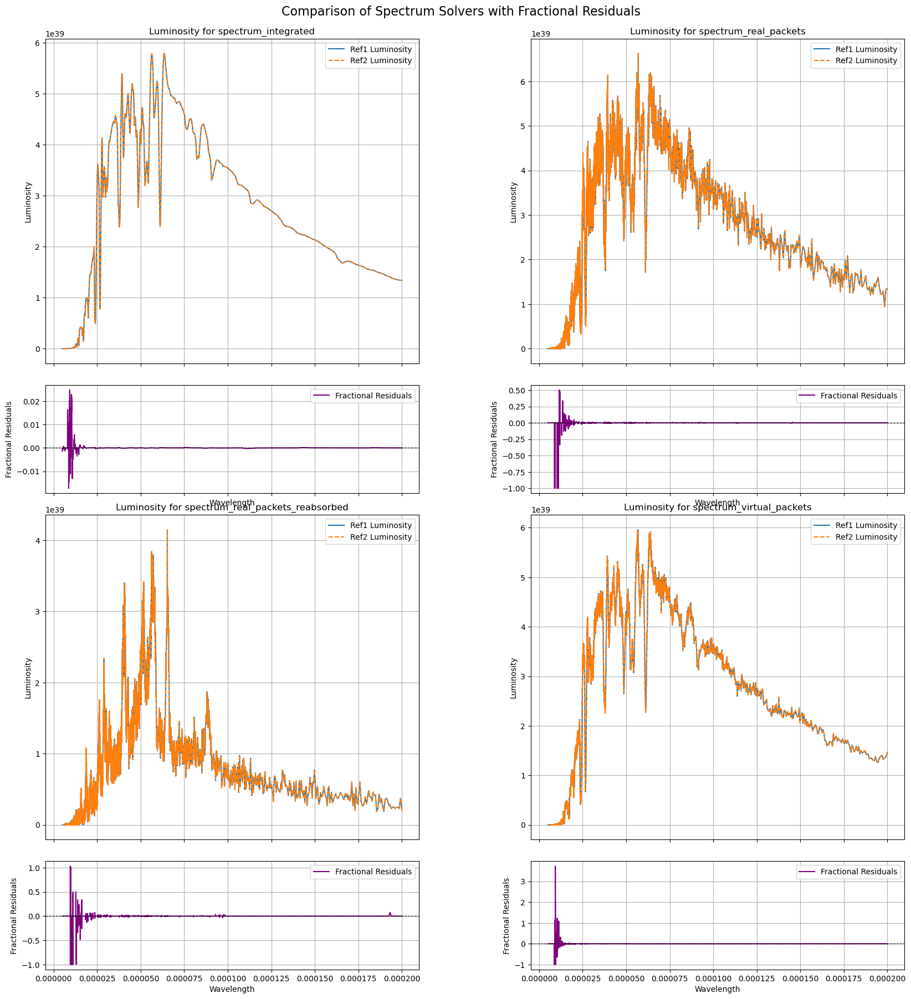

In [11]:
comparer.compare_testspectrumsolver_hdf(
    custom_ref1_path=Path(comparer.ref1_path) / custom_ref1_spectrum_path, 
    custom_ref2_path=Path(comparer.ref2_path) / custom_ref2_spectrum_path
)

In [12]:
comparer.teardown()

Removed temporary directory /tmp/ref_compare_bz0ohgru
